In [258]:
! pip install pmdarima --user

In [282]:
pip install arch

In [291]:
pip install tensorflow


  Created wheel for termcolor: filename=termcolor-1.1.0-py3-none-any.whl size=4847 sha256=59c87571217f4c864550d57e00859e35736a8031a968743a6914533ef6fb8245
  Stored in directory: c:\users\samue\appdata\local\pip\cache\wheels\b6\0d\90\0d1bbd99855f99cb2f6c2e5ff96f8023fad8ec367695f7d72d
Successfully built termcolor


In [297]:
pip install pytrends

  Created wheel for pytrends: filename=pytrends-4.8.0-py3-none-any.whl size=16124 sha256=5061e8af31dfa502571990278ba3565aab0ef9db26089b0468c9ef1538bb5a23
  Stored in directory: c:\users\samue\appdata\local\pip\cache\wheels\87\a9\a3\c190a7e0872639762e92cf3a84d6845ed086e10966533faf42
Successfully built pytrends
Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import pandas as pd
import pandas_datareader.data as web
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf
from random import gauss
from random import seed
from pandas import Series
from pandas.plotting import autocorrelation_plot
from matplotlib import pyplot

%matplotlib inline
%config InlineBackend.figure_format='retina'

import warnings

plt.style.use('seaborn')
sns.set_palette('cubehelix')

import pmdarima as pm

from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose

from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.stats.diagnostic import acorr_ljungbox


import scipy.stats as scs


from sklearn.metrics import mean_squared_error, accuracy_score, r2_score
from sklearn.model_selection import TimeSeriesSplit
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVR, SVC
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPRegressor

from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.linear_model import Ridge

from arch import arch_model



from math import sqrt


import plotly.graph_objs as go

import tensorflow as tf
from keras.layers import Dense
from keras.models import Sequential
from tensorflow import keras

from pytrends.request import TrendReq

from itertools import product


#plt.rcParams['figure.figsize'] = [8, 6]
# plt.rcParams['figure.dpi'] = 300
warnings.simplefilter(action='ignore', category=FutureWarning)


## UTILITIES

In [3]:
def get_data_concat_mode(tickers, start_date='2011-11-30', end_date='2021-11-30'):    

    df_list = []

    for t in tickers:
        df = web.get_data_yahoo(t, start_date, end_date)
        df['ticker'] = t
        df_list.append(df)
        
    conc_df = pd.concat(df_list)    
    
    print(f"Collected df with shape: {conc_df.shape}")
    print(conc_df.head())

    return conc_df

def get_data_merge_mode(tickers, start_date='2011-11-30', end_date='2021-11-30'):
    
    merged_df = pd.DataFrame()
    
    for t in tickers:
        if merged_df.shape[0] == 0:
            merged_df = web.get_data_yahoo(t, start_date, end_date).add_suffix('_' + str(t))
            print(f"merged {t}")
        else:
            df = web.get_data_yahoo(t, start_date, end_date).add_suffix('_' + str(t))
            merged_df = merged_df.join(df)
            print(f"merged {t}")

    print(f"Collected df with shape: {merged_df.shape}")
    print(merged_df.head())
    
    return merged_df

def get_yields(tickers, log, start_date='2011-11-30', end_date='2021-11-30', f=None):
    merged_yield = pd.DataFrame()
    
    if not f:   
        merged_df = get_data_merge_mode(tickers)
    else:
        merged_df = get_data_merge_mode(tickers).groupby(pd.Grouper(freq=f)).mean()
    
    for t in tickers:
    
        col = f"Adj Close_{t}"
        print(f"computing yields for {col}")

        if log: 
            merged_yield[t] = np.log( merged_df[col] / merged_df[col].shift(1) ).dropna()
        else:
            merged_yield[t] = ( merged_df[col] / merged_df[col].shift(1) ).dropna()
        
    return merged_yield


def adf_test(x):
    '''
    Function for performing the Augmented Dickey-Fuller test for stationarity
    
    Null Hypothesis: time series is not stationary
    Alternate Hypothesis: time series is stationary
    Parameters
    ----------
    x : pd.Series / np.array
        The time series to be checked for stationarity
    
    Returns
    -------
    results: pd.DataFrame
        A DataFrame with the ADF test's results
    '''

    indices = ['Test Statistic', 'p-value',
               '# of Lags Used', '# of Observations Used']

    adf_test = adfuller(x, autolag='AIC')
    results = pd.Series(adf_test[0:4], index=indices)

    for key, value in adf_test[4].items():
        results[f'Critical Value ({key})'] = value

    return results


def kpss_test(x, h0_type='c'):
    '''
    Function for performing the Kwiatkowski-Phillips-Schmidt-Shin test for stationarity
    Null Hypothesis: time series is stationary
    Alternate Hypothesis: time series is not stationary
    Parameters
    ----------
    x: pd.Series / np.array
        The time series to be checked for stationarity
    h0_type: str{'c', 'ct'}
        Indicates the null hypothesis of the KPSS test:
            * 'c': The data is stationary around a constant(default)
            * 'ct': The data is stationary around a trend
    
    Returns
    -------
    results: pd.DataFrame
        A DataFrame with the KPSS test's results
    '''

    indices = ['Test Statistic', 'p-value', '# of Lags']

    kpss_test = kpss(x, regression=h0_type)
    results = pd.Series(kpss_test[0:3], index=indices)

    for key, value in kpss_test[3].items():
        results[f'Critical Value ({key})'] = value

    return results


def test_autocorrelation(x, n_lags=40, alpha=0.05, h0_type='c'):
    '''
    Function for testing the stationarity of a series by using:
    * the ADF test
    * the KPSS test
    * ACF/PACF plots
    Parameters
    ----------
    x: pd.Series / np.array
        The time series to be checked for stationarity
    n_lags : int
        The number of lags for the ACF/PACF plots
    alpha : float
        Significance level for the ACF/PACF plots
    h0_type: str{'c', 'ct'}
        Indicates the null hypothesis of the KPSS test:
            * 'c': The data is stationary around a constant(default)
            * 'ct': The data is stationary around a trend
    Returns
    -------
    fig : matplotlib.figure.Figure
        Figure containing the ACF/PACF plot
    '''

    adf_results = adf_test(x)
    kpss_results = kpss_test(x, h0_type=h0_type)

    print('ADF test statistic: {:.2f} (p-val: {:.2f})'.format(adf_results['Test Statistic'],
                                                             adf_results['p-value']))
    print('KPSS test statistic: {:.2f} (p-val: {:.2f})'.format(kpss_results['Test Statistic'],
                                                              kpss_results['p-value']))

    fig, ax = plt.subplots(2, figsize=(16, 8))
    plot_acf(x, ax=ax[0], lags=n_lags, alpha=alpha)
    plot_pacf(x, ax=ax[1], lags=n_lags, alpha=alpha)

    return fig


# TODO:
def compare_mean_var(df, f):
    df_roll = df.rolling(f)
    mean = df_roll.mean()
    std = df_roll.std()
    
    plt.figure(figsize=(12,8))
    plt.plot(df_roll, label = 'Temporal Series')
    plt.plot(mean, label = f'Mean {f}')
    plt.plot(std, label = f'Std {f}')
    plt.legend(loc='upper right');

    
def plot_decomposition(df):
    for col in df.columns.unique():
        decompose_result = seasonal_decompose(df[col].dropna())
        
        df_trend = decompose_result.trend
        df_season = decompose_result.seasonal
        df_residual = decompose_result.resid
        
        plt.rcParams['figure.figsize'] = (12,8)
        
        decompose_result.plot()
        plt.show()
        

def sarimax_auto(dataframe, s, start_pred, end_pred):
    # s = stagionalità
    
    # 80 months as training set
    # 30 months as test set
    # 10 months as validation
    
    p = d = q = range(2)
    param_combinations = list(product(p, d, q))
    lowest_aic, pdq, pdqs = None, None, None
    total_iterations = 0
    for order in param_combinations:
        for (p, q, d) in param_combinations:
            seasonal_order = (p, q, d, s)
            total_iterations += 1
            try:
                model = SARIMAX(df_settle, order = order,
                               seasonal_order= seasonal_order,
                               enforce_stationarity=False,
                               enforce_invertibility=False,
                               disp = False
                               )
                model_result = model.fit(maxiter=200, disp=False)
                
                if not lowest_aic or model_result.aic < lowest_aic:
                    lowest_aic = model_result.aic
                    pdq, pdqs = order, seasonal_order
            
            except Exception as ex:
                continue
                
    print(f"lowest_aic: {lowest_aic}")
    print(f"pdq: {pdq}")
    print(f"pdqs: {pdqs}")
    
    
    model = SARIMAX(dataframe, order = order,
                               seasonal_order= seasonal_order,
                               enforce_stationarity=False,
                               enforce_invertibility=False,
                               disp = False
                               )
    
    print("Fitting model...")    
    model_results = model.fit(maxiter=200, disp=False)
    
    print(model_results.summary())
    
    model_results.plot_diagnostics(figsize=(12,8));
    
    print(model_results.resid.describe())
    
    
    prediction = model_results.get_prediction(start=start_pred, end=end_pred)
    prediction_ci = prediction.conf_int() 
    
    print("Plotting predictions")
    plt.figure(figsize=(12,6))
    ax = dataframe['2010':].plot(label = 'Effettivo') # TODO: parametrize index
    prediction_ci.plot(ax=ax, style = ['--', '--'],
                  label = 'predicted/forecasted')
    ci_index = prediction_ci.index
    lower_ci = prediction_ci.iloc[:,0]
    upper_ci = prediction_ci.iloc[:,1]

    ax.fill_between(ci_index, lower_ci, upper_ci, color = 'g', alpha = 0.1)
    ax.set_xlabel('Time (years)')
    ax.set_ylabel('Prezzo')
    plt.grid()
    plt.legend()
    plt.show()
                    
    return model_results

def split_auto(df, delta, col_name):
    
    df['Prediction'] = df[[col_name]].shift(-delta)
    
    # takes the col_name except for the last delta
    X = np.array(df.drop(['Prediction'], 1))
    X = X[:-delta]
    
    # takes the predictions except for the last delta
    y = np.array(df['Prediction'])
    y = y[:-delta]
    
    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
    
    
    return x_train, x_test, y_train, y_test, 


def svm_auto(df, delta, col_name):

    x_train, x_test, y_train, y_test = split_auto(df, delta, col_name)
    
    # 
    model = SVR()
    
    parameters = {'kernel':('linear', 'rbf', 'poly'),
                  'C':[1, 10, 100, 1000, 1e3],
                  'degree':[1, 2, 3, 4], # only for poly function
                  'gamma':["scale", "auto", 0.15, 0.2, 0.1]
                 
                 }
                    
    
    clf = GridSearchCV(model, parameters, scoring='r2')
    
    clf.fit(x_train, y_train)
    
    print(clf.best_params_)

    print("R2: ", clf.score(x_train, y_train))
    
    
    
    predictions = clf.predict(x_test)
    rmse = sqrt(mean_squared_error(y_test, predictions))
    
    
    print('R^2: ', r2)
    print('rmse: ', rmse)
    
    plt.plot(y_test, label = 'Effettivo')
    plt.plot(predictions, label = 'predictions')
    plt.grid(True)
    plt.legend();
    plt.show()
    
    return svr_rbf
    

def linear_reg_auto(df, delta, col_name):

    x_train, x_test, y_train, y_test = split_auto(df, delta, col_name)
    
    lr = LinearRegression()
    
    lr.fit(x_test, y_test)
    
    r2 = lr.score(x_test, y_test)
    
    predictions = lr.predict(x_test)
    rmse = sqrt(mean_squared_error(y_test, predictions))
    
    
    print('R^2: ', r2)
    print('rmse: ', rmse)
    
    plt.plot(y_test, label = 'Effettivo')
    plt.plot(predictions, label = 'predictions')
    plt.grid(True)
    plt.legend();
    plt.show()
    
    return lr

def arima_diagnostics(resids, n_lags = 40):
    #localizziamo i quattro sotto grafici
    fig, ((ax1, ax2), (ax3,ax4)) = plt.subplots(2,2)
    r =resids
    resids = (r - np.nanmean(r)) / np.nanstd(r)
    resids_nonmissing = resids[~(np.isnan(resids))]
    
    # grafico dei residui nel corso del tempo
    sns.lineplot(x=np.arange(len(resids))[1:], y= resids[1:], ax=ax1)
    ax1.set_title('Residui standardizzati')
    
    # distribuzione dei residui
    x_lim = (-1.96 * 2, 1.96 * 2)
    r_range = np.linspace(x_lim[0], x_lim[1])
    norm_pdf = scs.norm.pdf(r_range)
    sns.distplot(resids_nonmissing, hist = True, kde = True,
                norm_hist = True, ax = ax2)
    ax2.plot(r_range, norm_pdf, 'g', lw = 2, label='N(0,1)')
    ax2.set_title('Distribuzione dei rensidui standardizzati')
    ax2.set_xlim(x_lim)
    ax2.legend()
    
    # Grafico Quantili - Quantili (Q-Q) 
    qq = sm.qqplot(resids_nonmissing[1:], line = 's', ax = ax3)
    ax3.set_title('Grafico Q-Q')
    
    # Grafico ACF
    plot_acf(resids[1:], ax=ax4, lags=n_lags, alpha=0.05)
    ax4.set_title('Grafico ACF')
    
    return fig

def split_custom(df):
    # 80 train, 30 test, 10 validation: tot = 120
    #80/120
    #30/120 
    #10/120
    
    n = df.shape[0]
    
    train_size = round(n*80/120)
    test_size = round(n*30/120)
    val_size = round(n*10/120)
    
    train =  df.iloc[:train_size]
    test = df.iloc[train_size: train_size + test_size]
    validate = df.iloc[train_size + test_size:]
    
    return train, test, validate
    
    

def arima_auto(df, seasonal=False):

    train, test, validate = split_custom(df)
    
    
    
    print("Fit and model selection...")
    arima = pm.auto_arima(train, error_action='ignore', suppress_warnings = True,
                     seasonal=seasonal)
    
    print(arima.summary())
    
    arima_diagnostics(arima.resid, 40)
    
    
    arima_pred = arima.predict(n_periods=test_size, 
                                     return_conf_int=True, 
                                     alpha=0.05)
    
    arima_pred = [pd.DataFrame(arima_pred[0], columns=['prediction']),
                  pd.DataFrame(auto_arima_pred[1], 
                                columns=['ci_lower', 'ci_upper'])]
    
    arima_pred = pd.concat(arima_pred, 
                            axis=1).set_index(test.index)
    
    fig, ax = plt.subplots(1)
    ax = sns.lineplot(data=test, color = 'r', label ='Effettivo')
    ax.plot(arima_pred, color ='k', label = 'ARIMA')

    ax.fill_between(arima_pred.index,
                   arima_pred.ci_lower,
                   arima_pred.ci_upper,
                   alpha = 0.2,
                   facecolor = 'g')

    ax.set(title='Arima: previsto vs effettivo',
          xlabel = 'Data',
          ylabel = 'Prezzo in $')
    ax.legend(loc='upper left');
    
    return arima


def auto_garch_for_yields(df):

    returns = 100 * df['Adj Close'].pct_change().dropna()
    
    coeffs = []
    cond_vol = []
    std_resids = []
    models = []
    
    for asset in returns.columns:
        model = arch_model(returns[asset], mean = 'Constant', vol='GARCH',
                           p = 1, o = 0, q = 1).fit(update_freq = 0, disp = 'off')
        coeffs.append(model.params)
        cond_vol.append(model.conditional_volatility)
        std_resids.append(model.resid / model.conditional_volatility)
        models.append(model)
    
    coeffs_df = pd.DataFrame(coeffs, index=returns.columns)
    
    print(coeffs_df)
    
    cond_vol_df = pd.DataFrame(cond_vol).transpose().set_axis(returns.columns,
                                                         axis='columns', inplace = False)
    print(cond_vol_df)
    
    
    std_resids_df = pd.DataFrame(std_resids).transpose().set_axis(returns.columns,
                                                             axis = 'columns', inplace = False)
    print(std_resids_df)
    
    return models

def logistic_regression_market(data):
    # add: variazione volatilità,  ^VIX
    
    df = data['Adj Close'].pct_change() * 100
    df = df.rename("Today")
    df = df.reset_index()
    
    for i in range(1,6):
        df['Lag_' + str(i)] = df['Today'].shift(i)
        
    df['Volume'] = data.Volume.shift(1).values/1000_000_000
    
    df = df.dropna()
    
    df['Direction'] = [1 if i > 0 else 0 for i in df['Today']]
    
    df = sm.add_constant(df)
    
    train, test, validate = split_custom(df)
    
    X = train[['const', 'Lag_1', 'Lag_2', 'Lag_3', 'Lag_4', 'Lag_5', 'Volume']]    
    y = train.Direction
    
    clf = LogisticRegression(random_state=0).fit(X, y)
    
    X_test = test[['const', 'Lag_1', 'Lag_2', 'Lag_3', 'Lag_4', 'Lag_5', 'Volume']]  
    y_test = test.Direction
    
    print("Accuracy: ", clf.score(X_test, y_test))
    
    
    cm = confusion_matrix(y_test, clf.predict(X_test))
    
    sns.heatmap(cm)
    plt.show()

    
    return clf


def auto_pytrends(all_keywords, start_date='2011-11-30', end_date='2021-11-30'):
    # '2016-12-14 2017-01-25'
    # start_date='2011-11-30', end_date='2021-11-30'
    pytrends = TrendReq(hl='en-US')
    timeframe = f"{start_date} {end_date}"
    cat='0'
    geo = ''
    gprop = ''
    
    keywords = []
    
    pytrends.build_payload(keywords,
                       cat,
                       timeframes[0],
                       geo,
                       gprop)
    
    data = pytrends.interest_over_time()
    return data

def mobile_average_strategy(data, f1, f2, col, plot=True):
    
    sma_col_1 = f'{col}_SMA{f1}'
    sma_col_2 = f'{col}_SMA{f2}'
    position = f'Position_{col}'
    
    data[sma_col_1] = data[col].rolling(f1).mean()
    data[sma_col_2] = data[col].rolling(f2).mean()
    
    data.dropna(inplace=True)
    
    data[position] = np.where(data[sma_col_1] > data[sma_col_2], 1, -1)
    
    if plot:
        ax = data[[col, sma_col_1, sma_col_2, f'Position_{col}']].plot(secondary_y = 'Position', figsize=(10,6))
        ax.get_legend().set_bbox_to_anchor((0.25, 0.85));
        plt.show()
    
    # Backtesting vettoriale
    
    returns = f'Returns_{col}'
    strategy = f'Strategy_{col}'
    
    data[returns] = np.log(data[col] / data[col].shift(1))
    data[strategy] = data[position].shift(1) * data[returns]
    
    data.dropna(inplace=True)
    
    # Cumulative Yields:
    print("Cumulative Yields:")
    perf = np.exp(data[[returns, strategy]].sum())
    print(perf)
    
    print("Volatility:")
    data[[returns, strategy]].std() * 252 ** 0.5
    
    if plot:
        ax = data[[returns, strategy]].cumsum().apply(np.exp).plot(figsize=(10,6)) # left ax
        data[position].plot(ax=ax, secondary_y=position, style = '--')
        ax.get_legend().set_bbox_to_anchor((0.25, 0.85));
        plt.show()
    
    return pd.DataFrame({'SMA1':f1, 'SMA2': f2,
                        'MARKET':perf[returns],
                        'STRATEGY': perf[strategy],
                        'OUT':perf[strategy]-perf[returns]},
                        index=[0])
    

def sma_optimization(data, col):
    
    # add test with best parameters and new data
    
    sma1 = range(20,61,4)
    sma2 = range(180,281,10)

    results = pd.DataFrame()
    
    for SMA1, SMA2 in product(sma1, sma2):
        results.append(mobile_average_strategy(data, SMA1, SMA2, col, plot=False))
    
    return results.sort_values('OUT',ascending=False).head(10)

def get_diretction(data, col):
    data[f'direction_{col}'] = np.sign(data[col]).astype(int)
    
def get_returns_evaluation(data, col, position):
    data_copy = data.copy()
    
    returns = f'Returns_{col}'
    strategy = f'Strategy_{col}'
    
    data_copy[returns] = np.log(data_copy[col] / data_copy[col].shift(1))
    data_copy[strategy] = data_copy[position].shift(1) * data_copy[returns]
    
    data_copy.dropna(inplace=True)
    
    # Cumulative Yields:
    print("Cumulative Yields:")
    perf = np.exp(data_copy[[returns, strategy]].sum())
    print(perf)
    
    print("Volatility:")
    data_copy[[returns, strategy]].std() * 252 ** 0.5
    
    results = {'MARKET':perf[returns],
            'STRATEGY': perf[strategy],
            'OUT':perf[strategy]-perf[returns]}
    
    for r in results:
        print(f"{r}: {results[r]}")
    
    return results


from pytrends import dailydata


"""
complete (pd.DataFrame): Contains 4 columns.
            The column named after the word argument contains the daily search
            volume already scaled and comparable through time.
            The column f'{word}_unscaled' is the original daily data fetched
            month by month, and it is not comparable across different months
            (but is comparable within a month).
            The column f'{word}_monthly' contains the original monthly data
            fetched at once. The values in this column have been backfilled
            so that there are no NaN present.
            The column 'scale' contains the scale used to obtain the scaled
            daily data.

"""
def auto_dailydata(name, y_from=2011, m_from=12, y_to=2021, m_to=12, geo=''):
    df = dailydata.get_daily_data(name, y_from, m_from, y_to, m_to, geo=geo)
    return df[name]





## Descriptive DataSet

In [4]:
# ticker S&P500: '^GSPC'

tickers = ['AAPL', 'IBM', 'GOOG', 'AMZN', 'NVDA','AMD', 'NFLX', 'E', 
           'STLA', 'STM', 'PFE', 'DIS', 'LHCG', 'CVX', 'UEC']

tickers_and_market = ['AAPL', 'IBM', 'GOOG', 'AMZN', 'NVDA','AMD', 'NFLX', 'E', 
           'STLA', 'STM', 'PFE', 'DIS', 'LHCG', 'CVX', 'UEC', '^GSPC']

tick_market_vol = ['AAPL', 'IBM', 'GOOG', 'AMZN', 'NVDA','AMD', 'NFLX', 'E', 
           'STLA', 'STM', 'PFE', 'DIS', 'LHCG', 'CVX', 'UEC', '^GSPC', '^VIX']

all_var = ['AAPL', 'IBM', 'GOOG', 'AMZN', 'NVDA','AMD', 'NFLX', 'E', 
           'STLA', 'STM', 'PFE', 'DIS', 'LHCG', 'CVX', 'UEC', '^GSPC', '^VIX', '^IRX']

stocks = ['Apple', 'IBM', 'Alphabet', 'Amazon', 'NVIDIA', 'AMD', 'Netflix', 'ENI',
         'Stellantis', 'STMicroelectronics',  'Pfizer', 'Walt Disney', 'LHC Group', 
          'Chevron', 'Uranium Energy Corp']

markets = ['Nasdaq', 'Nasdaq', 'Nasdaq', 'Nasdaq', 'Nasdaq', 'Nasdaq',  'Nasdaq', 'NYSE',
          'NYSE', 'NYSE', 'Nasdaq', 'Nasdaq', 'Nasdaq', 'Nasdaq', 'NYSE']

fields = ['IT', 'IT', 'IT', 'IT', 'Elettronica', 'Elettronica', 
           'Intrattenimento', 'Energia', 'Automobilistico', 'Elettronica', 'Salute',
           'Intrattenimento', 'Salute', 'Energia', 'Energia']


stocks_dict = {'ticker': tickers, 'stock': stocks, 'field': fields, 'market': markets}


stocks_df = pd.DataFrame(stocks_dict)

stocks_df

,ticker,stock,field,market
0,AAPL,Apple,IT,Nasdaq
1,IBM,IBM,IT,Nasdaq
2,GOOG,Alphabet,IT,Nasdaq
3,AMZN,Amazon,IT,Nasdaq
4,NVDA,NVIDIA,Elettronica,Nasdaq
5,AMD,AMD,Elettronica,Nasdaq
6,NFLX,Netflix,Intrattenimento,Nasdaq
7,E,ENI,Energia,NYSE
8,STLA,Stellantis,Automobilistico,NYSE
9,STM,STMicroelectronics,Elettronica,NYSE


## Assets' Fields

<AxesSubplot:ylabel='stock'>

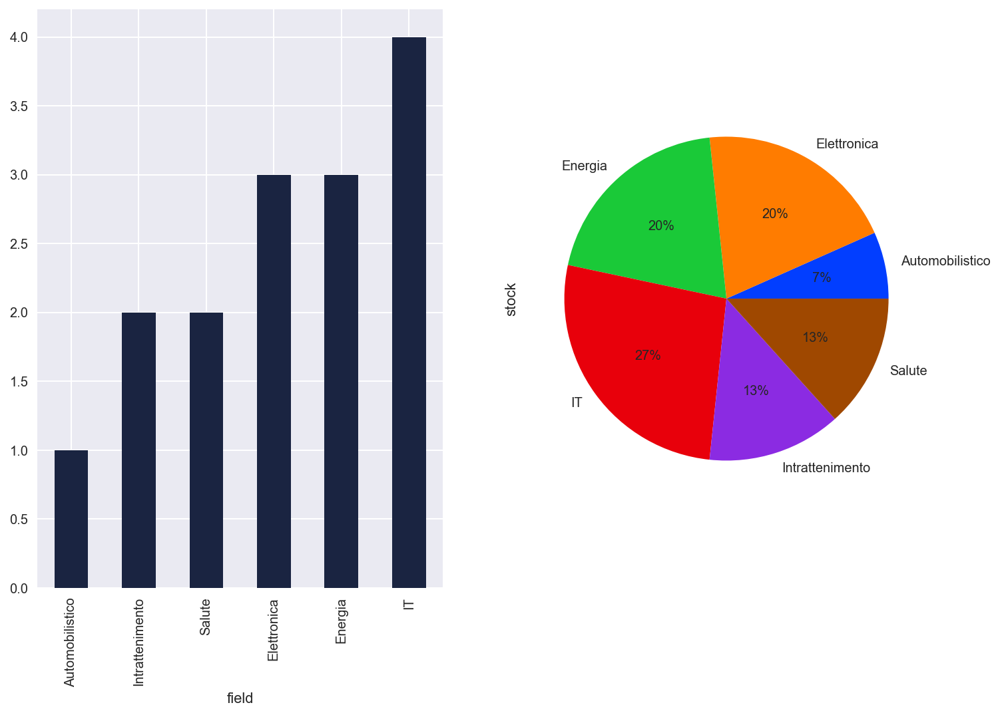

In [186]:
plt.figure(figsize=(12, 8))

plt.subplot(121)

stocks_df.groupby('field').market.count().sort_values().plot(kind='bar')

plt.subplot(122)

stocks_df.groupby('field').stock.count().plot.pie(colors = sns.color_palette('bright')[0:7], 
                                                  autopct='%.0f%%')

## Downloading Asset Data and DF Building - Concat Mode

The get_data_concat_mode builds a single df with the stocks data in sequence with a static number of columns

In [35]:
all_stock_df = get_data_concat_mode(stocks_df.ticker.unique())  

Collected df with shape: (37755, 7)
                 High        Low       Open      Close       Volume  \
Date                                                                  
2011-11-30  13.652857  13.510714  13.617500  13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143  13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500  13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214  14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214  13.962500  283598000.0   

            Adj Close ticker  
Date                          
2011-11-30  11.654805   AAPL  
2011-12-01  11.829536   AAPL  
2011-12-02  11.883511   AAPL  
2011-12-05  11.984445   AAPL  
2011-12-06  11.921627   AAPL  


Plotting the Adjusted Close grouped by ticker

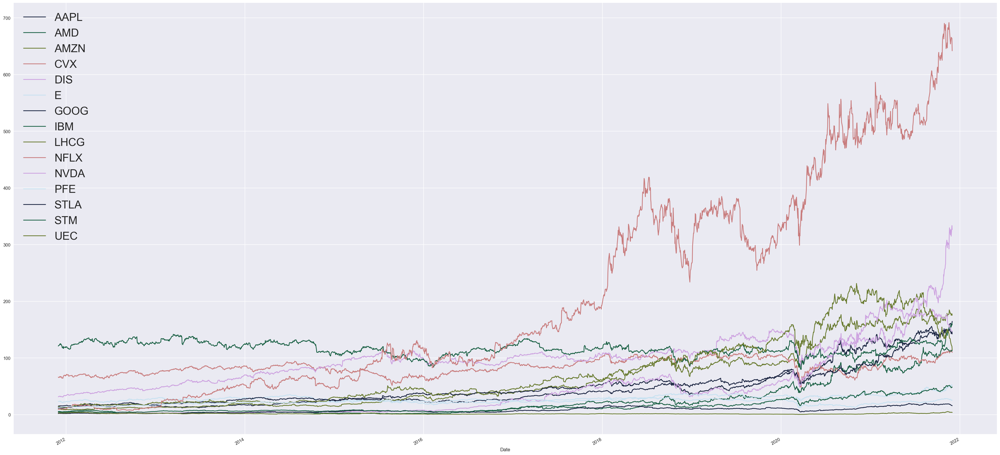

In [36]:
all_stock_df.groupby('ticker')["Adj Close"].plot(figsize=(40, 20), legend=True)
plt.legend(loc=2, prop={'size': 25})


## Downloading Asset Data and DF Building - Merge Mode

The get_data_merge_mode function builds a single df joining data on index.
The df returned has a dynamic number of columns that depends by the number of tickers passed as parameter.

In [37]:


merged_df = get_data_merge_mode(stocks_df.ticker.unique()) 

merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
merged UEC
Collected df with shape: (2517, 90)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654806  180.066925  176.108994  176.453156  179.732315   
2011-12-01       11.829534  181.634796  178.556412  178

Plotting the Adjusted Close of each stock in a single plot

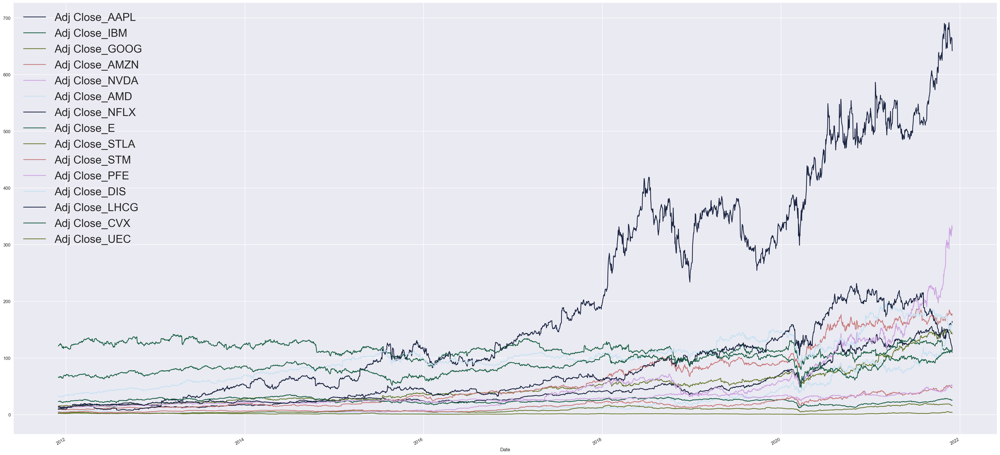

In [188]:

adj_close_columns = [col for col in merged_df.columns if "Adj Close" in col]
merged_df[adj_close_columns].plot(figsize=(40, 20))
plt.legend(loc=2, prop={'size': 25})

Presentazione delle prime righe del Dataframe principale

In [189]:
merged_df.head()

,High_AAPL,Low_AAPL,Open_AAPL,Close_AAPL,Volume_AAPL,Adj Close_AAPL,High_IBM,Low_IBM,Open_IBM,Close_IBM,...,Open_CVX,Close_CVX,Volume_CVX,Adj Close_CVX,High_UEC,Low_UEC,Open_UEC,Close_UEC,Volume_UEC,Adj Close_UEC
Date,,,,,,,,,,,,,,,,,,,,,
2011-11-30,13.652857,13.510714,13.617500,13.650000,405938400.0,11.654806,180.066925,176.108994,176.453156,179.732315,...,100.500000,102.820000,13373200.0,66.285393,3.05,2.77,2.85,3.05,610900,3.05
2011-12-01,13.892857,13.598214,13.662143,13.854643,387181200.0,11.829534,181.634796,178.556412,178.785858,181.118546,...,102.820000,101.830002,7007200.0,65.647141,3.02,2.88,3.02,2.89,362700,2.89
2011-12-02,14.058214,13.877857,13.922500,13.917857,379055600.0,11.883510,182.915863,181.118546,181.567871,181.319305,...,103.040001,101.690002,6638100.0,65.556915,2.99,2.86,2.99,2.92,322000,2.92
2011-12-05,14.157500,13.942500,14.053214,14.036071,357210000.0,11.984445,185.095596,182.007645,182.772461,182.447418,...,103.580002,102.820000,6121800.0,66.285393,3.06,2.88,2.95,3.04,353500,3.04
2011-12-06,14.093929,13.906429,14.018214,13.962500,283598000.0,11.921628,185.019119,181.950287,182.265778,184.455063,...,103.099998,104.360001,7445000.0,67.278175,3.08,2.93,2.93,3.06,343600,3.06


Plotting the Adjusted Close of each stock

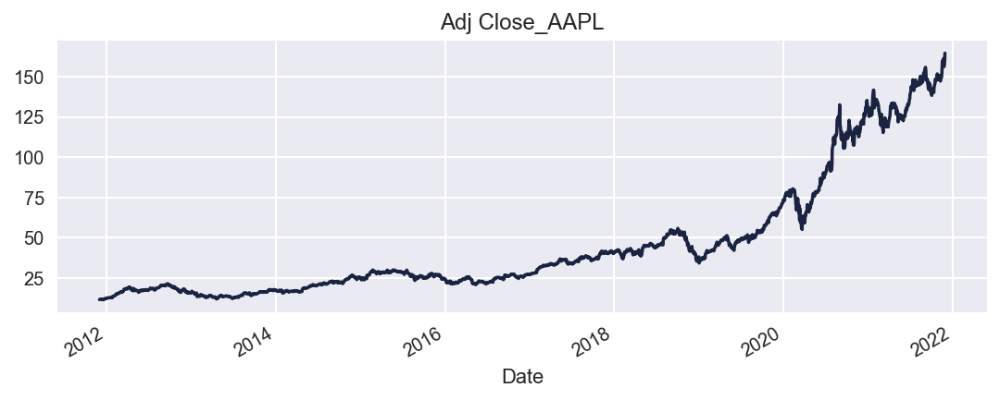

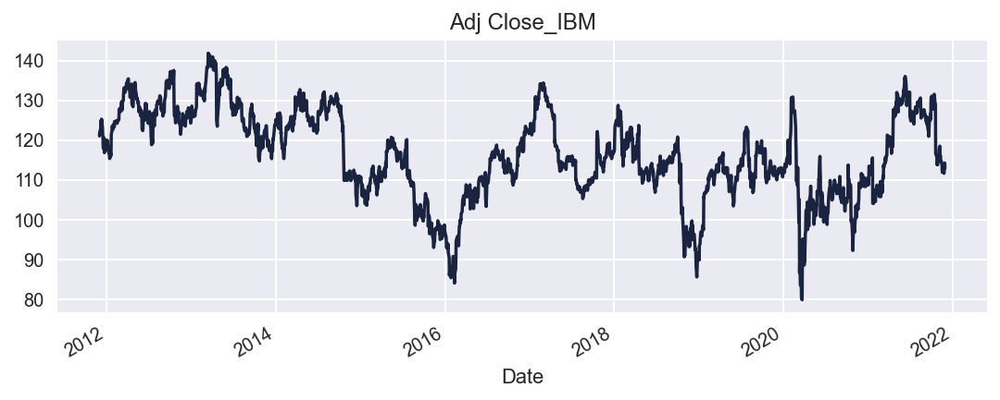

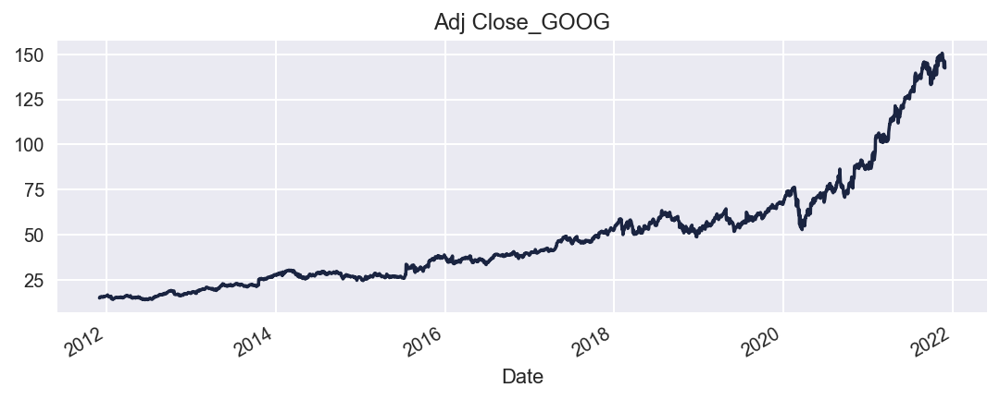

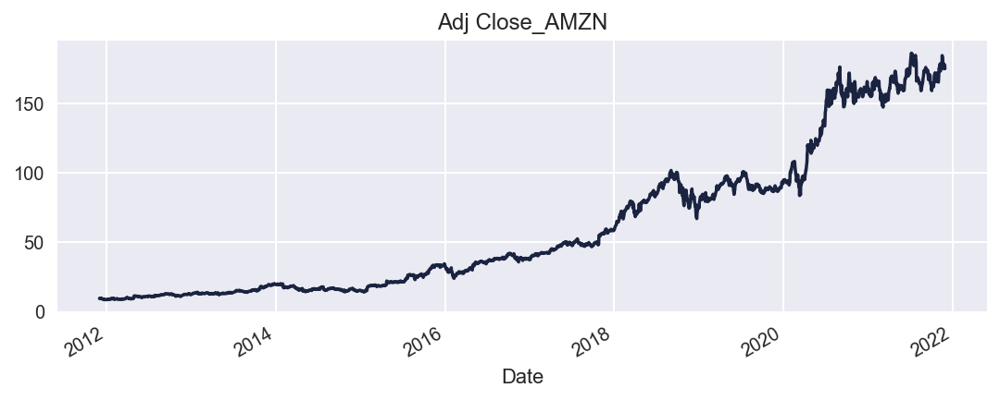

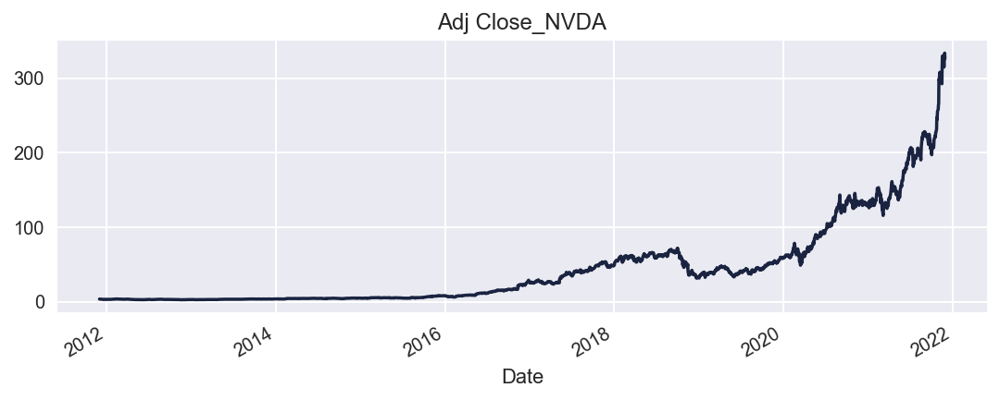

...

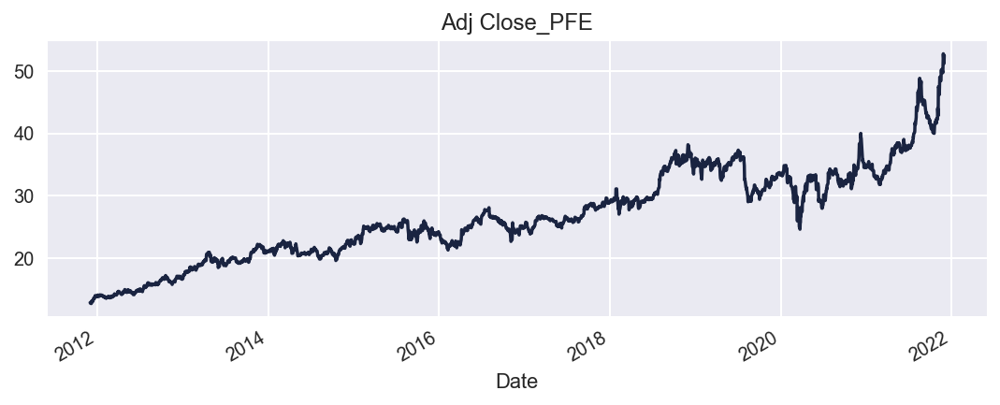

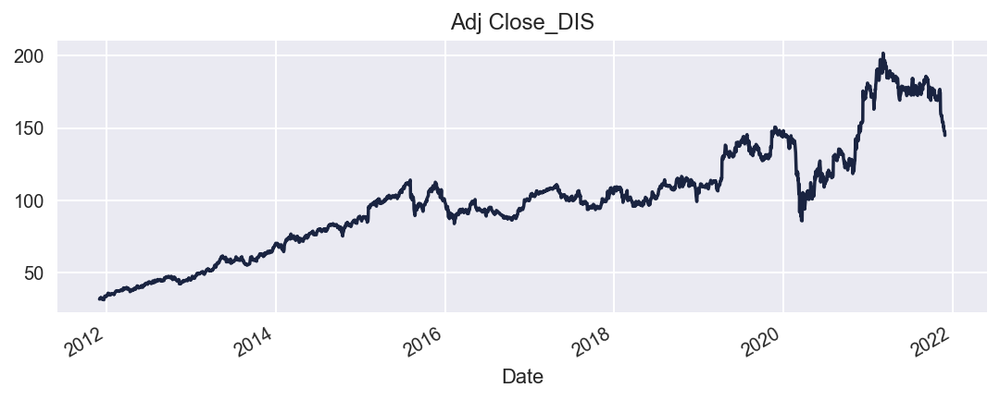

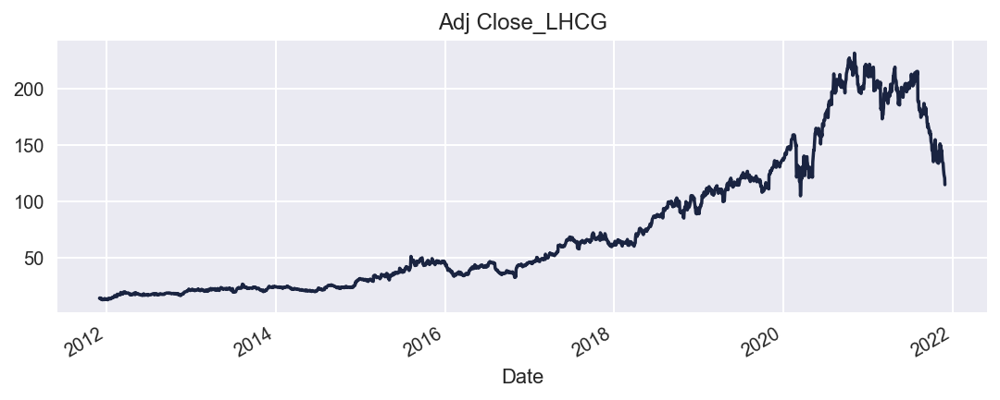

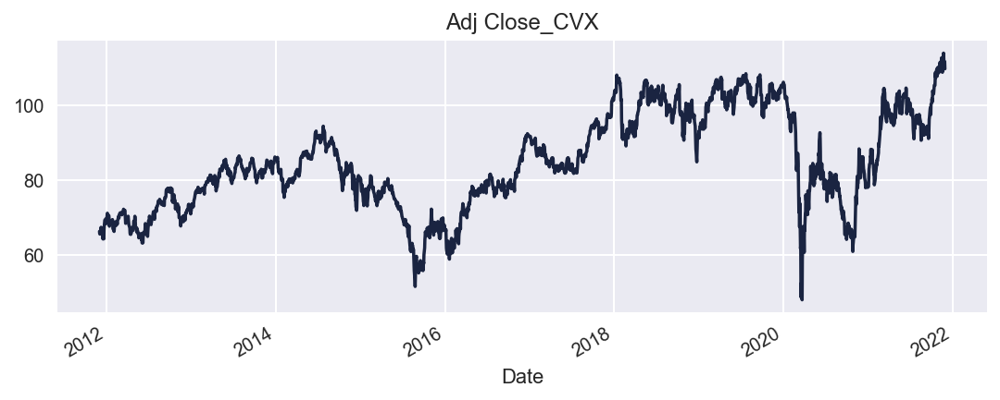

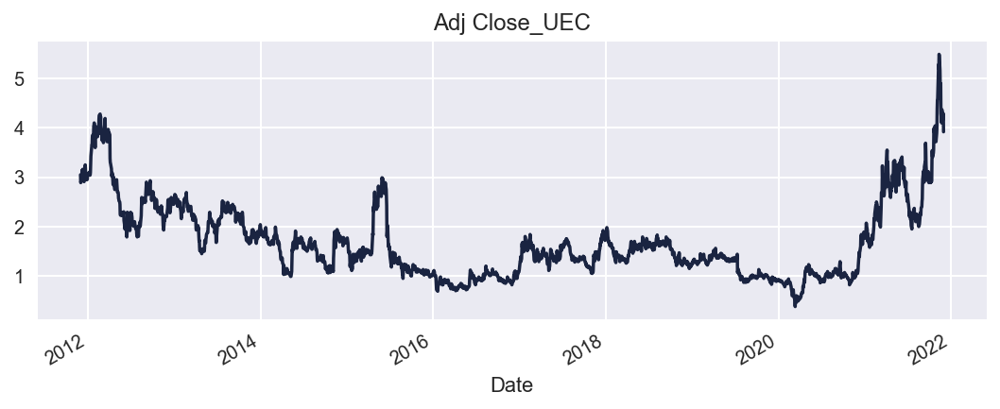

In [39]:
for col in adj_close_columns:
    merged_df[col].plot(figsize=(9, 3))
    plt.title(col)
    plt.show()


Plotting the Moving Average of each stock

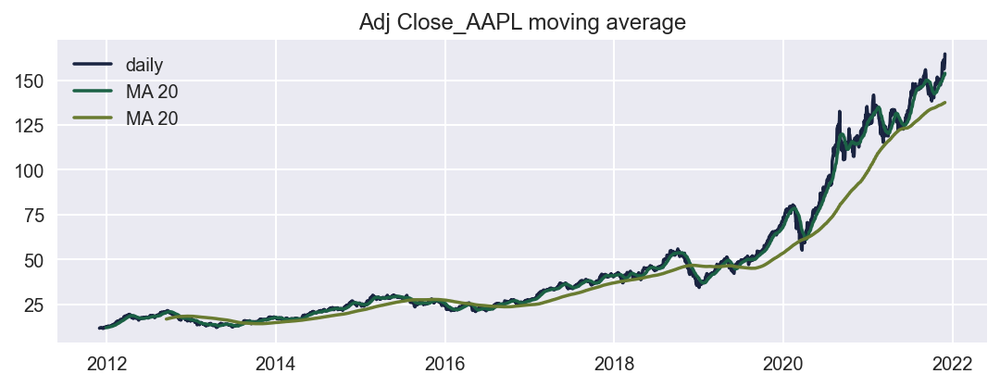

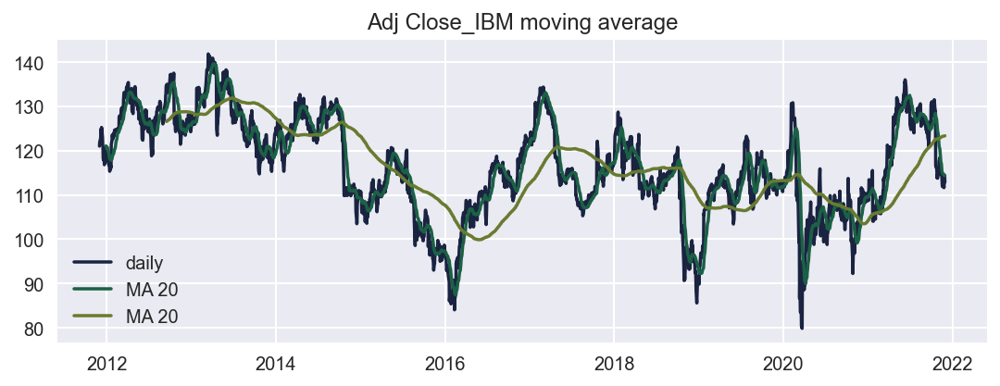

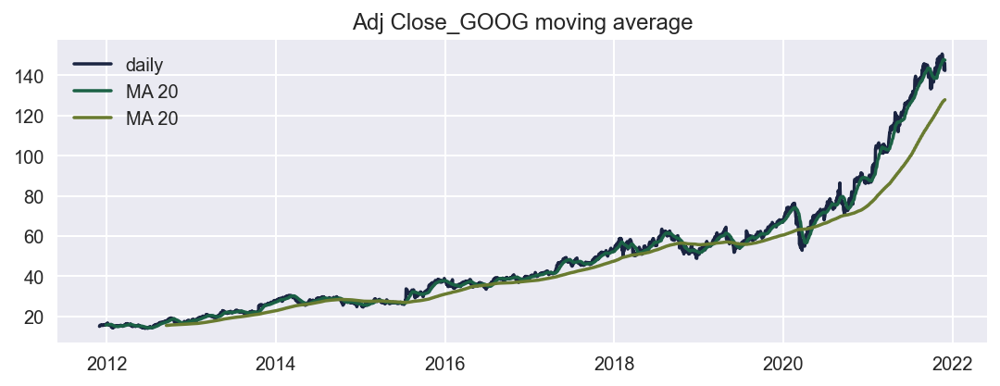

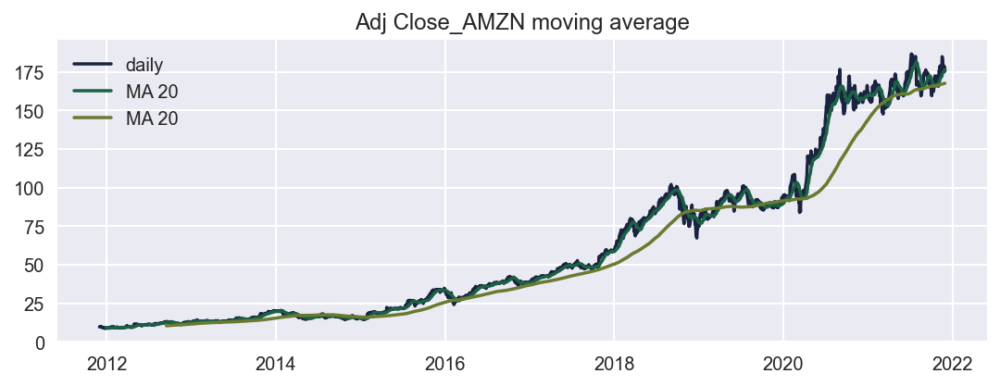

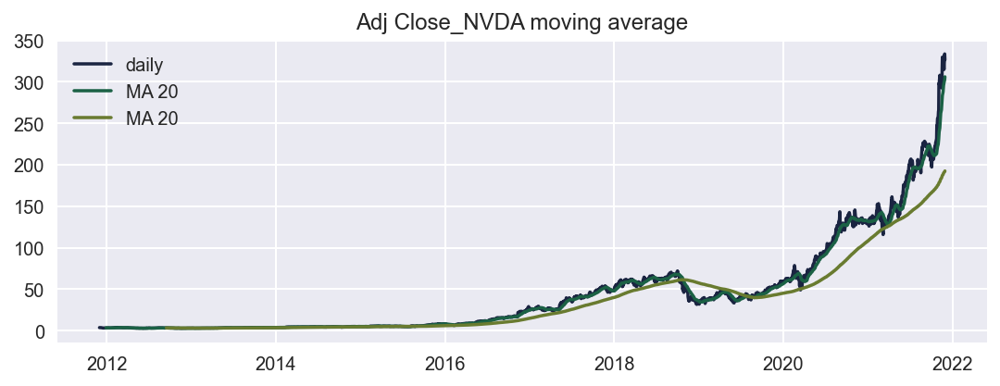

...

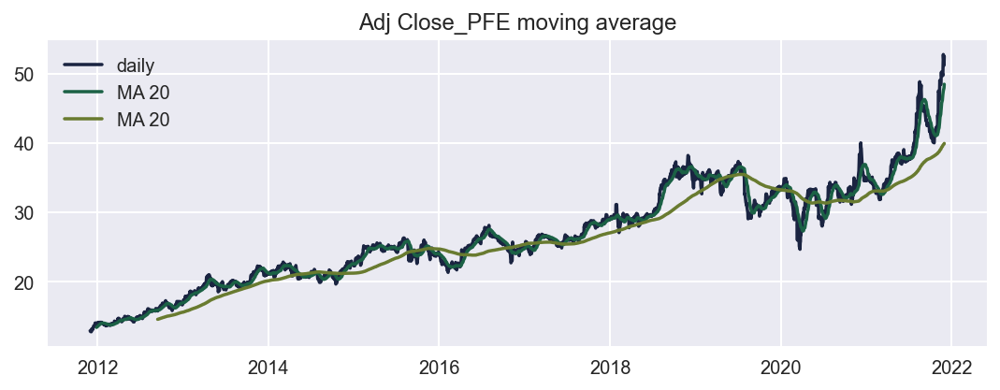

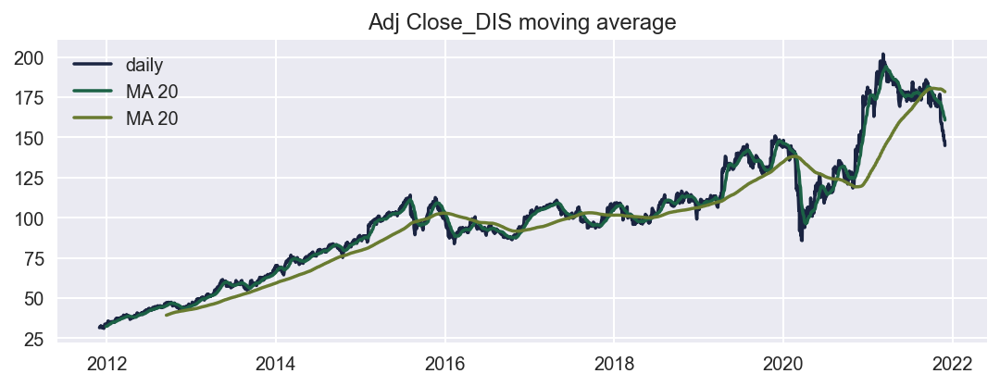

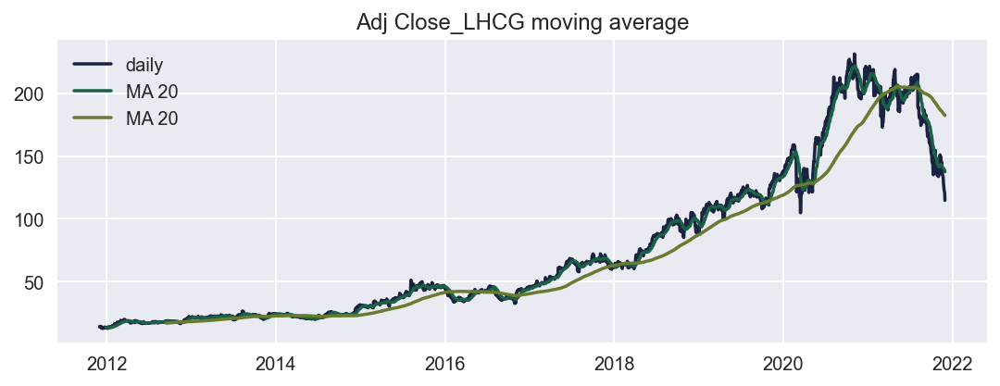

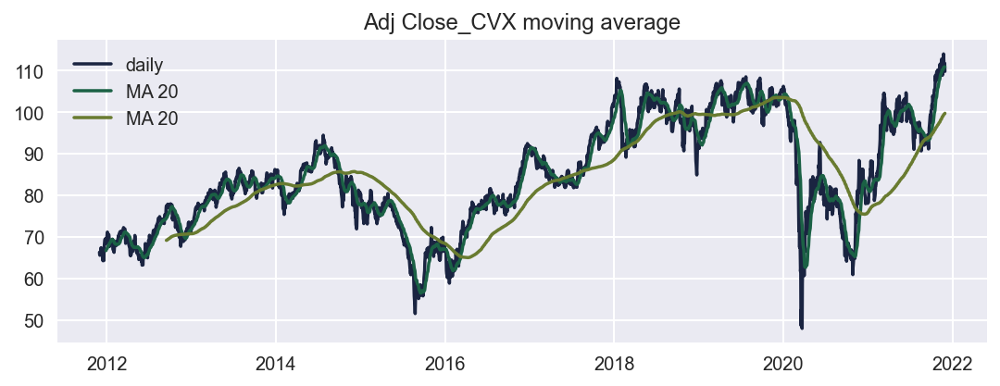

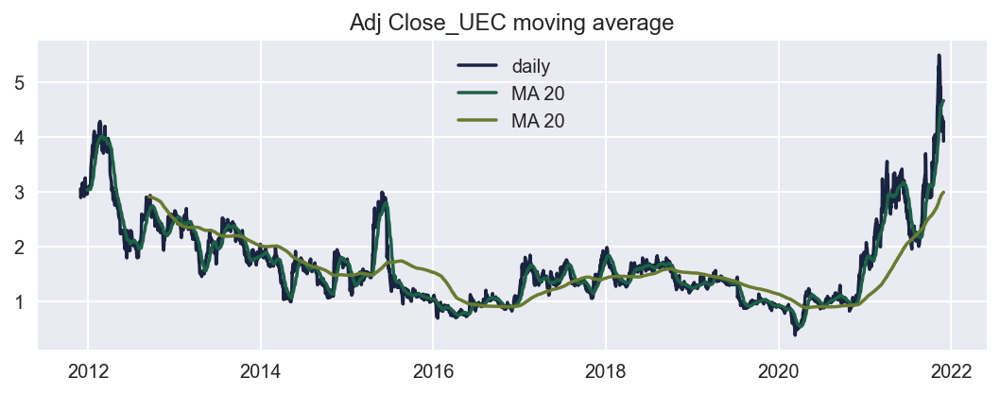

In [40]:
for col in adj_close_columns:
    plt.figure(figsize=(9, 3))
    plt.plot(merged_df[col], label="daily")
    plt.plot(merged_df[col].rolling(20).mean(), label="MA 20")  # rolling(days)
    plt.plot(merged_df[col].rolling(200).mean(), label="MA 20")
    plt.legend(loc="best")
    plt.title(f"{col} moving average")
    plt.show()

# Prices Correlation

Using both S&P500 and VIX Indexes

In [41]:
df = get_data_merge_mode(tick_market_vol)

merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
merged UEC
merged ^GSPC
merged ^VIX
Collected df with shape: (2517, 102)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654808  180.066925  176.108994  176.453156  179.732315   
2011-12-01       11.829536  1

Plotting Adjusted Close Correlation

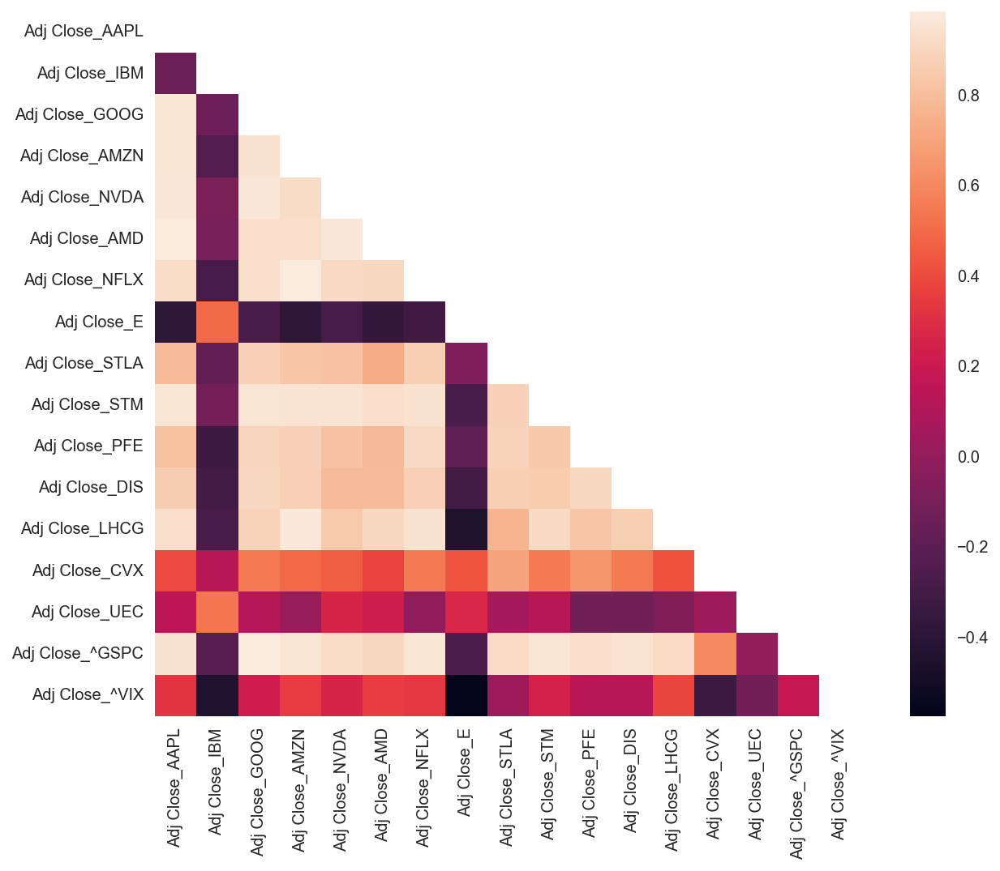

In [42]:
def time_series_correlations(df, target):
    target_columns = [col for col in df.columns if target in col ]
    corr = df[target_columns].corr()
    mask = np.zeros_like(corr)
    mask[np.triu_indices_from(mask)] = True
    with sns.axes_style("white"):
        f, ax = plt.subplots(figsize=(11, 8))
        ax = sns.heatmap(corr, mask=mask, square=True)
    plt.show()    

    
time_series_correlations(df, "Adj")    

# Prices Directions Correlation

Plotting Heatmap of price directions correlations

C:\Users\samue\AppData\Local\Temp/ipykernel_13520/25277444.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_adj_close[f"{col}_pred"] = df_adj_close[col].shift(1)
C:\Users\samue\anaconda3\lib\site-packages\pandas\util\_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)
C:\Users\samue\AppData\Local\Temp/ipykernel_13520/25277444.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation:

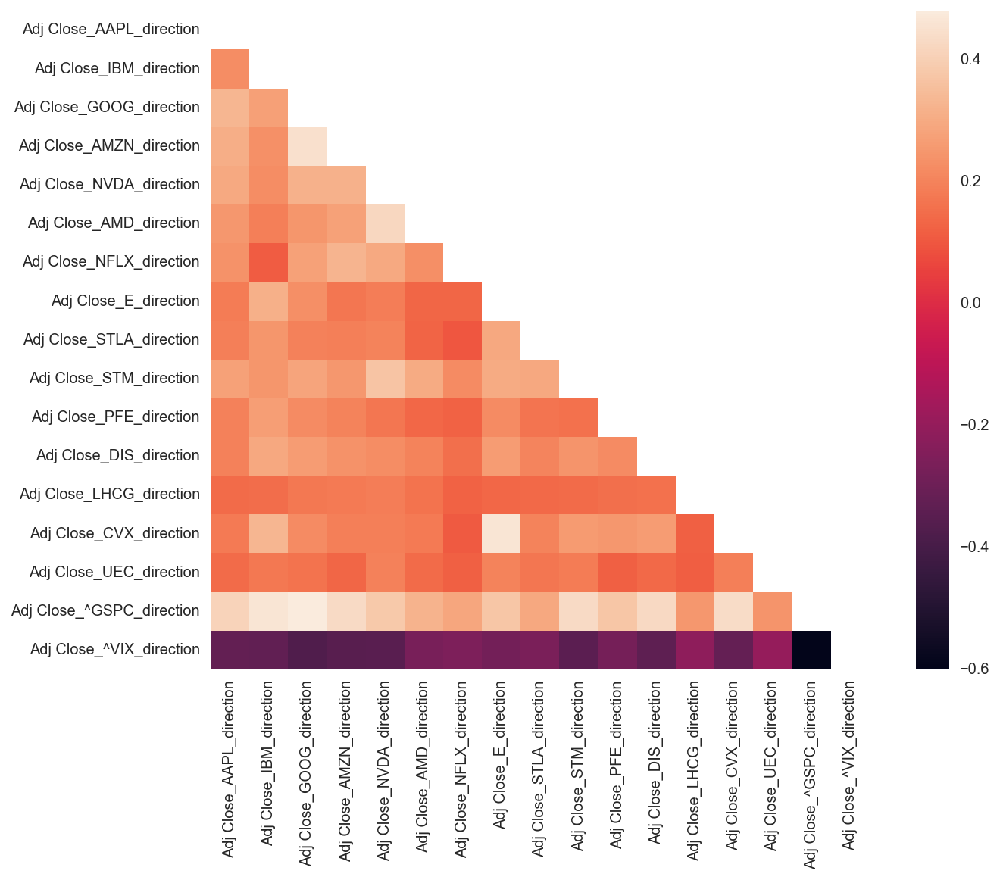

In [43]:
df_adj_close = df[[col for col in df.columns if "Adj" in col ]]

for col in df_adj_close.columns:
    df_adj_close[f"{col}_pred"] = df_adj_close[col].shift(1)
    df_adj_close.dropna(inplace=True)
    df_adj_close[f"{col}_diff"] =  df_adj_close[col] - df_adj_close[f"{col}_pred"]
    df_adj_close[f"{col}_direction"] = np.sign(df_adj_close[f"{col}_diff"]).astype(int)
    
df_adj_close.dropna(inplace=True)
df_adj_close[["Adj Close_AAPL", "Adj Close_AAPL_pred", "Adj Close_AAPL_diff", "Adj Close_AAPL_direction"]]

time_series_correlations(df_adj_close, "direction") 

## SIMPLE YIELDS COMPUTATION

The get_yields function builds a DataFrame object with the daily simple gross returns of each stock.
The stock's yields are computated with the following formula:
adj_close day t / adj_close t-1.
If the log parameter is true the function computes the logaritmic yields,
'f' parameter (default None) defines the data's frequency,
Nan value are dropped

In [44]:


merged_yield = get_yields(tickers_and_market, log=True)



merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
merged UEC
merged ^GSPC
Collected df with shape: (2517, 96)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654805  180.066925  176.108994  176.453156  179.732315   
2011-12-01       11.829536  181.634796  17

Simple logarithmic daily gross returns of each stock in the same plot

Text(0.5, 1.0, 'Logarithmic Daily Gross Returns')

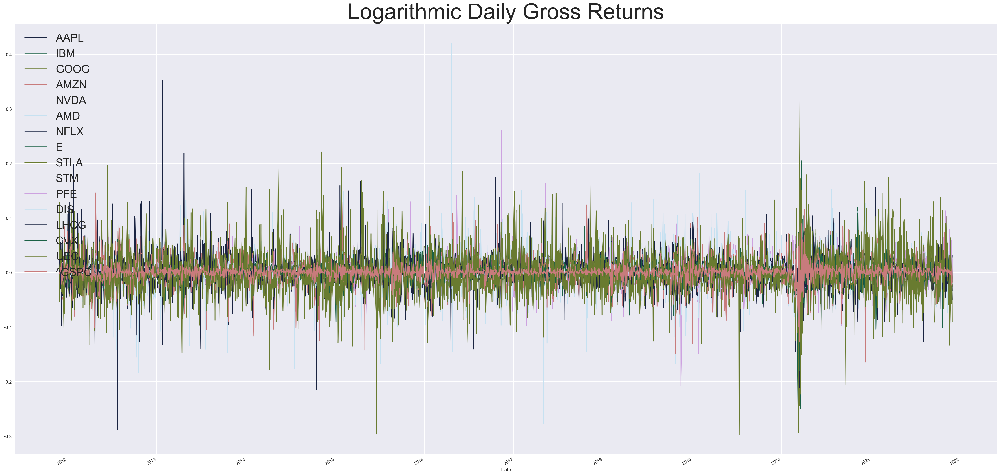

In [45]:
merged_yield.plot(figsize=(40, 20))
plt.legend(loc=2, prop={'size': 25})
plt.title("Logarithmic Daily Gross Returns", fontsize=50)

Plotting each yields separately

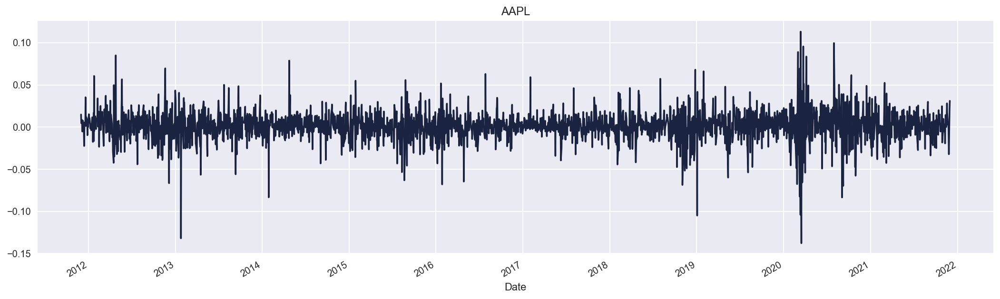

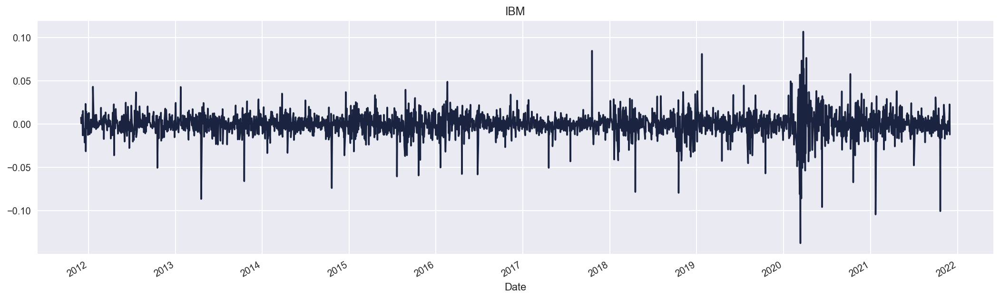

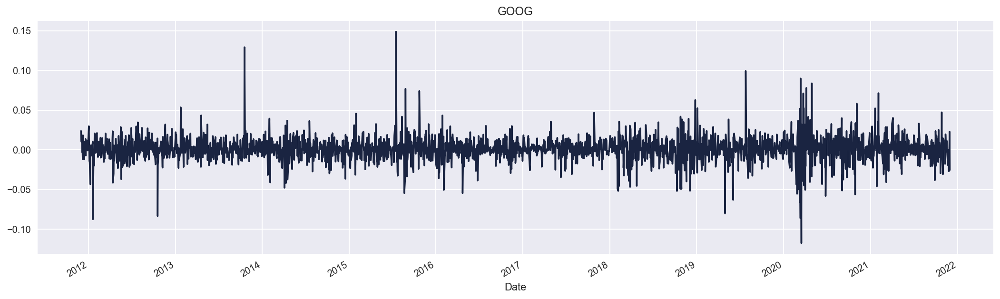

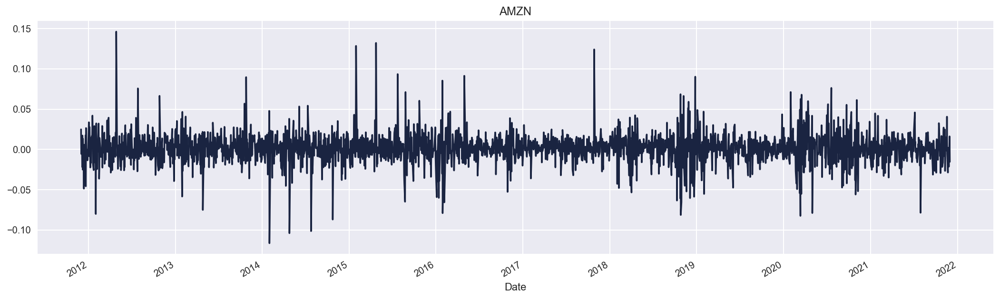

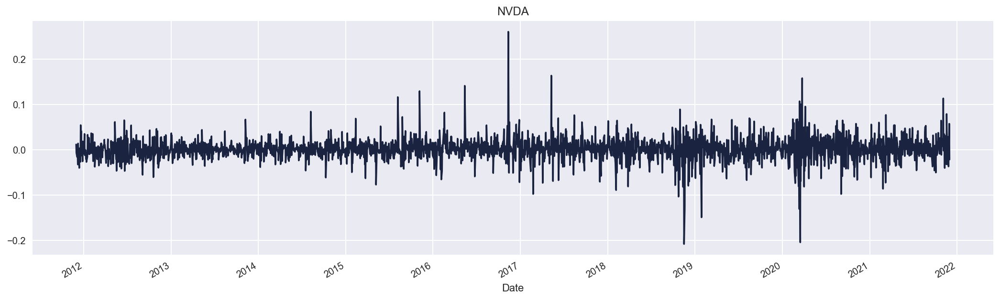

...

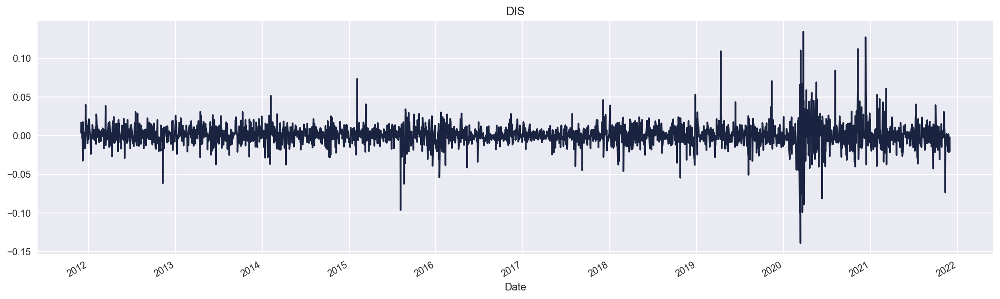

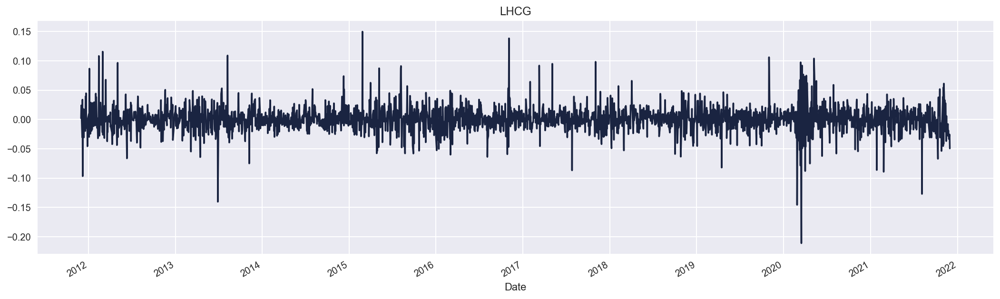

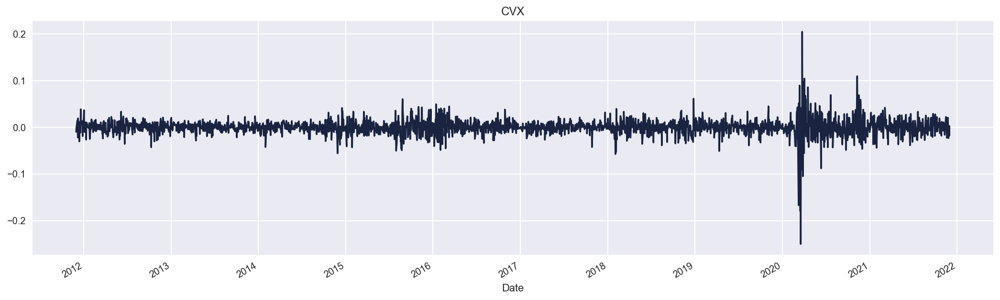

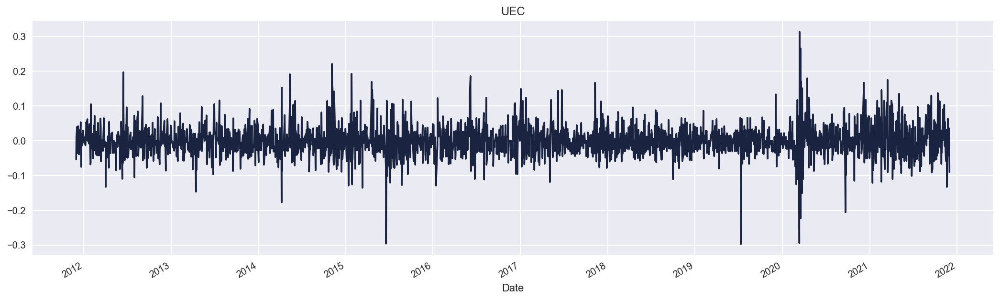

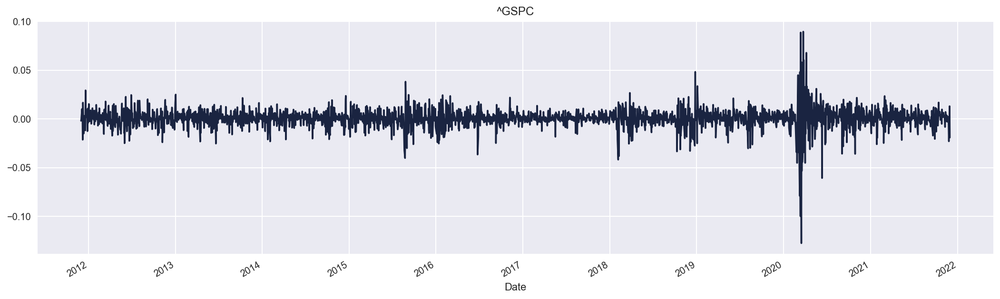

In [46]:
for col in merged_yield.columns:
    merged_yield[col].plot(figsize=(18, 5))
    plt.title(col)
    plt.show()


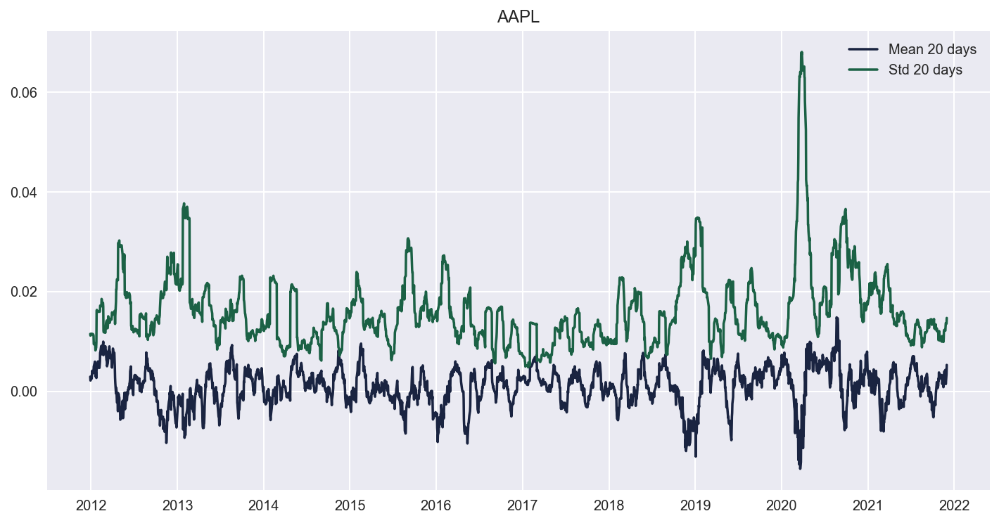

Correlation:  -0.3512064979950179


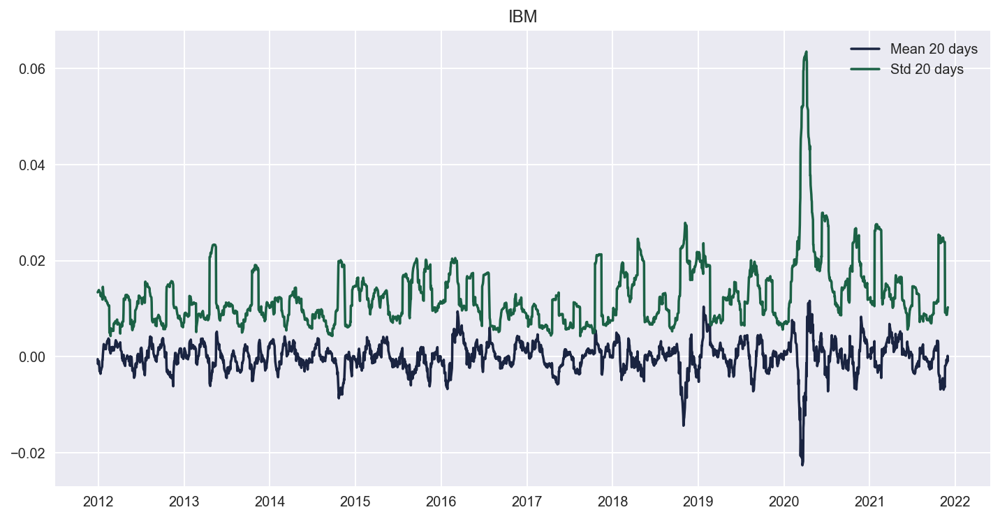

Correlation:  -0.3172480485732789


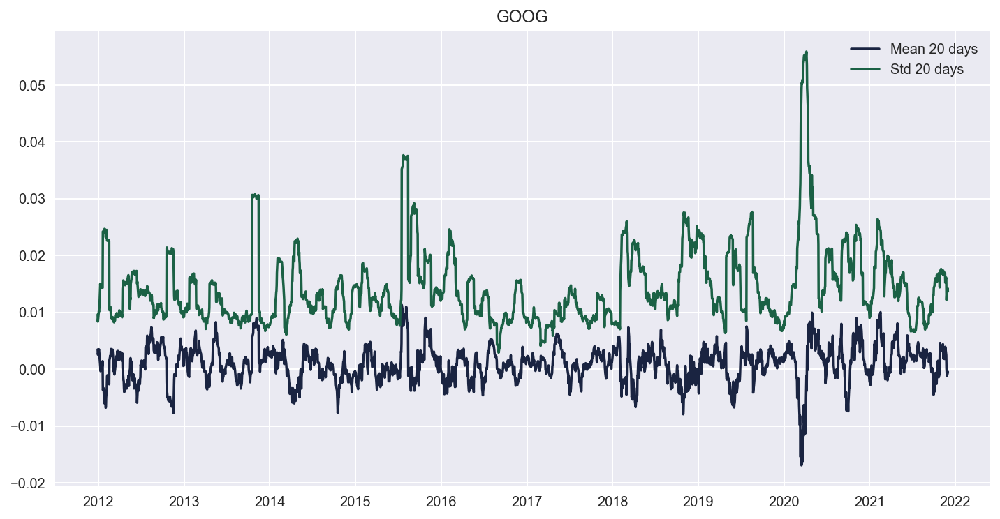

Correlation:  -0.1473967808805807


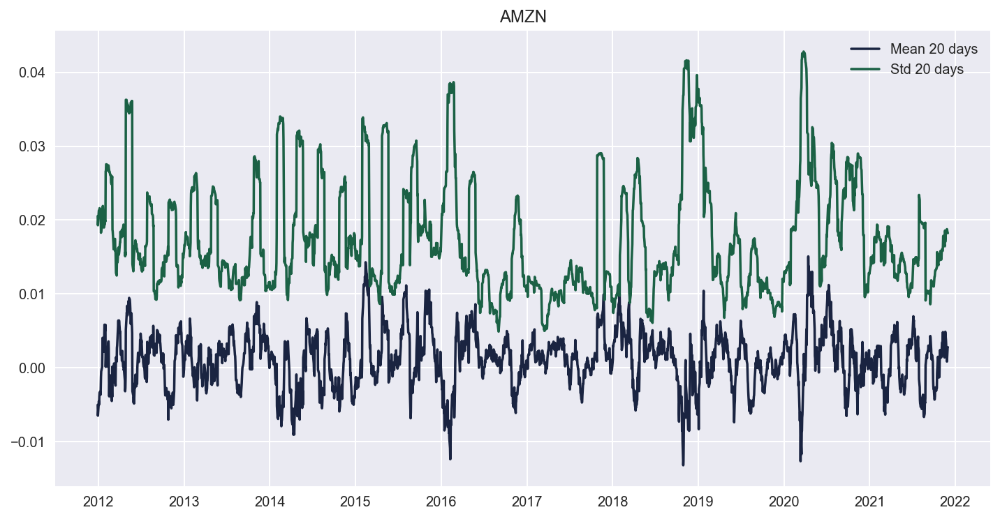

Correlation:  -0.11521943899483202


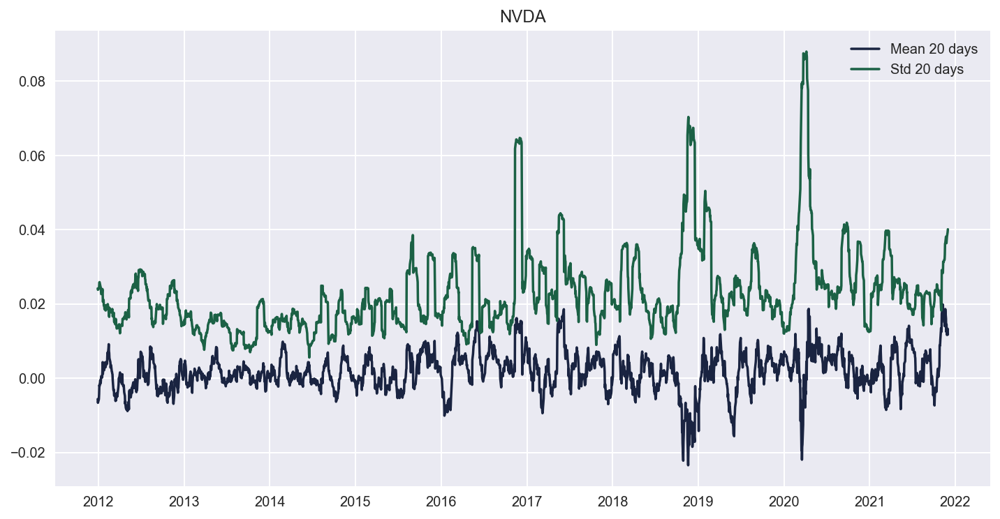

Correlation:  -0.046512932765143


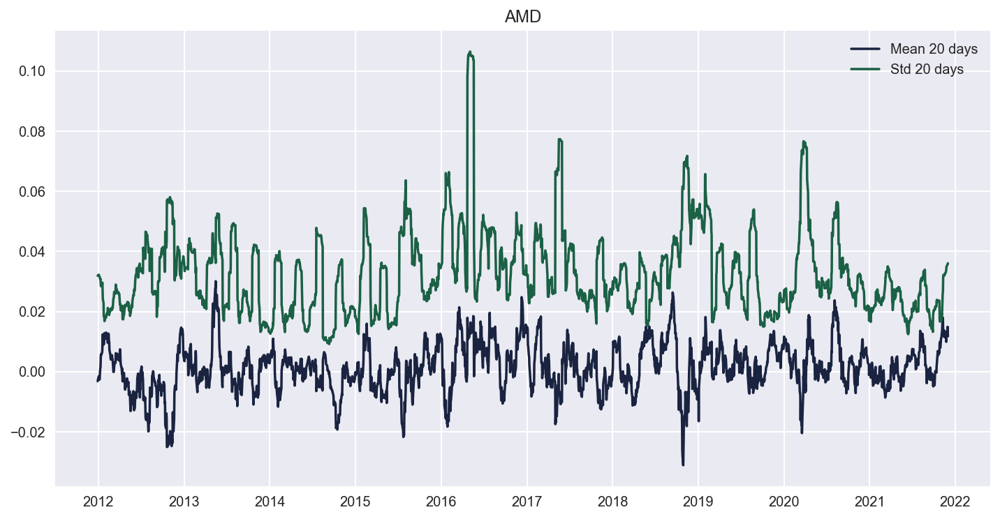

Correlation:  -0.02396438449531155


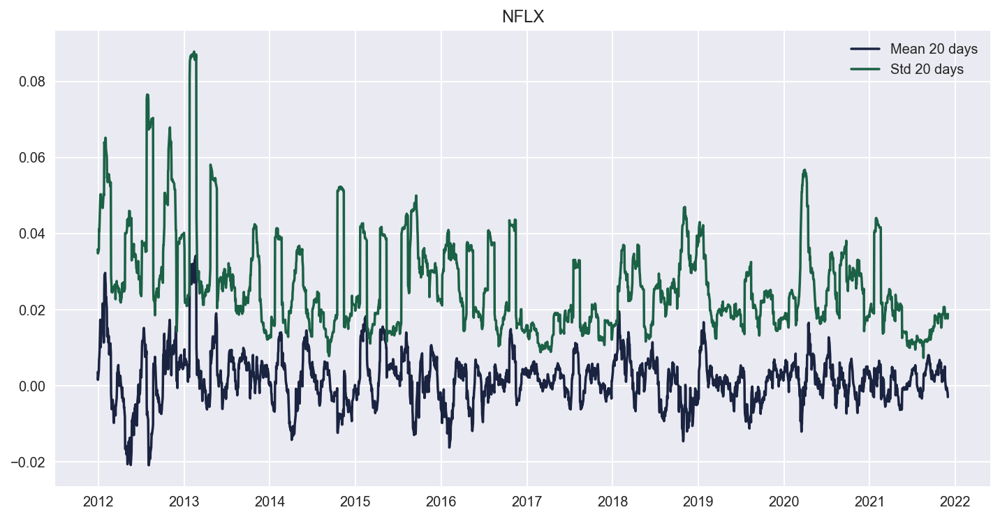

Correlation:  0.19681394790120854


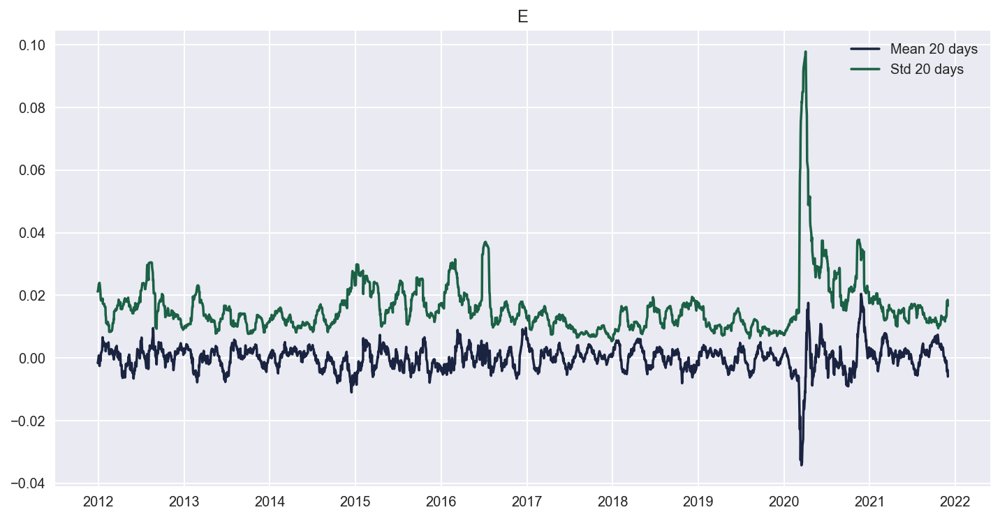

Correlation:  -0.26527645429660524


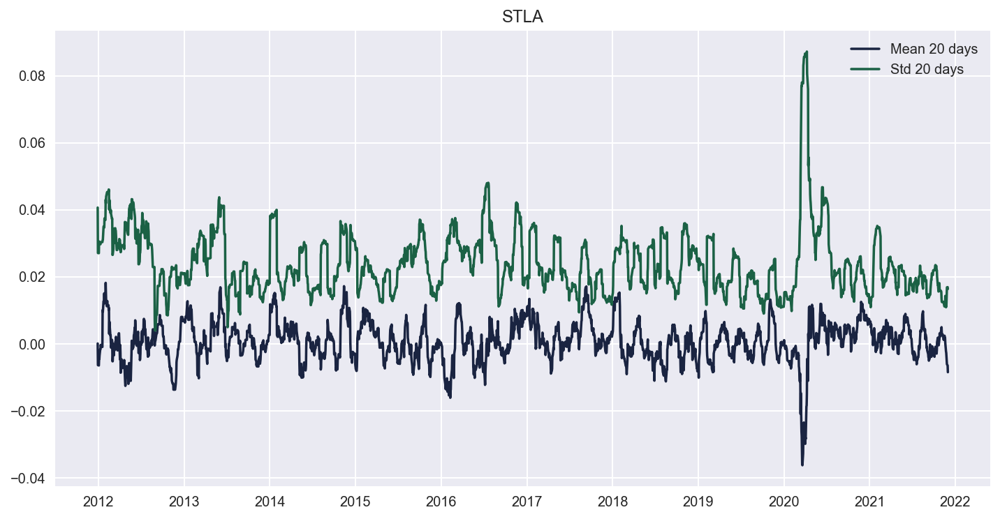

Correlation:  -0.1549718623475361


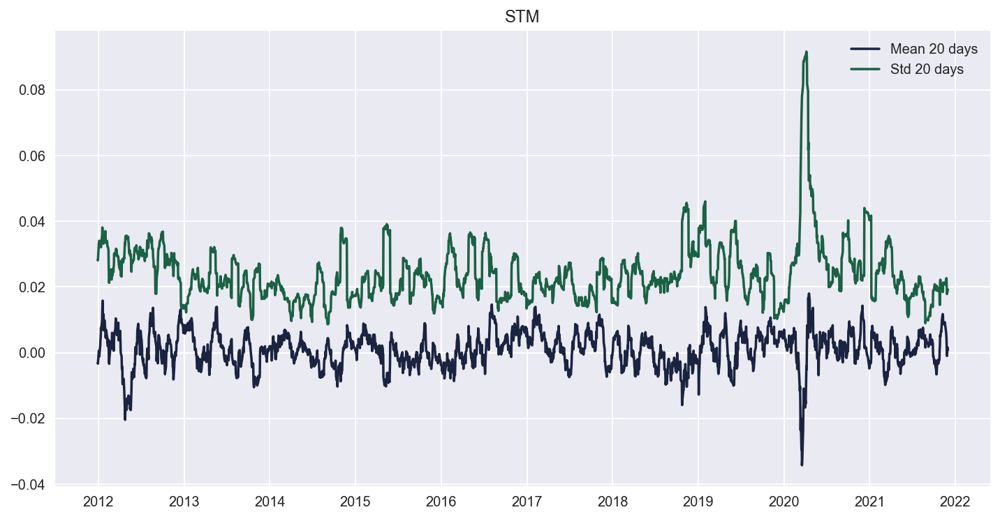

Correlation:  -0.26473528482227265


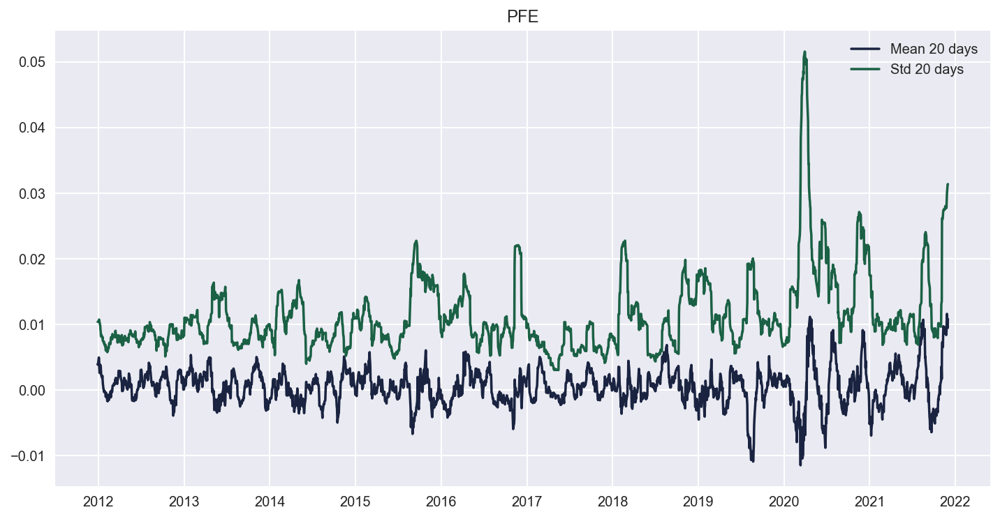

Correlation:  -0.06781742060449147


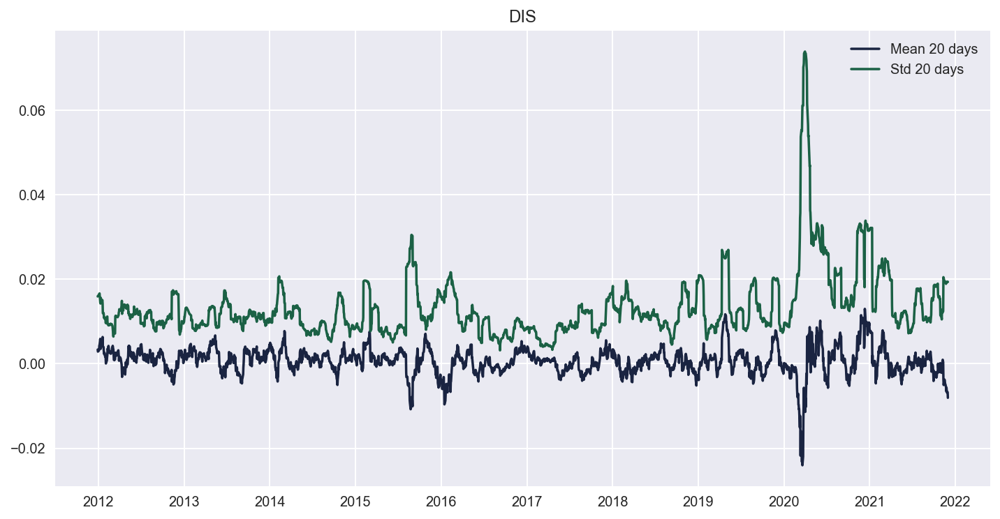

Correlation:  -0.10612711667330535


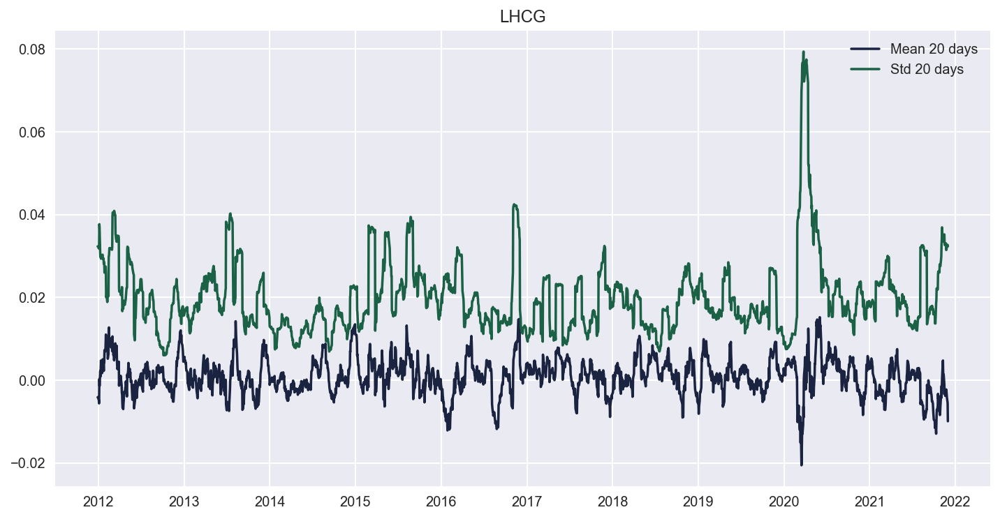

Correlation:  -0.0030896872388939


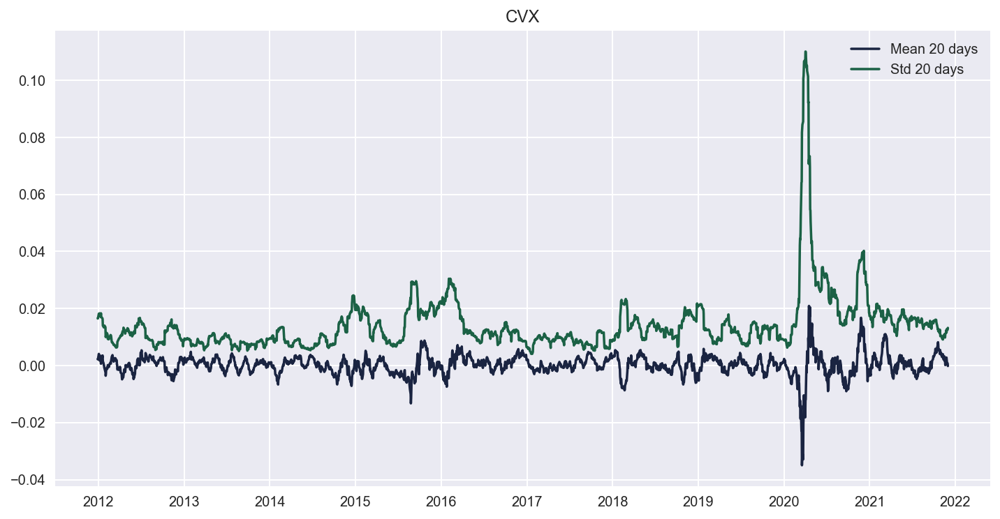

Correlation:  -0.1812259375588576


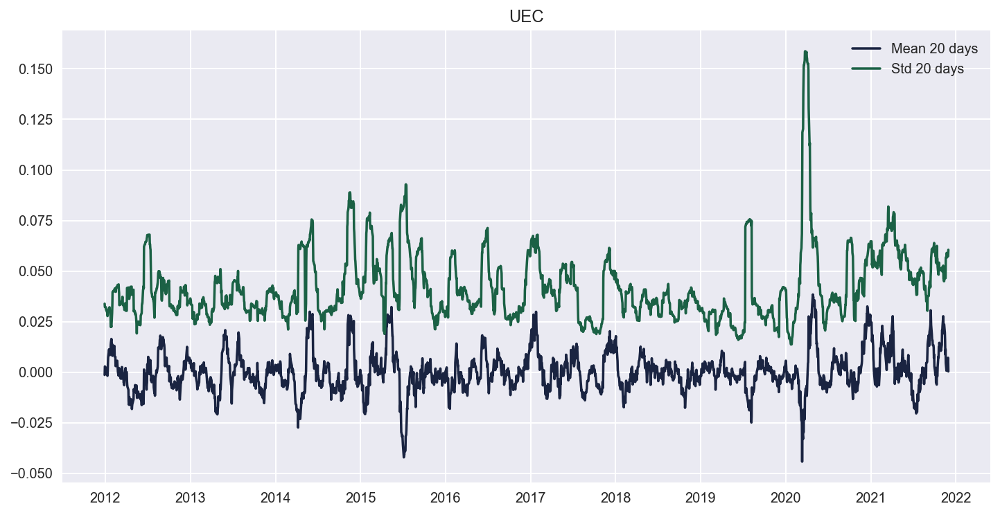

Correlation:  0.156311238634807


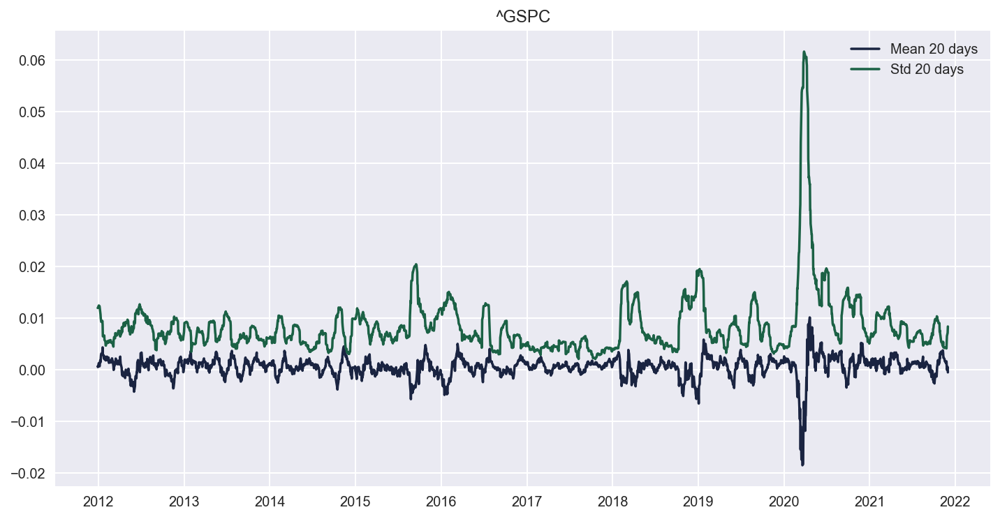

Correlation:  -0.44339652493633563


In [47]:


for col in merged_yield.columns:
    plt.figure(figsize=(12, 6))
    plt.plot( merged_yield[col].rolling(20).mean(), label="Mean 20 days")
    plt.plot(merged_yield[col].rolling(20).std(), label="Std 20 days")
    
    plt.legend(loc="best")
    plt.title(f"{col}")
    plt.show()
    print("Correlation: ", merged_yield[col].rolling(20).mean().corr(merged_yield[col].rolling(20).std()))

In [48]:
merged_yield[col].rolling(20).mean()

Date
2011-12-01         NaN
2011-12-02         NaN
2011-12-05         NaN
2011-12-06         NaN
2011-12-07         NaN
                ...   
2021-11-23    0.001251
2021-11-24    0.001619
2021-11-26   -0.000020
2021-11-29    0.000539
2021-11-30   -0.000508
Name: ^GSPC, Length: 2516, dtype: float64

In [49]:
merged_yield["AMD"][merged_yield["AMD"] > 0.2]

Date
2016-04-22    0.420617
Name: AMD, dtype: float64

In [50]:
merged_yield.cov()

,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC
AAPL,0.000318,0.000099,0.000146,0.000150,0.000215,0.000214,0.000144,0.000107,0.000124,0.000205,0.000069,0.000100,0.000112,0.000107,0.000186,0.000122
IBM,0.000099,0.000210,0.000096,0.000082,0.000129,0.000146,0.000076,0.000132,0.000135,0.000145,0.000075,0.000100,0.000082,0.000127,0.000165,0.000099
GOOG,0.000146,0.000096,0.000250,0.000174,0.000195,0.000162,0.000177,0.000109,0.000129,0.000174,0.000071,0.000103,0.000110,0.000105,0.000166,0.000113
AMZN,0.000150,0.000082,0.000174,0.000360,0.000210,0.000212,0.000237,0.000094,0.000116,0.000175,0.000059,0.000092,0.000104,0.000076,0.000151,0.000108
NVDA,0.000215,0.000129,0.000195,0.000210,0.000644,0.000457,0.000247,0.000140,0.000198,0.000338,0.000079,0.000128,0.000153,0.000141,0.000247,0.000156
AMD,0.000214,0.000146,0.000162,0.000212,0.000457,0.001280,0.000266,0.000174,0.000205,0.000366,0.000092,0.000136,0.000147,0.000157,0.000304,0.000161
NFLX,0.000144,0.000076,0.000177,0.000237,0.000247,0.000266,0.000871,0.000099,0.000126,0.000202,0.000055,0.000088,0.000112,0.000076,0.000184,0.000113
E,0.000107,0.000132,0.000109,0.000094,0.000140,0.000174,0.000099,0.000341,0.000217,0.000226,0.000080,0.000132,0.000098,0.000223,0.000282,0.000122
STLA,0.000124,0.000135,0.000129,0.000116,0.000198,0.000205,0.000126,0.000217,0.000682,0.000270,0.000083,0.000139,0.000118,0.000172,0.000275,0.000128
STM,0.000205,0.000145,0.000174,0.000175,0.000338,0.000366,0.000202,0.000226,0.000270,0.000663,0.000086,0.000150,0.000148,0.000180,0.000328,0.000163


Plotting Heatmap yields's Pearson Correlation 

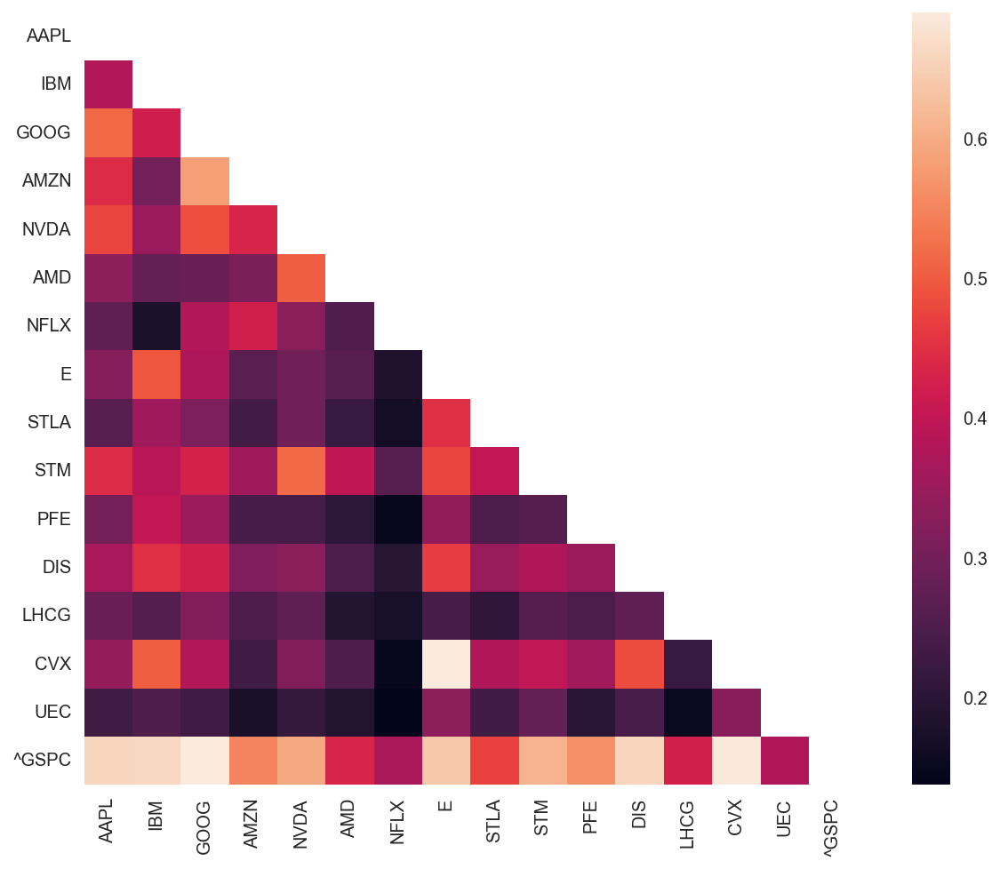

In [51]:
corr = merged_yield.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(11, 8))
    ax = sns.heatmap(corr, mask=mask, square=True)

Searching best pearson correlation scores

In [52]:
corr_df = merged_yield.corr()

best_corr = pd.Series()

for col in corr_df.columns:
    for i in corr_df.index:
        if col != i:
            val = corr_df.loc[i][col]
            if ((val > 0.5) or (val < -0.5)):
                print(f"{i} - {col} correlation: {val}")
                pair = [i, col]
                pair.sort()
                key = f"{pair[0]}_{pair[1]}"
                if key not in best_corr.index:
                    best_corr[key] = val

                    


GOOG - AAPL correlation: 0.5165642761058432
^GSPC - AAPL correlation: 0.6600089689375002
CVX - IBM correlation: 0.5032473700139
^GSPC - IBM correlation: 0.6620765241091918
AAPL - GOOG correlation: 0.5165642761058432
AMZN - GOOG correlation: 0.5809865381279399
^GSPC - GOOG correlation: 0.690044043946374
GOOG - AMZN correlation: 0.5809865381279399
^GSPC - AMZN correlation: 0.5495143034642501
AMD - NVDA correlation: 0.5034204632583933
STM - NVDA correlation: 0.5172805397098431
^GSPC - NVDA correlation: 0.595922380604553
NVDA - AMD correlation: 0.5034204632583933
CVX - E correlation: 0.690659587450823
^GSPC - E correlation: 0.6406379763136283
NVDA - STM correlation: 0.5172805397098431
^GSPC - STM correlation: 0.609797153460297
^GSPC - PFE correlation: 0.5634182774159133
^GSPC - DIS correlation: 0.6586007823816739
IBM - CVX correlation: 0.5032473700139
E - CVX correlation: 0.690659587450823
^GSPC - CVX correlation: 0.6871160443553678
AAPL - ^GSPC correlation: 0.6600089689375002
IBM - ^GSPC 

C:\Users\samue\AppData\Local\Temp/ipykernel_13520/2474994879.py:3: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  best_corr = pd.Series()


Plotting best pearson correlation scores including the market

<AxesSubplot:>

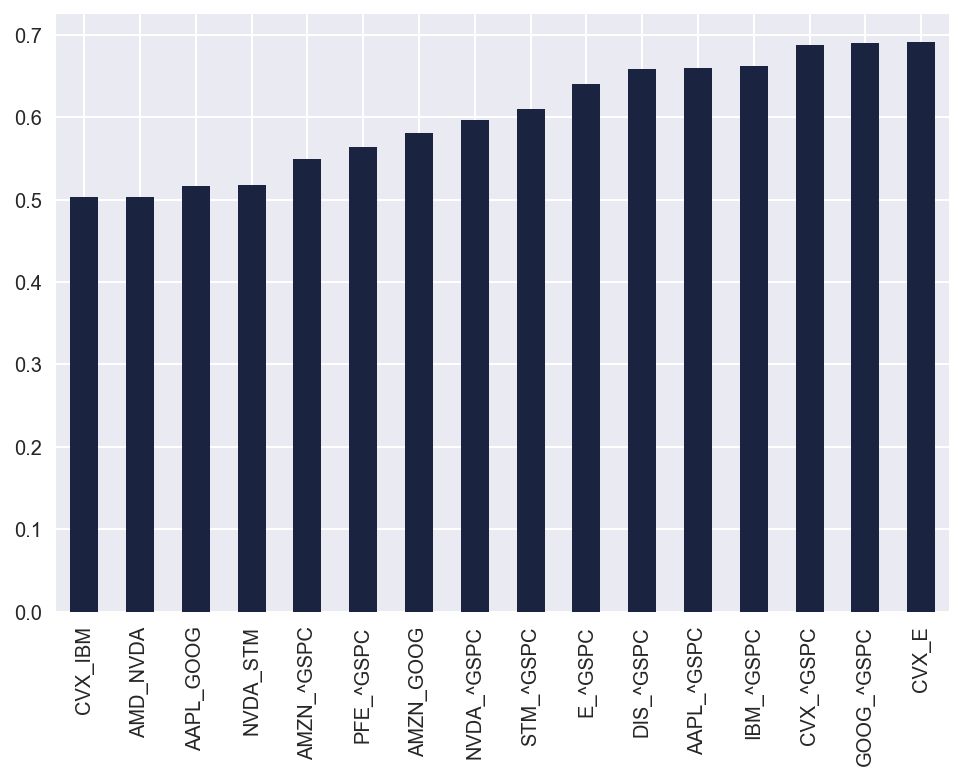

In [53]:
best_corr.sort_values().plot(kind="bar")

Plotting best pearson correlation scores excluding the market

<AxesSubplot:>

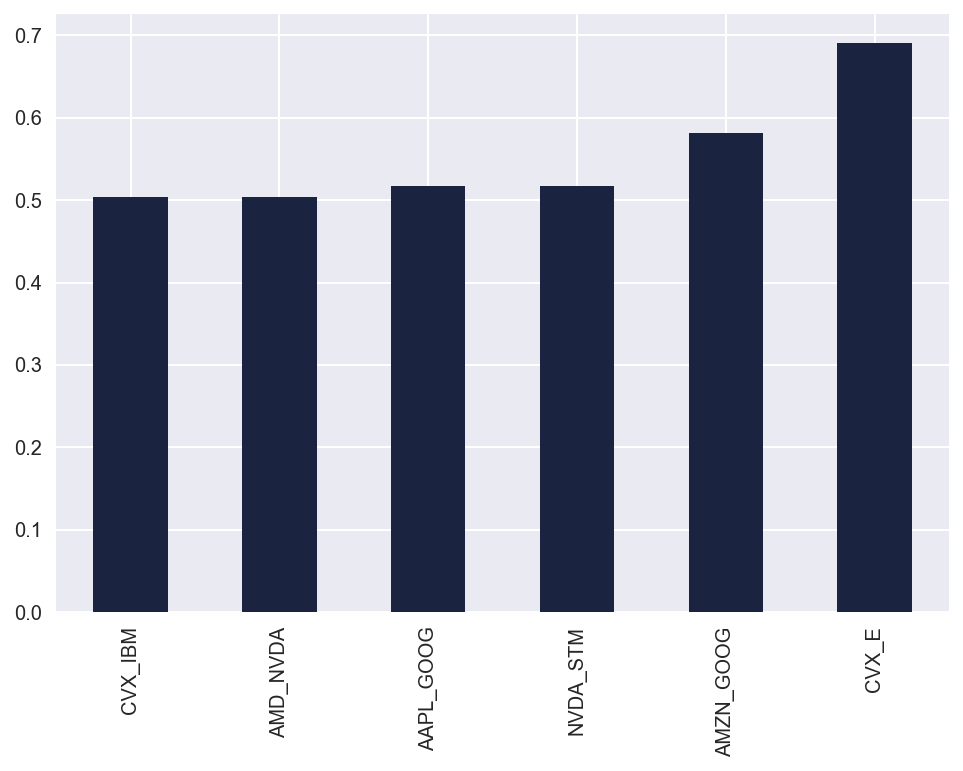

In [54]:
best_corr[[col for col in best_corr.index if '^GSPC' not in col]].sort_values().plot(kind="bar")

Comparison by chart of the best "yields-related" stocks

AAPL field = 0    Informatica
Name: field, dtype: object
GOOG field = 2    Informatica
Name: field, dtype: object
Correlation: 0.5165642761058432


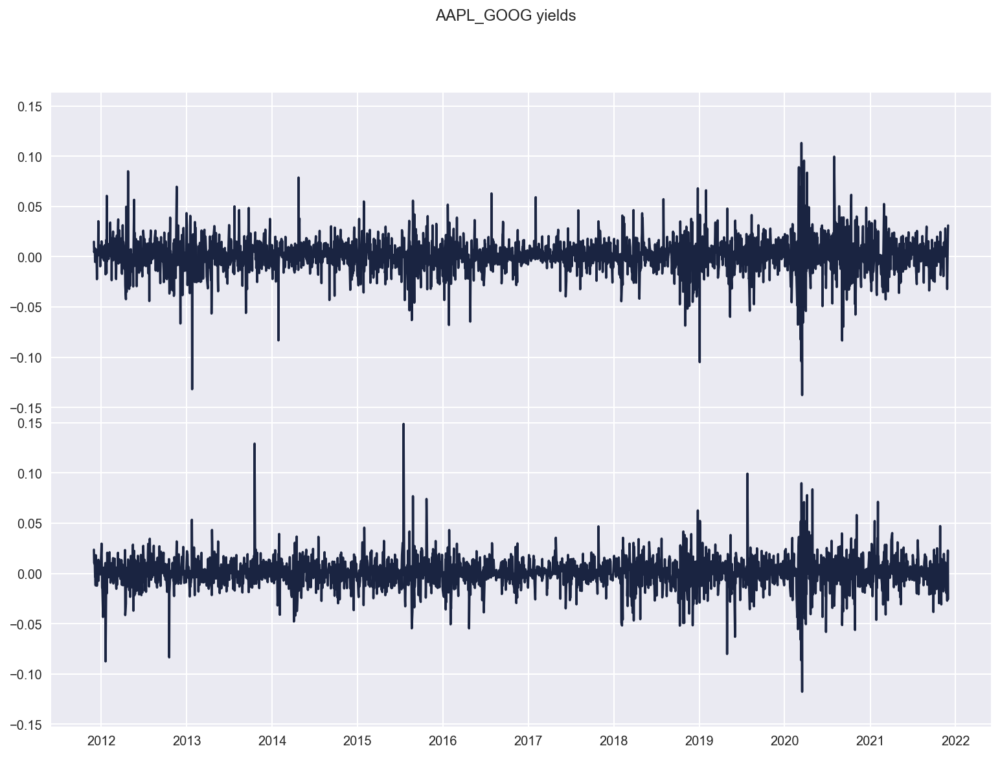

CVX field = 13    Energia
Name: field, dtype: object
IBM field = 1    Informatica
Name: field, dtype: object
Correlation: 0.5032473700139


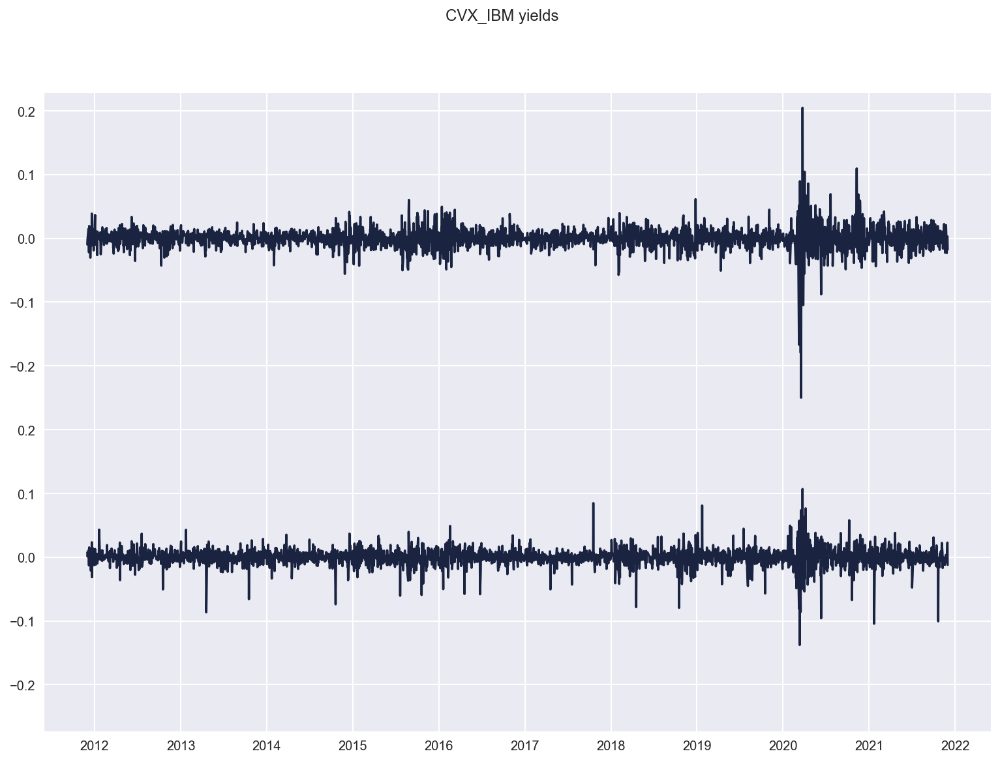

AMZN field = 3    Informatica
Name: field, dtype: object
GOOG field = 2    Informatica
Name: field, dtype: object
Correlation: 0.5809865381279399


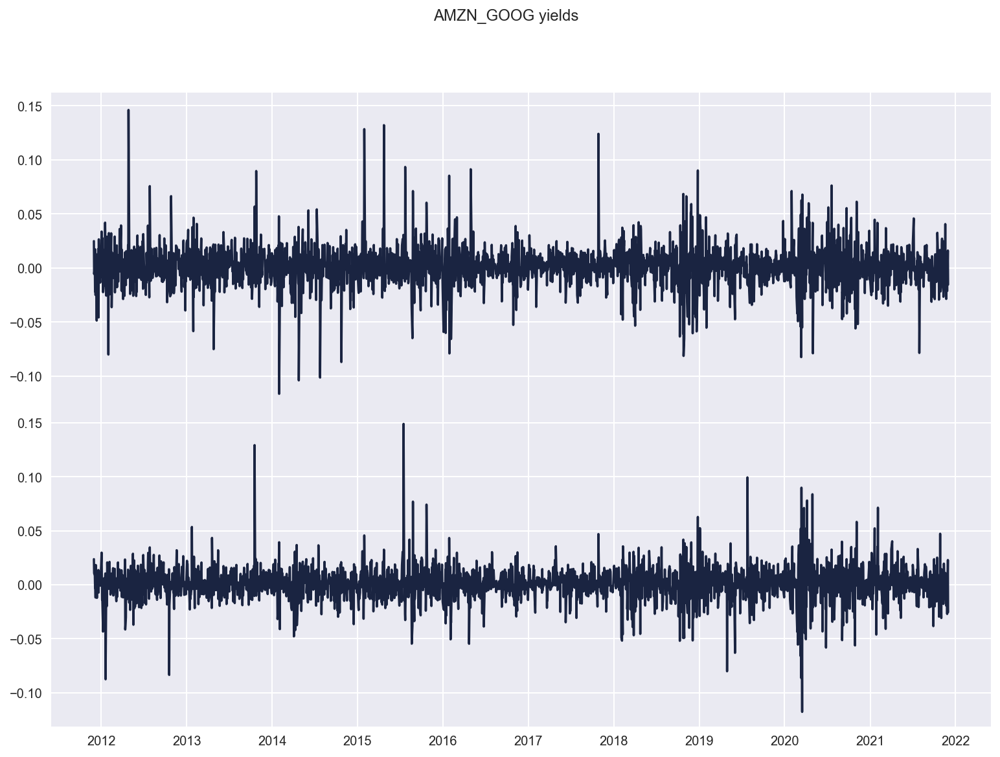

AMD field = 5    Elettronica
Name: field, dtype: object
NVDA field = 4    Elettronica
Name: field, dtype: object
Correlation: 0.5034204632583933


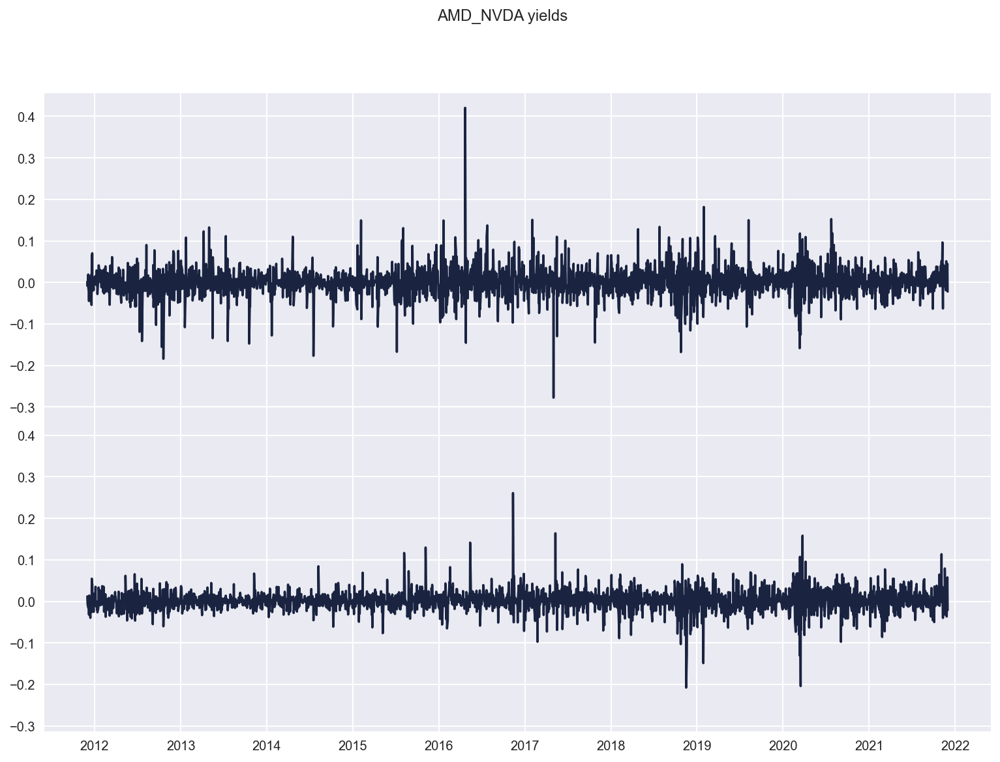

NVDA field = 4    Elettronica
Name: field, dtype: object
STM field = 9    Elettronica
Name: field, dtype: object
Correlation: 0.5172805397098431


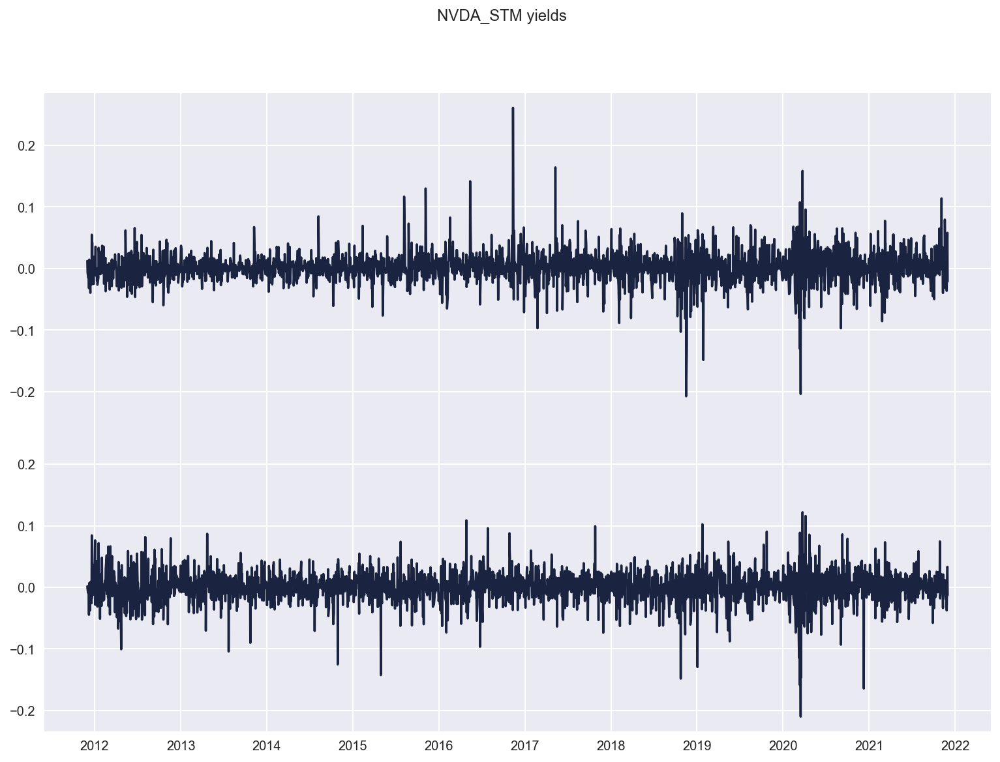

CVX field = 13    Energia
Name: field, dtype: object
E field = 7    Energia
Name: field, dtype: object
Correlation: 0.690659587450823


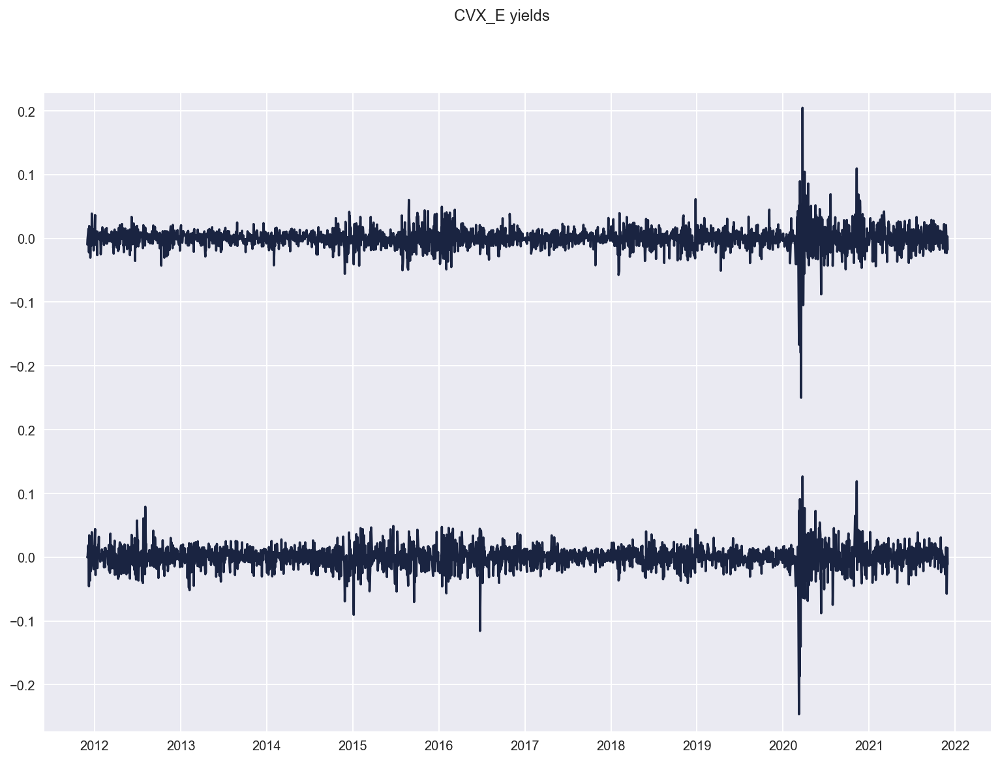

In [55]:
for col in [i for i in best_corr.index if '^GSPC' not in i]:
    columns = col.split("_")

    fig = plt.figure(figsize=(13, 9))
    gs = fig.add_gridspec(2, hspace=0)
    axs = gs.subplots(sharex=True, sharey=True)
    
    fig.suptitle(f"{col} yields")
    axs[0].plot(merged_yield.index, merged_yield[columns[0]])
    axs[1].plot(merged_yield.index, merged_yield[columns[1]])
    
    print(f"{columns[0]} field = {stocks_df[stocks_df['ticker'] == columns[0]]['field']}")
    print(f"{columns[1]} field = {stocks_df[stocks_df['ticker'] == columns[1]]['field']}")
    print(f"Correlation: {best_corr[col]}")

    plt.show()
    

Best "related-yields" stocks ScatterPlot

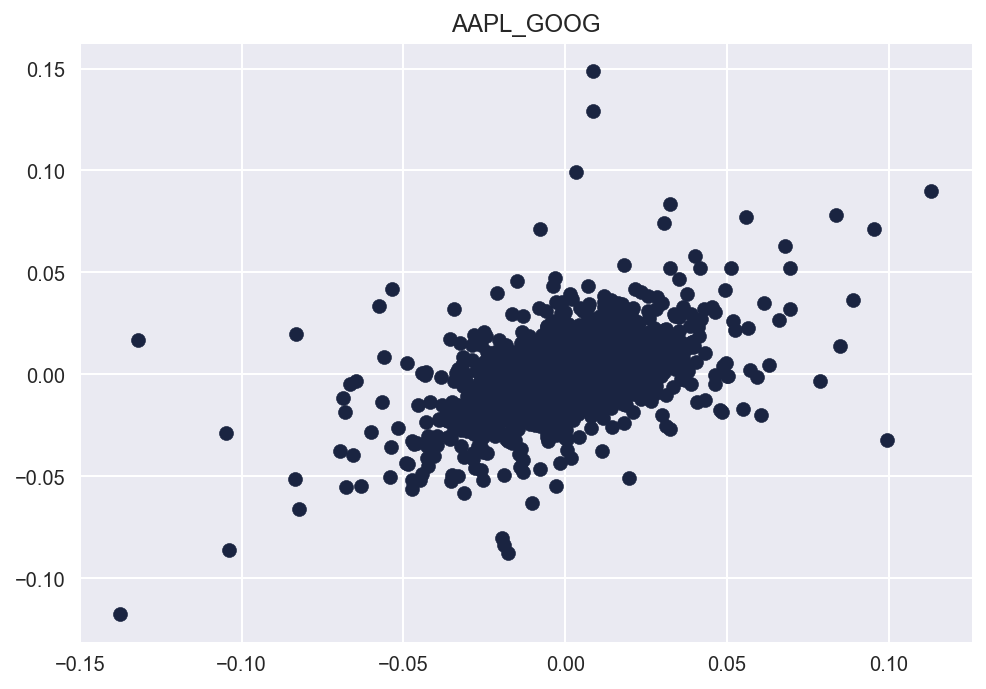

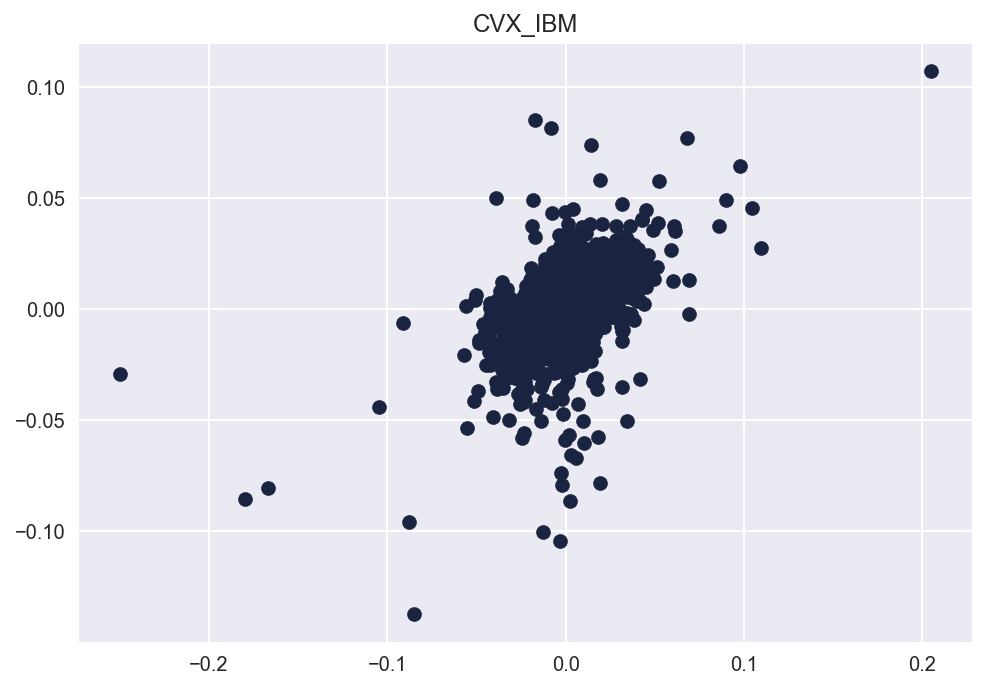

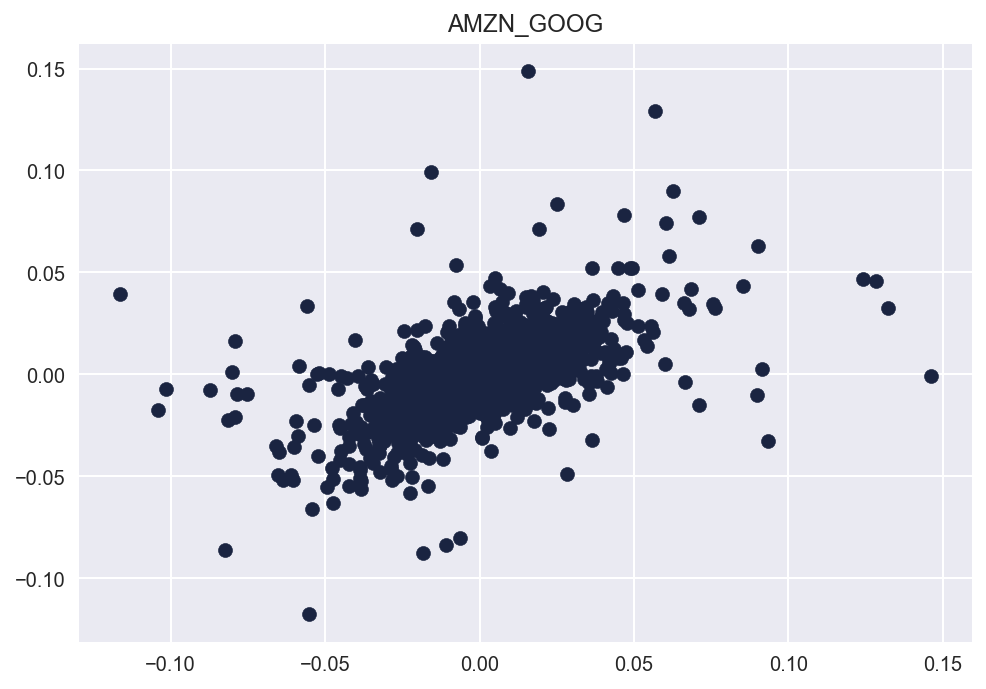

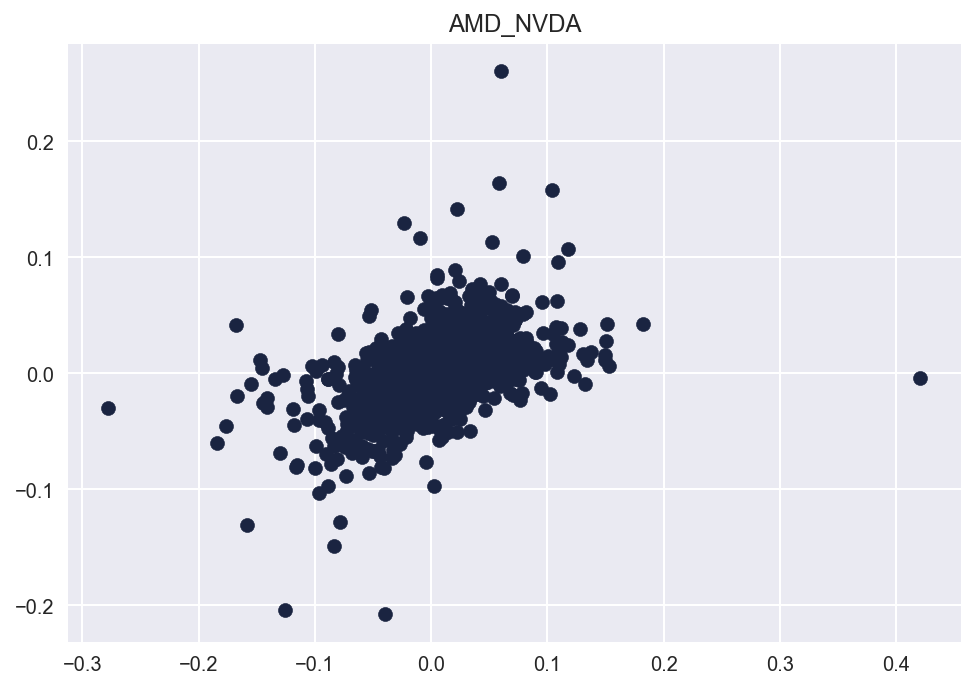

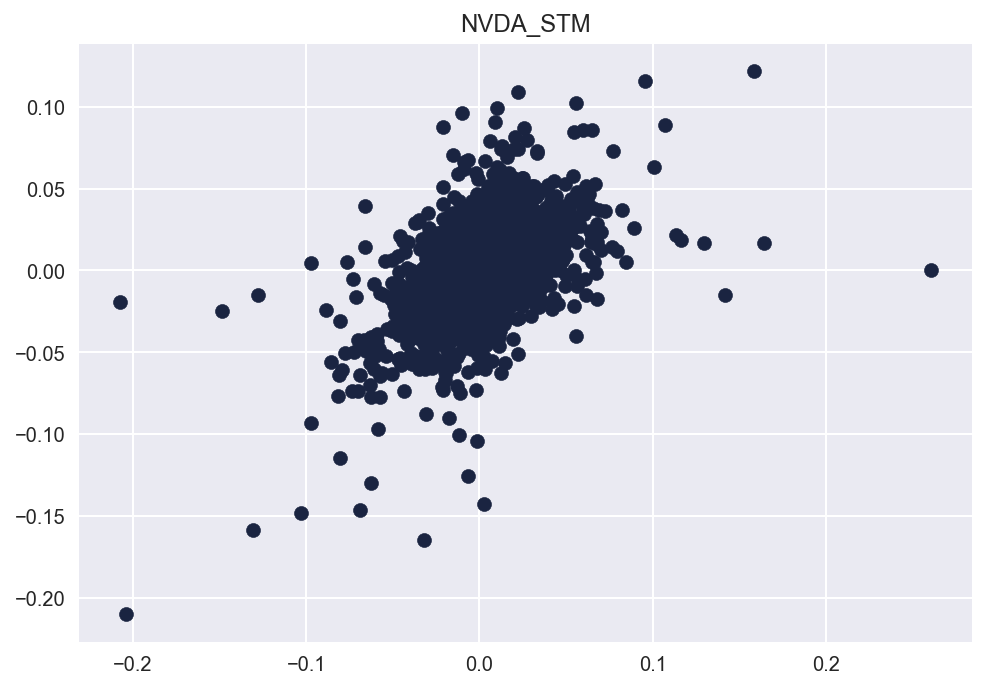

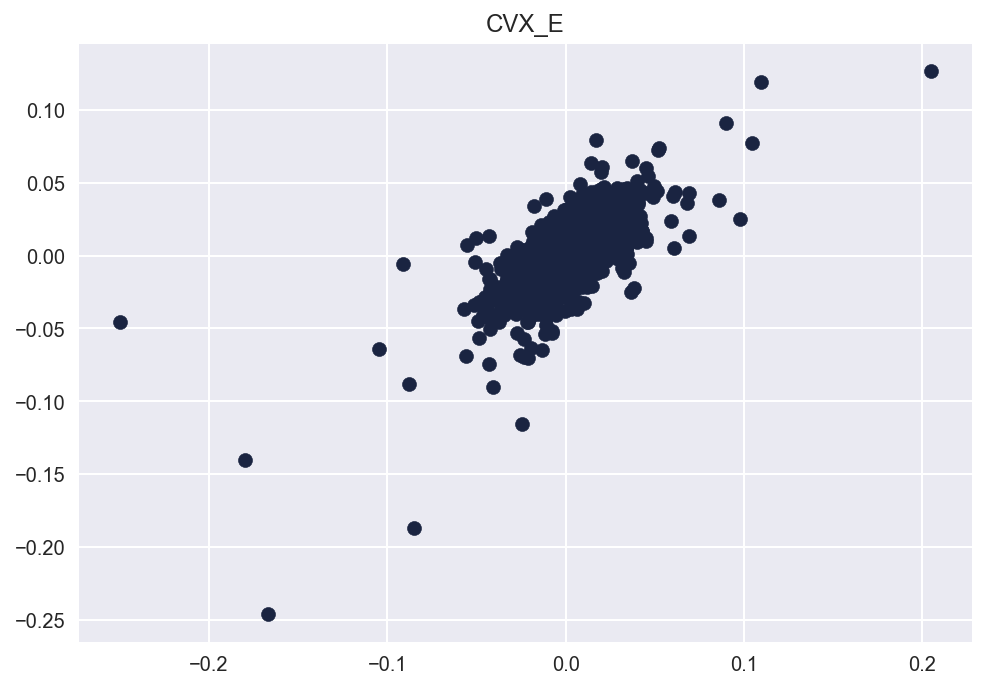

In [56]:
for col in [i for i in best_corr.index if '^GSPC' not in i]:
    columns = col.split("_")
    
    plt.scatter(merged_yield[columns[0]], merged_yield[columns[1]])
    plt.title(col)
    plt.show()

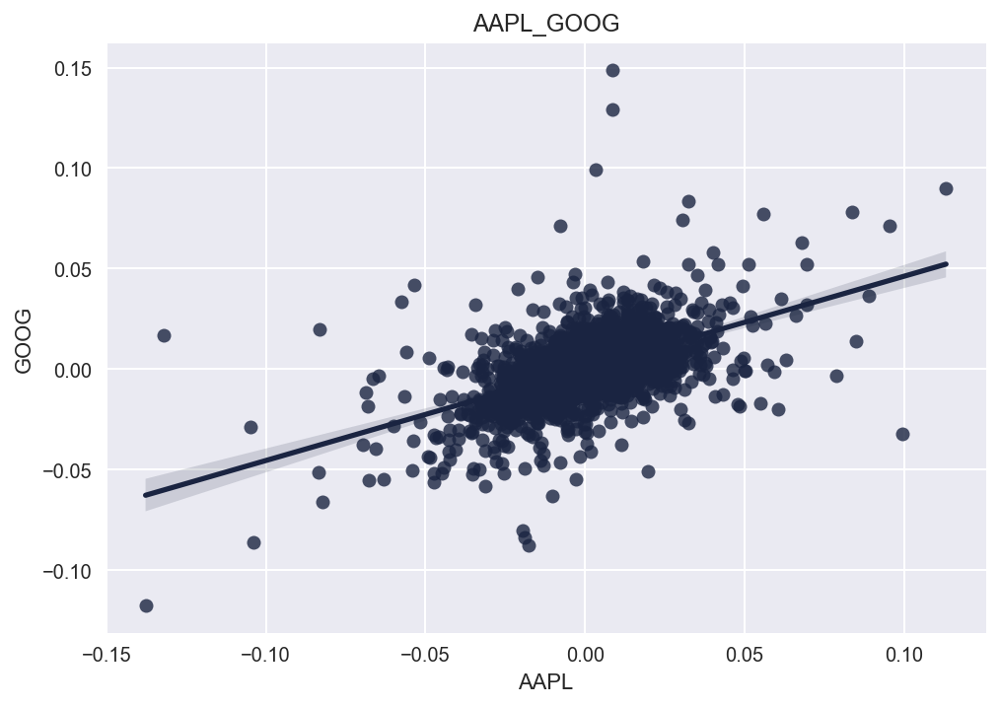

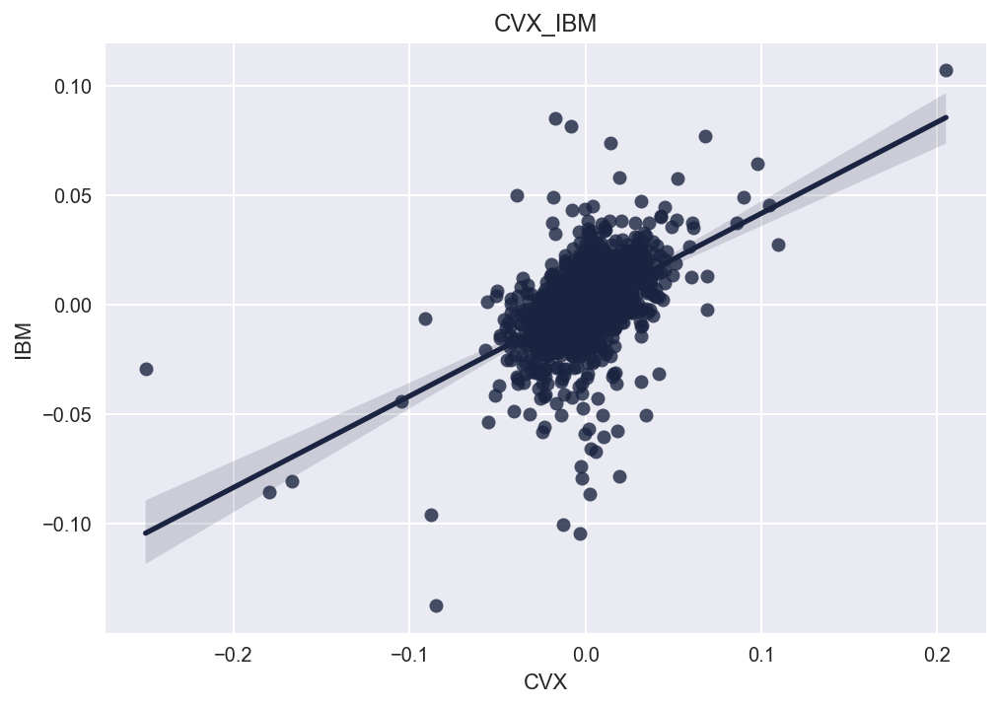

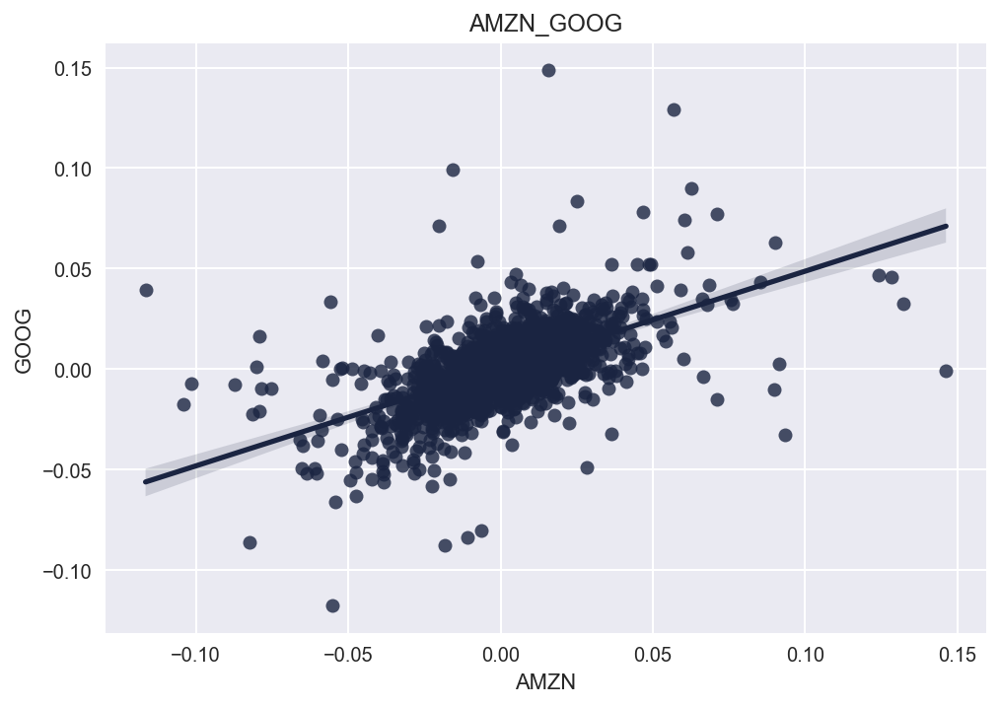

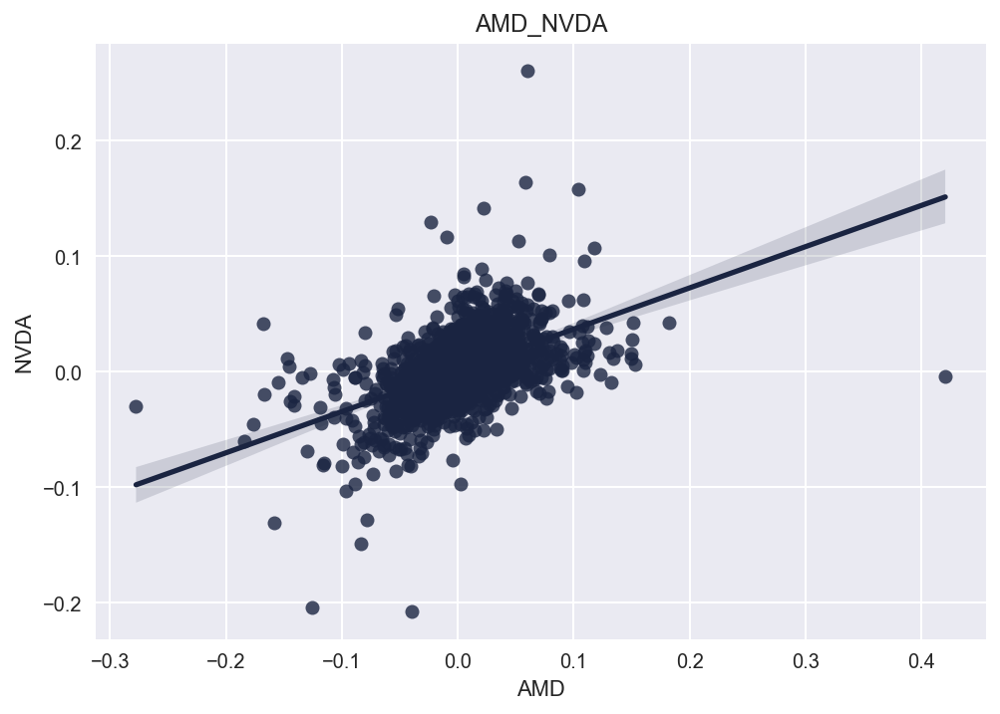

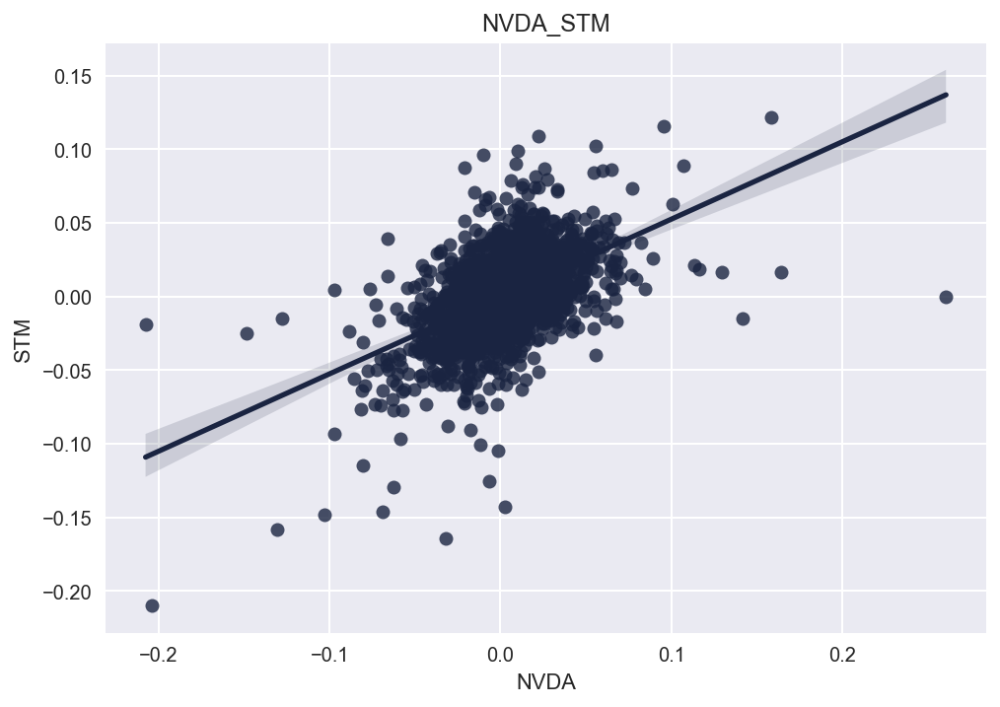

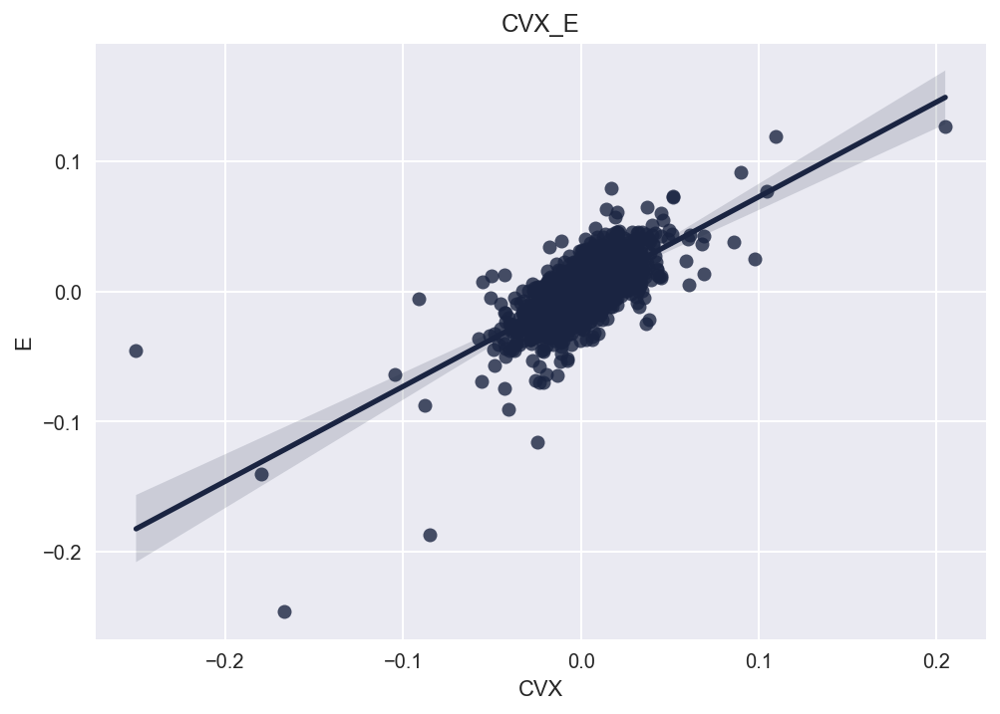

In [57]:
for col in [i for i in best_corr.index if '^GSPC' not in i]:
    columns = col.split("_")
    
    sns.regplot(x=columns[0], y=columns[1], data=merged_yield)
    plt.title(col)
    plt.show()

# Correlations Working on Monthly Yields

In [58]:
merged_yield_m = get_yields(tickers_and_market, log=True, f='M')

merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
merged UEC
merged ^GSPC
Collected df with shape: (2517, 96)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654808  180.066925  176.108994  176.453156  179.732315   
2011-12-01       11.829537  181.634796  17

## ANALISI DELL'EVOLUZIONE DELLA CORRELAZIONE DEI RENDIMENTI NEL TEMPO

^GSPC - AAPL correlation: 0.6398019110740162
E - IBM correlation: 0.5474809175422383
CVX - IBM correlation: 0.5669562281942511
^GSPC - IBM correlation: 0.6828497047579556
AMZN - GOOG correlation: 0.5008381747740039
^GSPC - GOOG correlation: 0.6644525123703917
GOOG - AMZN correlation: 0.5008381747740039
AMD - NVDA correlation: 0.5444446569241169
STM - NVDA correlation: 0.5556486763179133
^GSPC - NVDA correlation: 0.5227022480010796
NVDA - AMD correlation: 0.5444446569241169
IBM - E correlation: 0.5474809175422383
STLA - E correlation: 0.5225084668097727
DIS - E correlation: 0.5130399195599008
CVX - E correlation: 0.748587158094287
^GSPC - E correlation: 0.6431704296711334
E - STLA correlation: 0.5225084668097727
STM - STLA correlation: 0.5193869569555903
^GSPC - STLA correlation: 0.5613188839238844
NVDA - STM correlation: 0.5556486763179133
STLA - STM correlation: 0.5193869569555903
^GSPC - STM correlation: 0.5970818482206653
E - DIS correlation: 0.5130399195599008

C:\Users\samue\AppData\Local\Temp/ipykernel_13520/995480952.py:5: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  best_corr = pd.Series()



CVX - DIS correlation: 0.5913890170490552
^GSPC - DIS correlation: 0.6902756782013484
IBM - CVX correlation: 0.5669562281942511
E - CVX correlation: 0.748587158094287
DIS - CVX correlation: 0.5913890170490552
^GSPC - CVX correlation: 0.6955460765089088
AAPL - ^GSPC correlation: 0.6398019110740162
IBM - ^GSPC correlation: 0.6828497047579556
GOOG - ^GSPC correlation: 0.6644525123703917
NVDA - ^GSPC correlation: 0.5227022480010796
E - ^GSPC correlation: 0.6431704296711334
STLA - ^GSPC correlation: 0.5613188839238844
STM - ^GSPC correlation: 0.5970818482206653
DIS - ^GSPC correlation: 0.6902756782013484
CVX - ^GSPC correlation: 0.6955460765089088


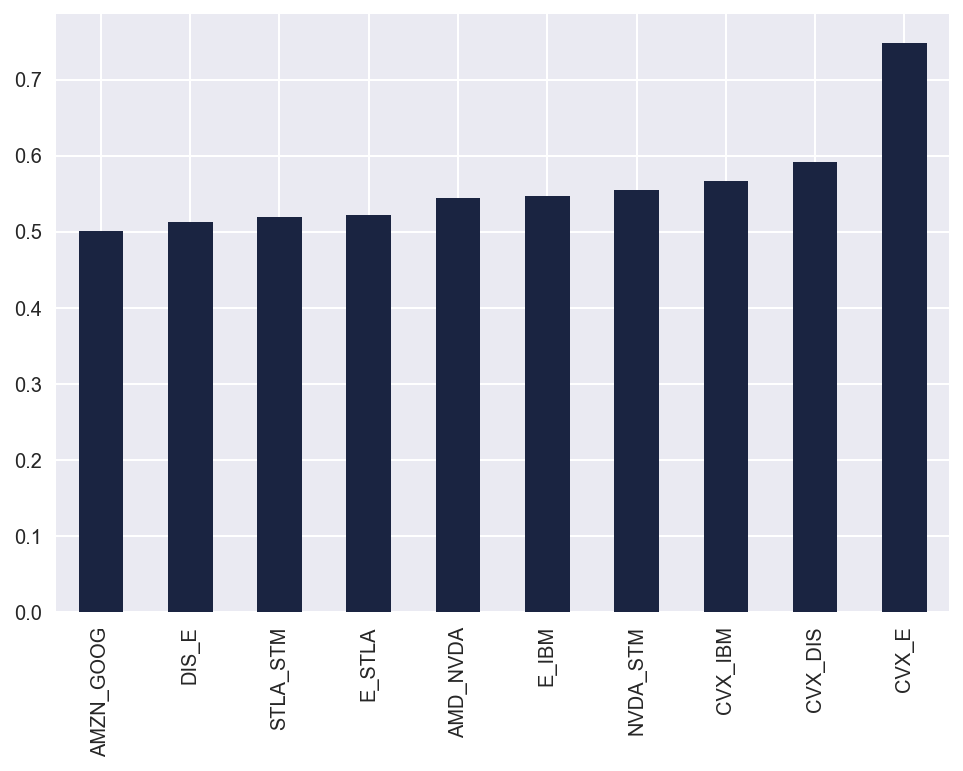

E field = 7    Energia
Name: field, dtype: object
IBM field = 1    Informatica
Name: field, dtype: object
Correlation: 0.5474809175422383


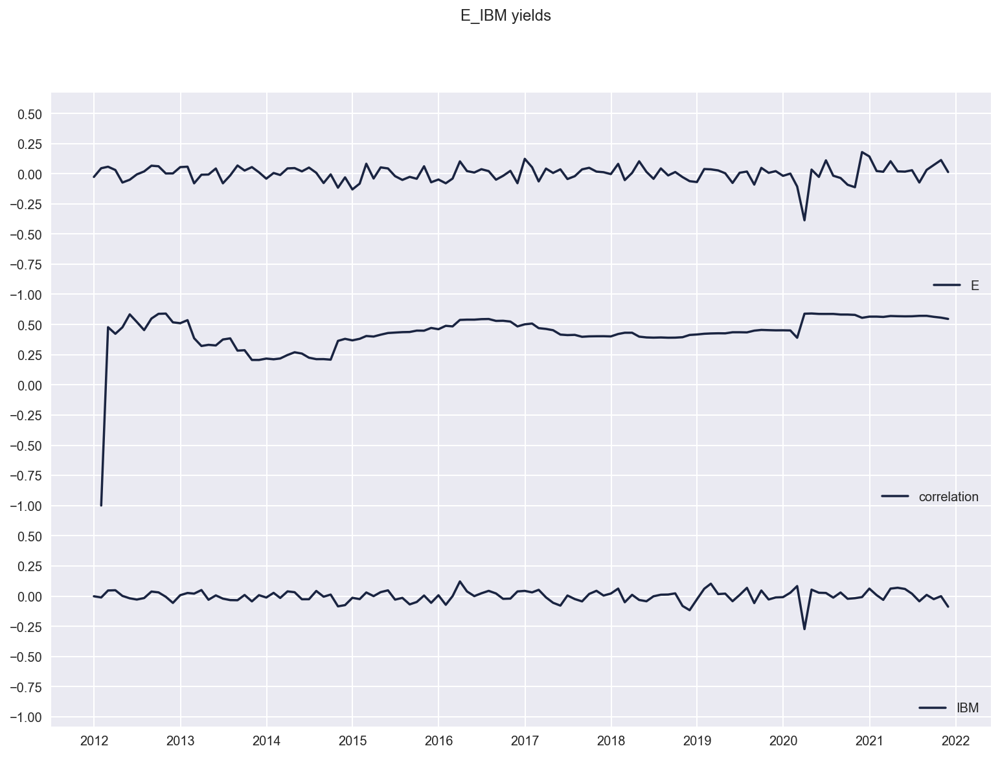

CVX field = 13    Energia
Name: field, dtype: object
IBM field = 1    Informatica
Name: field, dtype: object
Correlation: 0.5669562281942511


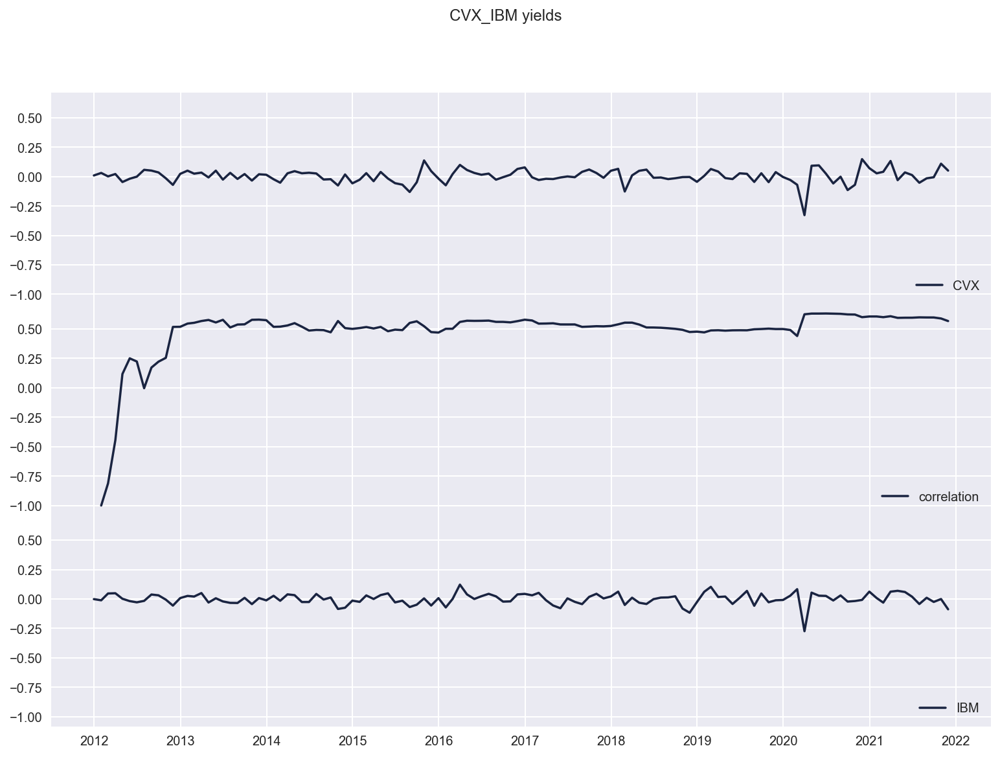

AMZN field = 3    Informatica
Name: field, dtype: object
GOOG field = 2    Informatica
Name: field, dtype: object
Correlation: 0.5008381747740039


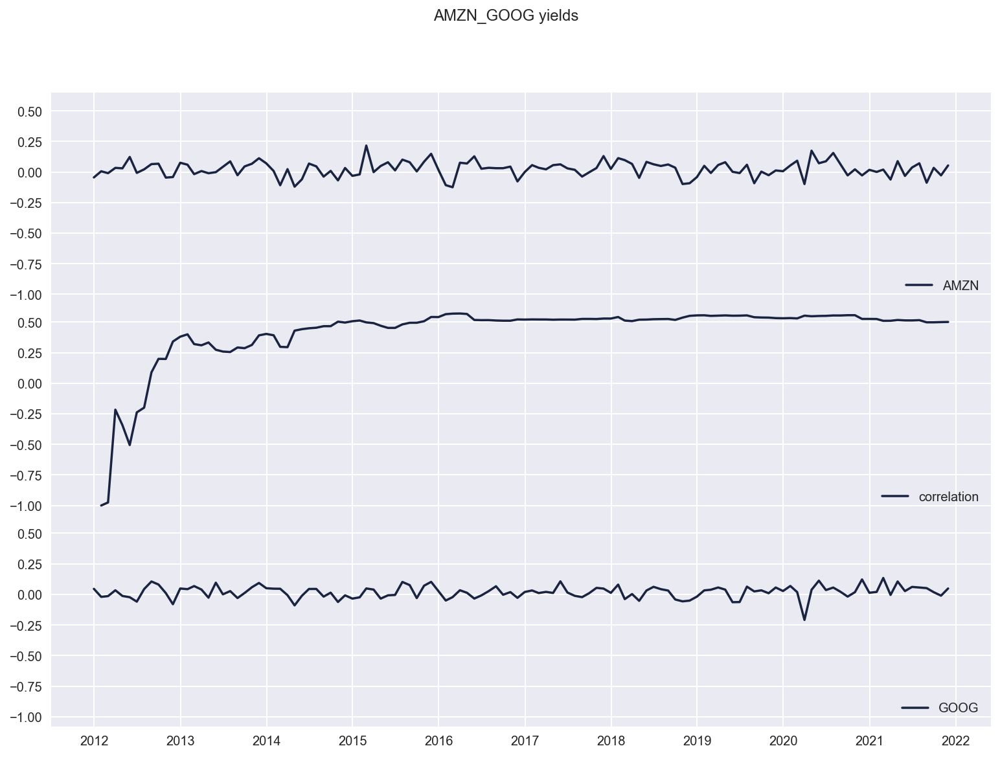

AMD field = 5    Elettronica
Name: field, dtype: object
NVDA field = 4    Elettronica
Name: field, dtype: object
Correlation: 0.5444446569241169


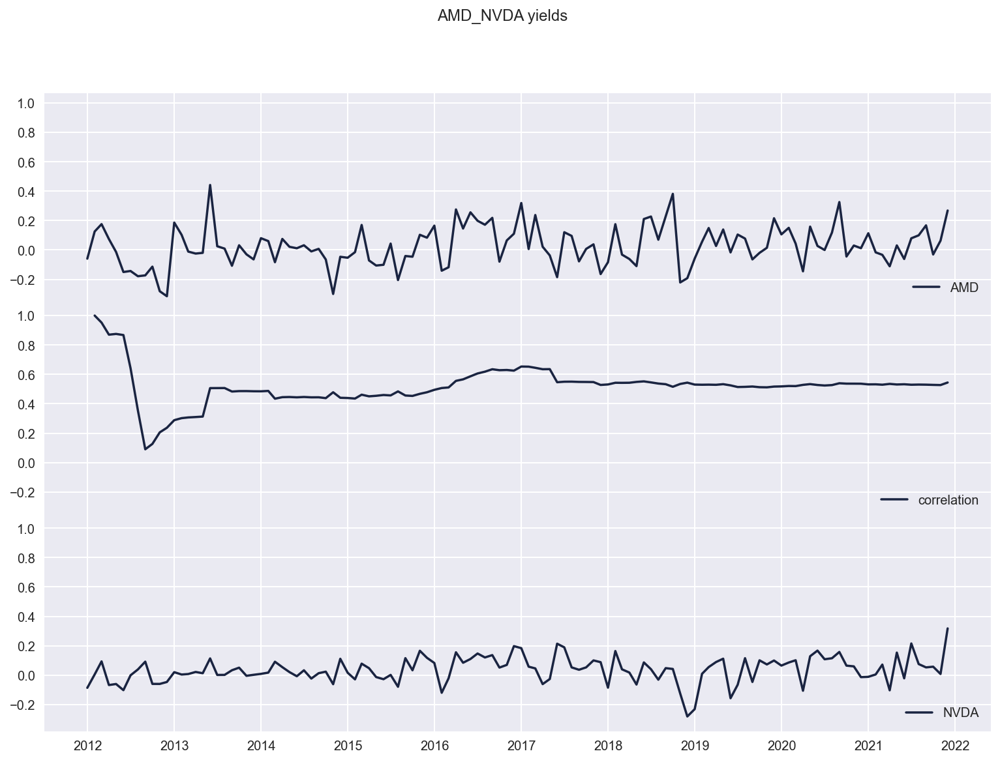

NVDA field = 4    Elettronica
Name: field, dtype: object
STM field = 9    Elettronica
Name: field, dtype: object
Correlation: 0.5556486763179133


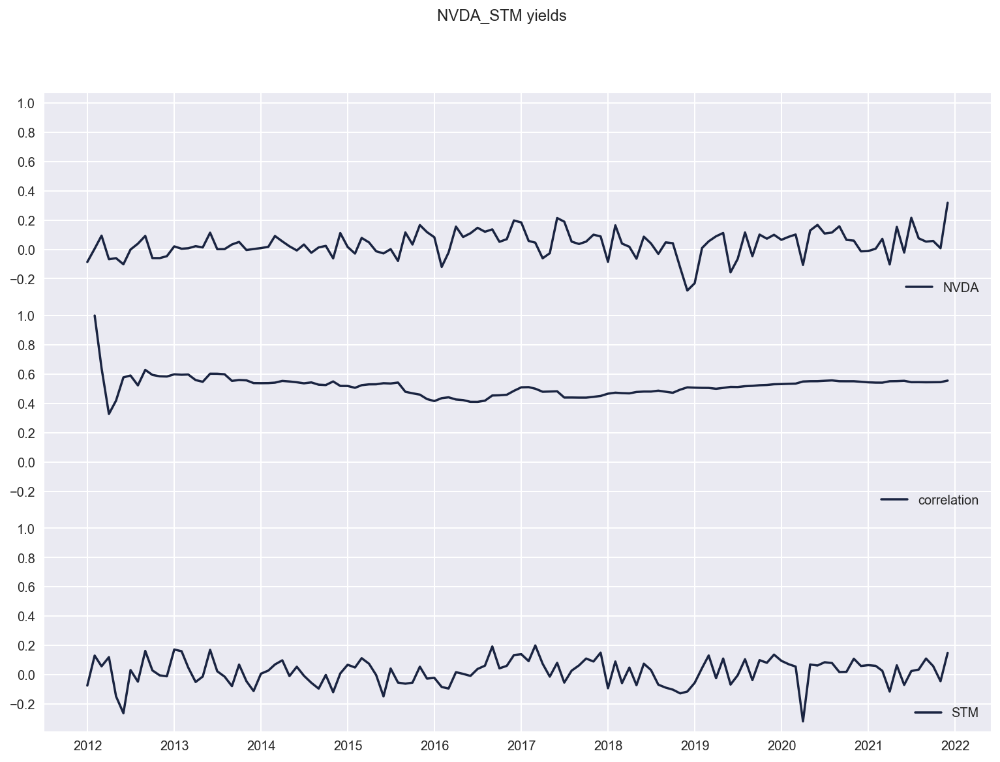

E field = 7    Energia
Name: field, dtype: object
STLA field = 8    Automobilistico
Name: field, dtype: object
Correlation: 0.5225084668097727


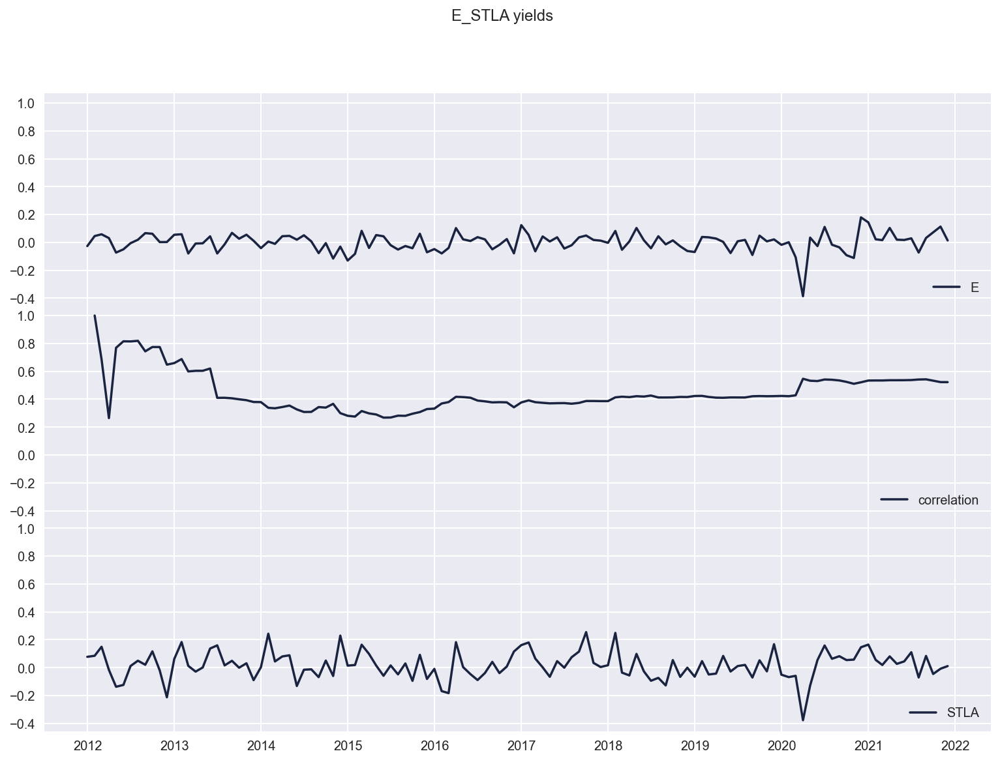

DIS field = 11    Intrattenimento
Name: field, dtype: object
E field = 7    Energia
Name: field, dtype: object
Correlation: 0.5130399195599008


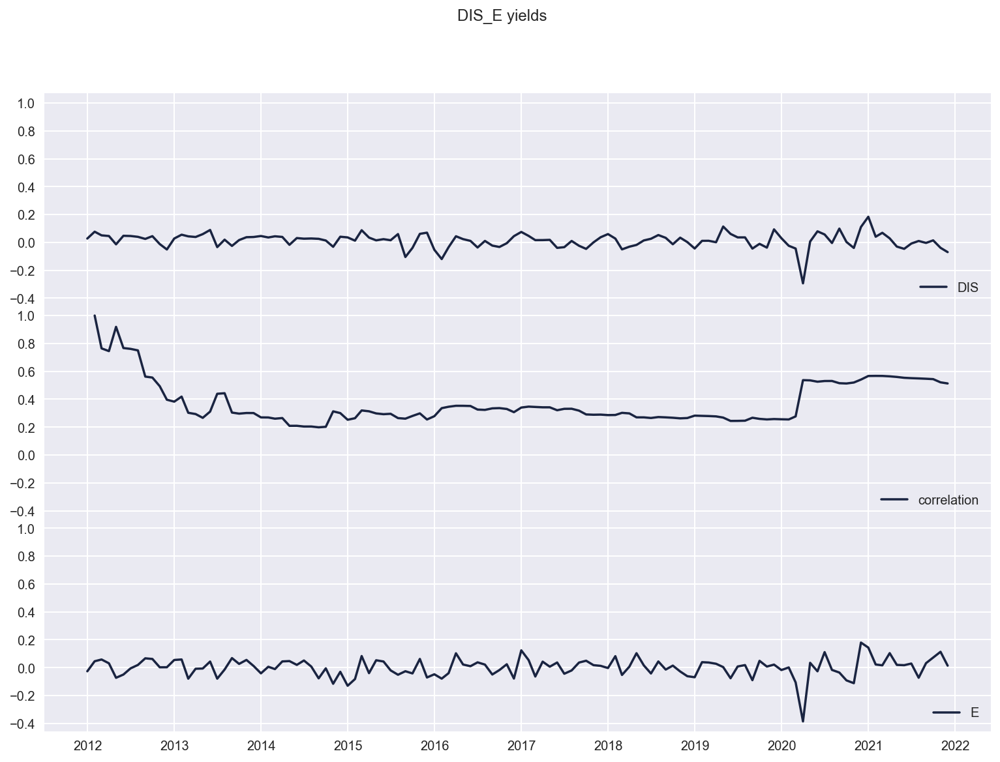

CVX field = 13    Energia
Name: field, dtype: object
E field = 7    Energia
Name: field, dtype: object
Correlation: 0.748587158094287


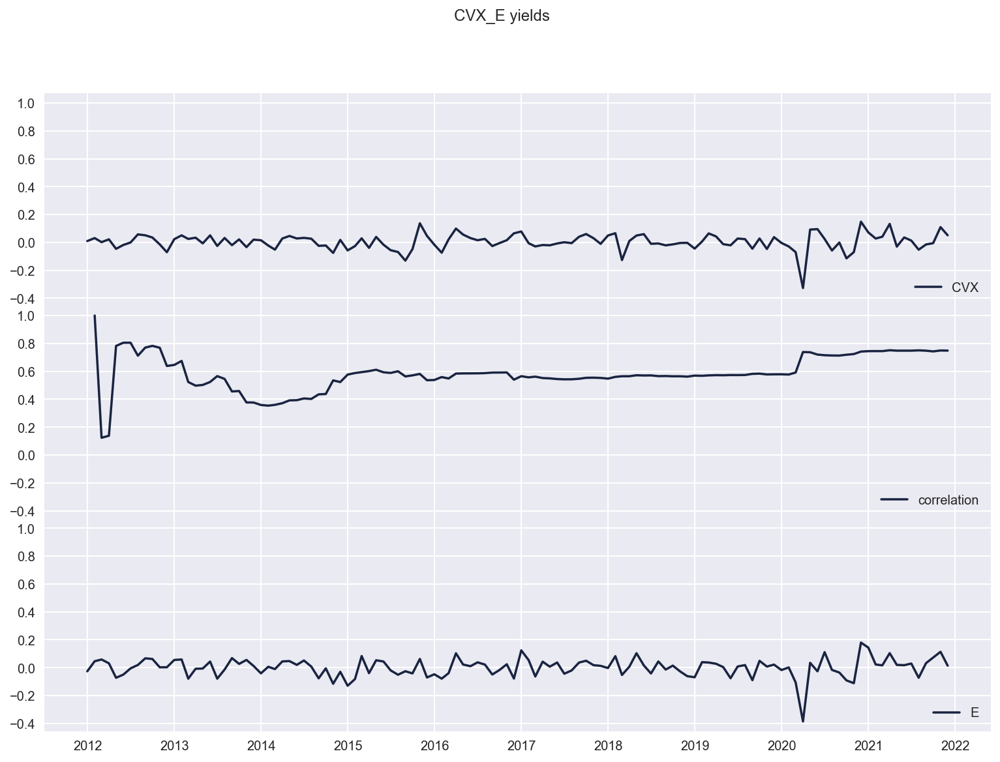

STLA field = 8    Automobilistico
Name: field, dtype: object
STM field = 9    Elettronica
Name: field, dtype: object
Correlation: 0.5193869569555903


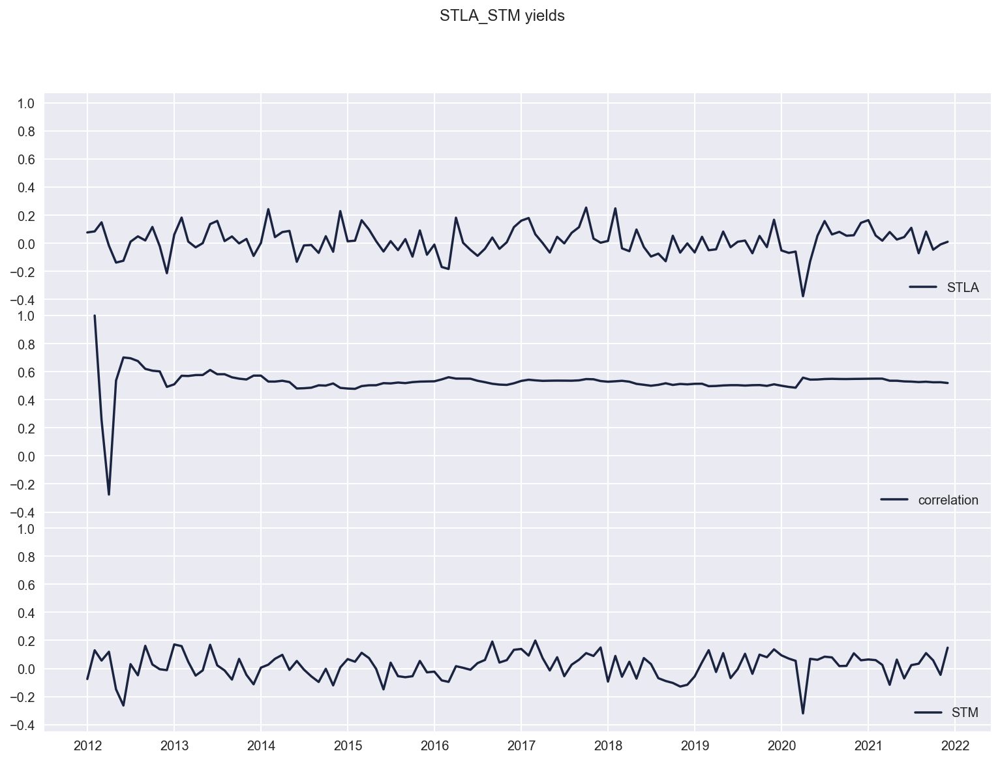

CVX field = 13    Energia
Name: field, dtype: object
DIS field = 11    Intrattenimento
Name: field, dtype: object
Correlation: 0.5913890170490552


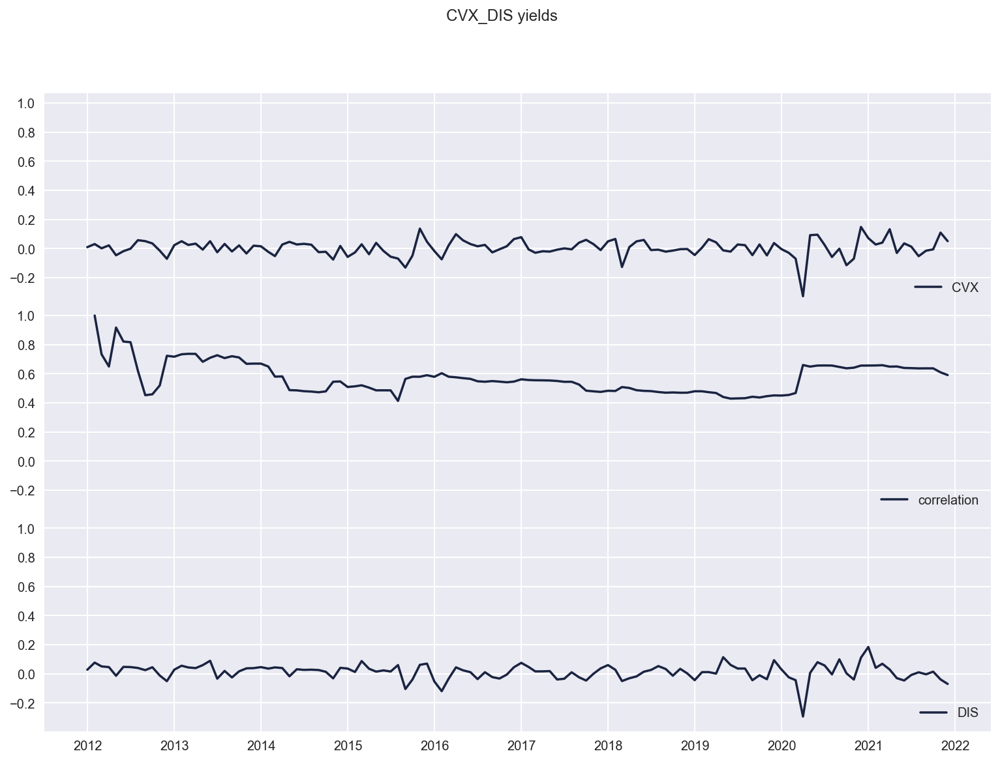

In [59]:
df = merged_yield_m.copy()

corr_df = df.corr()

best_corr = pd.Series()

for col in corr_df.columns:
    for i in corr_df.index:
        if col != i:
            val = corr_df.loc[i][col]
            if ((val > 0.5) or (val < -0.5)):
                print(f"{i} - {col} correlation: {val}")
                pair = [i, col]
                pair.sort()
                key = f"{pair[0]}_{pair[1]}"
                if key not in best_corr.index:
                    best_corr[key] = val
best_corr[[col for col in best_corr.index if '^GSPC' not in col]].sort_values().plot(kind="bar")
plt.show()

    

for col in [i for i in best_corr.index if '^GSPC' not in i]:
    columns = col.split("_")
    
    cor_list = []
    
    # CALCOLO DELLA CORRELAZIONE DEI RENDIMENTI NEL TEMPO
    for i in df.index:
        cor_list.append(df[columns].loc[:i].corr()[0:1][columns[1]][columns[0]])
    
    df[f"{col}_correlations"] = cor_list
    
    fig = plt.figure(figsize=(13, 9))
    gs = fig.add_gridspec(3, hspace=0)
    axs = gs.subplots(sharex=True, sharey=True)
    
    fig.suptitle(f"{col} yields")
    axs[0].plot(df.index, df[columns[0]], label = str(columns[0]))
    axs[2].plot(df.index, df[columns[1]], label = str(columns[1]))
    axs[1].plot(df.index, df[f"{col}_correlations"], label = "correlation")
    
    axs[0].legend(loc='lower right')
    axs[2].legend(loc='lower right')
    axs[1].legend(loc='lower right')
    
    print(f"{columns[0]} field = {stocks_df[stocks_df['ticker'] == columns[0]]['field']}")
    print(f"{columns[1]} field = {stocks_df[stocks_df['ticker'] == columns[1]]['field']}")
    print(f"Correlation: {best_corr[col]}")

    plt.show()
    

In [61]:
merged_yield_m[['E', 'IBM']].loc[:"2011-12-31"].corr()[0:1]['IBM']['E']

nan

<AxesSubplot:xlabel='Date'>

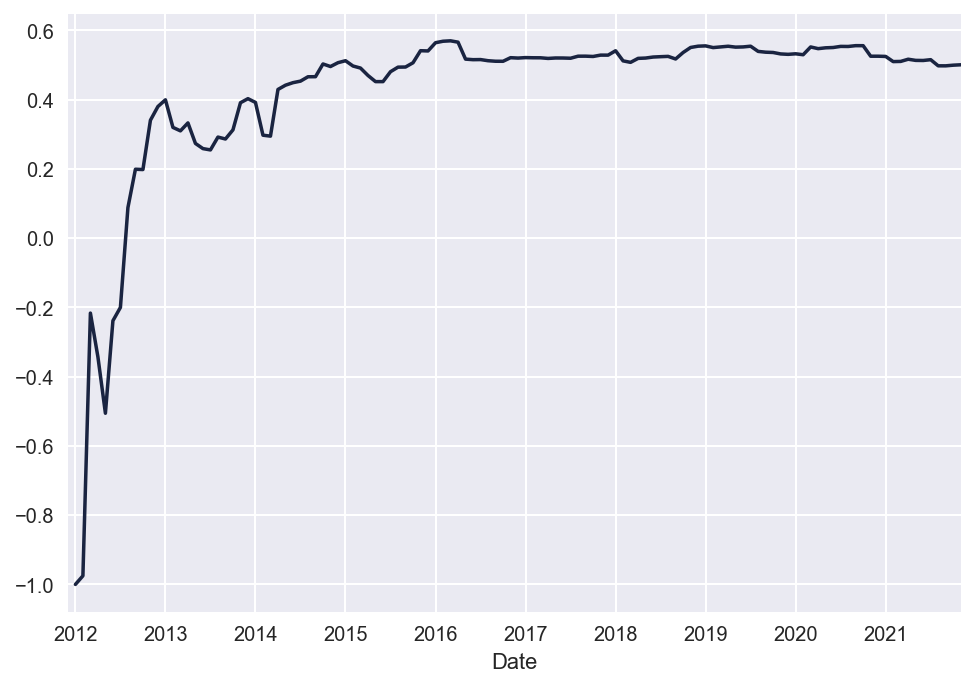

In [62]:
merged_yield_m[["AMZN", "GOOG"]].corr()

coor_list = []

df = merged_yield_m.copy()

for i in df.index:
    coor_list.append(df[["AMZN", "GOOG"]].loc[:i].corr()[0:1]["GOOG"]["AMZN"])
    
df["AMZN_GOOG_CORR"] = coor_list

df["AMZN_GOOG_CORR"].plot()

In [193]:
def time_series_correlations(df, target):
    target_columns = [col for col in df.columns if target in col ]
    corr = df[target_columns].corr()
    mask = np.zeros_like(corr)
    mask[np.triu_indices_from(mask)] = True
    with sns.axes_style("white"):
        f, ax = plt.subplots(figsize=(11, 8))
        ax = sns.heatmap(corr, mask=mask, square=True)
    plt.show()    

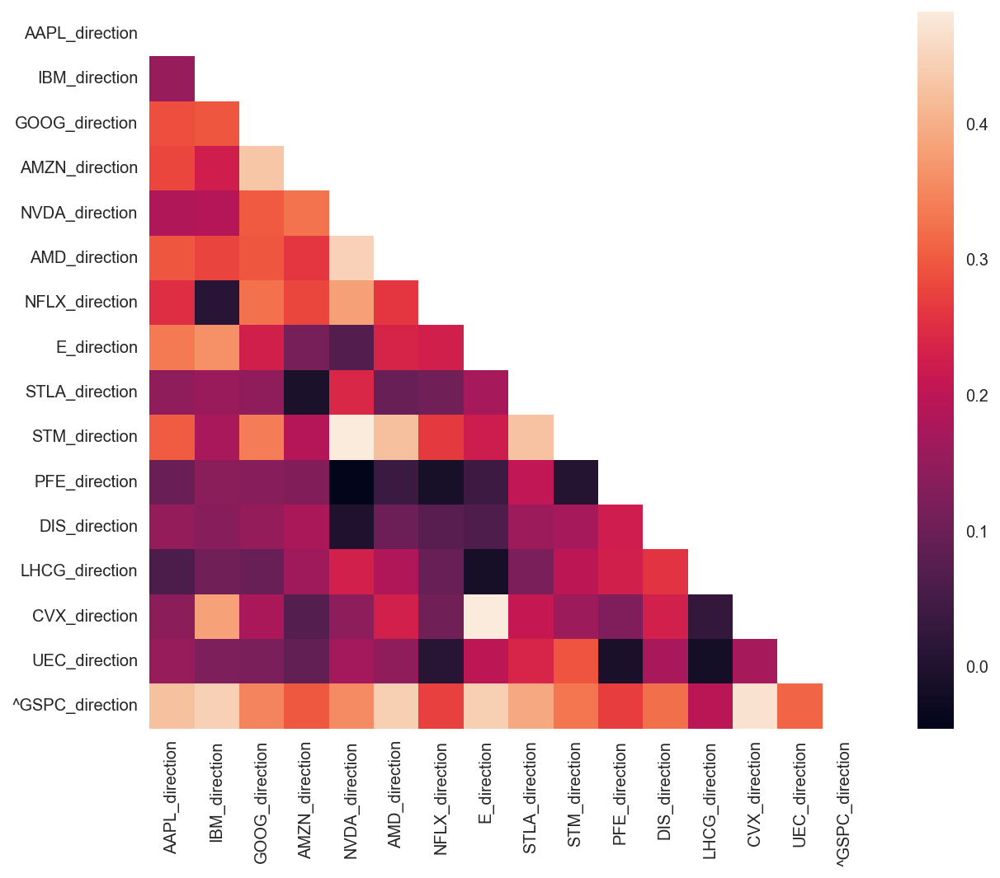

In [194]:
data = merged_yield_m.copy()
for col in data.columns:

    data[f"{col}_direction"] = np.sign(data[f"{col}"]).astype(int)
    
data.dropna(inplace=True)


time_series_correlations(data, "direction") 

In [192]:
merged_yield_m

,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC
Date,,,,,,,,,,,,,,,,
2011-12-31,0.027688,-0.001123,0.045574,-0.044429,-0.086239,-0.059302,0.085703,-0.026542,0.077255,-0.075202,0.042526,0.027509,-0.048934,0.009537,-0.006265,-0.002921
2012-01-31,0.086840,-0.011117,-0.020045,0.005931,0.004935,0.125432,0.329596,0.045536,0.084769,0.129619,0.038390,0.076664,0.048862,0.030896,0.150152,0.045021
2012-02-29,0.149266,0.046800,-0.013908,-0.009694,0.093545,0.175678,0.204401,0.058076,0.149456,0.056513,-0.017035,0.050421,0.177375,0.001711,0.128889,0.039137
2012-03-31,0.148984,0.048943,0.033847,0.033756,-0.067267,0.074071,-0.059425,0.030758,-0.016702,0.119222,0.030907,0.045679,0.118091,0.021781,-0.031731,0.026811
2012-04-30,0.048163,0.001946,-0.012579,0.029924,-0.060122,-0.013370,-0.113433,-0.073136,-0.137489,-0.148539,0.025804,-0.013954,-0.053012,-0.046370,-0.246469,-0.002025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-07-31,0.110479,-0.042711,0.056498,0.071133,0.075503,0.099471,0.049099,-0.072994,-0.070853,0.034202,0.036480,0.010114,0.034510,-0.052471,-0.290466,0.029116
2021-08-31,0.021945,0.010470,0.051407,-0.087541,0.052839,0.167161,0.006962,0.031850,0.083531,0.109586,0.157510,-0.003945,-0.111830,-0.014903,-0.025780,0.020472
2021-09-30,0.001136,-0.024910,0.018219,0.033909,0.057601,-0.030683,0.104174,0.071941,-0.045799,0.057923,-0.054135,0.014483,-0.086714,-0.005615,0.343386,-0.001893


# Computing percentage change

pct_change = (p1 - p0)/p0

In [64]:
pct_yield = pd.DataFrame()

for t in stocks_df.ticker.unique():
    
    col = f"Adj Close_{t}"
    print(col)

    pct_yield[t] = merged_df[col].pct_change(1).dropna()



Adj Close_AAPL
Adj Close_IBM
Adj Close_GOOG
Adj Close_AMZN
Adj Close_NVDA
Adj Close_AMD
Adj Close_NFLX
Adj Close_E
Adj Close_STLA
Adj Close_STM
Adj Close_PFE
Adj Close_DIS
Adj Close_LHCG
Adj Close_CVX
Adj Close_UEC


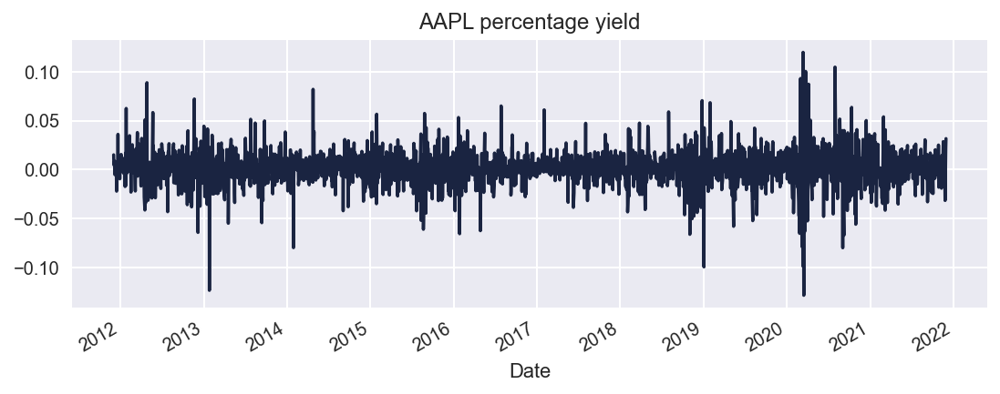

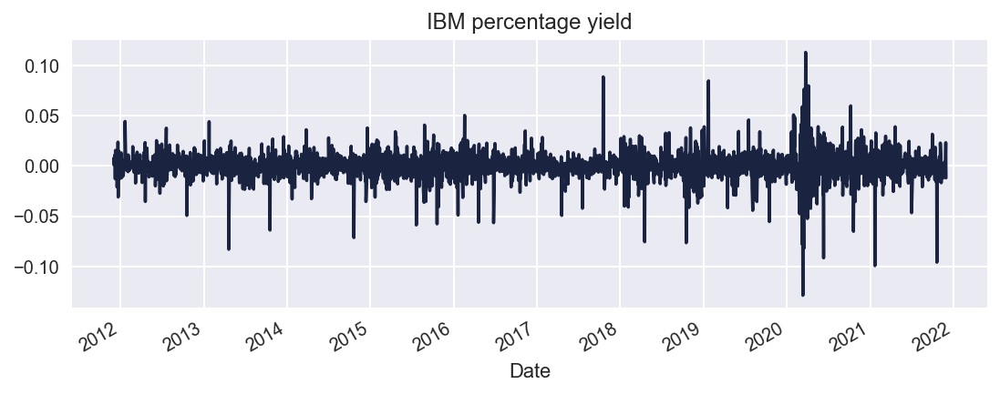

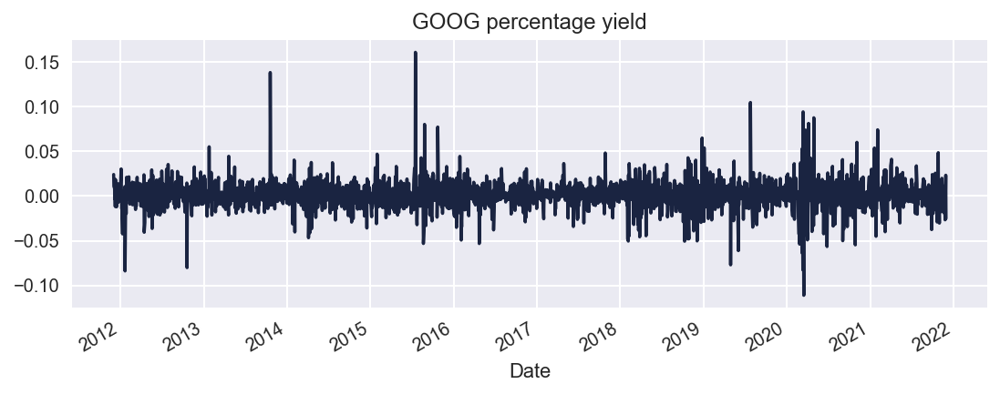

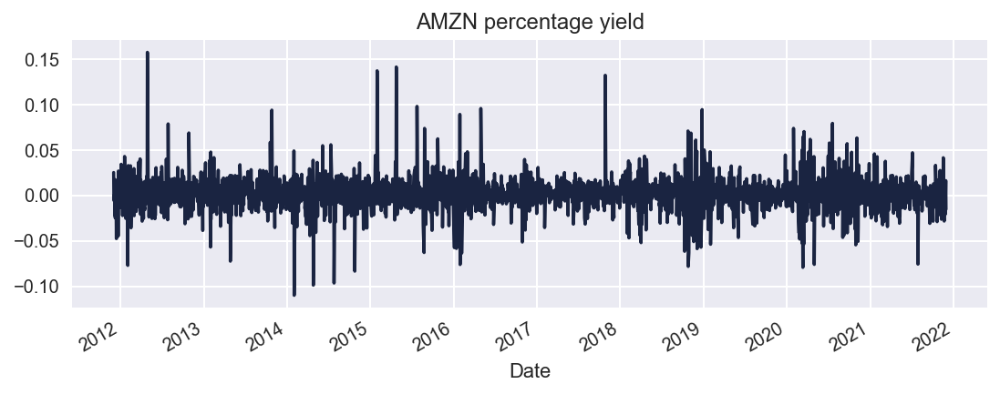

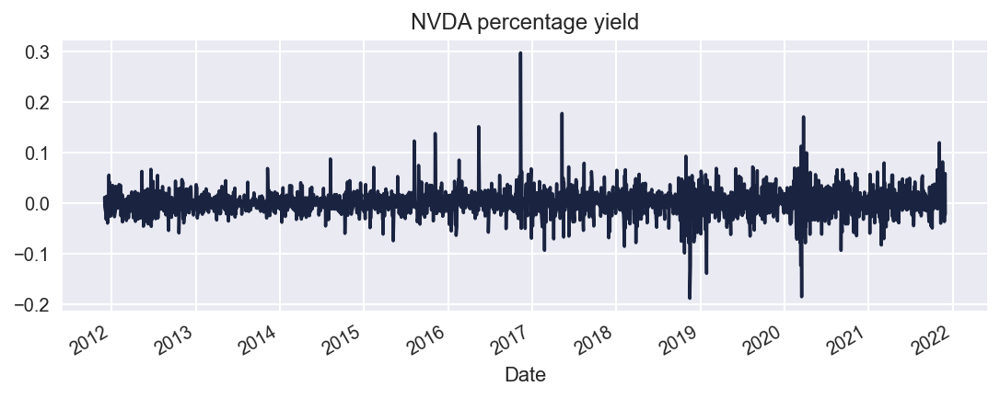

...

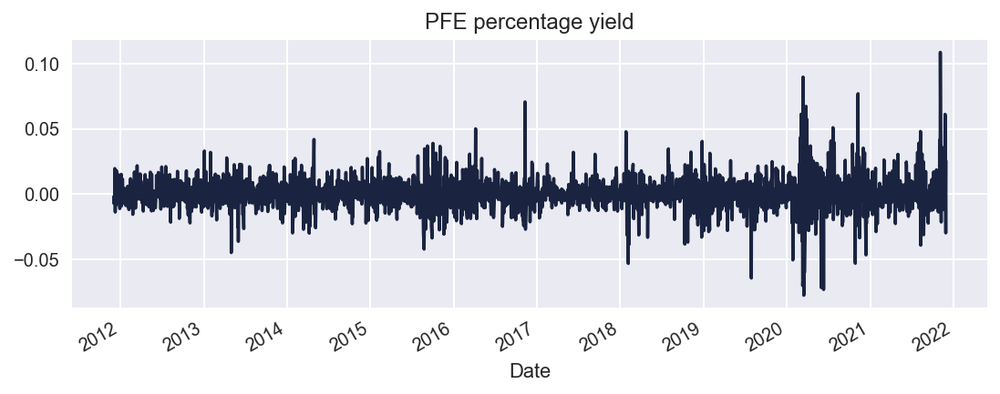

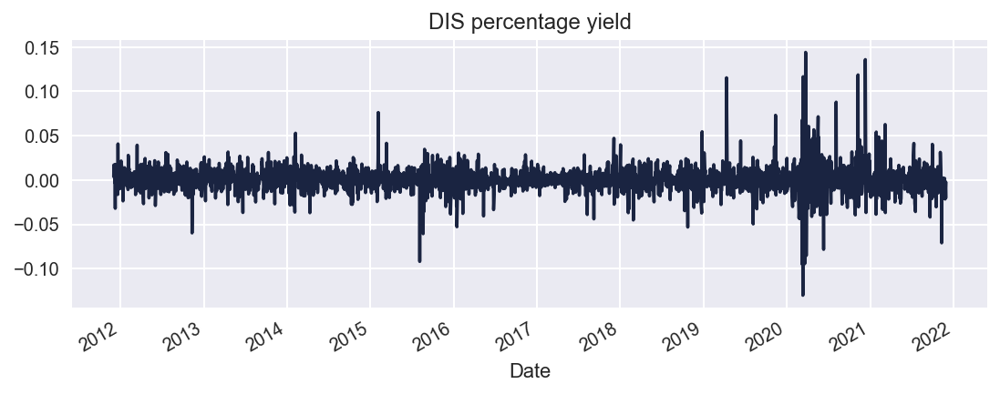

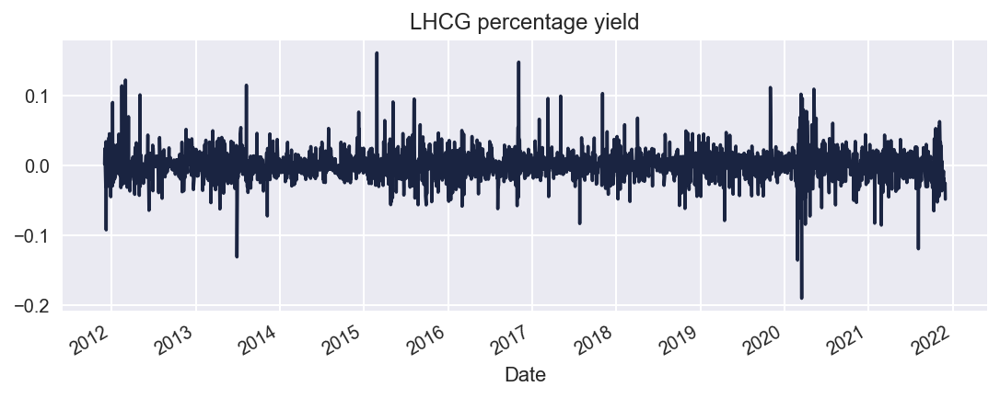

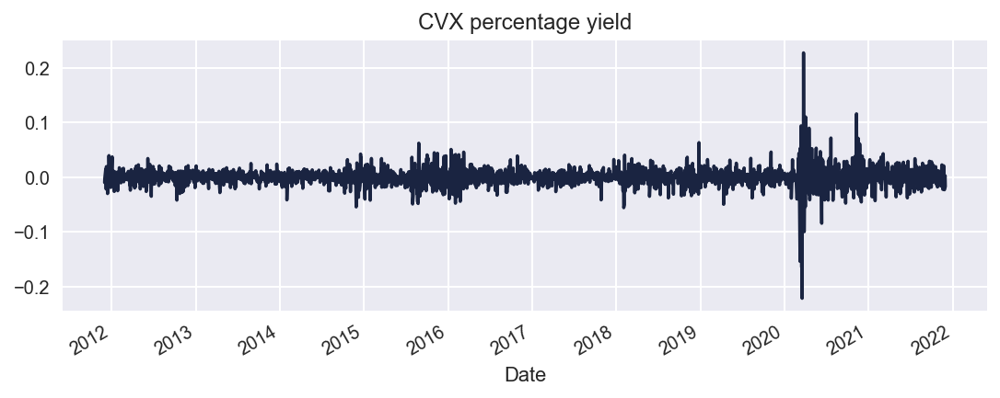

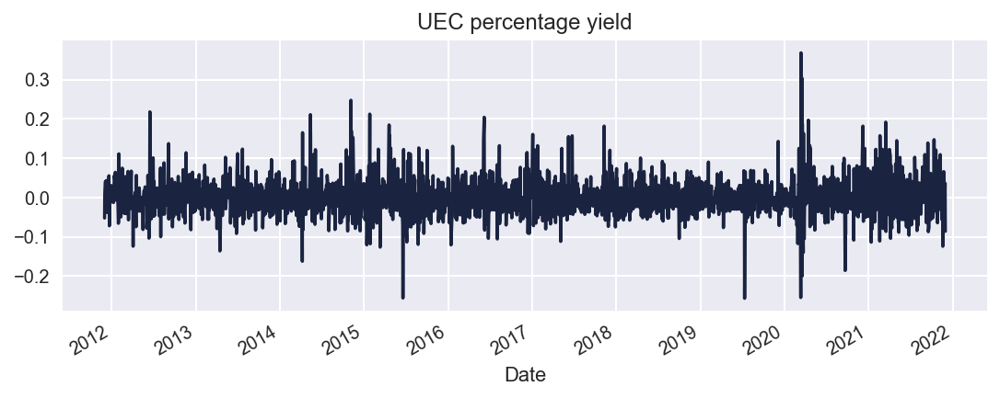

In [65]:
for col in pct_yield.columns:
    pct_yield[col].plot(figsize=(9, 3))
    plt.title(f"{col} percentage yield")
    plt.show()

# COMPOUND RETURNS: cumulative product of percentage change

cumprod(T) = (T0)*...*(T-1)*(T)

pct_yield+1 = p1/p0 -1 +1  = p1/p0 = simple gross return  

pct_change = (p1 - p0)/p0 = p1/p0 -1

In [66]:


cumprod_perc =  np.cumprod(pct_yield+1)

cumprod_perc.head()

,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC
Date,,,,,,,,,,,,,,,
2011-12-01,1.014992,1.007713,1.023991,1.025170,1.012156,1.001757,1.040911,1.000000,1.137778,1.001580,0.998007,1.003905,1.002158,0.990371,0.947541
2011-12-02,1.019623,1.008830,1.034986,1.019450,1.005758,0.992970,1.028514,0.999764,1.140000,0.998420,0.991031,1.021200,1.026619,0.989010,0.957377
2011-12-05,1.028283,1.015107,1.043811,1.020542,0.990403,1.012302,1.086627,1.018374,1.166667,0.988942,0.988540,1.030404,1.011511,1.000000,0.996721
2011-12-06,1.022894,1.026277,1.040675,0.998440,0.976328,0.994728,1.055943,1.025206,1.166667,0.987362,1.007972,1.027336,0.981295,1.014977,1.003279
2011-12-07,1.018027,1.032181,1.040041,1.015757,0.970569,1.005272,1.115140,1.026384,1.142222,0.976303,1.019930,1.034868,1.015108,1.016534,1.029508


Plotting Compound Returns

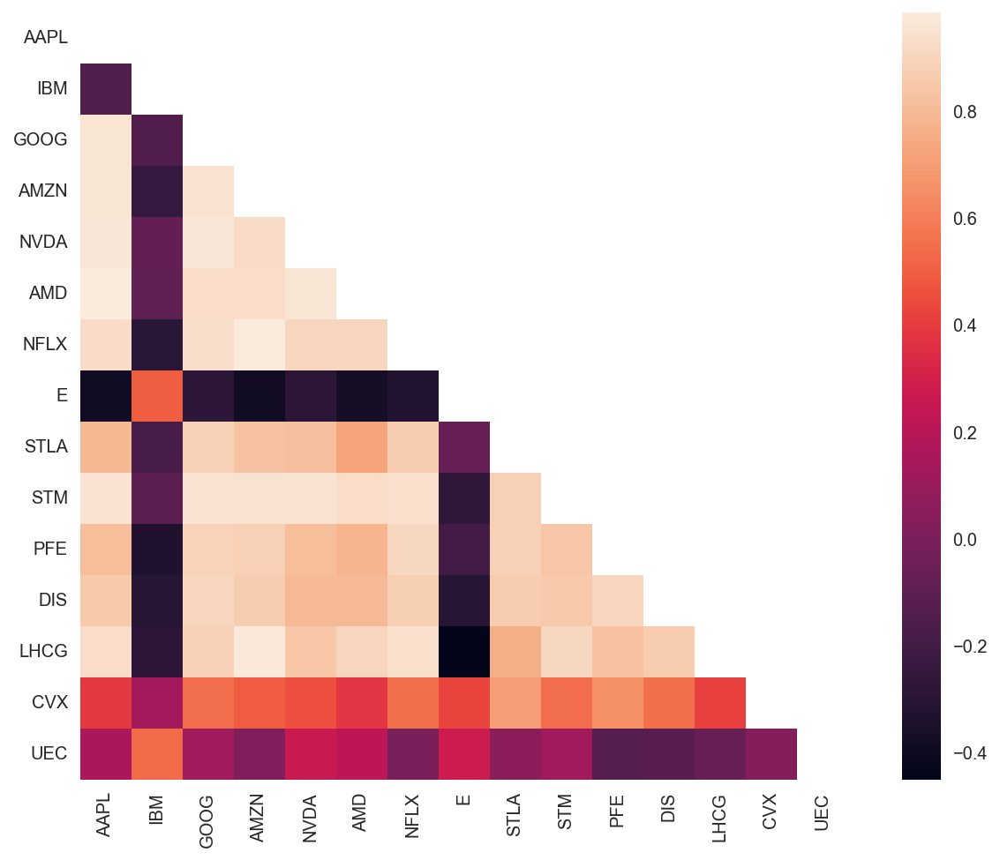

In [196]:
corr = cumprod_perc.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(11, 8))
    ax = sns.heatmap(corr, mask=mask, square=True) 


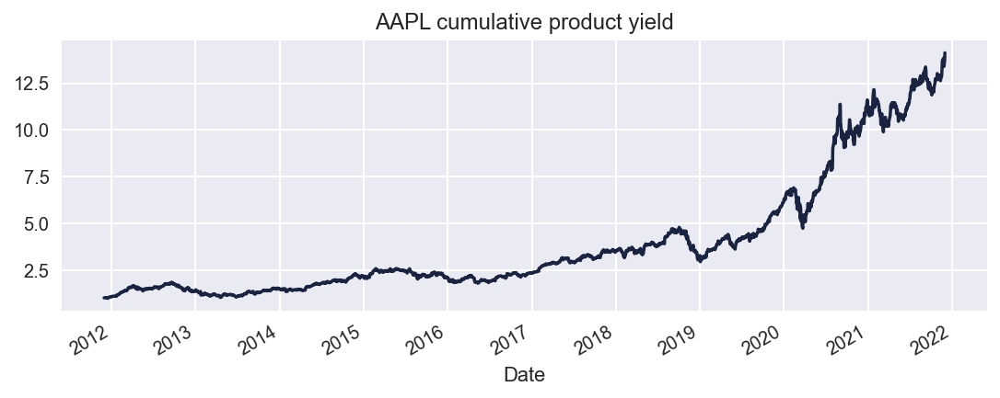

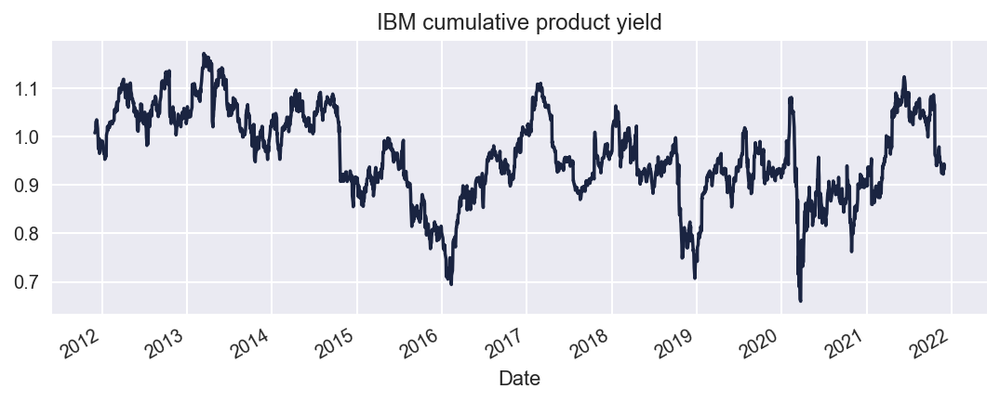

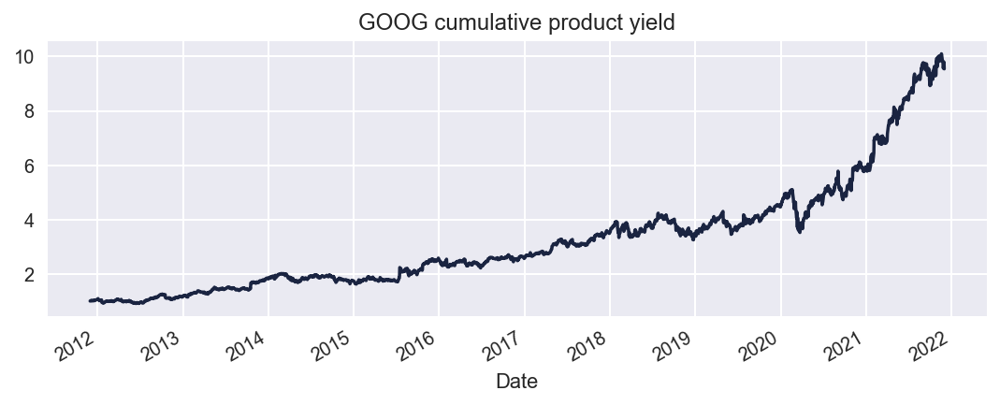

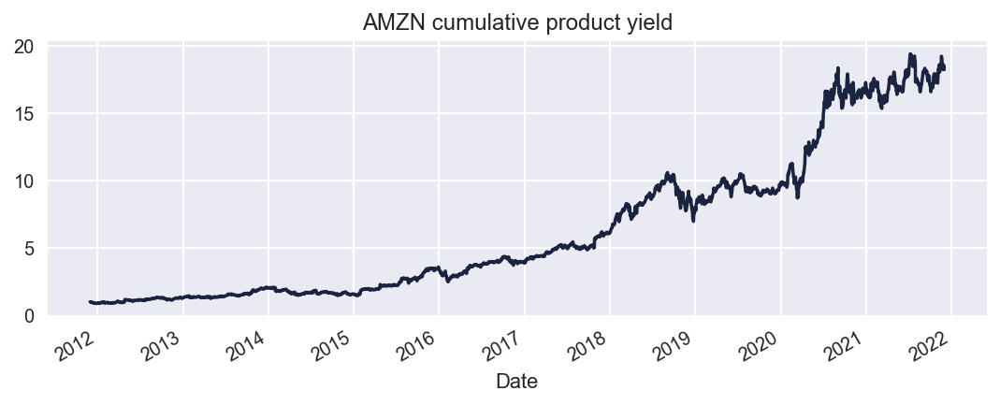

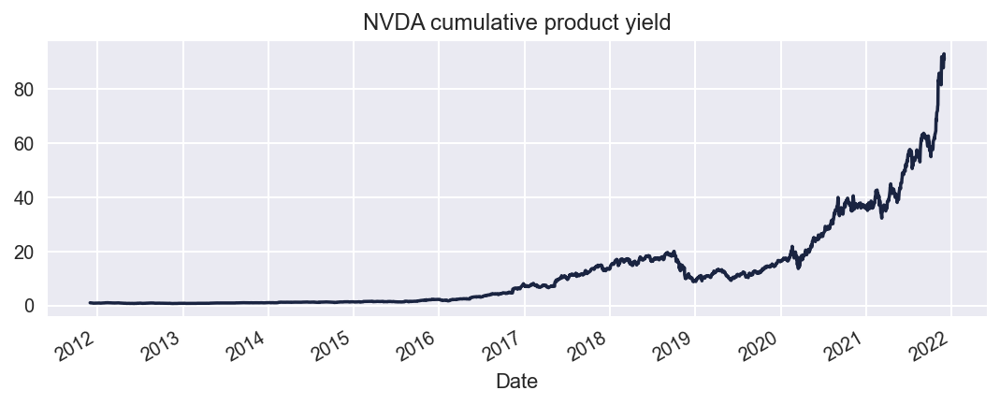

...

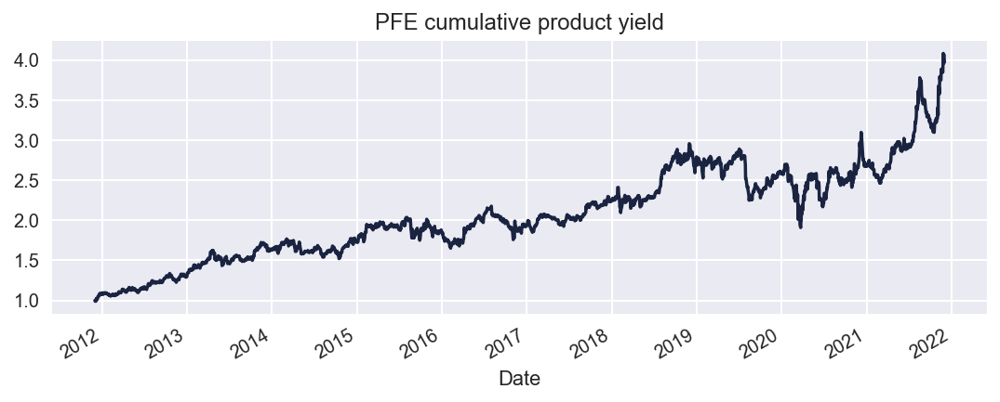

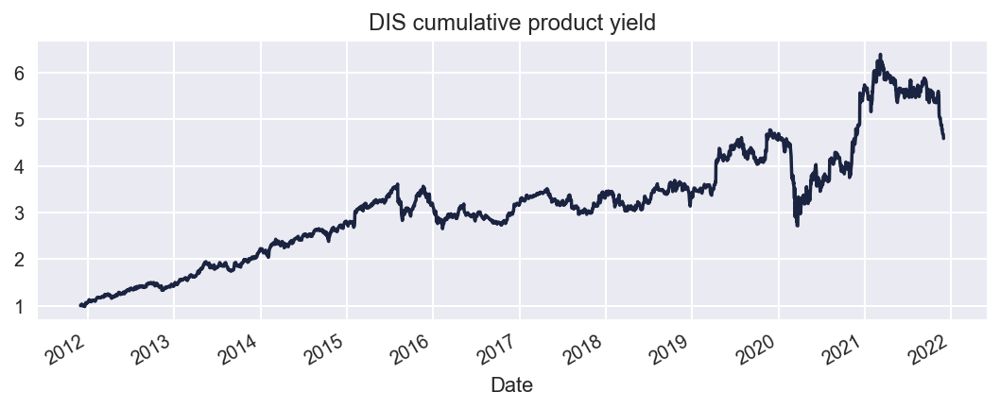

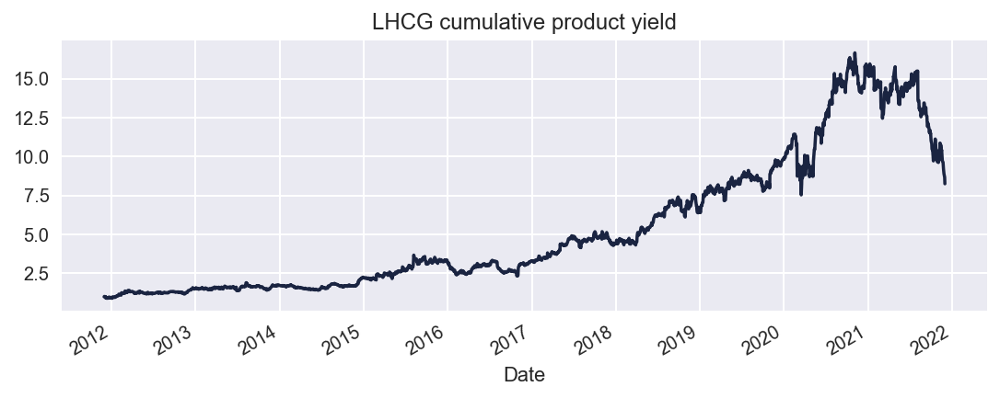

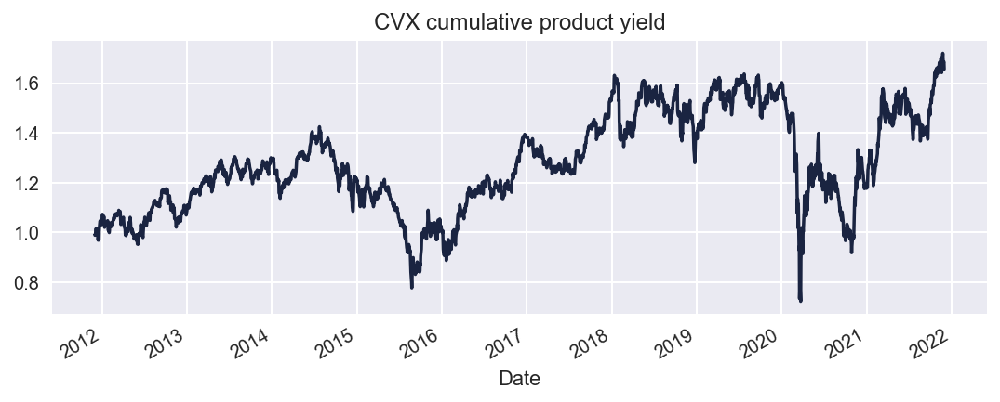

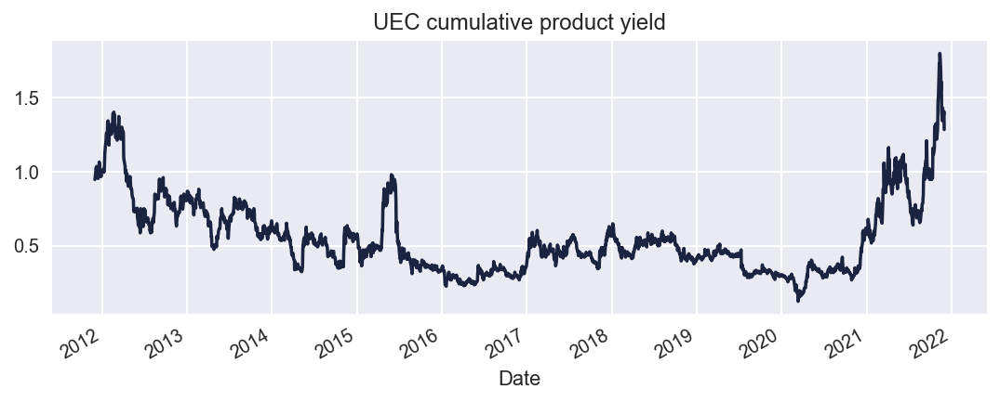

In [67]:
#cumprod_perc.plot(figsize=(18, 9), color = sns.color_palette("Set2"))
#plt.legend(loc=2, prop={'size': 20})

for col in cumprod_perc.columns:
    cumprod_perc[col].plot(figsize=(9, 3), grid=True)
    plt.title(f"{col} cumulative product yield")
    plt.show()

# Analyzing Logarithmic Simple Monthly Returns Distributions

In [68]:
! pip3 install seaborn_qqplot

mean: 0.021487439820595675
var: 0.004515004973717906
std: 0.06719378671959117
Asimmetria: -0.2706311566803113
Kurtosis: 0.37513054630457576


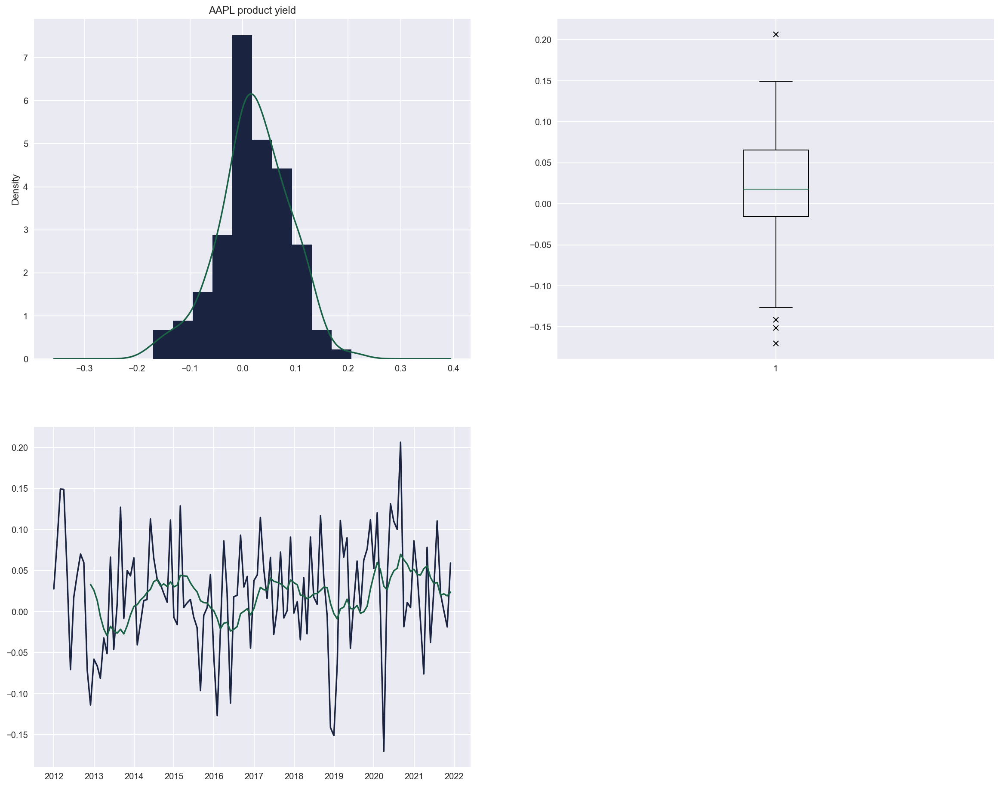

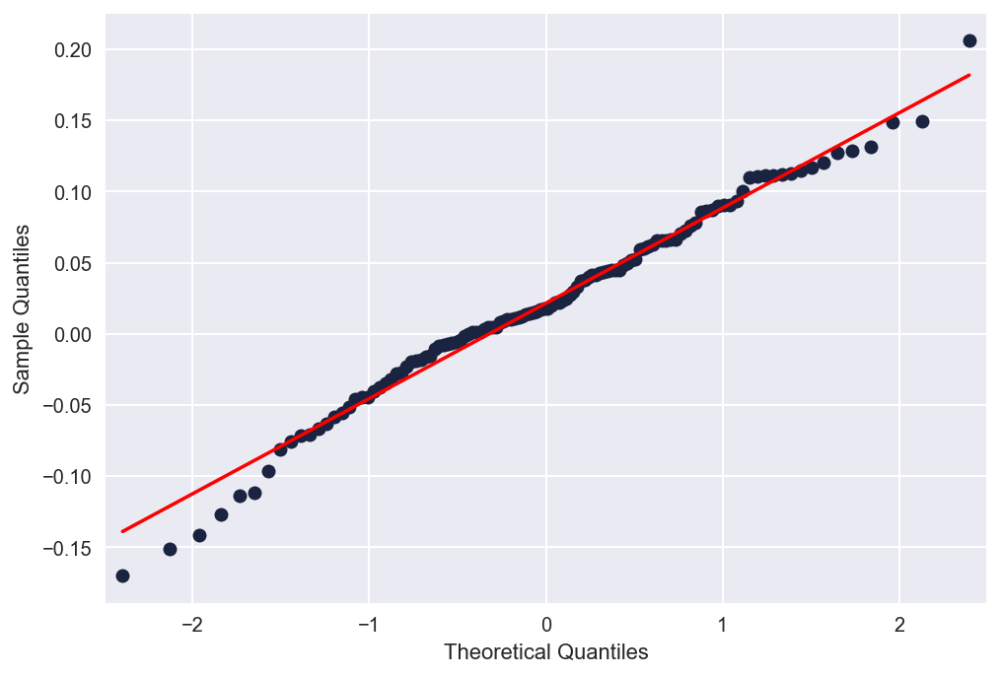

mean: -0.000469573145659281
var: 0.0023565040911951167
std: 0.04854383679927985
Asimmetria: -1.46974127627154
Kurtosis: 7.554549007752266


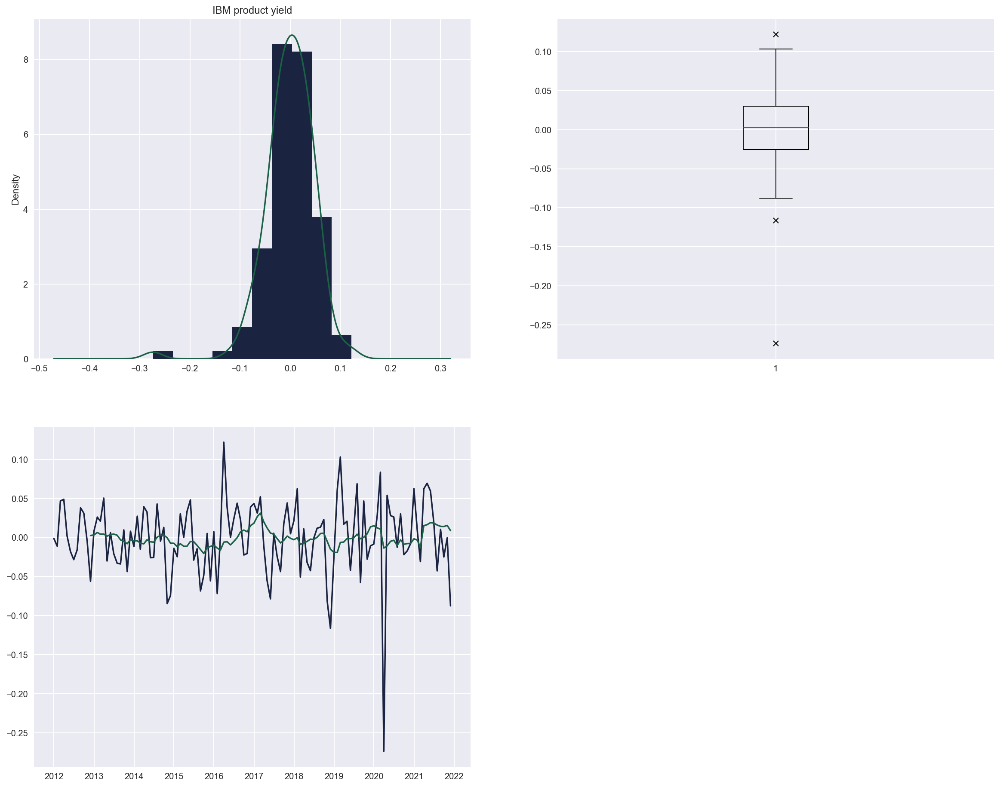

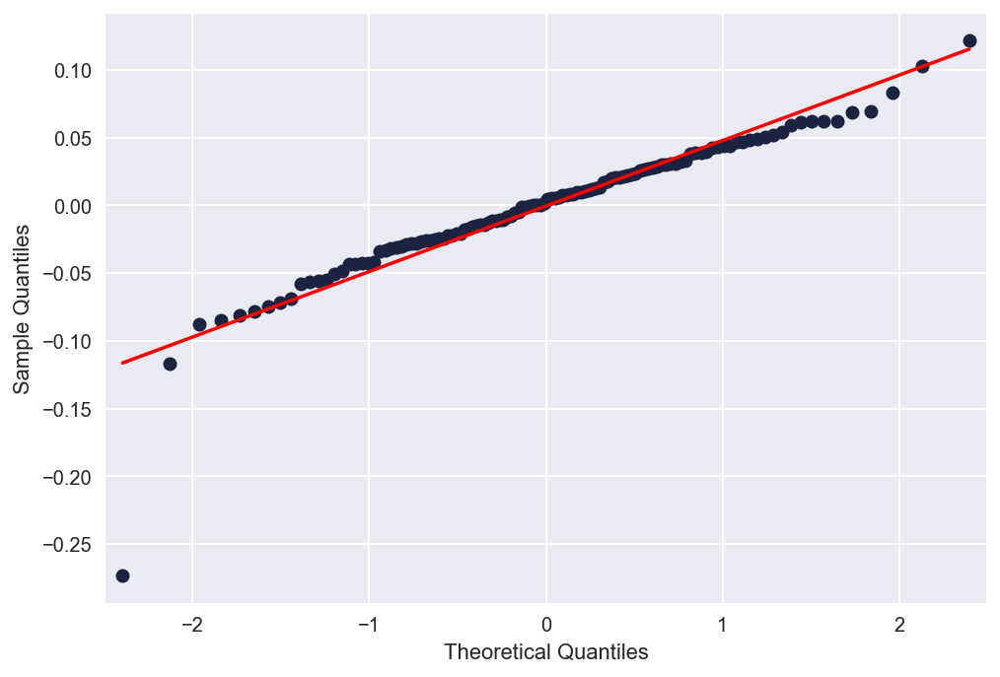

mean: 0.019083990389220224
var: 0.002502967161314043
std: 0.050029662814314896
Asimmetria: -0.697993307398227
Kurtosis: 2.7035426721153444


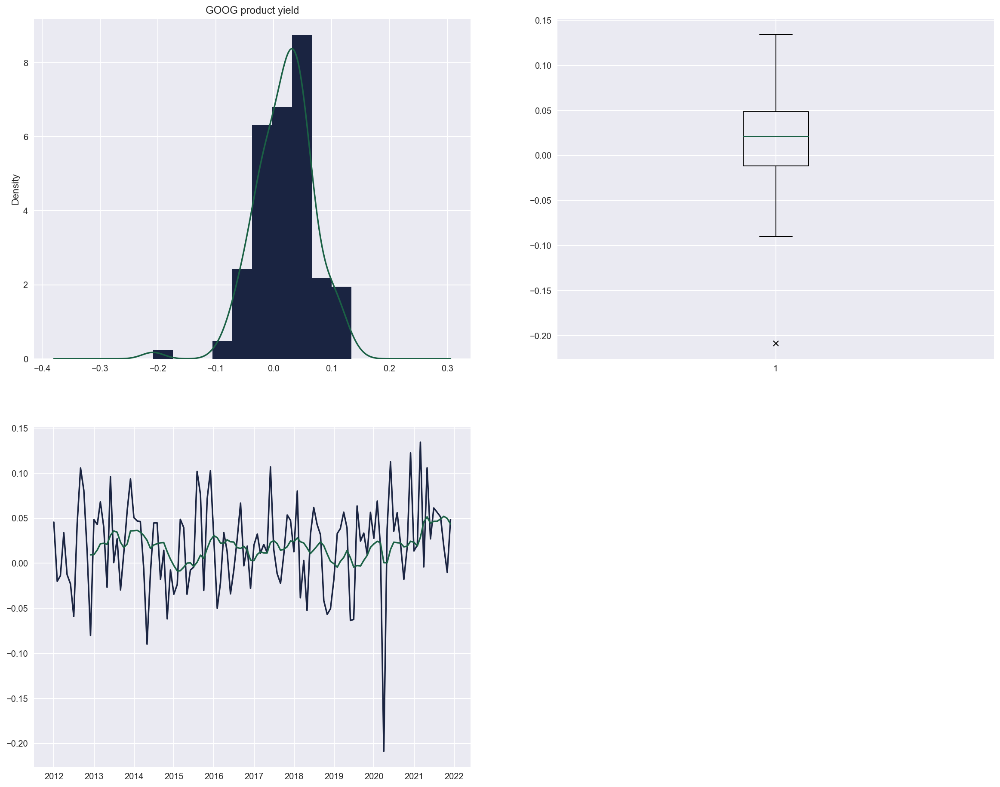

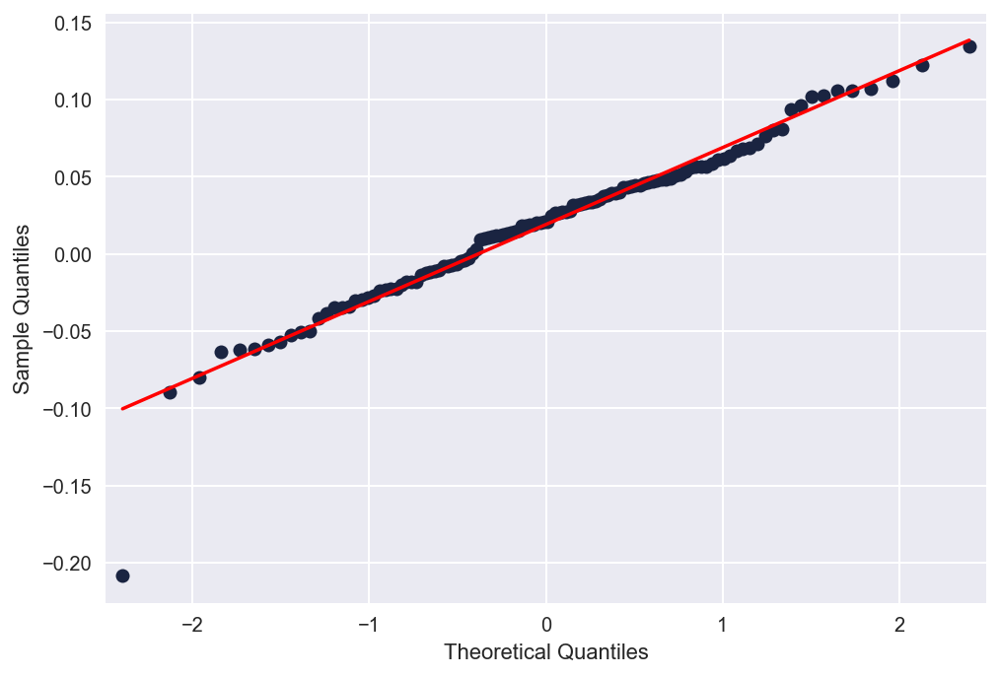

mean: 0.024221123653441794
var: 0.003960886433417592
std: 0.06293557367195116
Asimmetria: -0.06793161757947283
Kurtosis: 0.3669250505923056


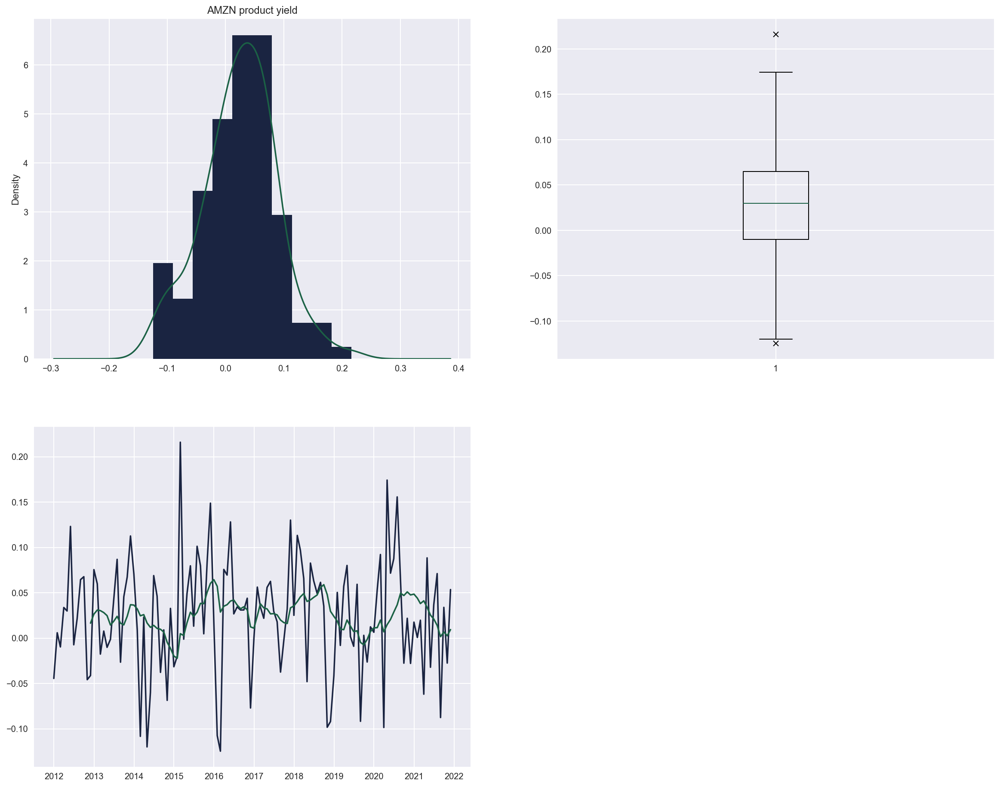

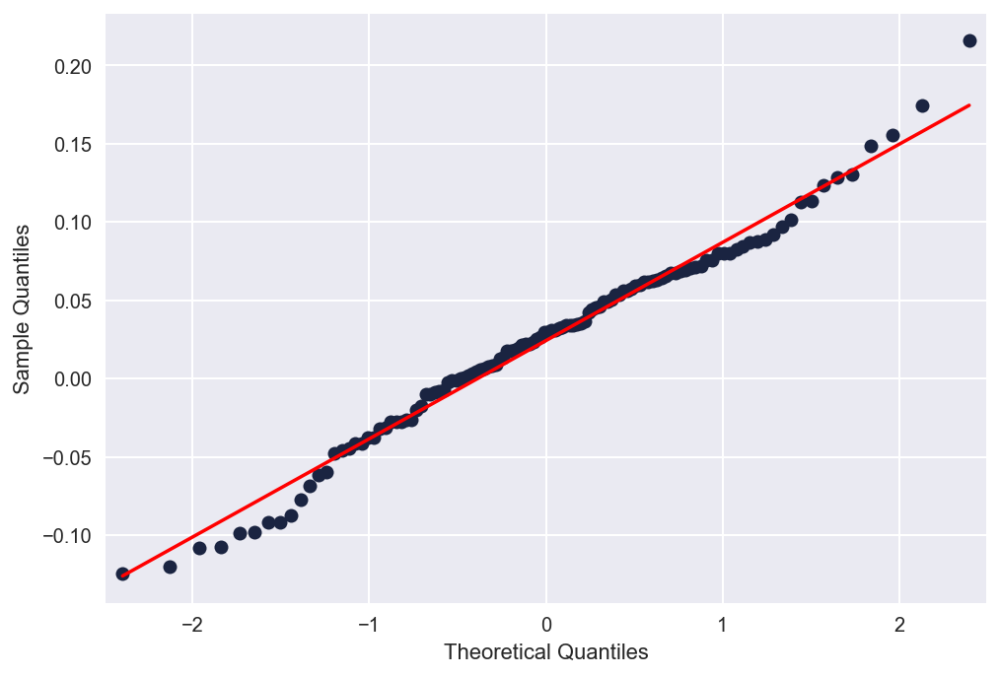

mean: 0.03698769349384737
var: 0.008051033743437038
std: 0.08972755286664759
Asimmetria: -0.3099741519902981
Kurtosis: 1.4330814352046701


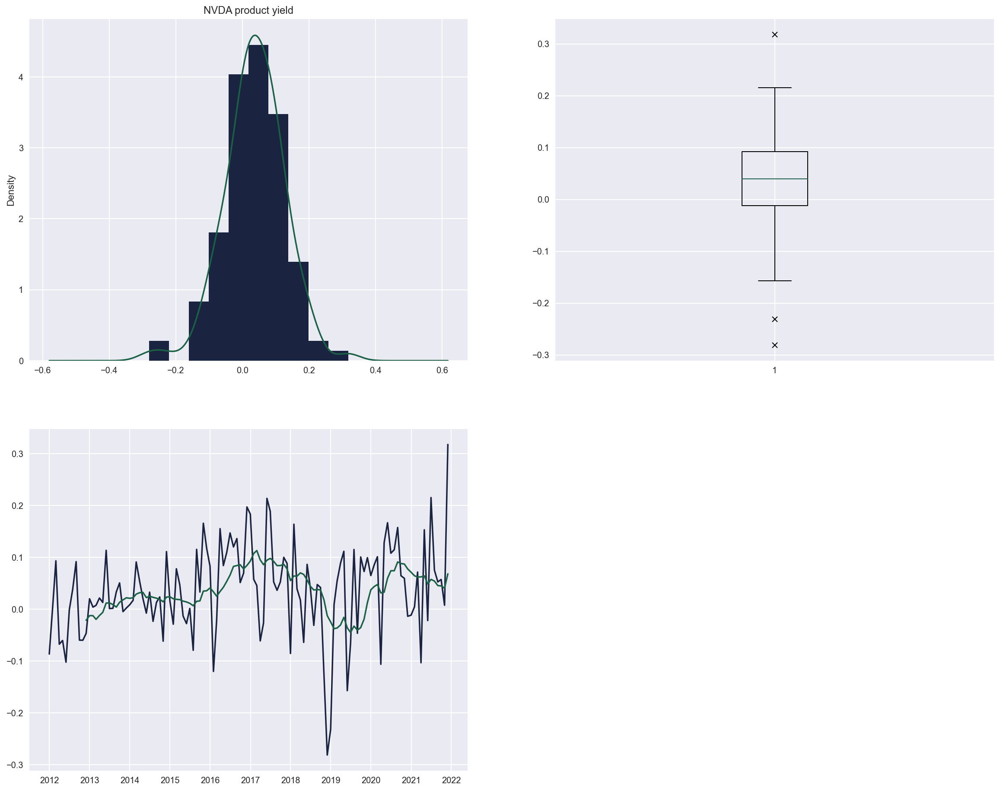

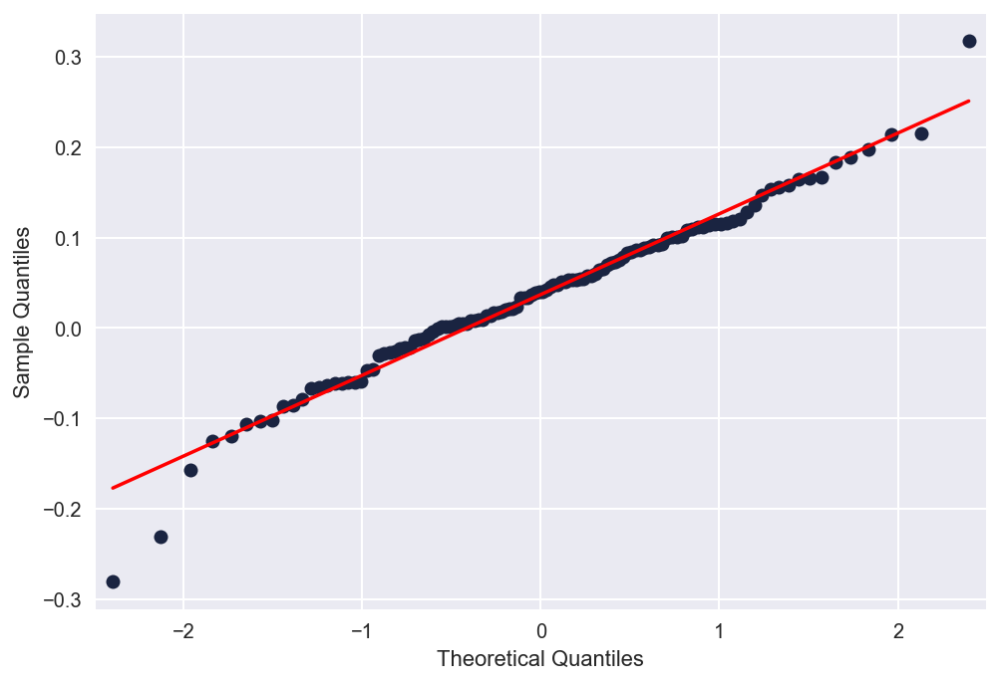

mean: 0.02709531016629439
var: 0.019310571220822997
std: 0.1389624813423501
Asimmetria: 0.21972387578371141
Kurtosis: 0.2982561496275533


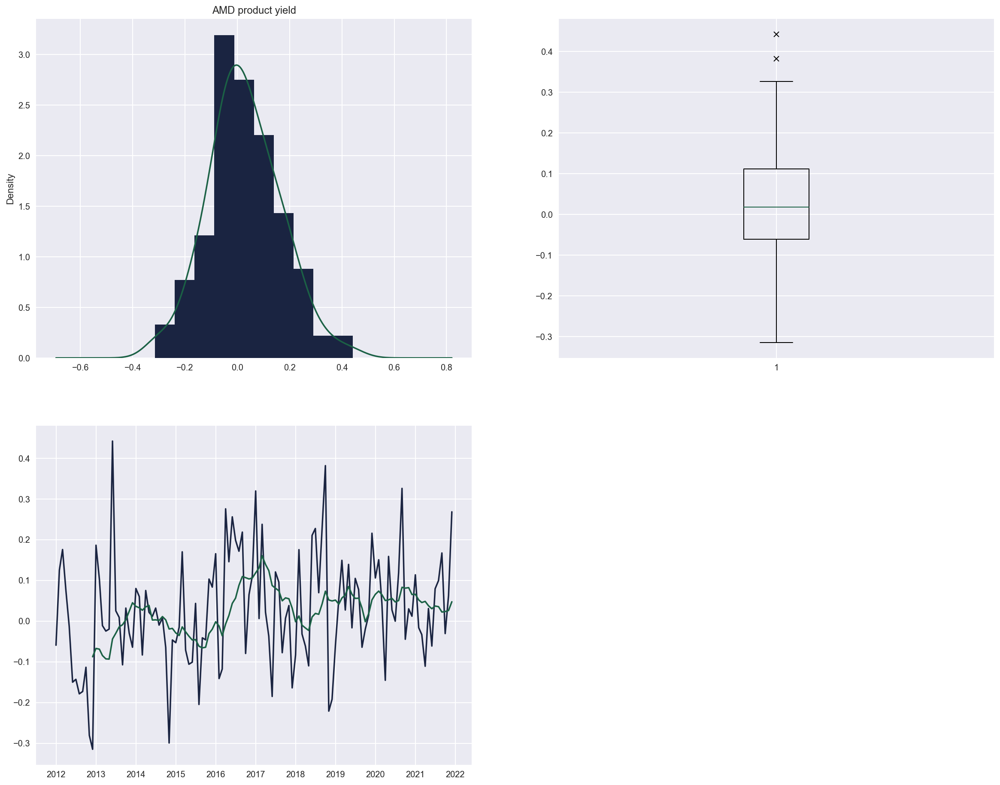

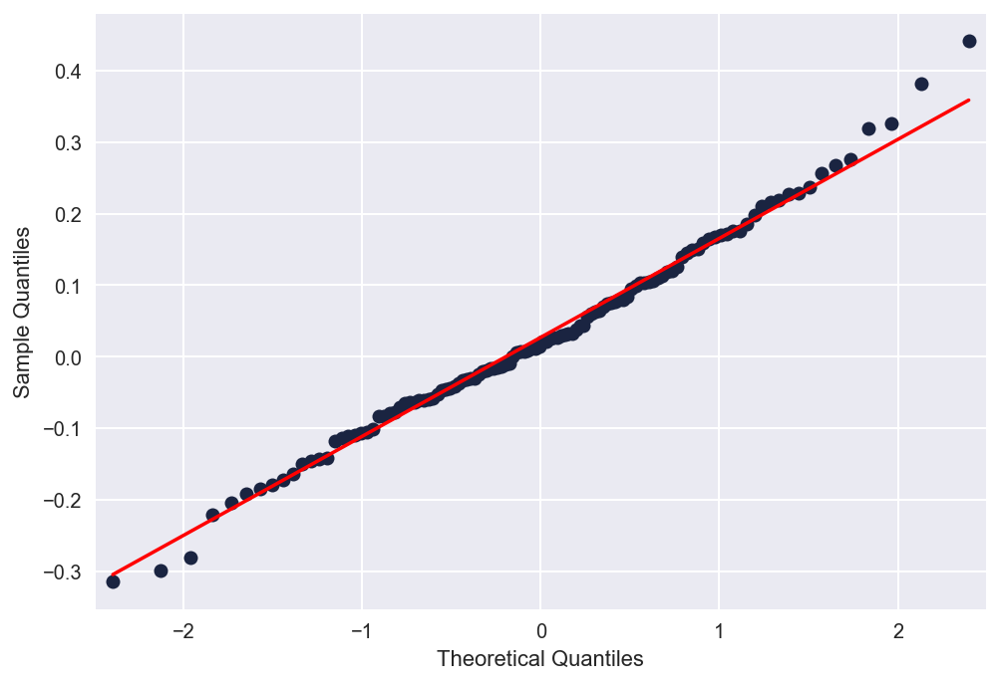

mean: 0.03568629807117719
var: 0.012083273786775572
std: 0.10992394546583366
Asimmetria: 0.14920663667963044
Kurtosis: 1.7331996801985037


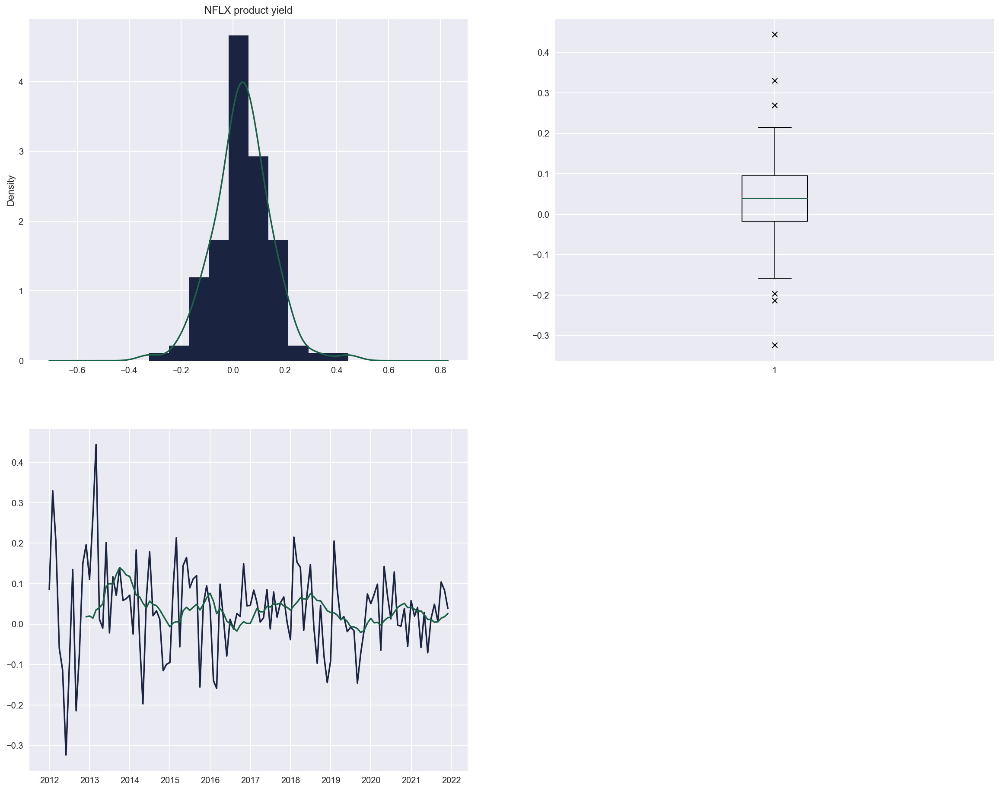

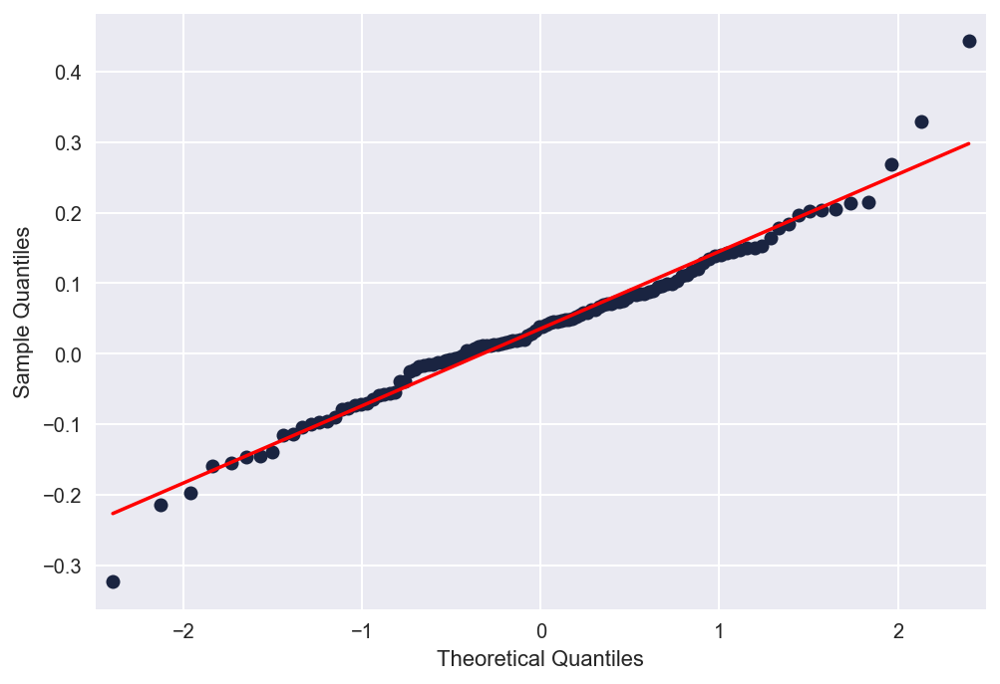

mean: 0.0013673736005471754
var: 0.00454606252825832
std: 0.06742449501670976
Asimmetria: -1.4659530547497668
Kurtosis: 8.276711213847117


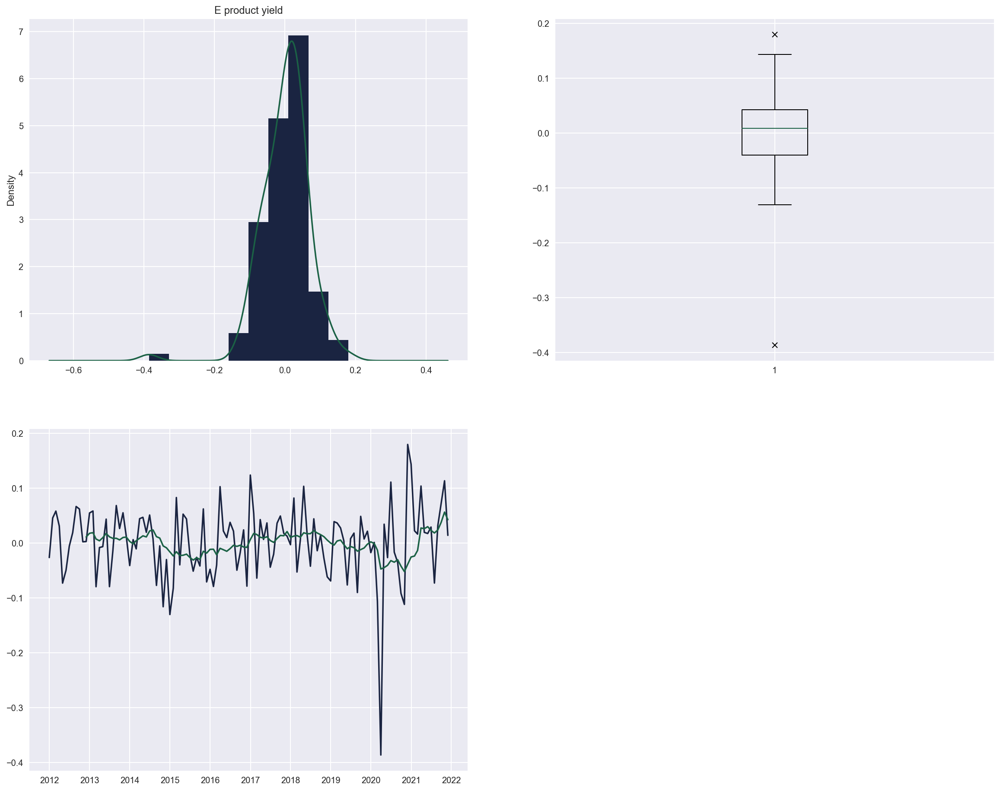

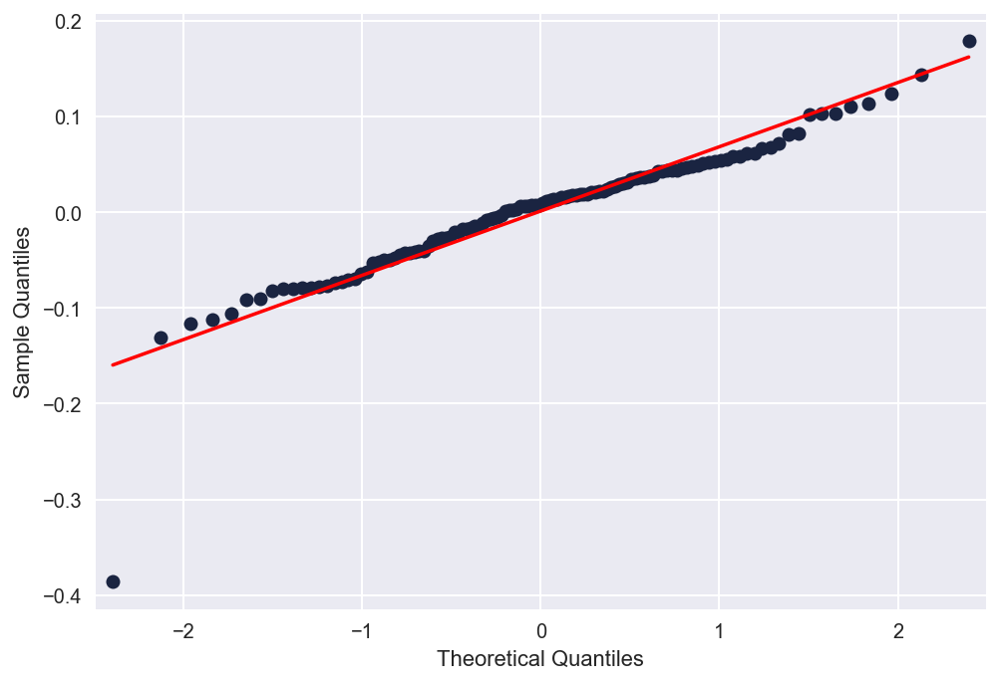

mean: 0.018413011487563836
var: 0.009753311200897254
std: 0.09875885378484936
Asimmetria: -0.2742998161731195
Kurtosis: 1.639247510124286


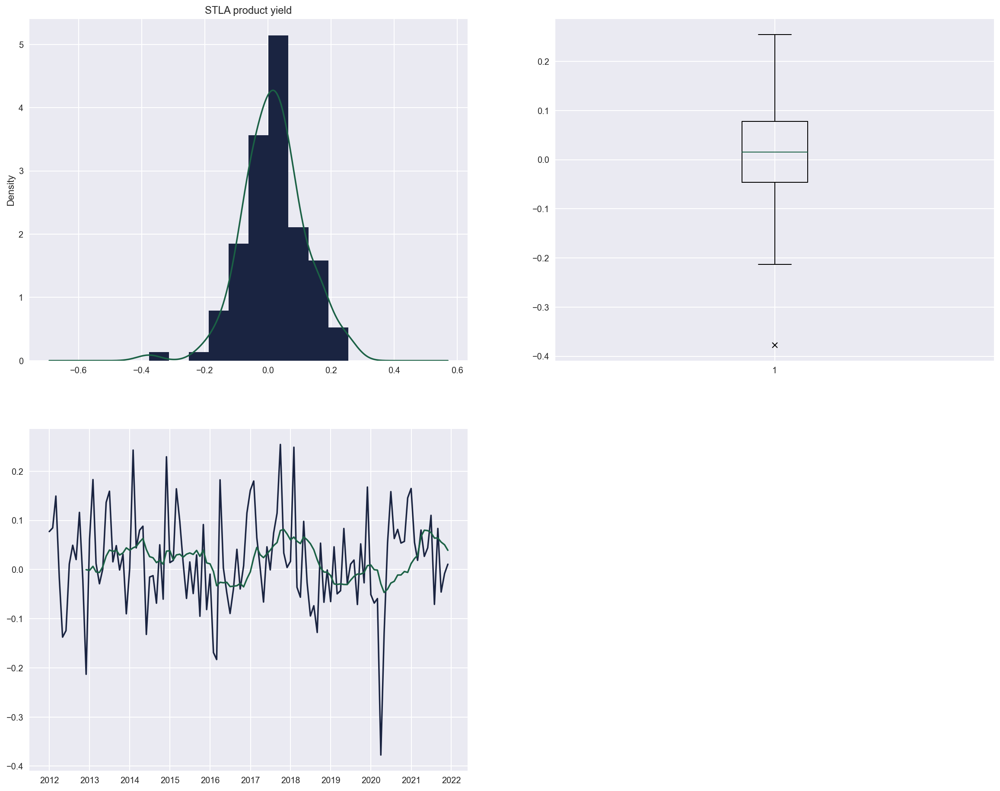

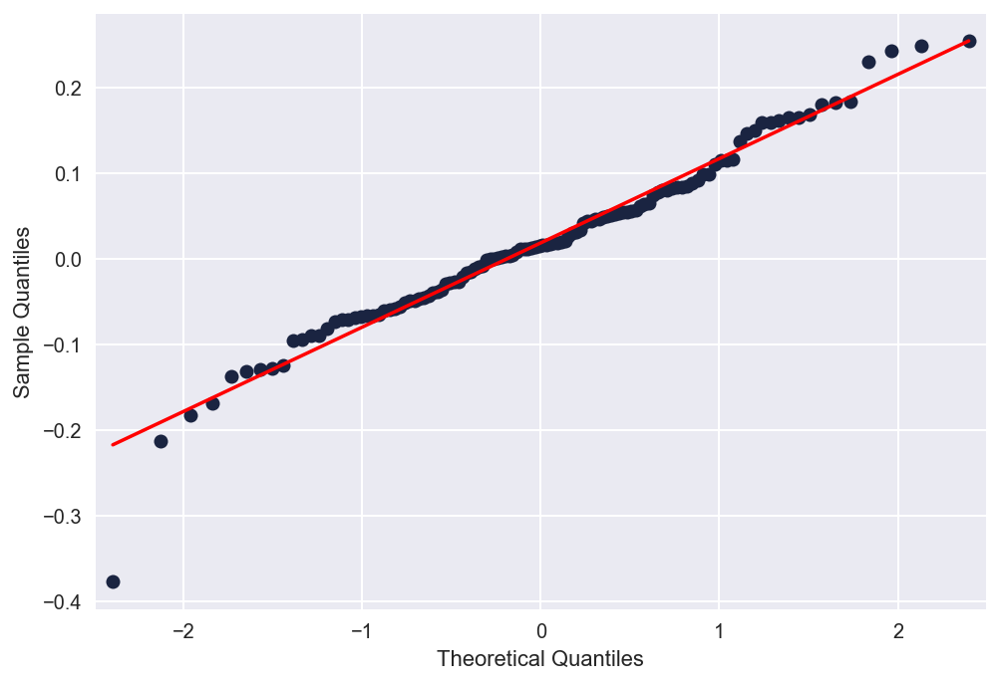

mean: 0.01980175154953723
var: 0.007995034793932494
std: 0.08941495844618223
Asimmetria: -0.6949308330766772
Kurtosis: 1.2092236435582855


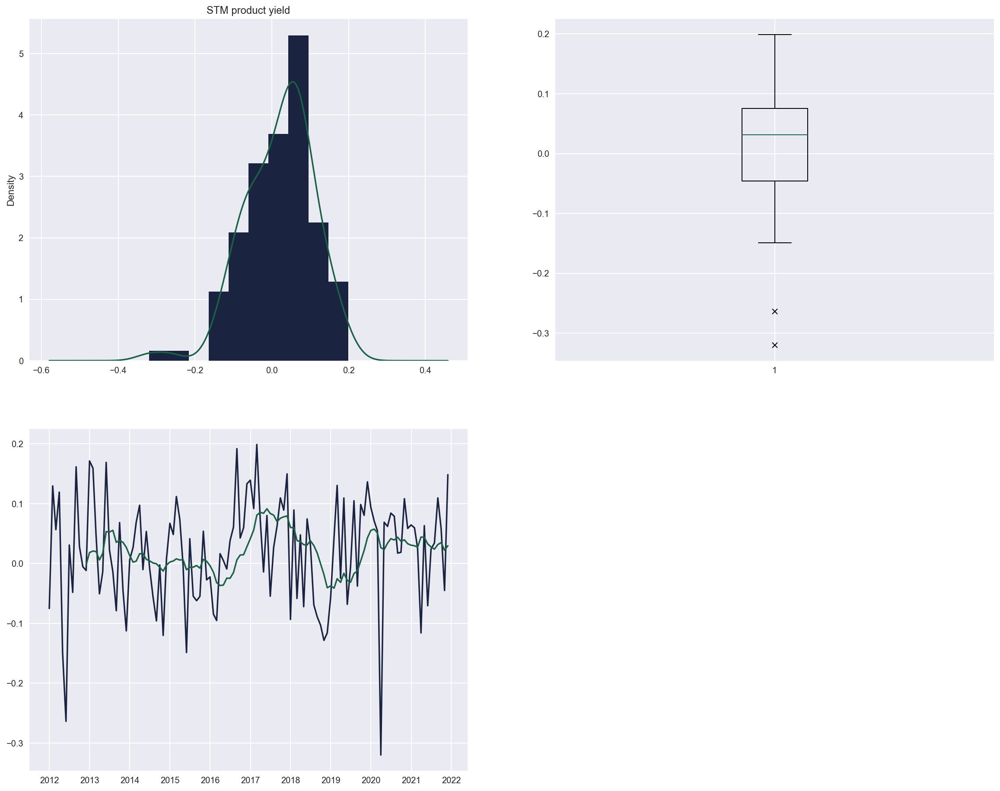

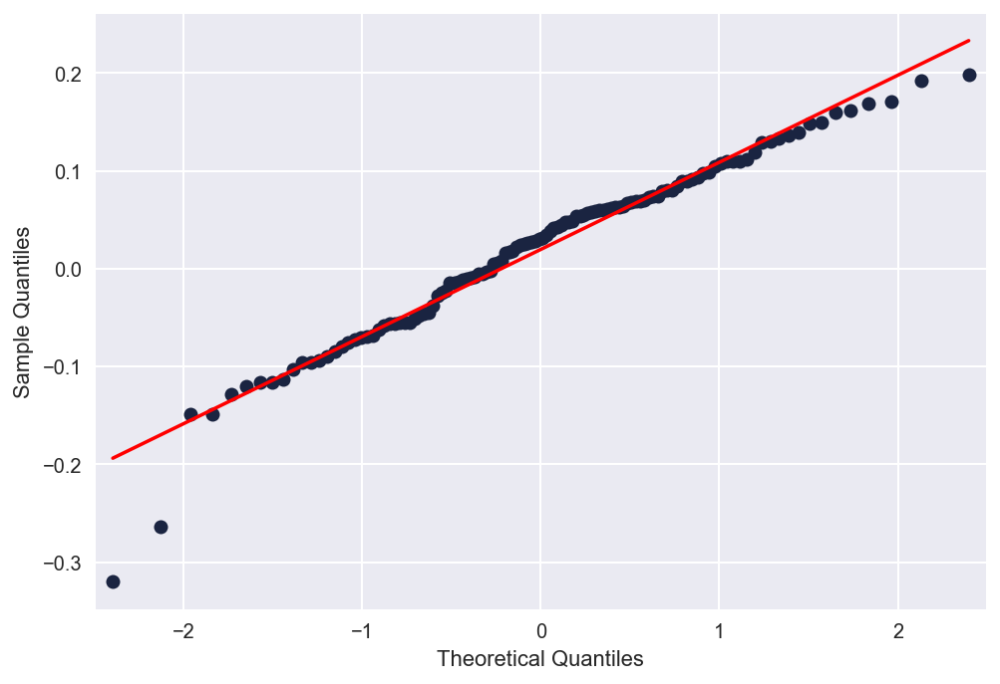

mean: 0.01096388830583809
var: 0.002156949453930858
std: 0.04644296990859713
Asimmetria: -0.28113873001276124
Kurtosis: 2.728184978547901


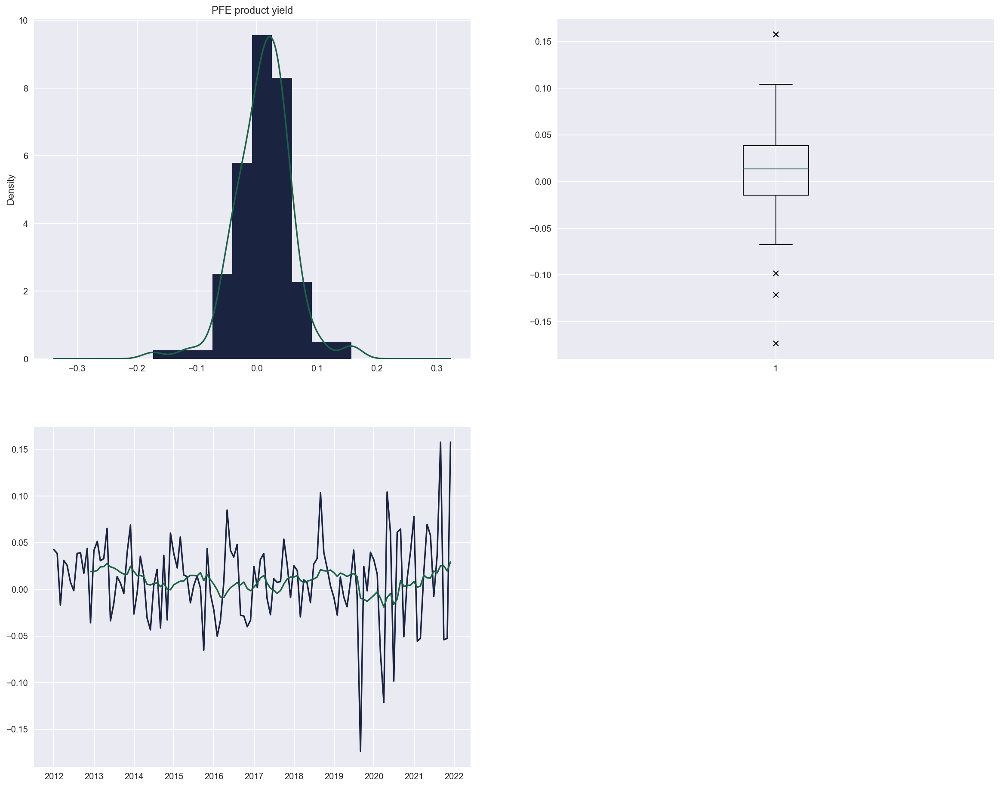

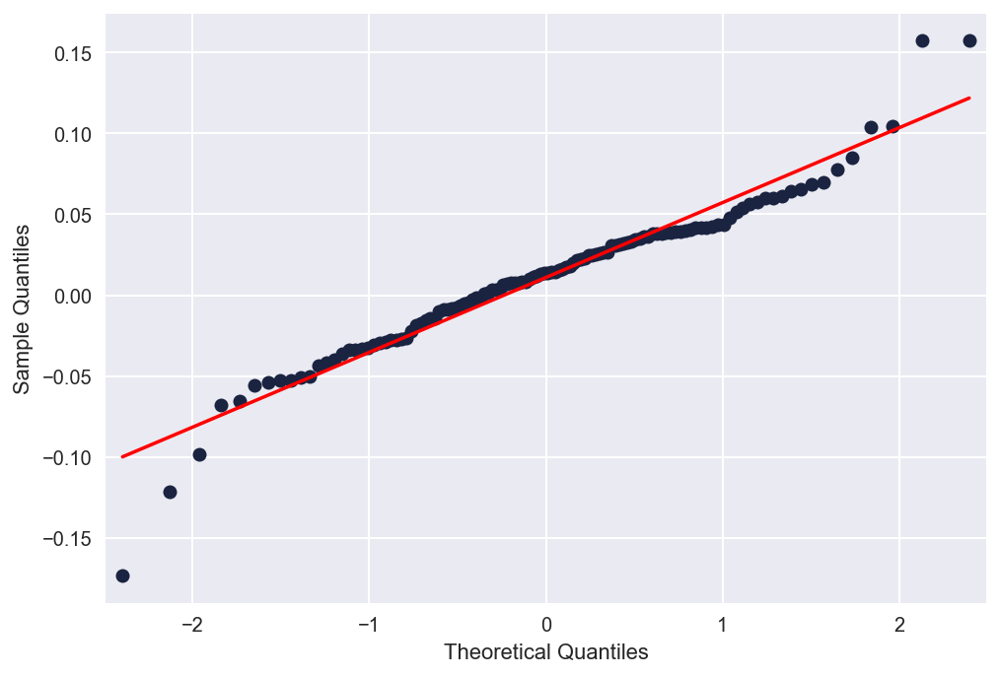

mean: 0.013588756786977466
var: 0.002828349898319291
std: 0.05318223291964423
Asimmetria: -1.488598362242843
Kurtosis: 9.073131380274772


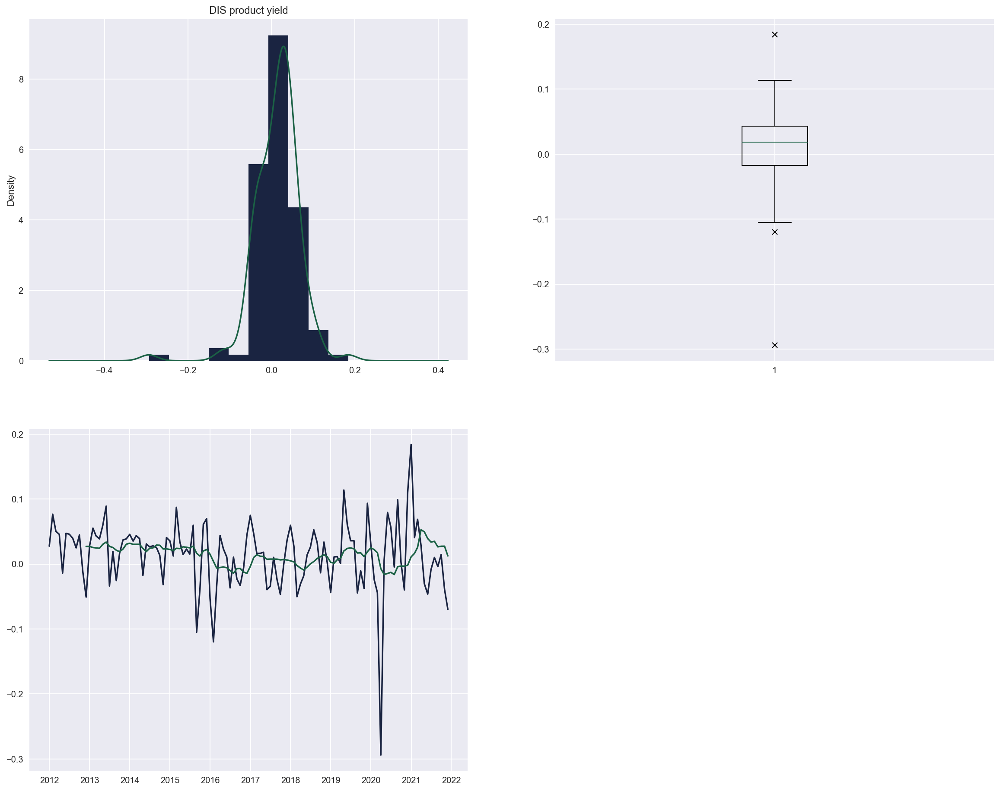

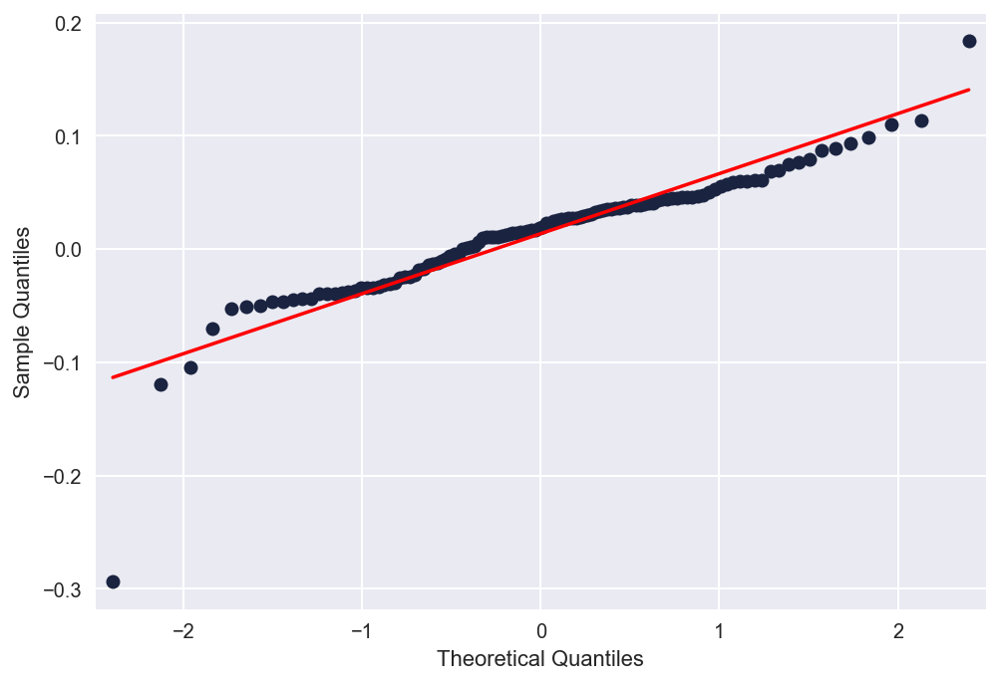

mean: 0.019104081650180328
var: 0.005085012712979554
std: 0.07130927508381749
Asimmetria: -0.20326716888262147
Kurtosis: 0.3206033651550153


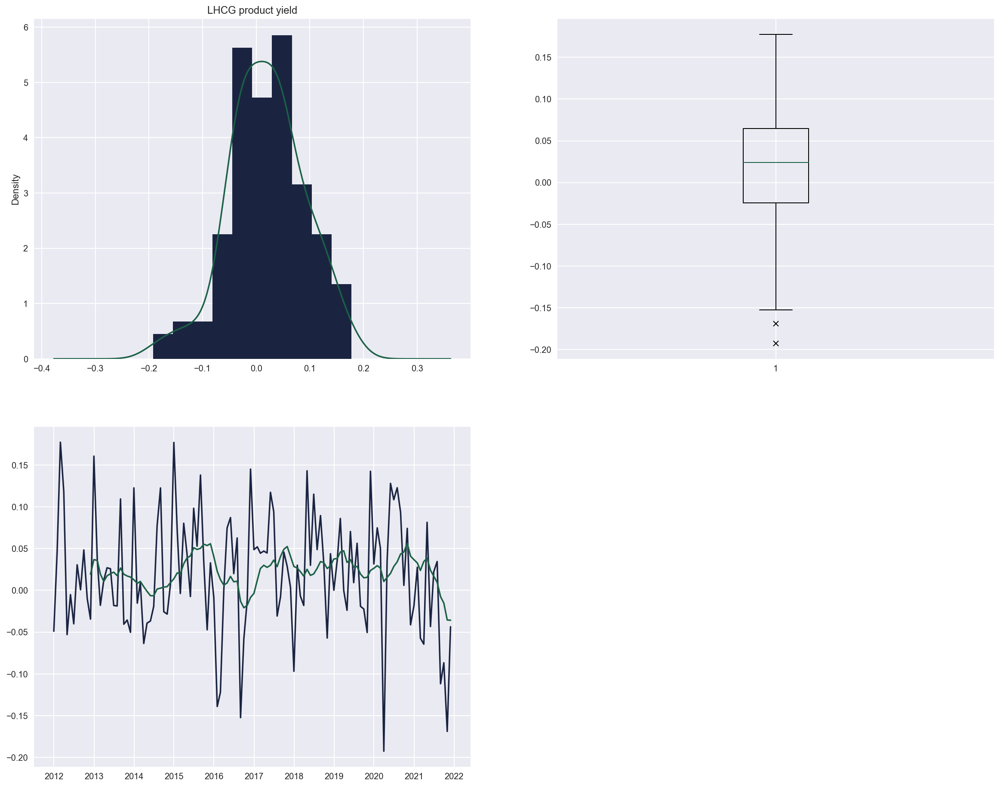

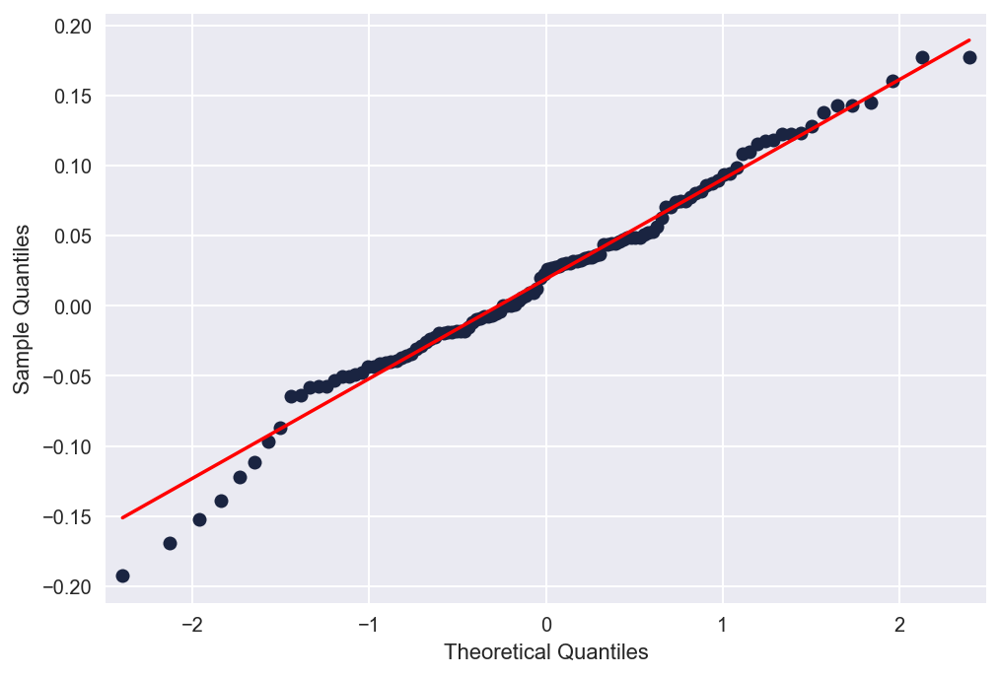

mean: 0.0042846928942912145
var: 0.0033943990695195934
std: 0.058261471570151685
Asimmetria: -1.454528248928088
Kurtosis: 8.263324133214367


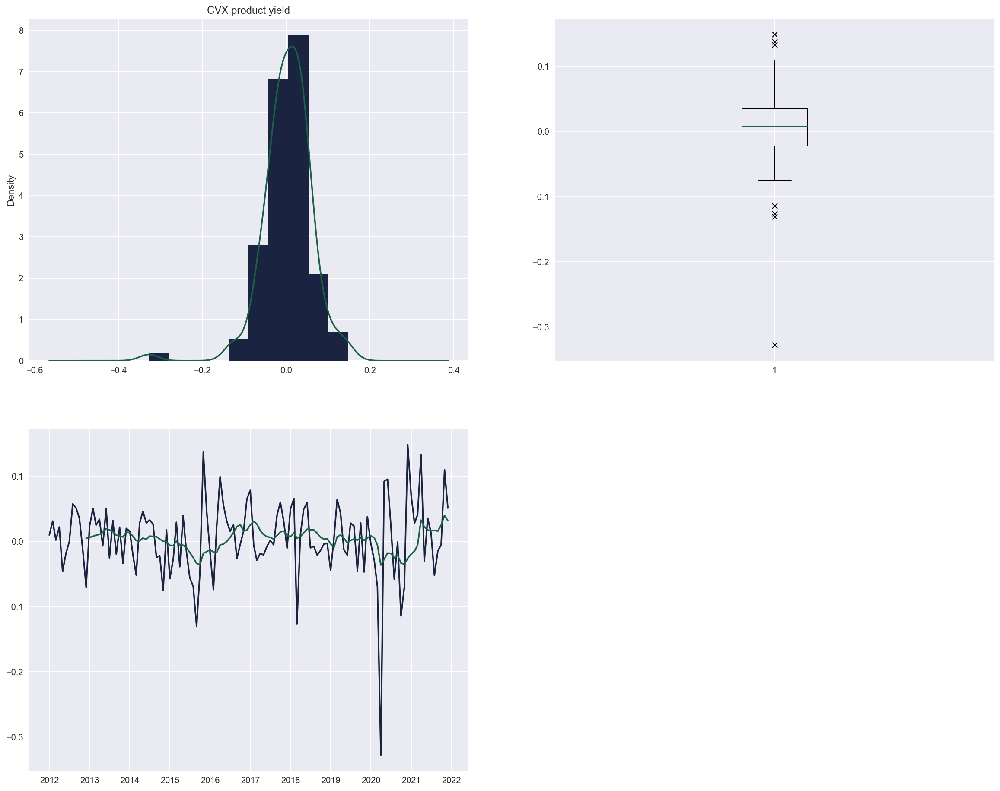

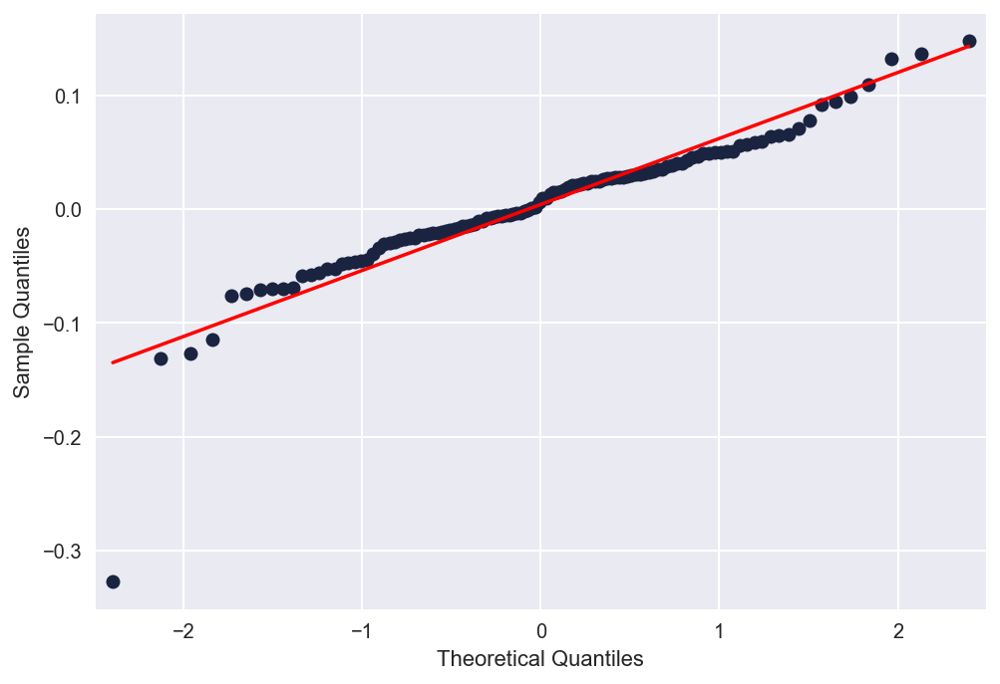

mean: 0.00346387773518659
var: 0.02694259272467185
std: 0.16414198952331438
Asimmetria: 0.10558356901069592
Kurtosis: 1.5808290774487546


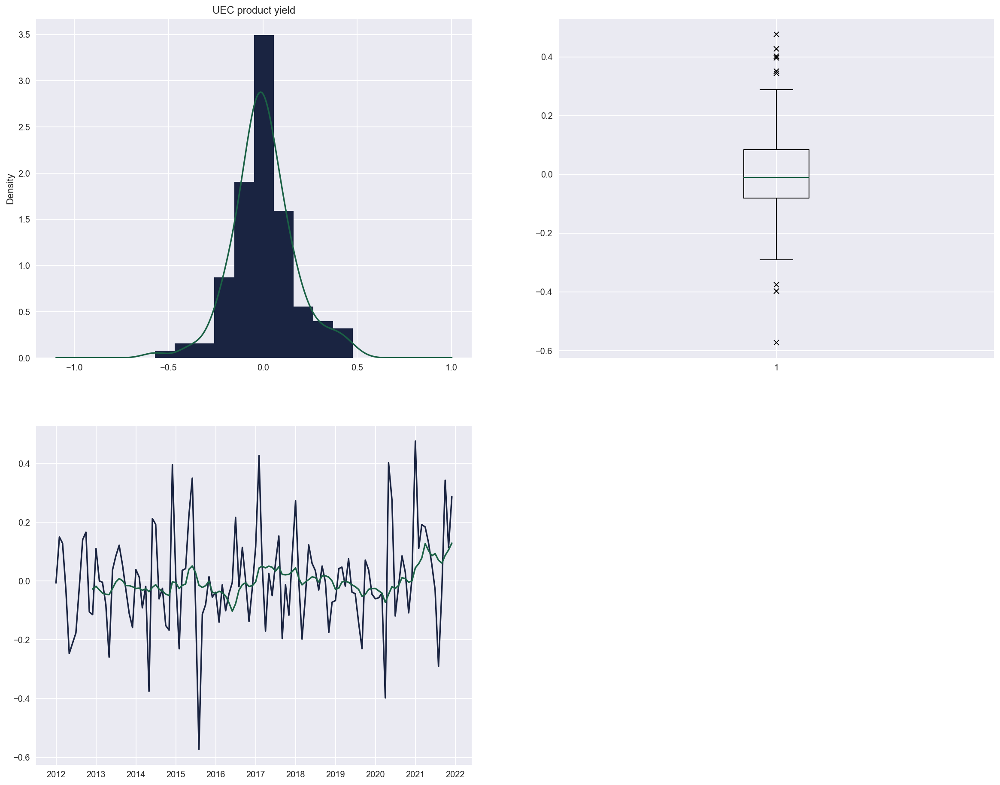

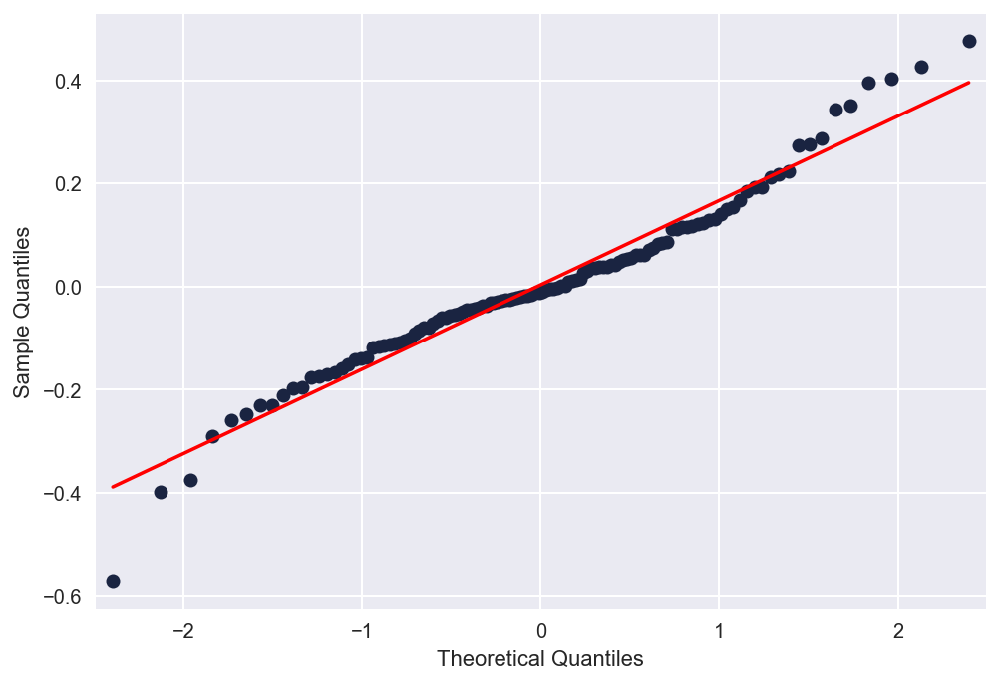

mean: 0.010999089609183811
var: 0.0010235895857603464
std: 0.03199358663482959
Asimmetria: -3.042381185954257
Kurtosis: 18.897394494733447


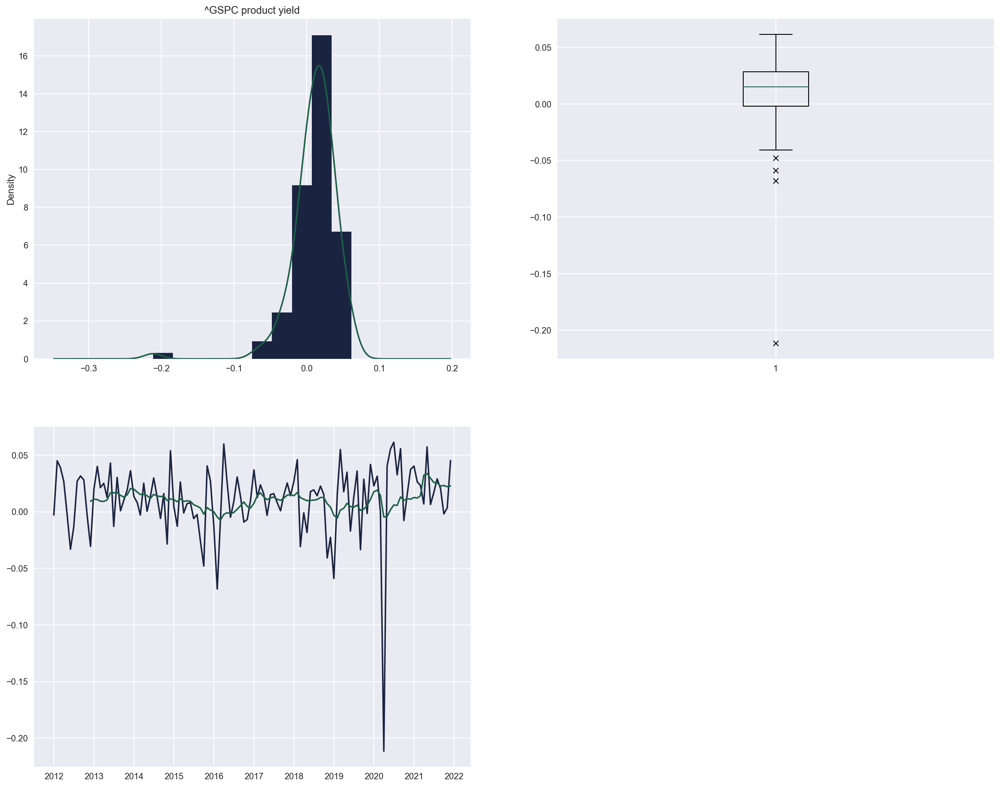

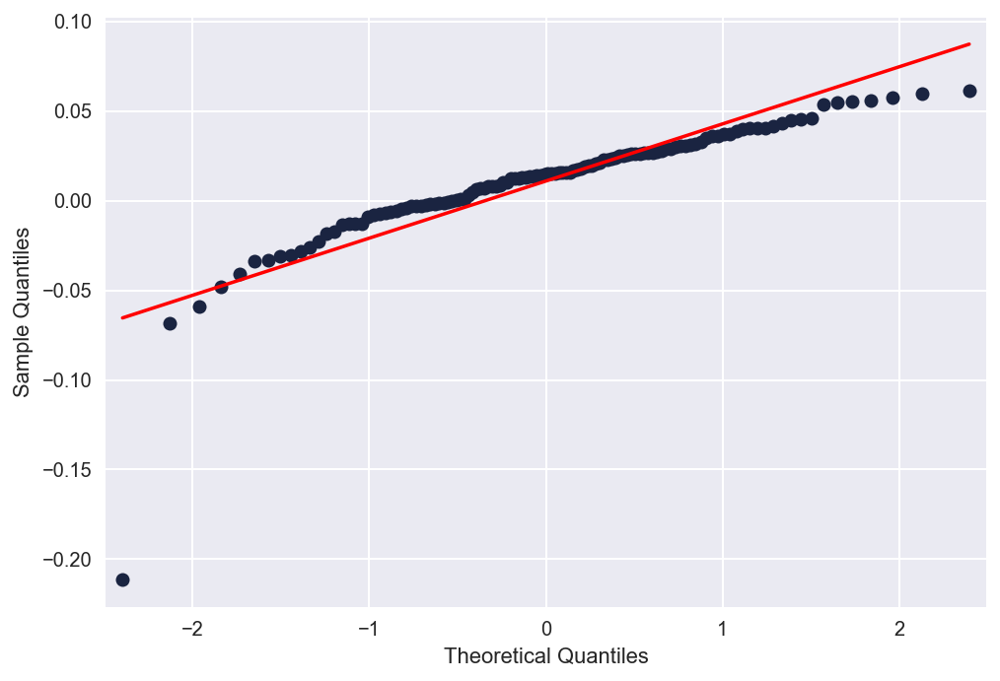

In [69]:
for col in merged_yield_m.columns:
    plt.figure(figsize=(20, 16))
    plt.subplot(221)
    plt.title(f"{col} product yield")
    plt.hist(merged_yield_m[col], density = True)
    merged_yield_m[col].plot.density()
    

    
    plt.subplot(222)
    plt.boxplot(merged_yield_m[col], sym = 'x')
    
    
    
    
    plt.subplot(223)
    plt.plot(merged_yield_m[col])
    plt.plot(merged_yield_m[col].rolling(12).mean(), label="Year Mean")
    
    
    sm.qqplot(merged_yield_m[col], line = 's')
    
    print(f"mean: {merged_yield_m[col].mean()}")
    print(f"var: {merged_yield_m[col].var()}")
    print(f"std: {merged_yield_m[col].std()}")
    print(f"Asimmetria: {merged_yield_m[col].skew()}")
    print(f"Kurtosis: {merged_yield_m[col].kurtosis()}")
    
    plt.show()

In [70]:
merged_yield_m.mean().sort_values(ascending=False)

NVDA     0.036988
NFLX     0.035686
AMD      0.027095
AMZN     0.024221
AAPL     0.021487
STM      0.019802
LHCG     0.019104
GOOG     0.019084
STLA     0.018413
DIS      0.013589
^GSPC    0.010999
PFE      0.010964
CVX      0.004285
UEC      0.003464
E        0.001367
IBM     -0.000470
dtype: float64

In [71]:
merged_yield_m.var().sort_values(ascending=False)

UEC      0.026943
AMD      0.019311
NFLX     0.012083
STLA     0.009753
NVDA     0.008051
STM      0.007995
LHCG     0.005085
E        0.004546
AAPL     0.004515
AMZN     0.003961
CVX      0.003394
DIS      0.002828
GOOG     0.002503
IBM      0.002357
PFE      0.002157
^GSPC    0.001024
dtype: float64

In [72]:
merged_yield_m.std().sort_values(ascending=False)

UEC      0.164142
AMD      0.138962
NFLX     0.109924
STLA     0.098759
NVDA     0.089728
STM      0.089415
LHCG     0.071309
E        0.067424
AAPL     0.067194
AMZN     0.062936
CVX      0.058261
DIS      0.053182
GOOG     0.050030
IBM      0.048544
PFE      0.046443
^GSPC    0.031994
dtype: float64

In [73]:
# asimmetria

merged_yield_m.skew().sort_values(ascending=False)

AMD      0.219724
NFLX     0.149207
UEC      0.105584
AMZN    -0.067932
LHCG    -0.203267
AAPL    -0.270631
STLA    -0.274300
PFE     -0.281139
NVDA    -0.309974
STM     -0.694931
GOOG    -0.697993
CVX     -1.454528
E       -1.465953
IBM     -1.469741
DIS     -1.488598
^GSPC   -3.042381
dtype: float64

In [74]:
merged_yield_m.kurtosis().sort_values(ascending=False)

^GSPC    18.897394
DIS       9.073131
E         8.276711
CVX       8.263324
IBM       7.554549
PFE       2.728185
GOOG      2.703543
NFLX      1.733200
STLA      1.639248
UEC       1.580829
NVDA      1.433081
STM       1.209224
AAPL      0.375131
AMZN      0.366925
LHCG      0.320603
AMD       0.298256
dtype: float64

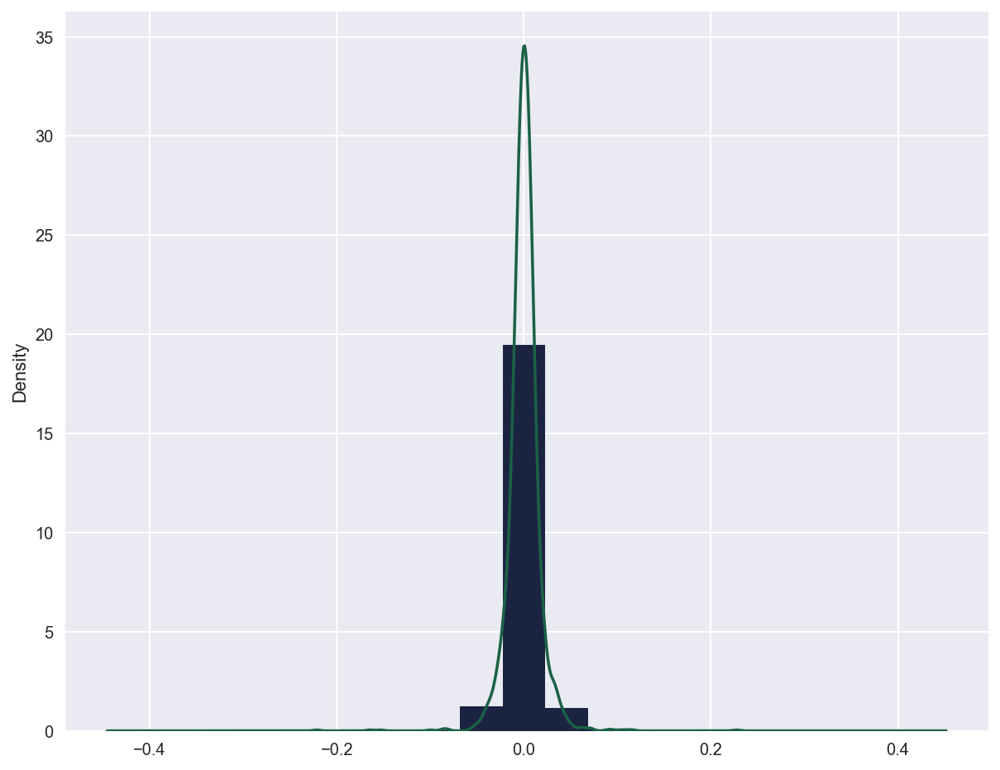

In [75]:
plt.figure(figsize=(10, 8))

plt.hist(merged_yield['CVX'], density = True)
pct_yield['CVX'].plot.density()
plt.show()

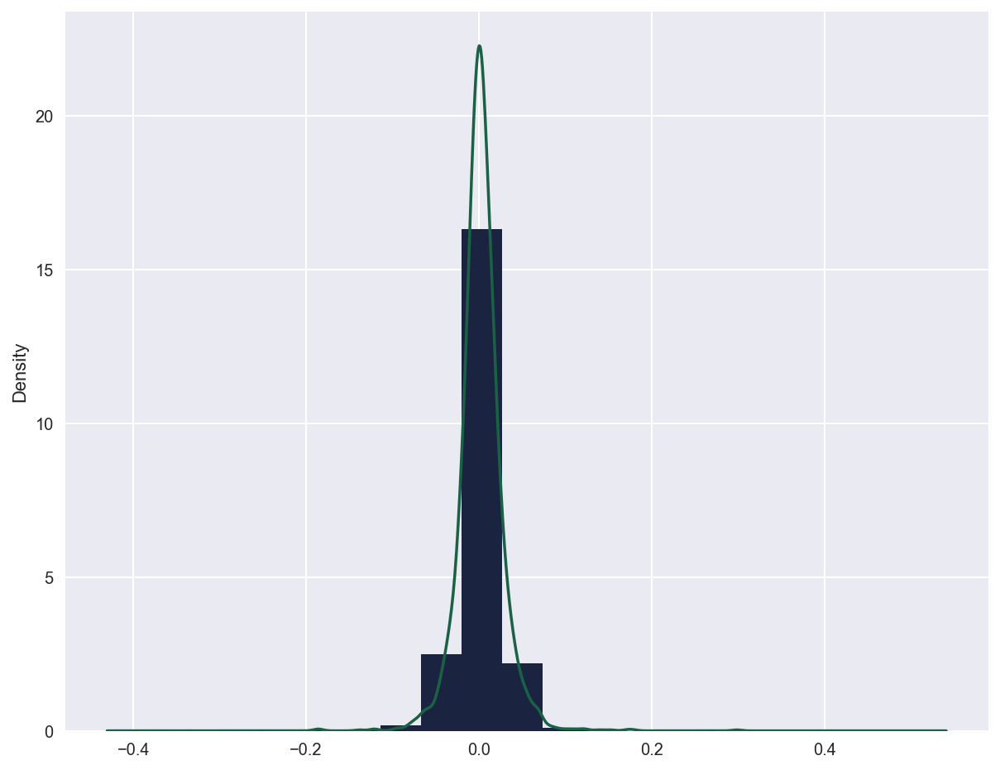

In [76]:
plt.figure(figsize=(10, 8))

plt.hist(merged_yield['NVDA'], density = True)
pct_yield['NVDA'].plot.density()
plt.show()

<Figure size 720x576 with 0 Axes>

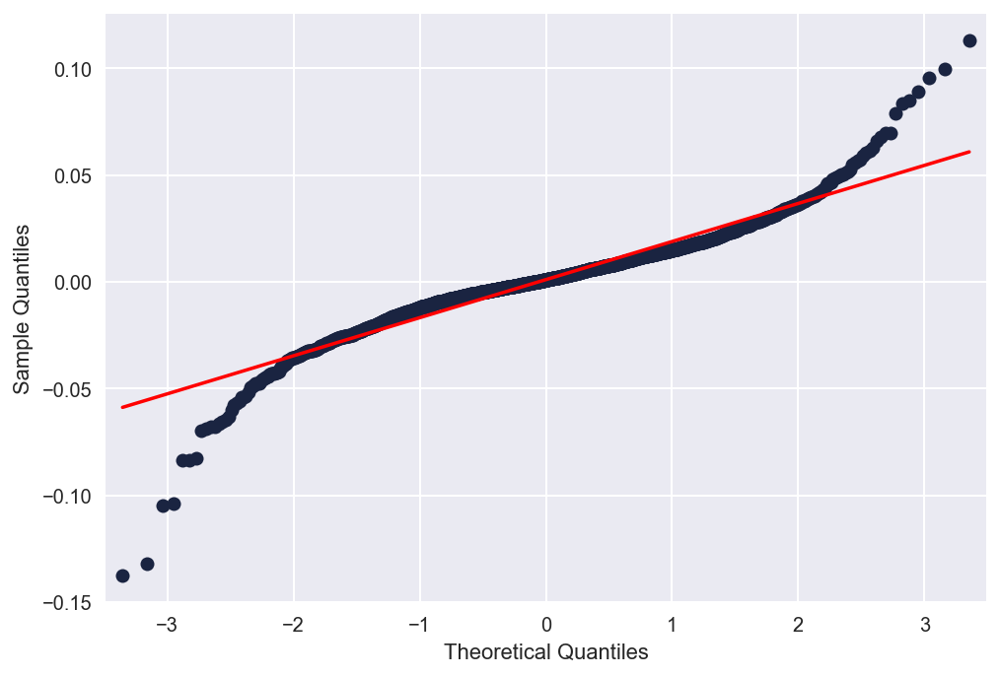

<Figure size 720x576 with 0 Axes>

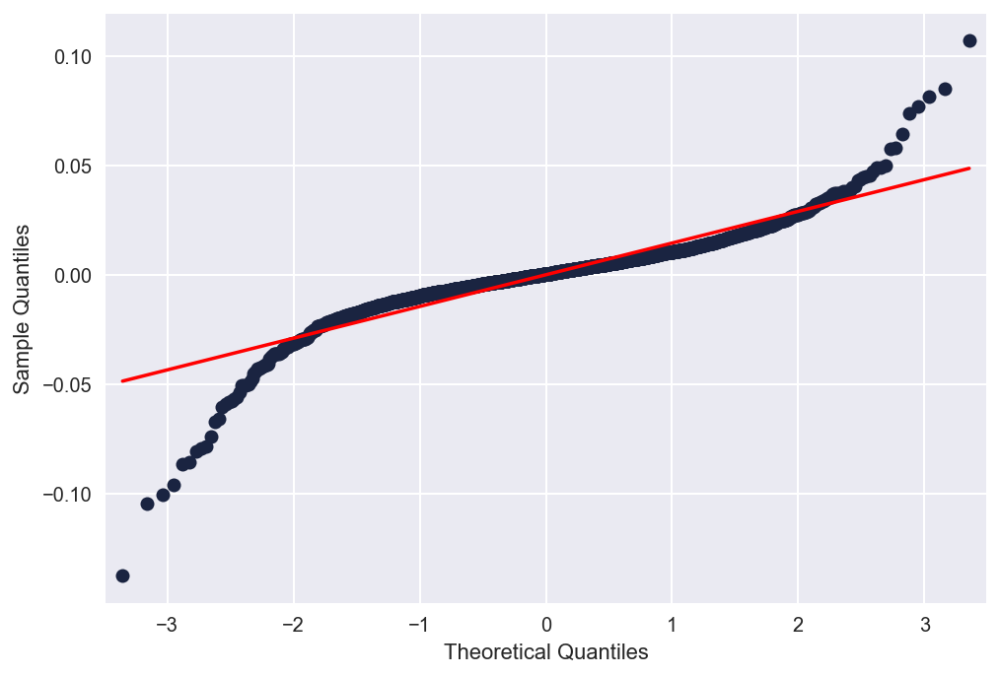

<Figure size 720x576 with 0 Axes>

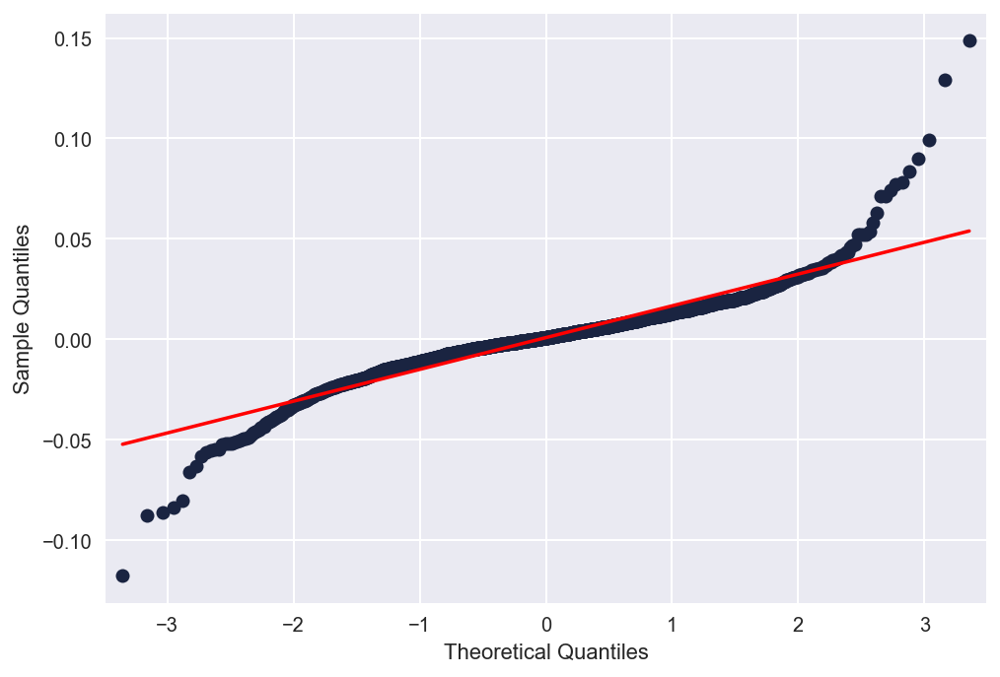

<Figure size 720x576 with 0 Axes>

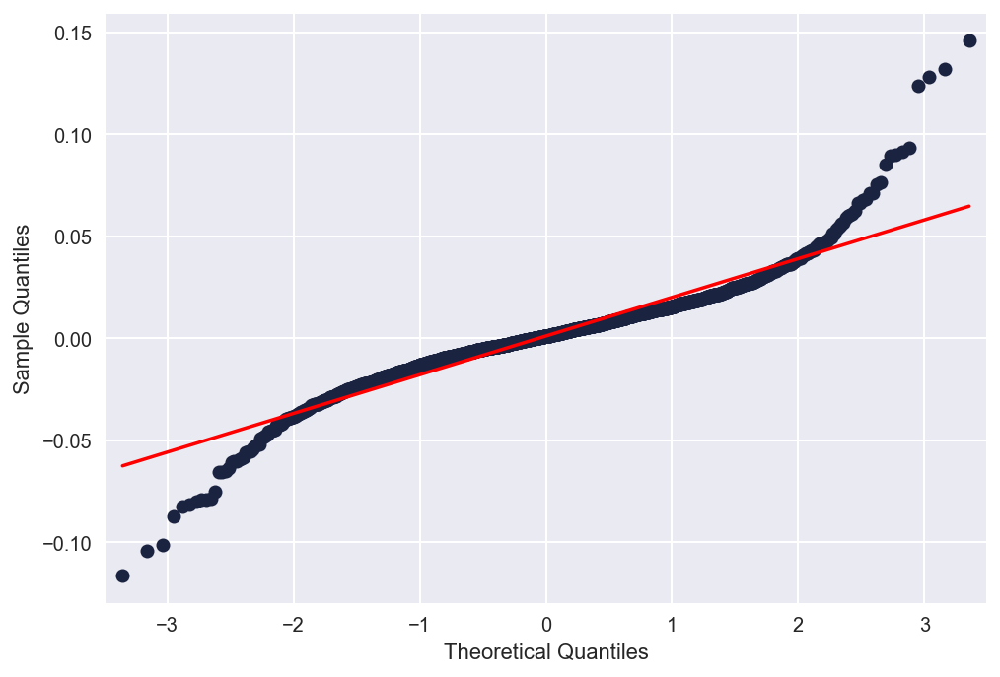

<Figure size 720x576 with 0 Axes>

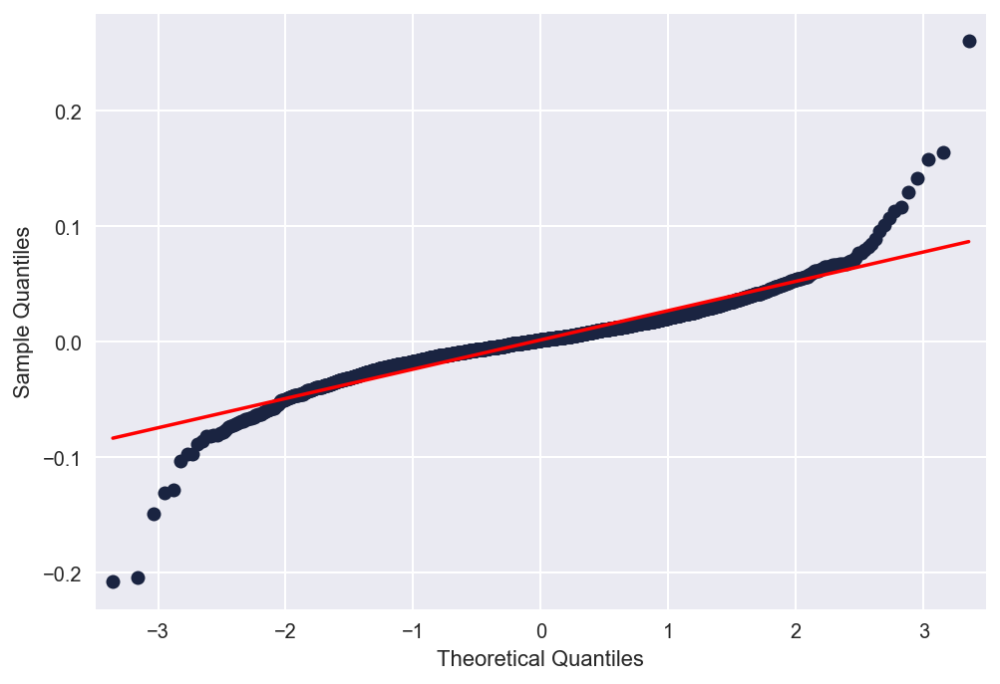

<Figure size 720x576 with 0 Axes>

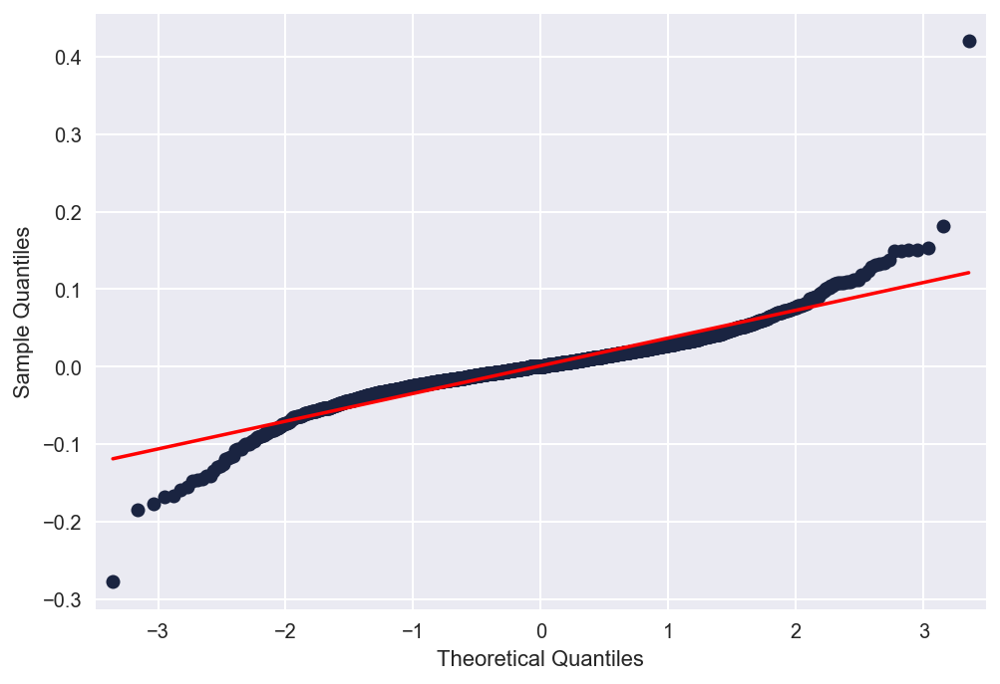

<Figure size 720x576 with 0 Axes>

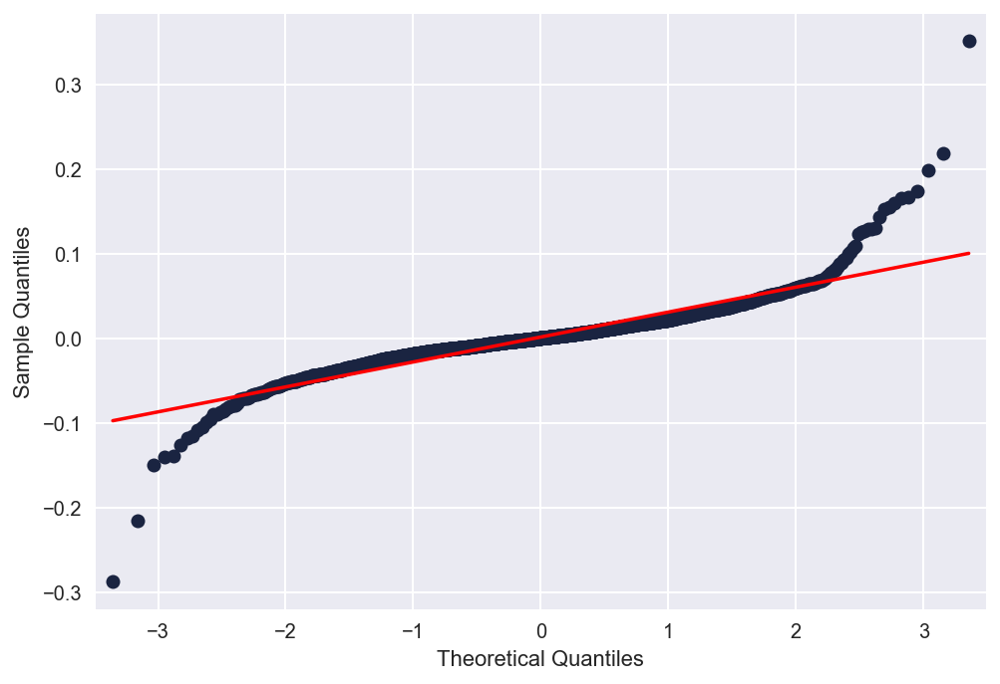

<Figure size 720x576 with 0 Axes>

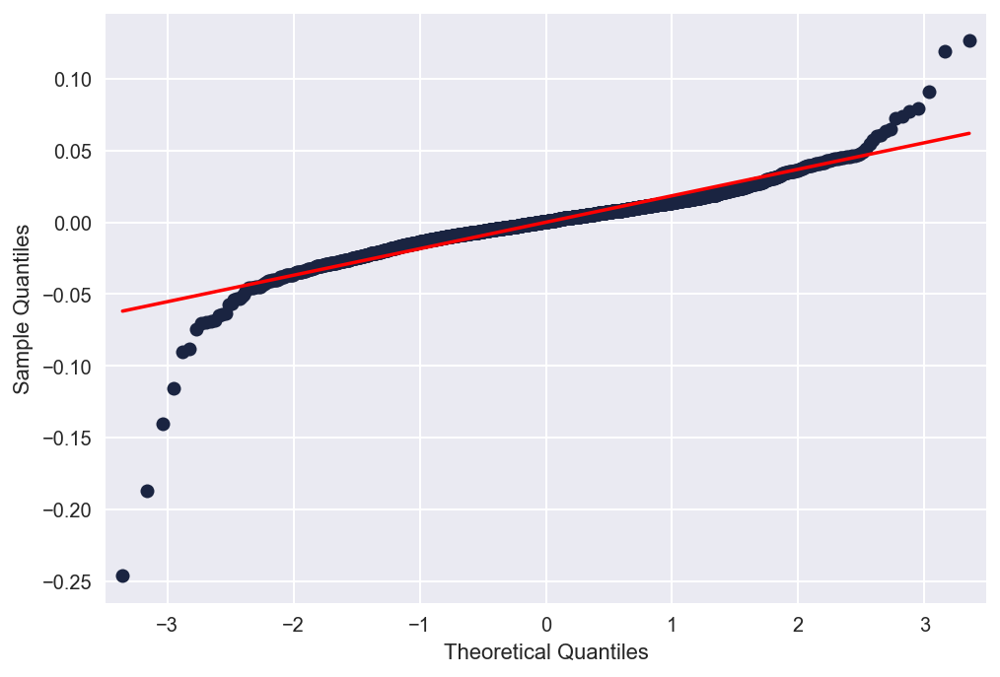

<Figure size 720x576 with 0 Axes>

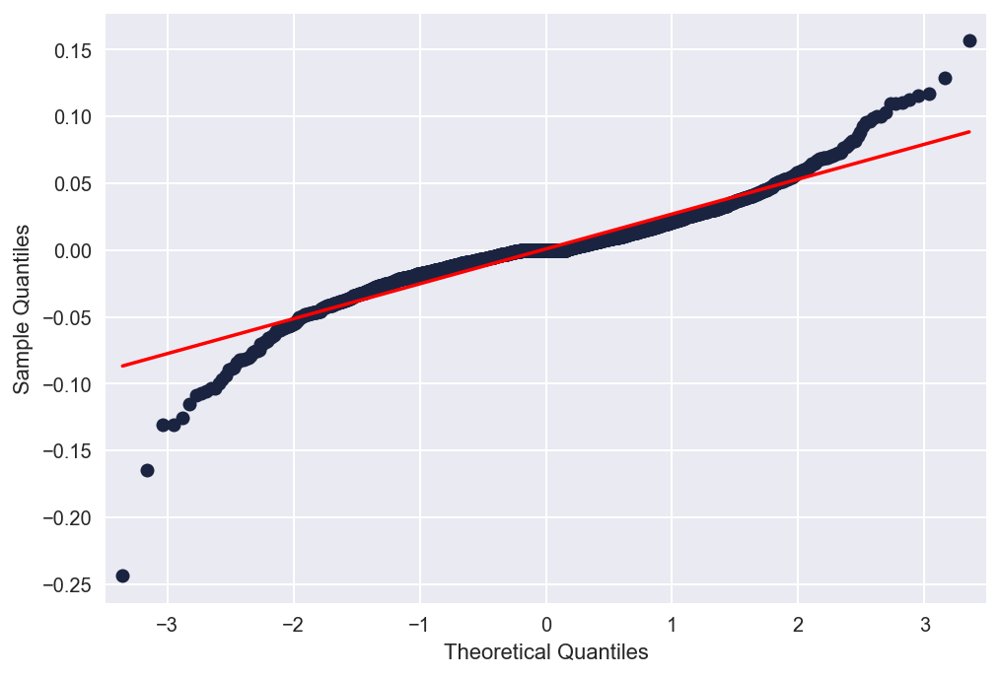

<Figure size 720x576 with 0 Axes>

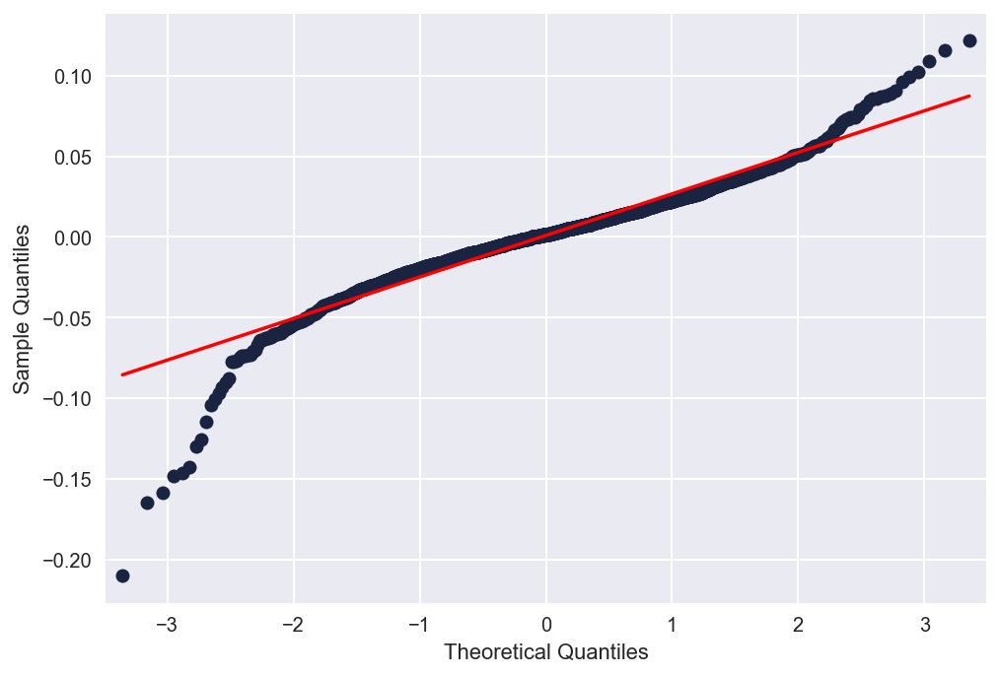

<Figure size 720x576 with 0 Axes>

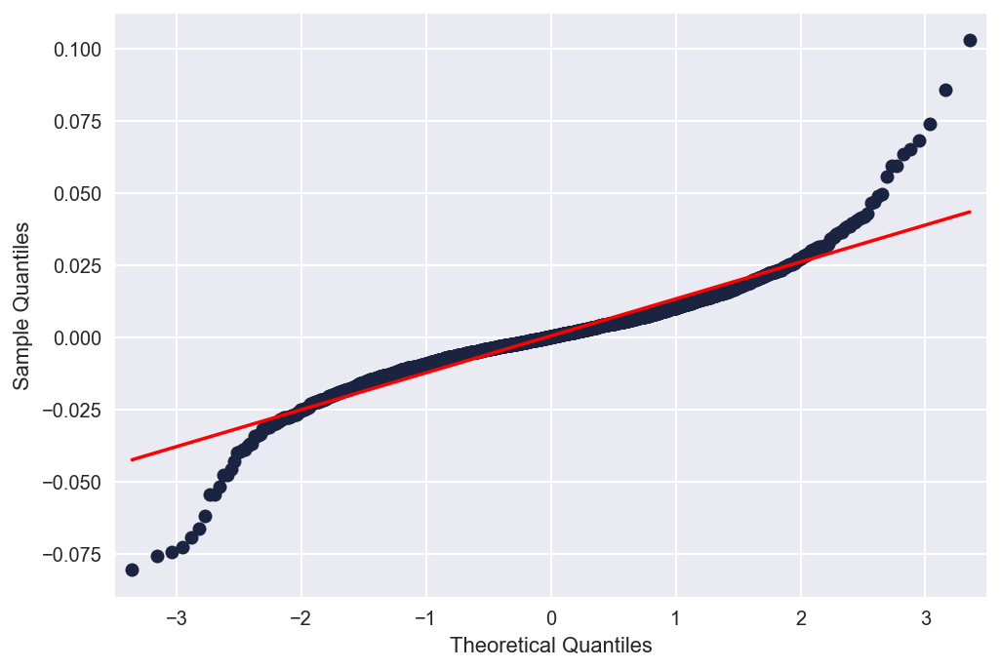

<Figure size 720x576 with 0 Axes>

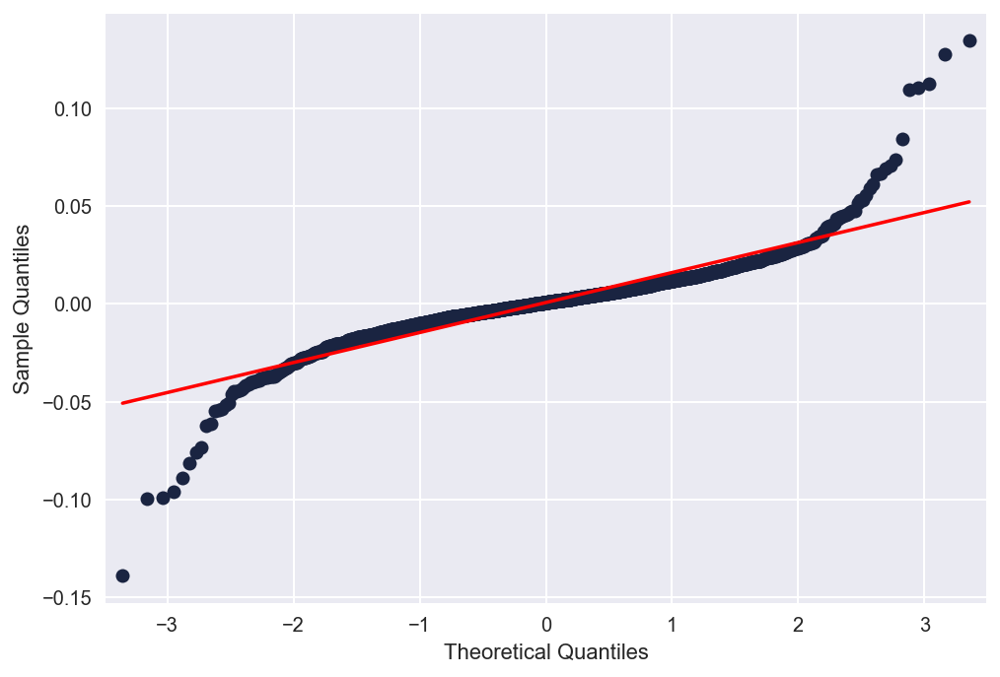

<Figure size 720x576 with 0 Axes>

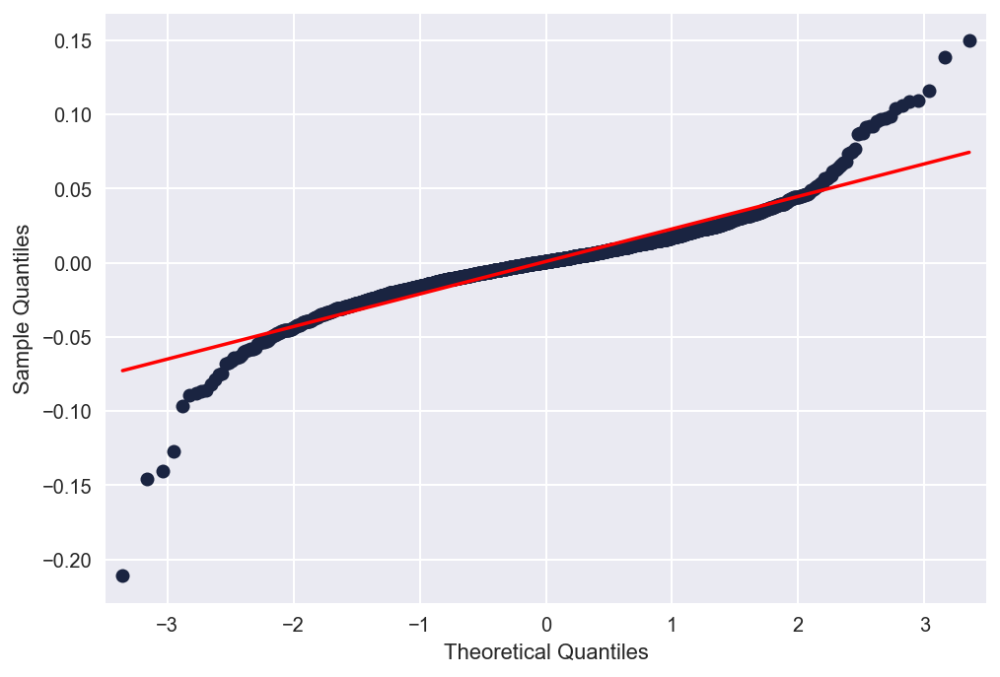

<Figure size 720x576 with 0 Axes>

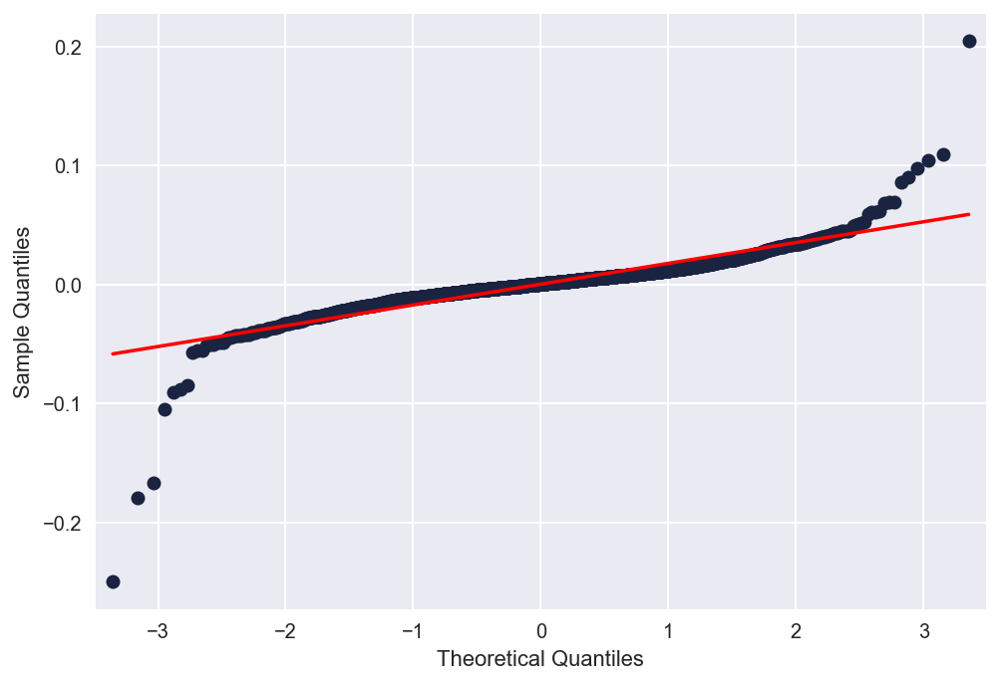

<Figure size 720x576 with 0 Axes>

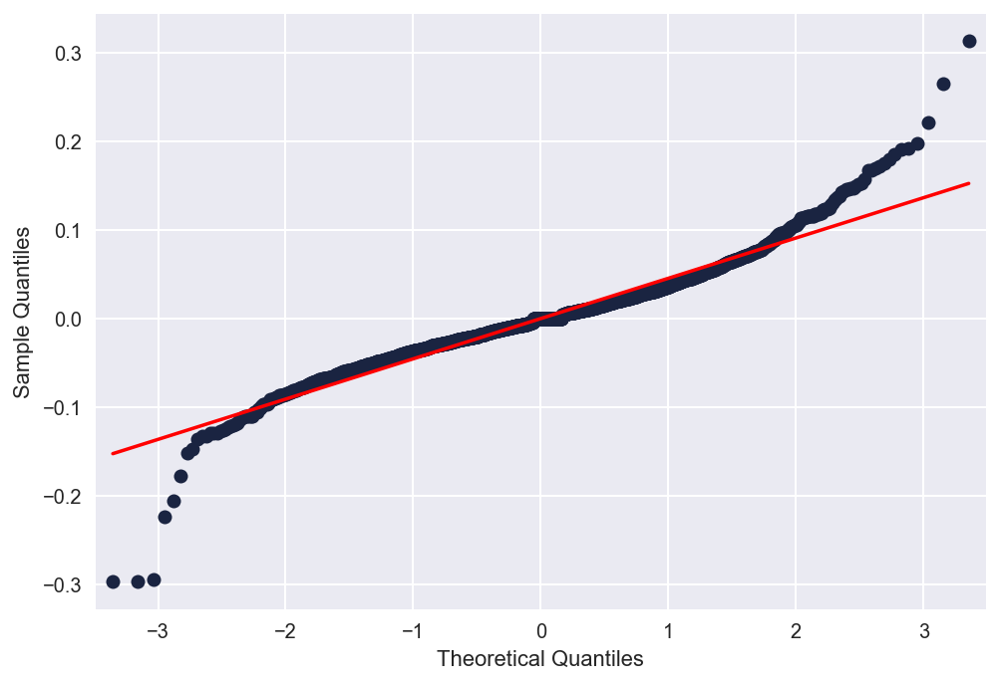

<Figure size 720x576 with 0 Axes>

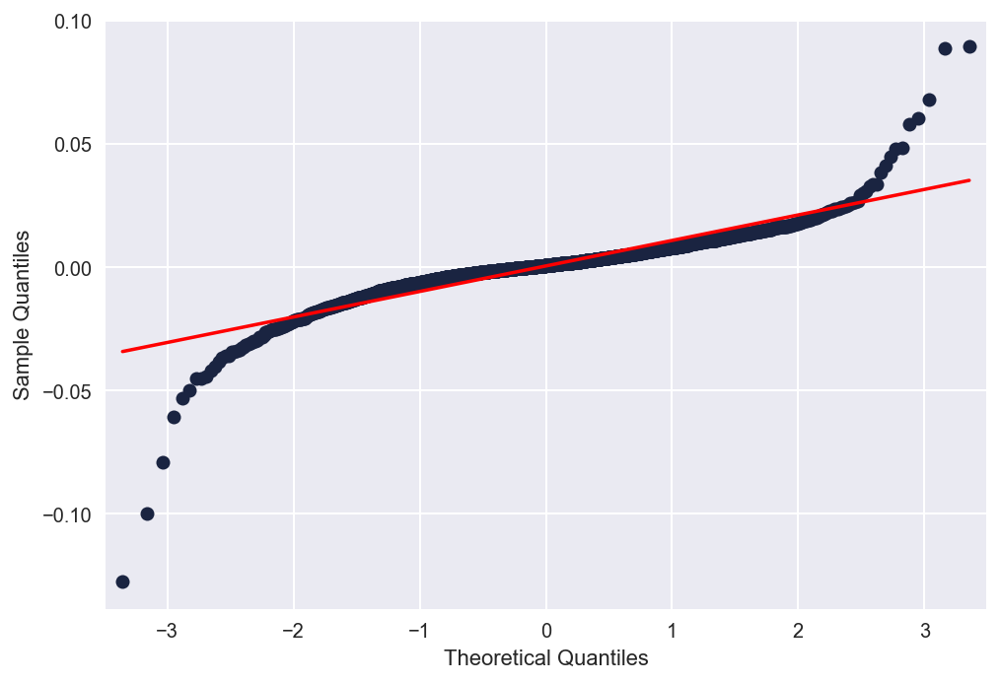

In [77]:
for col in merged_yield.columns:
    plt.figure(figsize=(10, 8))

    sm.qqplot(merged_yield[col], line='s')


    plt.show()

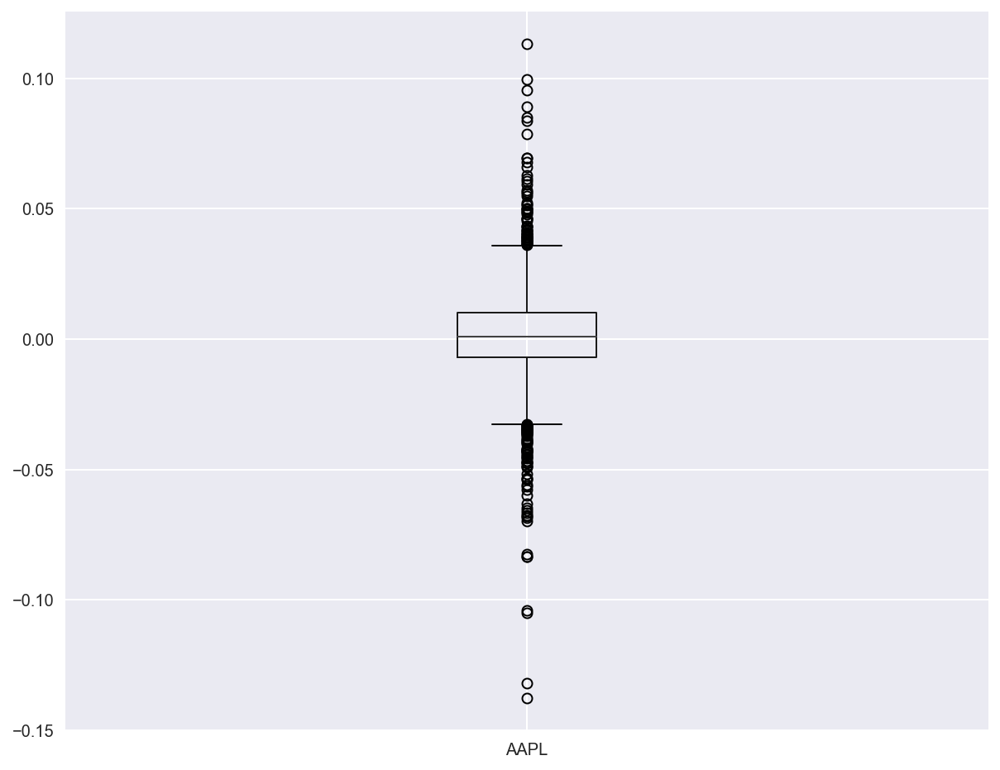

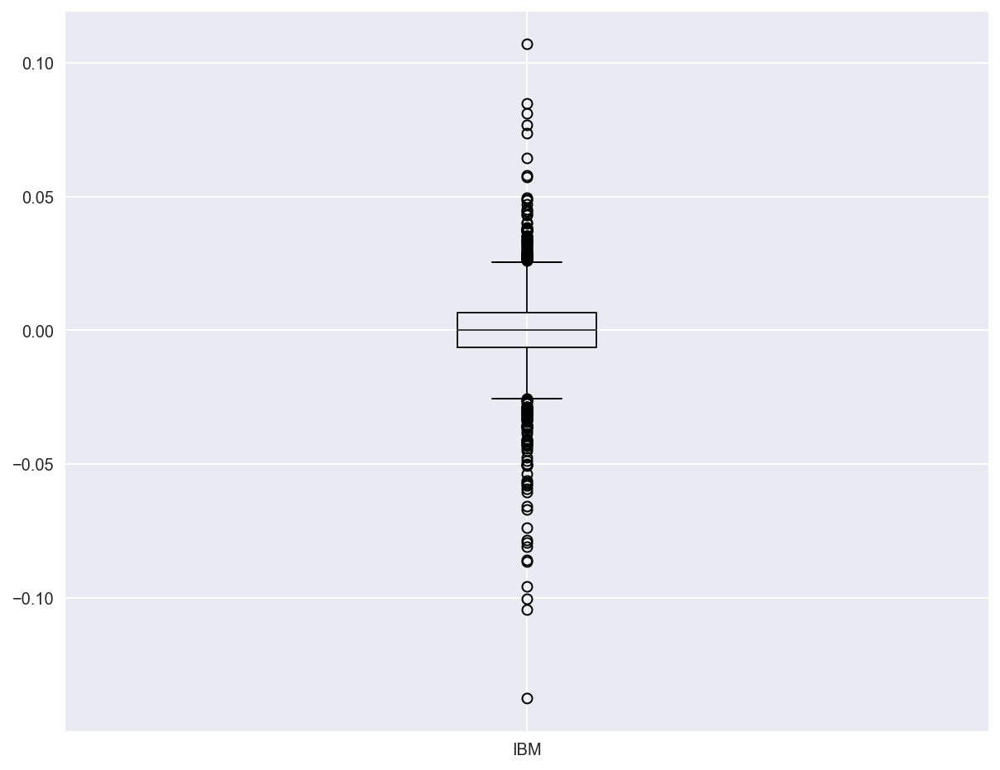

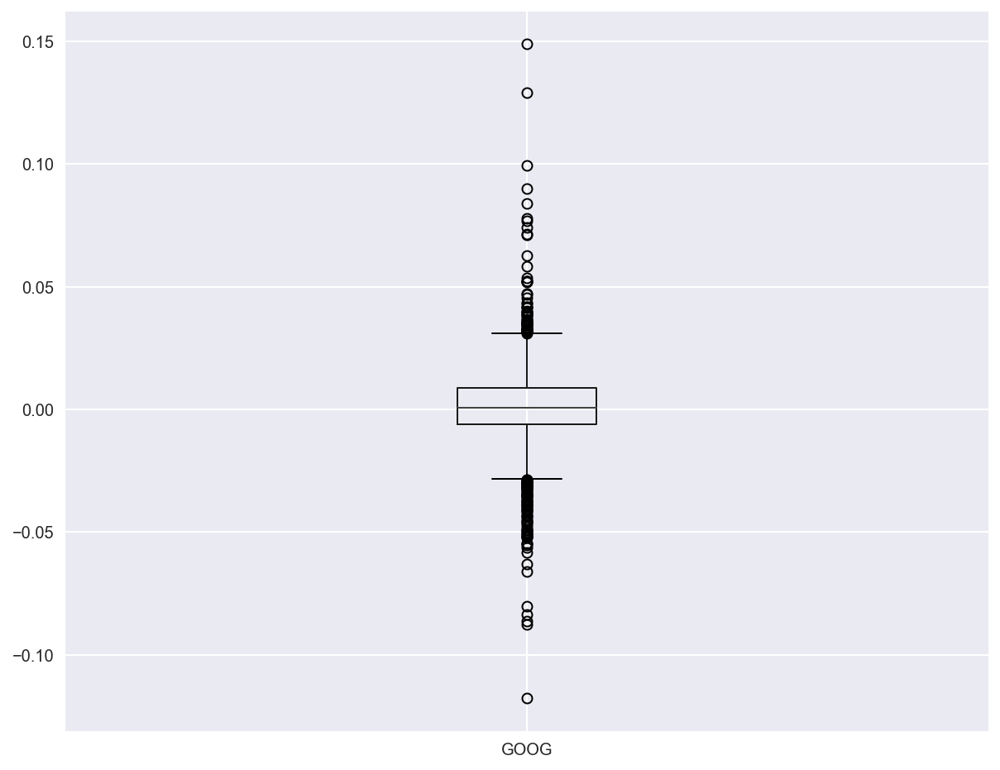

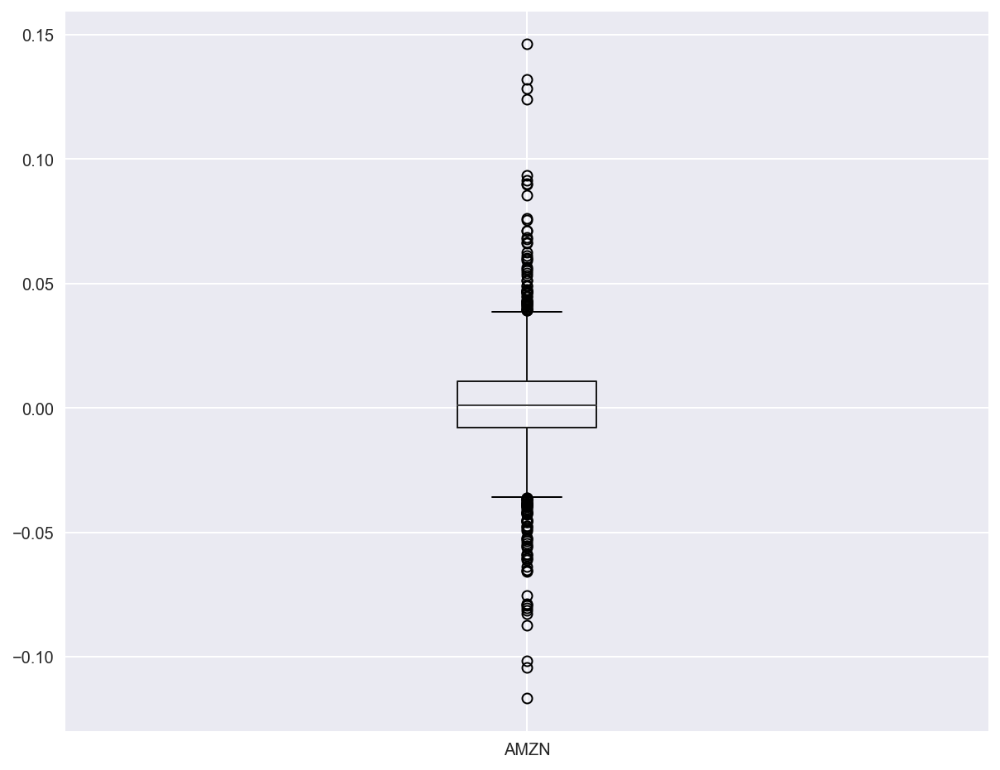

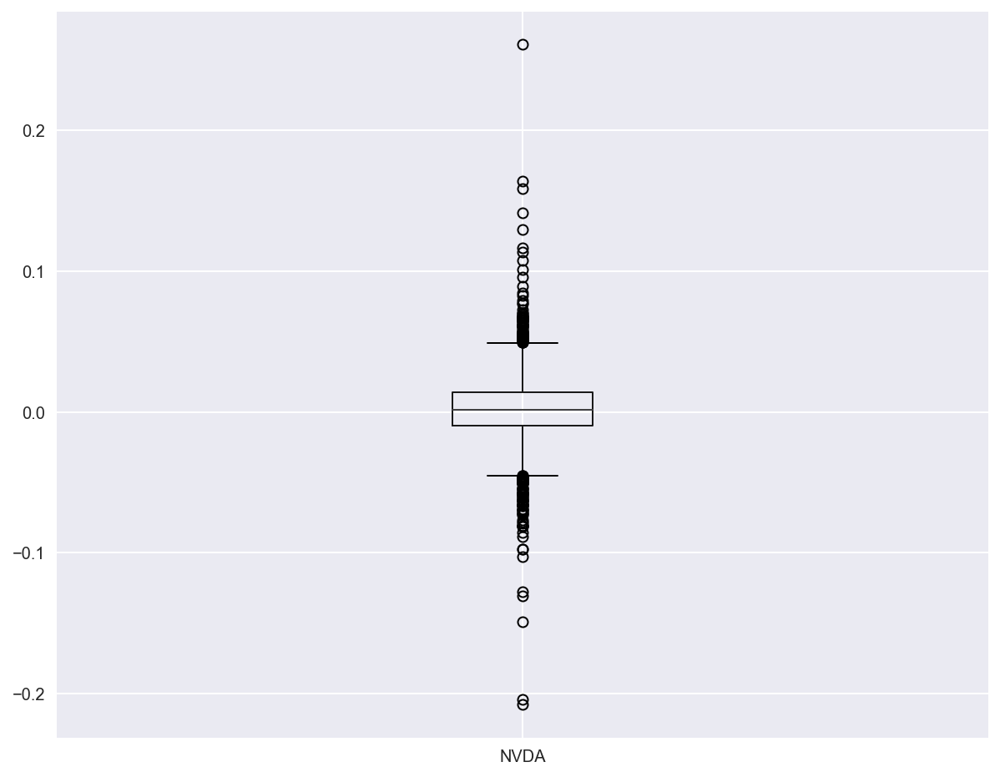

...

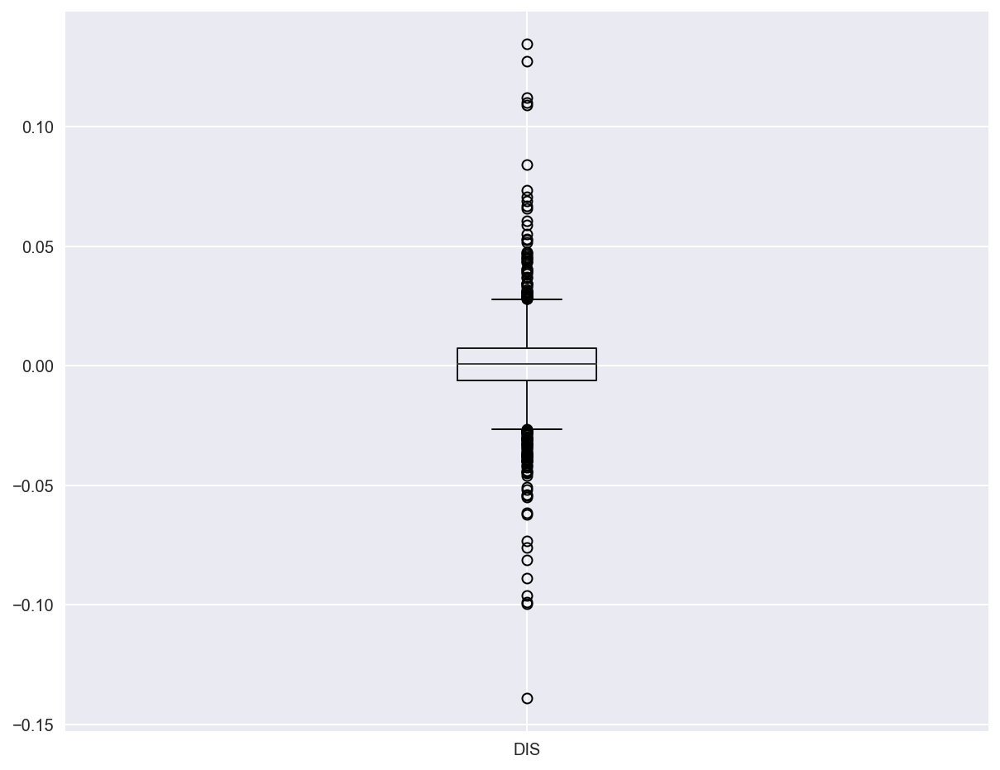

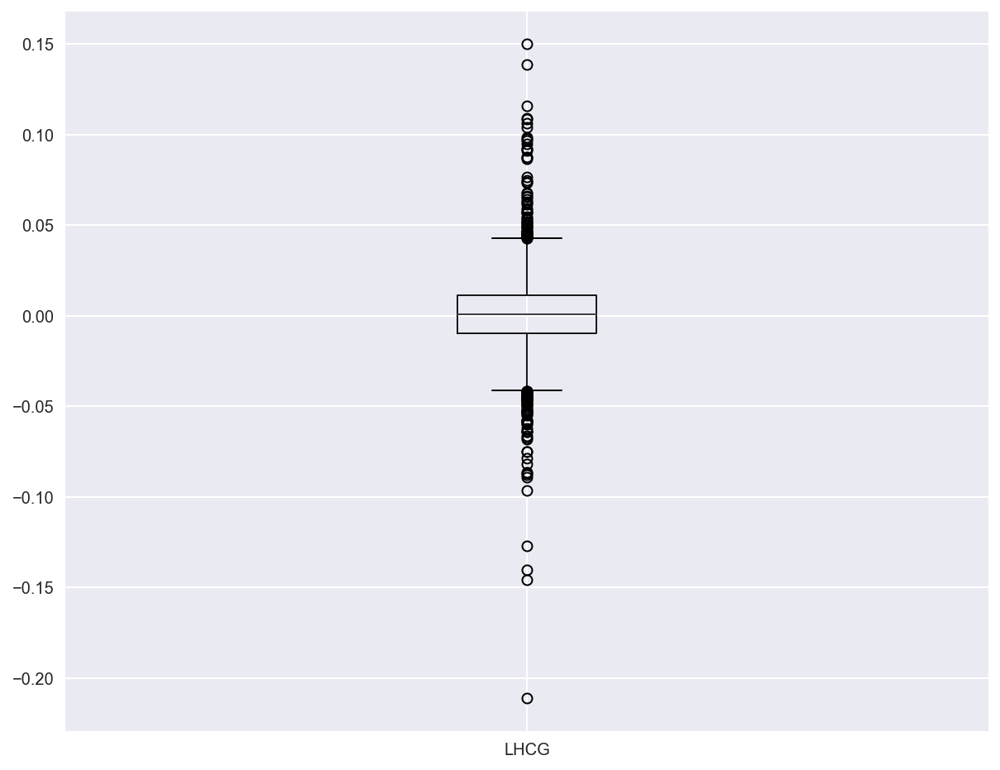

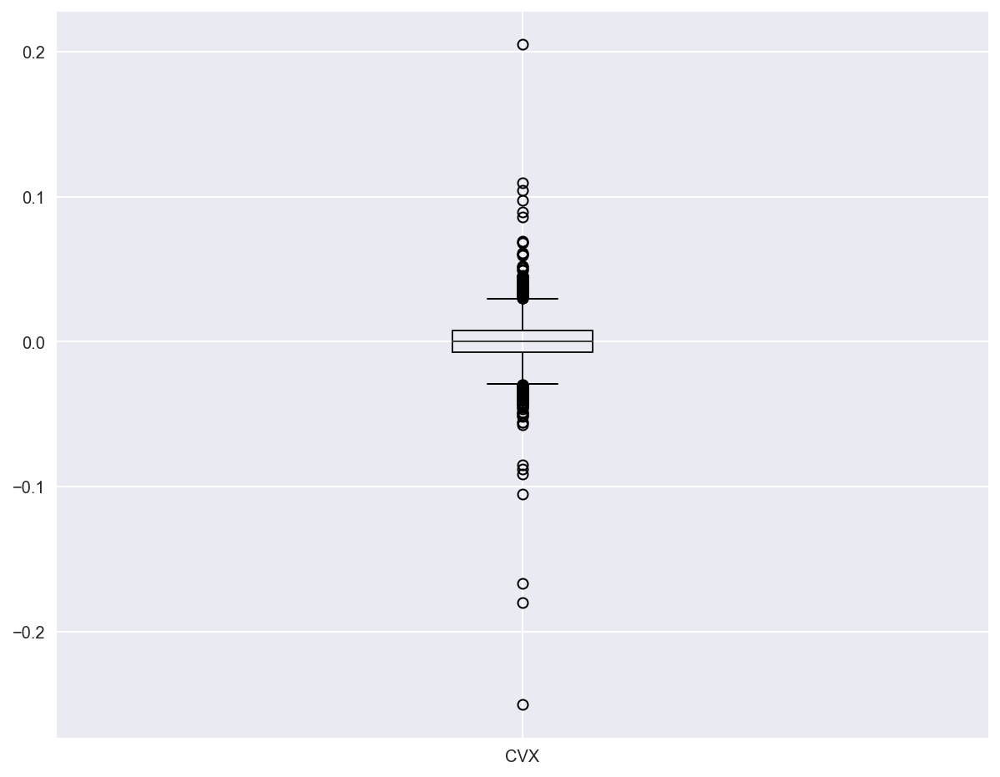

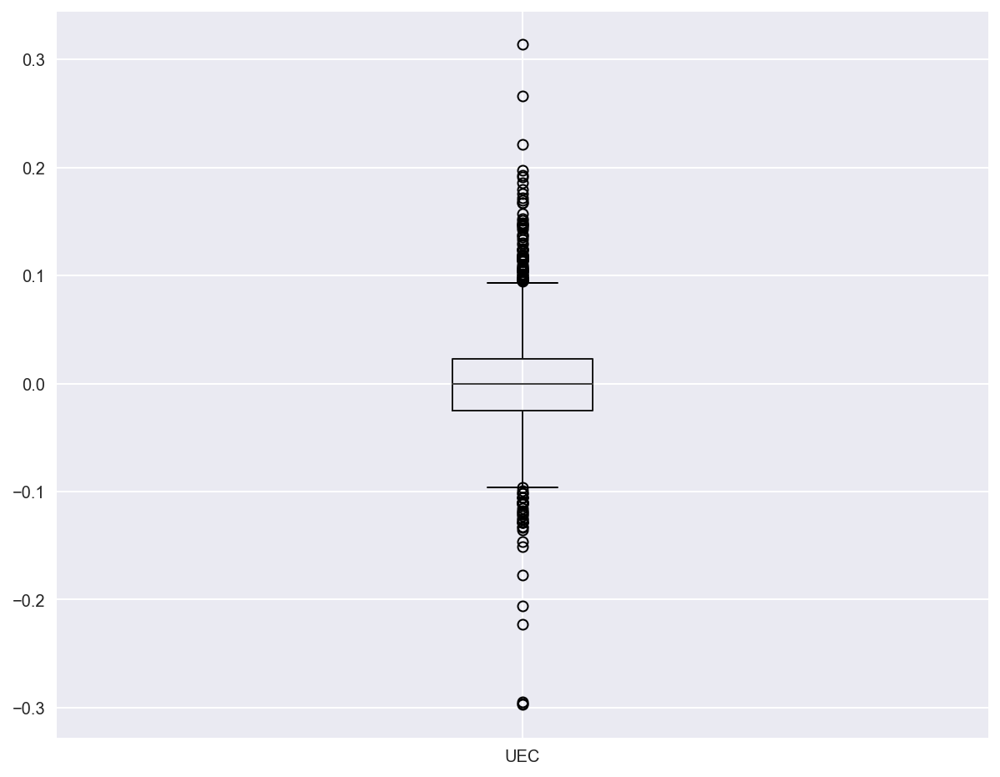

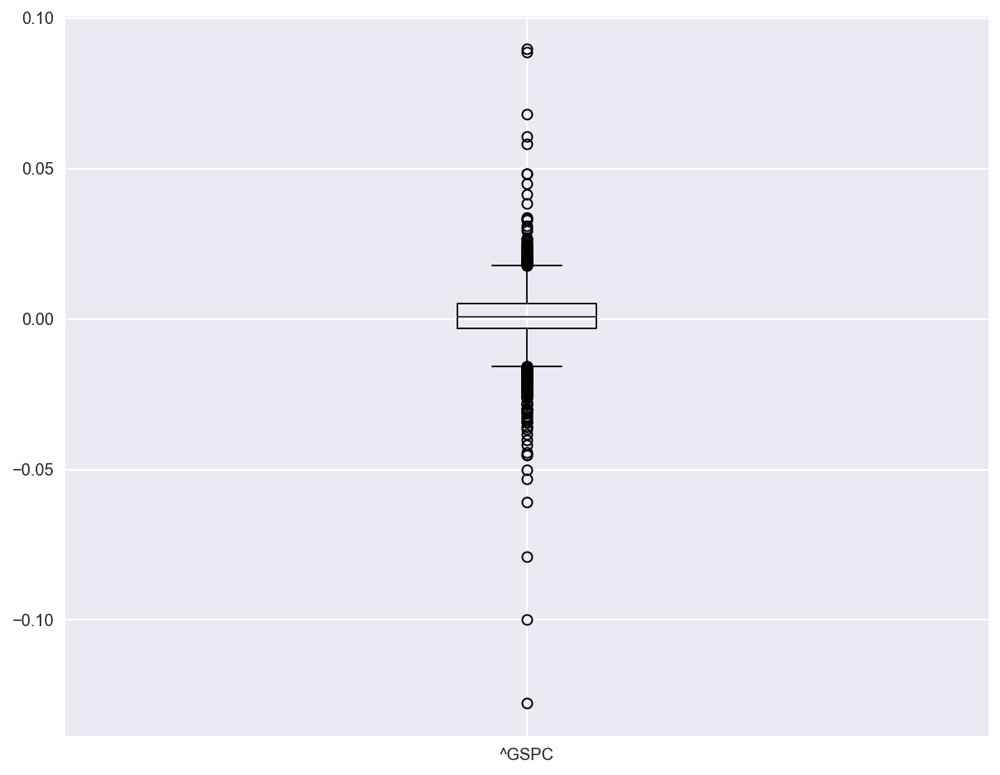

In [78]:
for col in merged_yield.columns:
    plt.figure(figsize=(10, 8))
    merged_yield[col].to_frame().boxplot()


    plt.show()



# Andamento Media - Standard Deviation

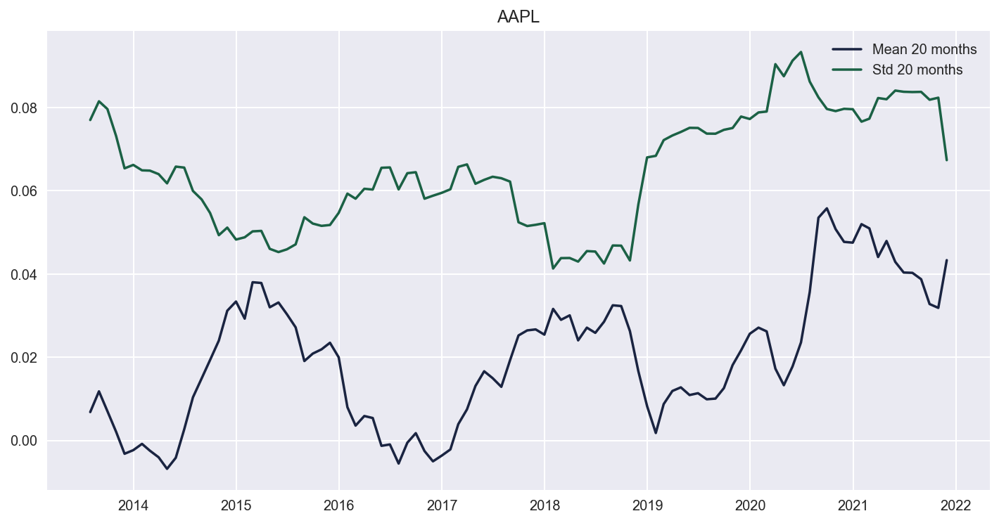

Correlation:  0.09770292654368085


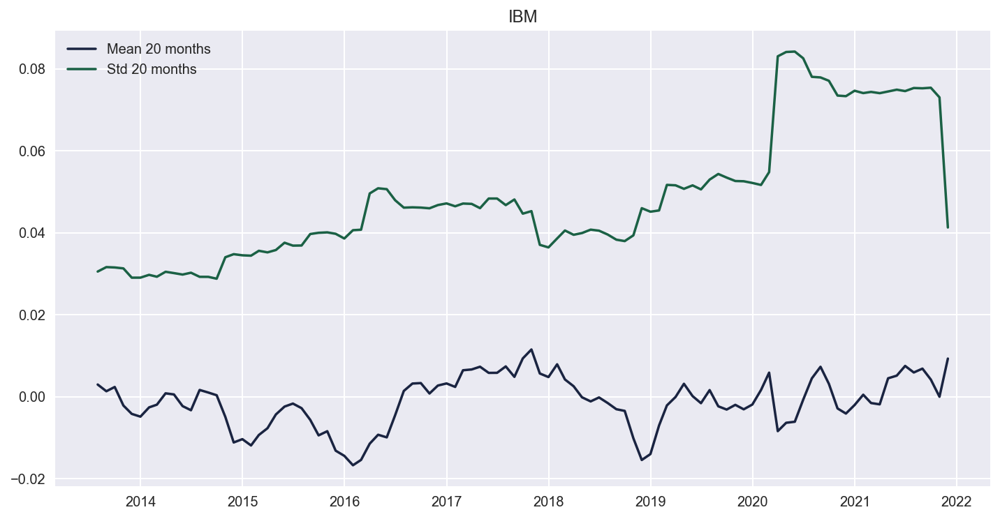

Correlation:  0.18428996651917548


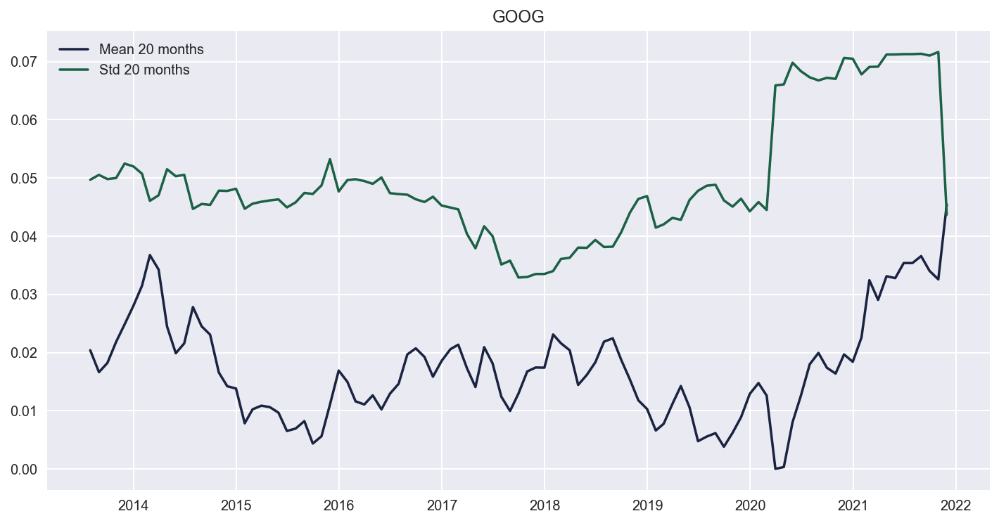

Correlation:  0.3010993319370322


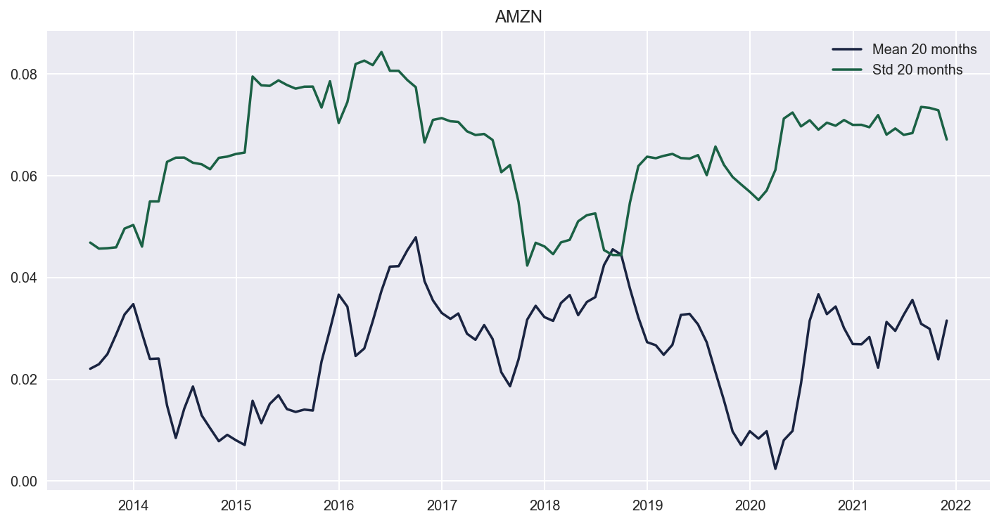

Correlation:  -0.08607110089243453


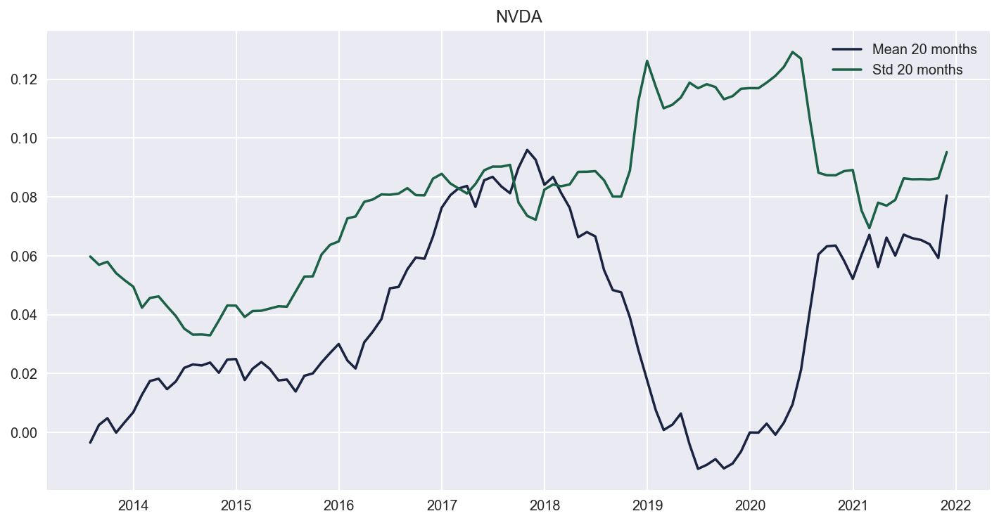

Correlation:  -0.01613481215225012


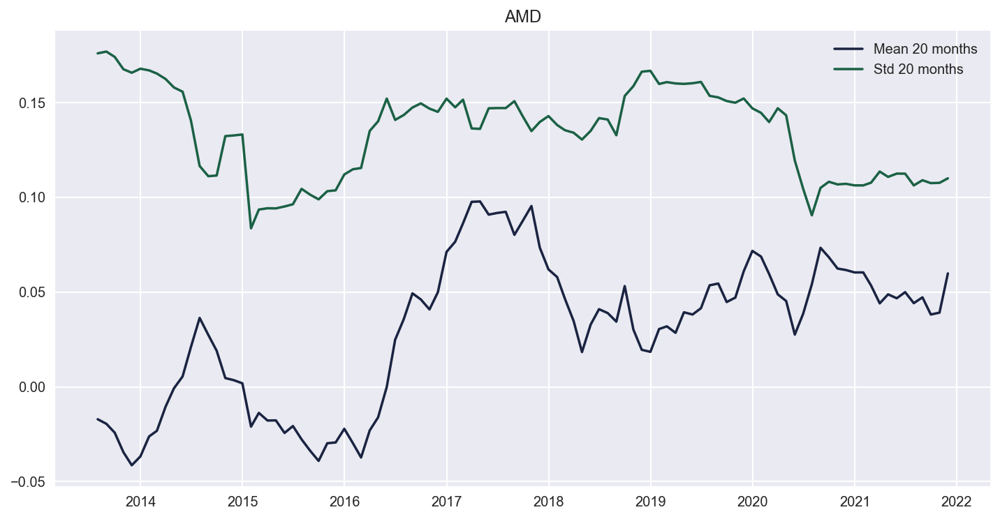

Correlation:  0.07946781514979842


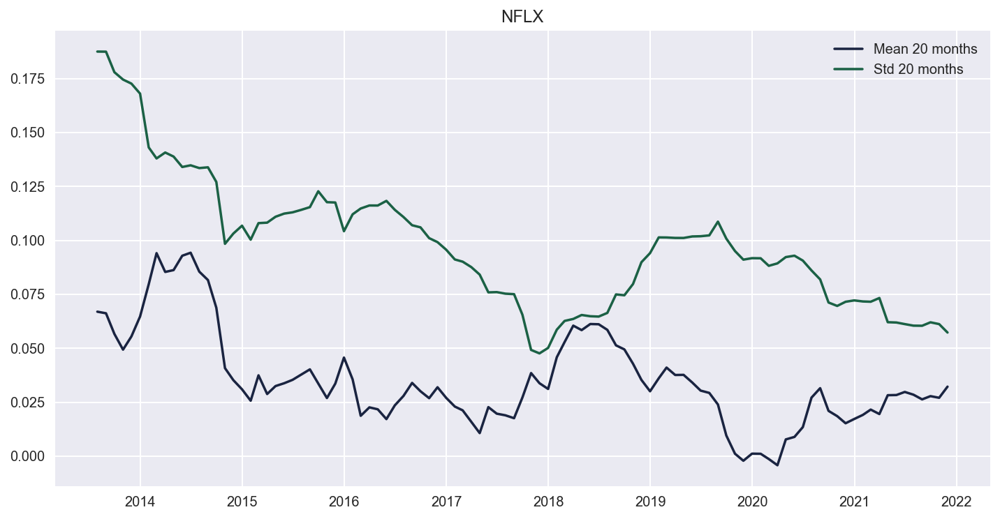

Correlation:  0.46012627480569773


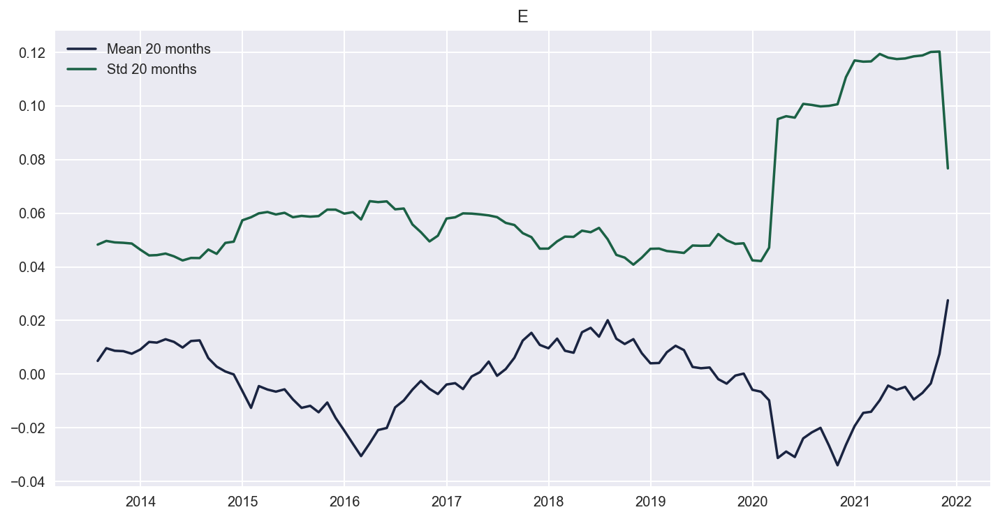

Correlation:  -0.536924075273172


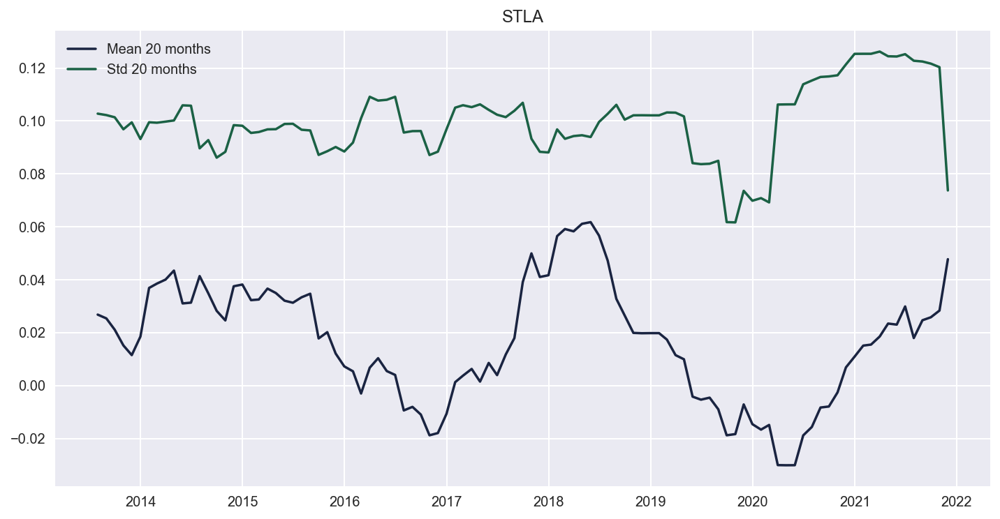

Correlation:  0.09291572503230588


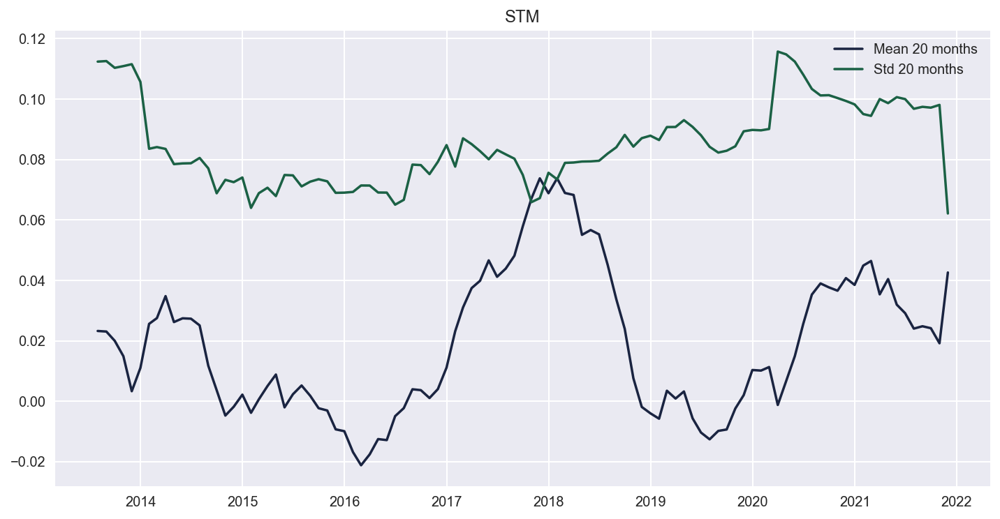

Correlation:  0.11965136698278758


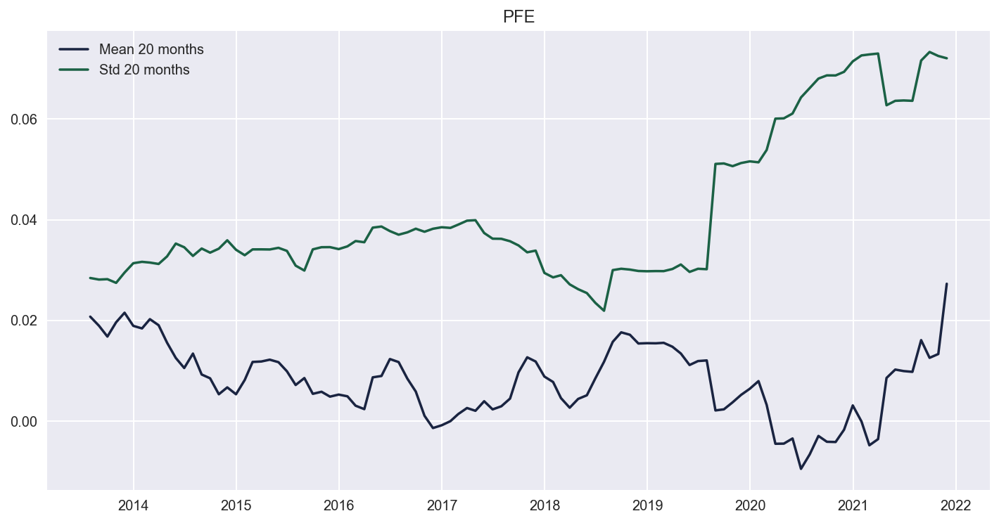

Correlation:  -0.4465461134881935


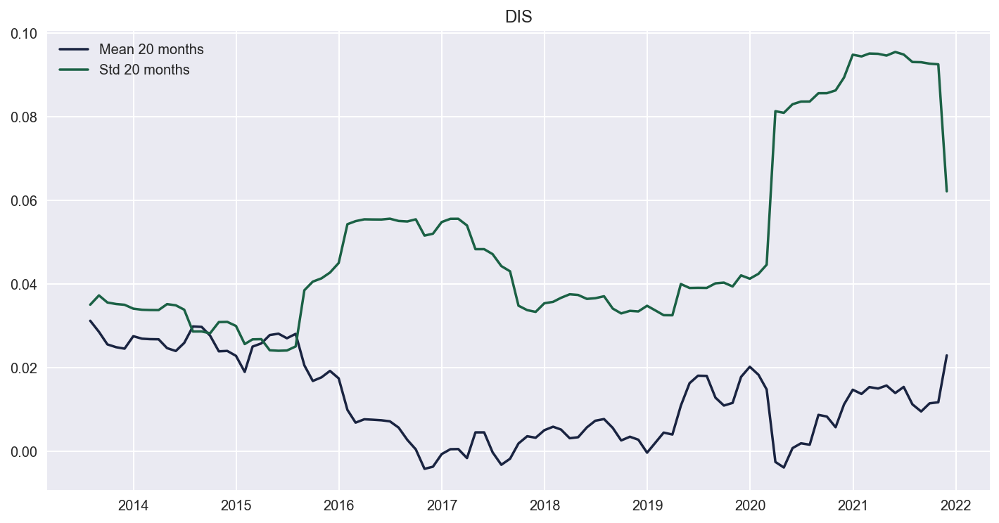

Correlation:  -0.3209074754990512


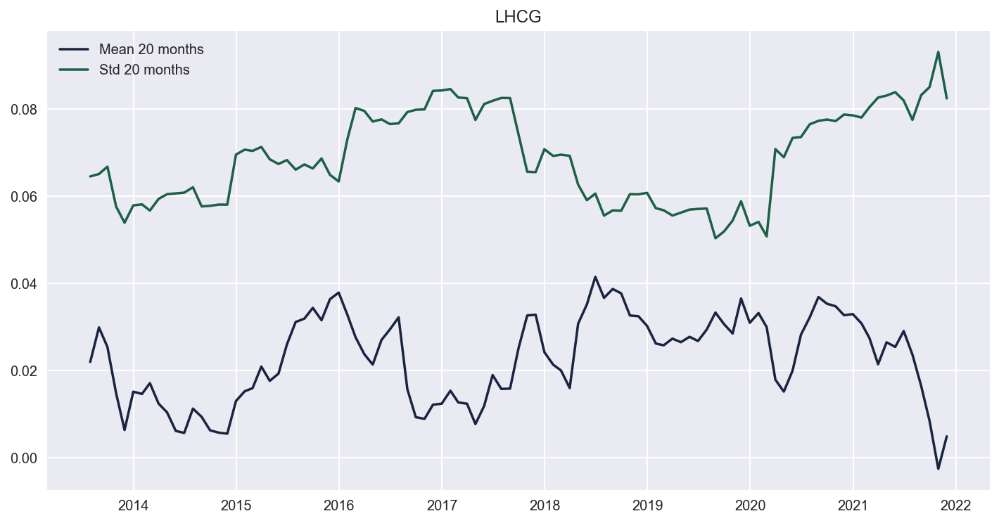

Correlation:  -0.24389090454753606


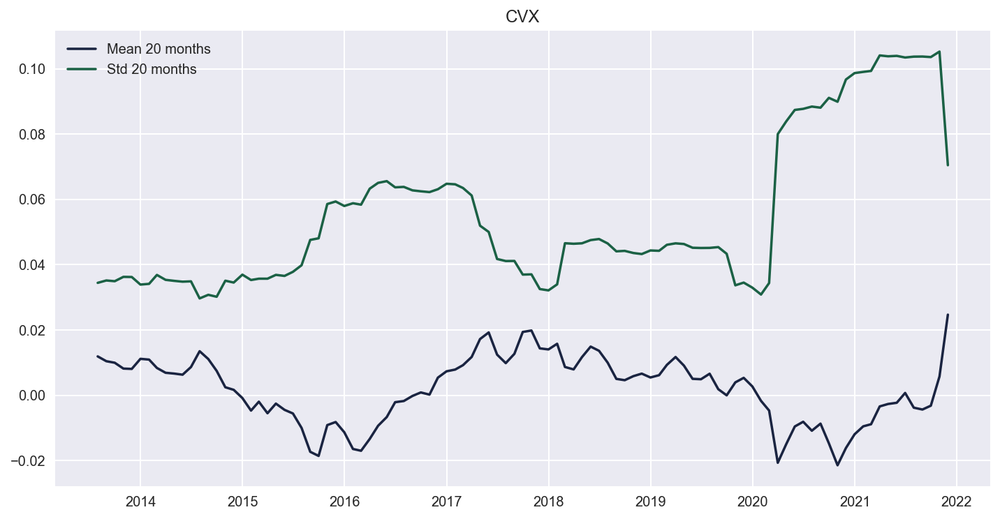

Correlation:  -0.5027468319551016


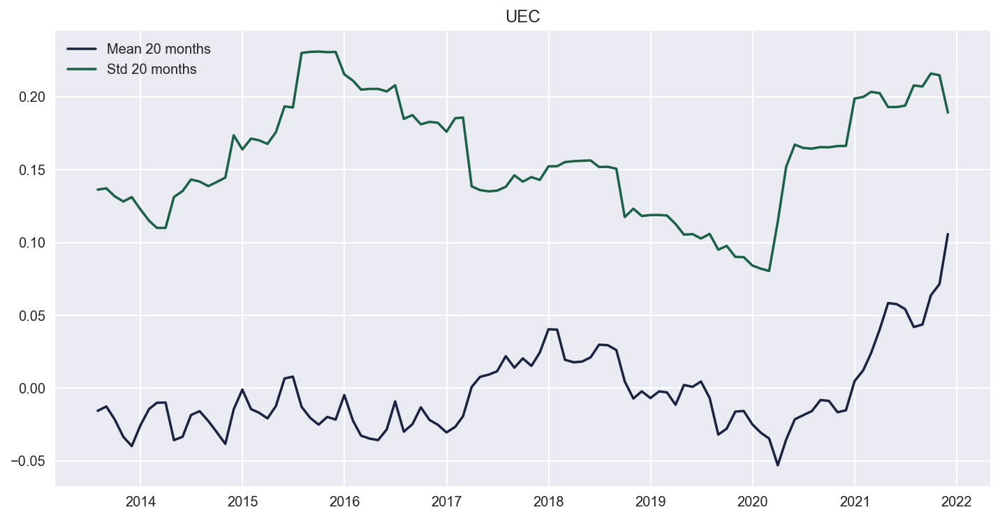

Correlation:  0.23479087969739706


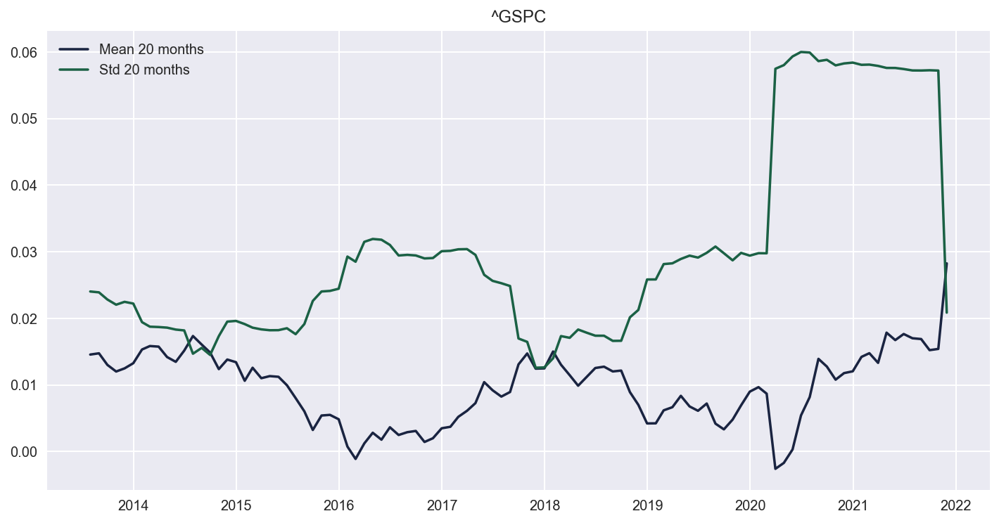

Correlation:  -0.05460206846162419


In [198]:
for col in merged_yield_m.columns:
    plt.figure(figsize=(12, 6))
    plt.plot( merged_yield_m[col].rolling(20).mean(), label="Mean 20 months")
    plt.plot(merged_yield_m[col].rolling(20).std(), label="Std 20 months")
    
    plt.legend(loc="best")
    plt.title(f"{col}")
    plt.show()
    print("Correlation: ", merged_yield_m[col].rolling(20).mean().corr(merged_yield_m[col].rolling(20).std()))

# CAPM: Capital Asset Pricing Model

### Calcolo del Beta VS Indice di Mercato S&P 500

Download DATA

In [31]:
start_date = '2011-11-30'
end_date = '2021-11-30'

df = web.get_data_yahoo(tickers_and_market, start=start_date, end=end_date)

Definng some utilities

In [32]:
# df.columns # this is a MultiIndex

# last() --> get last month (or other frequency) day

def get_data(tickers_list, start_date='2011-11-30', end_date='2021-11-30'):
    df = web.get_data_yahoo(tickers_list, start=start_date, end=end_date)
    return df

def get_adj_close(tickers_list, start_date='2011-11-30', end_date='2021-11-30', f='M'):
    df = web.get_data_yahoo(tickers_list, start=start_date, end=end_date)
    X = df["Adj Close"].resample(f).last() #pct_change().dropna()
    return X
    

def get_adj_close_yelds(tickers_list, start_date='2011-11-30', end_date='2021-11-30', f='M'):
    df = web.get_data_yahoo(tickers_list, start=start_date, end=end_date)
    X = df["Adj Close"].resample(f).last().pct_change().dropna()
    return X

Computing monthly percentual change

In [36]:
X = df["Adj Close"].resample('M').last().pct_change().dropna()

print(X.shape)
X.head()

(120, 16)


Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC
Date,,,,,,,,,,,,,,,,
2011-12-31,0.059654,-0.021915,0.077596,-0.099797,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818,0.003279,0.008533
2012-01-31,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827,0.176471,0.043583
2012-02-29,0.188311,0.025421,0.065746,-0.075859,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002360,0.079434,0.150000,0.066296,0.041667,0.040589
2012-03-31,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017504,0.040000,0.031332
2012-04-30,-0.025970,-0.007525,-0.056749,0.145129,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011038,-0.015304,-0.044253,-0.006063,-0.243590,-0.007497


# Computing variance / covariance Matrix

In [37]:
# cov(X,Y) = 1/n sum{(Xi - Xm)(Yi-Ym)}

df_cov = X.cov() # [i, i] = varianza dell'asset i
df_cov

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC
Symbols,,,,,,,,,,,,,,,,
AAPL,0.006403,0.001529,0.001708,0.002617,0.004219,0.004227,0.001136,0.001256,0.001899,0.002398,0.000978,0.001588,0.001206,0.001008,0.003752,0.001752
IBM,0.001529,0.003678,0.001255,0.002022,0.002020,0.004264,0.001690,0.001574,0.002768,0.002025,0.001065,0.001508,0.001390,0.001984,0.003777,0.001499
GOOG,0.001708,0.001255,0.003979,0.002478,0.002135,0.002317,0.001389,0.000923,0.002106,0.001808,0.000961,0.001687,0.000006,0.001526,0.001860,0.001441
AMZN,0.002617,0.002022,0.002478,0.006564,0.003295,0.005238,0.004345,0.001054,0.002279,0.001909,0.001624,0.001453,0.001556,0.001082,0.004536,0.001730
NVDA,0.004219,0.002020,0.002135,0.003295,0.011947,0.008118,0.003749,0.001591,0.003031,0.004137,0.000891,0.000533,0.001348,0.001607,0.003302,0.001904
AMD,0.004227,0.004264,0.002317,0.005238,0.008118,0.026002,0.004087,0.002029,0.005957,0.005880,0.003571,0.002480,0.003690,0.003444,0.004923,0.003023
NFLX,0.001136,0.001690,0.001389,0.004345,0.003749,0.004087,0.023245,0.002960,0.006098,0.005627,0.000152,0.001501,0.001116,0.000640,0.005662,0.001546
E,0.001256,0.001574,0.000923,0.001054,0.001591,0.002029,0.002960,0.005696,0.003439,0.002550,0.000584,0.002185,-0.000457,0.003316,0.004297,0.001430
STLA,0.001899,0.002768,0.002106,0.002279,0.003031,0.005957,0.006098,0.003439,0.014304,0.006160,0.000939,0.003159,0.000829,0.003030,0.004863,0.002369


# Covarianze rispetto a Standar and Poor 500

In [38]:
# calcolo covarianze rispetto al mercato:

# cov(X,GSPC) = 1/n sum{(Xi - Xm)(GSPCi-GSPCm)}

cov_vs_SP500 = df_cov['^GSPC'][:-1]

print(type(cov_vs_SP500))
cov_vs_SP500

<class 'pandas.core.series.Series'>


Symbols
AAPL    0.001752
IBM     0.001499
GOOG    0.001441
AMZN    0.001730
NVDA    0.001904
AMD     0.003023
NFLX    0.001546
E       0.001430
STLA    0.002369
STM     0.001859
PFE     0.001070
DIS     0.001683
LHCG    0.000767
CVX     0.001771
UEC     0.003107
Name: ^GSPC, dtype: float64

In [39]:
# var(GSPC) = 1/n sum{(GSPCi - GSPCm)^2}

asset_var = X['^GSPC'].var()
asset_var

0.0014154534392805914

# Calcolo del Beta di ciascun titolo

### Beta = covanrianza dei titoli col mercato / varianza del mercato
### Beta = sum{(Xi - Xm)(GSPCi-GSPCm)} / sum{(GSPCi - GSPCm)^2}
### Beta > 1 --> titolo più volatile del mercato 

In [138]:

beta = cov_vs_SP500 / asset_var
beta.sort_values()

Symbols
LHCG    0.541876
PFE     0.755966
E       1.010374
GOOG    1.018338
IBM     1.058843
NFLX    1.091949
DIS     1.188878
AMZN    1.222136
AAPL    1.237910
CVX     1.251142
STM     1.313430
NVDA    1.345385
STLA    1.673814
AMD     2.135702
UEC     2.195078
Name: ^GSPC, dtype: float64

In [241]:
beta.index

Index(['AAPL', 'IBM', 'GOOG', 'AMZN', 'NVDA', 'AMD', 'NFLX', 'E', 'STLA',
       'STM', 'PFE', 'DIS', 'LHCG', 'CVX', 'UEC'],
      dtype='object', name='Symbols')

## CAPM - One Factor: Calcolo dell'esposizione al mercato

In [41]:
def capm_one_factor(df_yelds, market):
    df = df_yelds.copy()
    X = df.pop(market)
    X = sm.add_constant(X)
    for asset in df.columns:
        y = df.pop(asset)
        capm_model = sm.OLS(y, X).fit()
        print(asset)
        print(capm_model.summary())
        print("*"*100)

In [42]:
capm_one_factor(X, '^GSPC')

AAPL
                            OLS Regression Results                            
Dep. Variable:                   AAPL   R-squared:                       0.339
Model:                            OLS   Adj. R-squared:                  0.333
Method:                 Least Squares   F-statistic:                     60.46
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           3.12e-12
Time:                        20:12:32   Log-Likelihood:                 158.11
No. Observations:                 120   AIC:                            -312.2
Df Residuals:                     118   BIC:                            -306.6
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0111      0.006      1.782    

DIS
                            OLS Regression Results                            
Dep. Variable:                    DIS   R-squared:                       0.436
Model:                            OLS   Adj. R-squared:                  0.431
Method:                 Least Squares   F-statistic:                     91.31
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           2.27e-16
Time:                        20:12:32   Log-Likelihood:                 187.70
No. Observations:                 120   AIC:                            -371.4
Df Residuals:                     118   BIC:                            -365.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0012      0.005      0.252     

# Integriamo il parametro Risk-Free nell'analisi

### La funzione get_adj_close scarica i dati e applica il resample a frequenza mensile

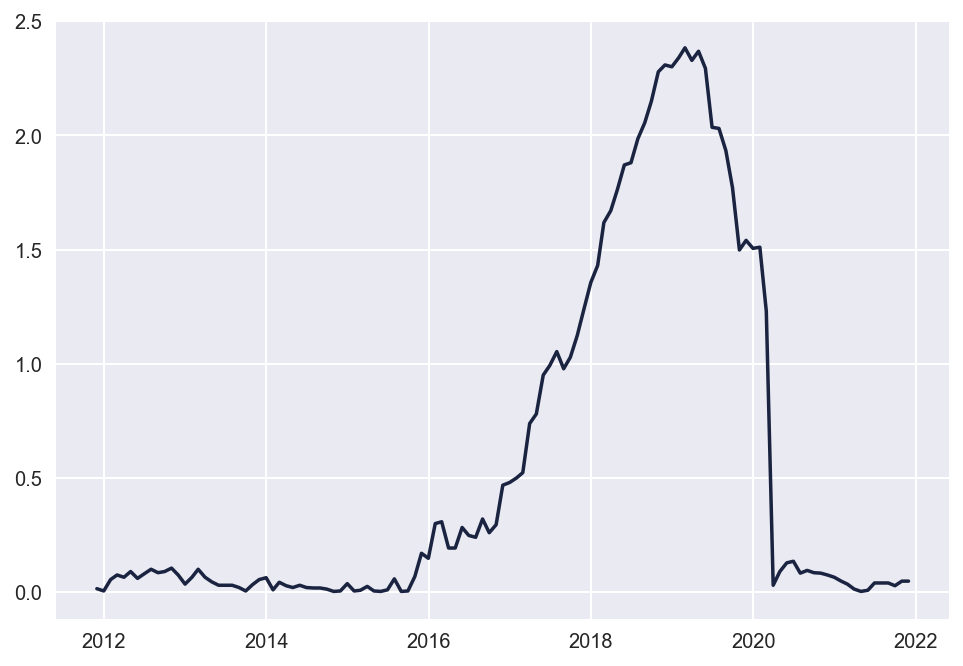

In [242]:
risk_free = '^IRX'

df = get_adj_close(tickers_and_market + [risk_free])  #

plt.plot(df[risk_free])

In [147]:
df.columns

Index(['AAPL', 'IBM', 'GOOG', 'AMZN', 'NVDA', 'AMD', 'NFLX', 'E', 'STLA',
       'STM', 'PFE', 'DIS', 'LHCG', 'CVX', 'UEC', '^GSPC', '^IRX'],
      dtype='object', name='Symbols')

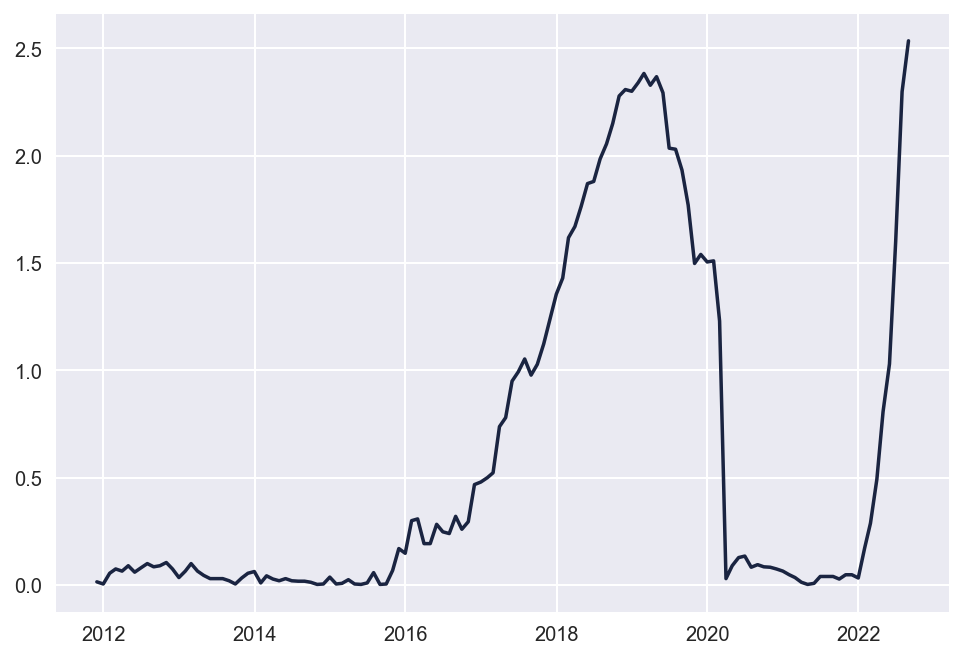

In [148]:
rf = get_adj_close([risk_free], '2011-11-30', '2022-08-10' )

plt.plot(rf[risk_free])

In [149]:
df.head()


Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC,^IRX
Date,,,,,,,,,,,,,,,,,
2011-11-30,11.654806,121.042175,14.928793,9.6145,3.588101,5.69,9.218571,23.279152,2.008028,4.641494,12.921903,31.567959,13.900000,66.285370,3.05,1246.959961,0.015
2011-12-31,12.350069,118.389542,16.087200,8.6550,3.181770,5.40,9.898571,22.632050,2.012491,4.348192,13.932729,33.575390,12.830000,68.593307,3.06,1257.599976,0.005
2012-01-31,13.919898,124.003830,14.448593,9.7220,3.390674,6.71,17.171429,24.403349,2.588125,4.898132,13.778200,34.828876,14.800000,66.478783,3.60,1312.410034,0.055
2012-02-29,16.541161,127.156136,15.398533,8.9845,3.477909,7.35,15.818571,25.335617,2.610437,5.521346,13.745682,37.595486,17.020000,70.886024,3.75,1365.680054,0.075
2012-03-31,18.282679,134.860580,15.971136,10.1255,3.535300,8.02,16.434286,25.675611,2.672909,6.094314,14.734487,39.198143,18.530001,69.645248,3.90,1408.469971,0.065


### Calcolo dei rendimenti mensili risk-free: 

#### I tassi sono stati scaricati come rendimento annuo.
#### Conversione del tasso a tre mesi rilevato mensilmente in termini di tasso annuo 

In [249]:
# calcolo tassi mensili

df['mrf'] = (1+ df[risk_free])**1/12 - 1

df.drop(columns=risk_free, inplace=True)

df['mrf'].head()

Date
2011-11-30   -0.915417
2011-12-31   -0.916250
2012-01-31   -0.912083
2012-02-29   -0.910417
2012-03-31   -0.911250
Freq: M, Name: mrf, dtype: float64

In [151]:
df.head()

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC,mrf
Date,,,,,,,,,,,,,,,,,
2011-11-30,11.654806,121.042175,14.928793,9.6145,3.588101,5.69,9.218571,23.279152,2.008028,4.641494,12.921903,31.567959,13.900000,66.285370,3.05,1246.959961,-0.915417
2011-12-31,12.350069,118.389542,16.087200,8.6550,3.181770,5.40,9.898571,22.632050,2.012491,4.348192,13.932729,33.575390,12.830000,68.593307,3.06,1257.599976,-0.916250
2012-01-31,13.919898,124.003830,14.448593,9.7220,3.390674,6.71,17.171429,24.403349,2.588125,4.898132,13.778200,34.828876,14.800000,66.478783,3.60,1312.410034,-0.912083
2012-02-29,16.541161,127.156136,15.398533,8.9845,3.477909,7.35,15.818571,25.335617,2.610437,5.521346,13.745682,37.595486,17.020000,70.886024,3.75,1365.680054,-0.910417
2012-03-31,18.282679,134.860580,15.971136,10.1255,3.535300,8.02,16.434286,25.675611,2.672909,6.094314,14.734487,39.198143,18.530001,69.645248,3.90,1408.469971,-0.911250


### Calcolo rendimennto dei titoli al netto del risk-free

In [250]:
yelds_rf = df.copy()

for asset in yelds_rf.columns:
    if asset != 'mrf':
        yelds_rf[asset] = yelds_rf[asset].pct_change() - yelds_rf['mrf']
        yelds_rf.dropna(inplace=True)
        

In [251]:
yelds_rf

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC,mrf
Date,,,,,,,,,,,,,,,,,
2013-03-31,0.914105,0.973342,0.902501,0.919651,0.924678,0.935346,0.917630,0.897410,0.915038,0.881061,0.965689,0.951734,0.969321,0.925505,0.863631,0.947238,-0.911250
2013-04-30,0.913187,0.862472,0.951170,0.865335,0.986183,1.018799,1.054453,0.977965,1.111030,1.038727,0.920193,1.019255,0.923149,0.939764,0.617462,0.931002,-0.912917
2013-05-31,0.936586,0.946037,0.970742,0.974803,0.970340,1.332606,0.961281,0.889630,1.166135,0.985595,0.858680,0.917986,0.926598,0.928345,1.294812,0.934929,-0.914167
2013-06-30,0.795873,0.832877,0.924669,0.945705,0.884450,0.934167,0.847161,0.819927,0.844984,0.891562,0.942812,0.915276,0.804571,0.878240,0.750615,0.899167,-0.914167
2013-07-31,1.055392,0.934730,0.922550,0.998901,0.942656,0.838186,1.072346,0.989946,1.002005,0.862999,0.966232,0.937920,1.085770,0.977966,1.204669,0.963629,-0.914167
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-07-31,0.978316,0.874927,0.992373,0.880611,0.888162,1.043856,0.893190,0.876843,0.885936,1.047748,1.016442,0.914756,0.987836,0.885359,0.729123,0.936081,-0.913333
2021-08-31,0.955823,0.920397,0.989069,0.956368,1.061543,0.955993,1.013069,0.959291,0.957673,0.989902,0.989484,0.943330,0.781258,0.876644,1.070015,0.942324,-0.913333
2021-09-30,0.846297,0.904286,0.830487,0.860815,0.839774,0.843705,0.986629,1.047805,0.868379,0.897614,0.847913,0.847428,0.754503,0.962695,1.129473,0.866764,-0.914333


# Calcolo manuale dei Rendimenti Attesi secondo CAPM

In [253]:
rendimenti_attesi = pd.DataFrame()

for i in beta.index:
    rendimenti_attesi[i] = beta[i]*yelds_rf["^GSPC"] + yelds_rf['mrf']

    
rendimenti_attesi

,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC
Date,,,,,,,,,,,,,,,
2013-03-31,0.261345,0.091726,0.053359,0.246404,0.363149,1.111767,0.123085,0.045814,0.674250,0.332881,-0.195170,0.214900,-0.397965,0.273879,1.168011
2013-04-30,0.239581,0.072869,0.035159,0.224895,0.339640,1.075427,0.103690,0.027744,0.645408,0.309890,-0.209110,0.193931,-0.408429,0.251900,1.130707
2013-05-31,0.243192,0.075777,0.037908,0.228445,0.343673,1.082564,0.106728,0.030462,0.650732,0.313798,-0.207392,0.197350,-0.407551,0.255563,1.138077
2013-06-30,0.198922,0.037910,0.001490,0.184738,0.295559,1.006187,0.067678,-0.005671,0.590872,0.266827,-0.234427,0.154833,-0.426929,0.210820,1.059576
2013-07-31,0.278719,0.106165,0.067134,0.263519,0.382285,1.143857,0.138067,0.059459,0.698769,0.351493,-0.185696,0.231470,-0.391999,0.291470,1.201074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-07-31,0.245452,0.077830,0.039914,0.230686,0.346056,1.085857,0.108820,0.032459,0.653493,0.316144,-0.205687,0.199553,-0.406093,0.257838,1.141439
2021-08-31,0.253179,0.084439,0.046271,0.238315,0.354455,1.099189,0.115636,0.038766,0.663942,0.324343,-0.200968,0.206974,-0.402711,0.265648,1.155141
2021-09-30,0.158643,0.003434,-0.031674,0.144971,0.251798,0.936816,0.032129,-0.038577,0.536469,0.224101,-0.259089,0.116143,-0.444655,0.170112,0.988282


In [244]:
yelds_rf[["^GSPC"]]

Symbols,^GSPC
Date,
2013-03-31,0.947238
2013-04-30,0.931002
2013-05-31,0.934929
2013-06-30,0.899167
2013-07-31,0.963629
...,...
2021-07-31,0.936081
2021-08-31,0.942324
2021-09-30,0.866764


In [248]:
yelds_rf.head()

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,UEC,^GSPC
Date,,,,,,,,,,,,,,,,
2013-03-31,0.914104,0.973342,0.902501,0.919651,0.924678,0.935346,0.917630,0.897410,0.915038,0.881061,0.965689,0.951734,0.969321,0.925505,0.863631,0.947238
2013-04-30,0.913188,0.862472,0.951170,0.865335,0.986183,1.018799,1.054453,0.977965,1.111030,1.038727,0.920193,1.019255,0.923149,0.939764,0.617462,0.931002
2013-05-31,0.936586,0.946037,0.970742,0.974803,0.970340,1.332606,0.961281,0.889630,1.166135,0.985595,0.858680,0.917986,0.926598,0.928345,1.294812,0.934929
2013-06-30,0.795873,0.832876,0.924669,0.945705,0.884450,0.934167,0.847161,0.819927,0.844984,0.891562,0.942812,0.915276,0.804571,0.878240,0.750615,0.899167
2013-07-31,1.055392,0.934731,0.922550,0.998901,0.942657,0.838186,1.072346,0.989946,1.002005,0.862998,0.966233,0.937920,1.085770,0.977966,1.204669,0.963629


### Calcolo del modello CAPM al netto del Risk Free

In [154]:
yelds_rf.drop(columns='mrf', inplace=True)
capm_one_factor(yelds_rf, '^GSPC')

# R-squared:

# è un indice che misura il legame tra la variabilità dei dati e la correttezza del modello statistico utilizzato
# è legato alla frazione della varianza non spiegata dal modello

# R^2 = 1 - RSS/TSS

# RSS = sum{(Yi - Yi_stimato)^2} --> devianza delle previsioni del modello 
# TSS = sum{(Yi - Ym)^2} --> devianzia del campione

AAPL
                            OLS Regression Results                            
Dep. Variable:                   AAPL   R-squared:                       0.653
Model:                            OLS   Adj. R-squared:                  0.650
Method:                 Least Squares   F-statistic:                     194.1
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           1.95e-25
Time:                        21:08:31   Log-Likelihood:                 142.97
No. Observations:                 105   AIC:                            -281.9
Df Residuals:                     103   BIC:                            -276.6
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0362      0.067     -0.543    

## Fama - French's Model: 3 Factors

#### componenti del rishio di mercato possono essere enucleati come fattori per meglio spiegare l'andamento delle azioni:
#### - fattore mercato (MKT)
        - andamento del mercato azionario
#### - fattore dimensione (SMB)
        - Rendimento in eccesso delle azioni a piccola capitalizzazione rispetto alle grandi
        - Le azioni minori generano più rendimento perché sono più rischiose
#### - fattore valore (HML)
        - rendimento in eccesso delle azioni con un alto rapporto fra patrimonio/prezzo (Value Stock) 
          rispetto alle azioni con rapporto basso (Growth Stock)

In [155]:
risky_asset = 'X' #azione da analizzare con i fattori di rischio
start_date = '2011-11-30'
end_date = '2021-11-30'


factor_df = pd.read_csv('F-F_Research_Data_Factors.csv', skiprows=3)

stringa = ' Annual Factors: January-December '
indices = factor_df.iloc[:,0] == stringa
start_of_annual = factor_df[indices].index[0]
factor_df = factor_df[factor_df.index < start_of_annual]

factor_df.columns = ['data', 'mkt', 'smb', 'hml', 'rf']

factor_df['data'] = pd.to_datetime(factor_df['data'], format='%Y%m').dt.strftime("%Y-%m")


factor_df = factor_df.set_index('data')
factor_df = factor_df[start_date:end_date]

factor_df = factor_df.apply(pd.to_numeric, errors='coerce').div(100)

factor_df.head()



,mkt,smb,hml,rf
data,,,,
2011-12,0.0074,-0.0060,0.0161,0.0
2012-01,0.0505,0.0206,-0.0094,0.0
2012-02,0.0442,-0.0186,0.0043,0.0
2012-03,0.0311,-0.0066,0.0112,0.0
2012-04,-0.0085,-0.0041,-0.0077,0.0


In [156]:
df_assets = get_adj_close_yelds(tickers[:-1])

df_assets.head()

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX
Date,,,,,,,,,,,,,,
2011-12-31,0.059655,-0.021914,0.077596,-0.099797,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818
2012-01-31,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827
2012-02-29,0.188310,0.025421,0.065746,-0.075859,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295
2012-03-31,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503
2012-04-30,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063


In [157]:
# set factor_df's index format for asset df:

df_assets.index = df_assets.index.strftime('%Y-%m')

df_assets.head()

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX
Date,,,,,,,,,,,,,,
2011-12,0.059655,-0.021914,0.077596,-0.099797,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818
2012-01,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827
2012-02,0.188310,0.025421,0.065746,-0.075859,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295
2012-03,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503
2012-04,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063


In [158]:
ff_data = factor_df.join(df_assets)

ff_data.head()

,mkt,smb,hml,rf,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX
data,,,,,,,,,,,,,,,,,,
2011-12,0.0074,-0.0060,0.0161,0.0,0.059655,-0.021914,0.077596,-0.099797,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818
2012-01,0.0505,0.0206,-0.0094,0.0,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827
2012-02,0.0442,-0.0186,0.0043,0.0,0.188310,0.025421,0.065746,-0.075859,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295
2012-03,0.0311,-0.0066,0.0112,0.0,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503
2012-04,-0.0085,-0.0041,-0.0077,0.0,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063


In [159]:
for asset in tickers[:-1]:
    excess_col = asset + '_excess'
    ff_data[excess_col] = ff_data[asset] - ff_data['rf']

ff_data.head()

,mkt,smb,hml,rf,AAPL,IBM,GOOG,AMZN,NVDA,AMD,...,NVDA_excess,AMD_excess,NFLX_excess,E_excess,STLA_excess,STM_excess,PFE_excess,DIS_excess,LHCG_excess,CVX_excess
data,,,,,,,,,,,,,,,,,,,,,
2011-12,0.0074,-0.0060,0.0161,0.0,0.059655,-0.021914,0.077596,-0.099797,-0.113244,-0.050967,...,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818
2012-01,0.0505,0.0206,-0.0094,0.0,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,...,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827
2012-02,0.0442,-0.0186,0.0043,0.0,0.188310,0.025421,0.065746,-0.075859,0.025728,0.095380,...,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295
2012-03,0.0311,-0.0066,0.0112,0.0,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,...,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503
2012-04,-0.0085,-0.0041,-0.0077,0.0,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,-0.082294,...,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063


# Calcolo della regression con i nuovi 2 coefficienti

### mkt = Beta
### smb: se negativo, indica che il titolo è ad alta capitalizzazione (esposto negativamente al fattore small cap)
### hml: se negativo, indica che il titolo è caro (esposto negativamente al fattore value)

In [160]:

for asset in tickers[:-1]:
    excess_col = asset + '_excess'
    print(excess_col)
    ff_model = smf.ols(formula = f'{excess_col} ~ mkt + smb + hml', data = ff_data).fit()
    print(ff_model.summary())
    print('*'*100)
    print()
    print()

AAPL_excess
                            OLS Regression Results                            
Dep. Variable:            AAPL_excess   R-squared:                       0.428
Model:                            OLS   Adj. R-squared:                  0.413
Method:                 Least Squares   F-statistic:                     28.93
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           4.86e-14
Time:                        21:08:44   Log-Likelihood:                 166.77
No. Observations:                 120   AIC:                            -325.5
Df Residuals:                     116   BIC:                            -314.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0063      0.006      1.

[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
****************************************************************************************************


DIS_excess
                            OLS Regression Results                            
Dep. Variable:             DIS_excess   R-squared:                       0.457
Model:                            OLS   Adj. R-squared:                  0.443
Method:                 Least Squares   F-statistic:                     32.48
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           2.57e-15
Time:                        21:08:44   Log-Likelihood:                 189.77
No. Observations:                 120   AIC:                            -371.5
Df Residuals:                     116   BIC:                            -360.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
    

#### Modello Fama French a tre fattori rolling su un portafoglio

In [161]:
portfolio_df = df_assets.copy()

x = np.arange(len(tickers[:-1]), dtype=float)
weights = np.full_like(x, 1/len(tickers[:-1]))

portfolio_df['portfolio_returns'] = np.matmul(portfolio_df[tickers[:-1]].values, weights)


portfolio_df.head()

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX,portfolio_returns
Date,,,,,,,,,,,,,,,
2011-12,0.059655,-0.021914,0.077596,-0.099797,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818,-0.004573
2012-01,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827,0.134191
2012-02,0.188310,0.025421,0.065746,-0.075859,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295,0.050955
2012-03,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503,0.057396
2012-04,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063,-0.073737


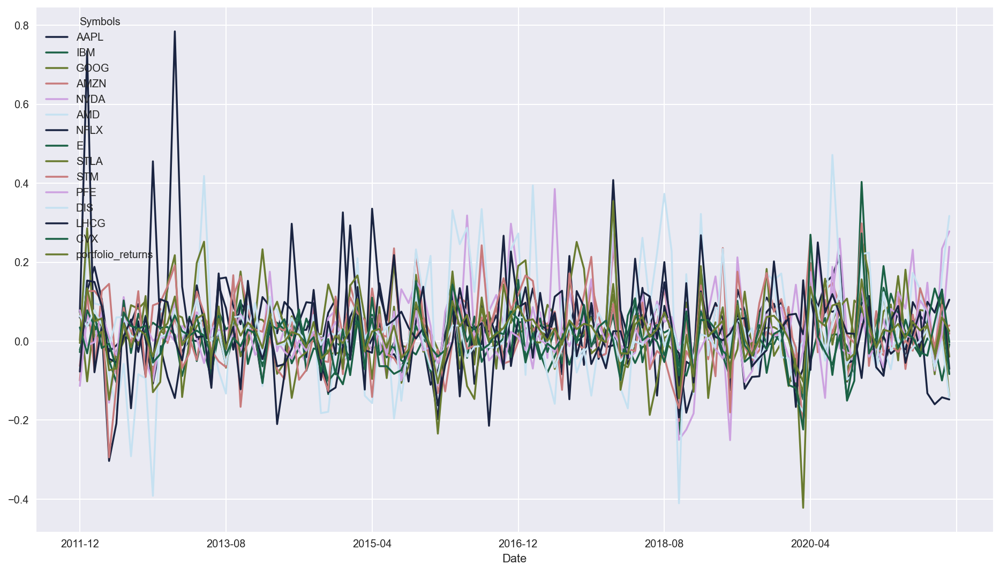

In [162]:
portfolio_df.plot(figsize=(16,9), grid = True);

In [163]:
portfolio_df.shape

(120, 15)

In [164]:
ff_portfolio = factor_df.join(portfolio_df[['portfolio_returns']])

ff_portfolio.head()

,mkt,smb,hml,rf,portfolio_returns
data,,,,,
2011-12,0.0074,-0.0060,0.0161,0.0,-0.004573
2012-01,0.0505,0.0206,-0.0094,0.0,0.134191
2012-02,0.0442,-0.0186,0.0043,0.0,0.050955
2012-03,0.0311,-0.0066,0.0112,0.0,0.057396
2012-04,-0.0085,-0.0041,-0.0077,0.0,-0.073737


In [165]:
ff_portfolio['portf_ex_rtn'] = ff_portfolio.portfolio_returns - ff_portfolio.rf

ff_portfolio.head()

,mkt,smb,hml,rf,portfolio_returns,portf_ex_rtn
data,,,,,,
2011-12,0.0074,-0.0060,0.0161,0.0,-0.004573,-0.004573
2012-01,0.0505,0.0206,-0.0094,0.0,0.134191,0.134191
2012-02,0.0442,-0.0186,0.0043,0.0,0.050955,0.050955
2012-03,0.0311,-0.0066,0.0112,0.0,0.057396,0.057396
2012-04,-0.0085,-0.0041,-0.0077,0.0,-0.073737,-0.073737


In [166]:
def rolling_factor_model(input_data, formula, window_size):
    coeffs = []

    for start_index in range(len(input_data) - window_size + 1):        
        end_index = start_index + window_size

        # define and fit the regression model 
        ff_model = smf.ols(
            formula=formula, 
            data=input_data[start_index:end_index]).fit()
   
        # store coefficients
        coeffs.append(ff_model.params)
    
    coeffs_df = pd.DataFrame(
        coeffs, 
        index=input_data.index[window_size - 1:])

    return coeffs_df

In [167]:
model_formula = 'portf_ex_rtn ~ mkt + smb + hml'
results_df = rolling_factor_model(ff_portfolio, model_formula, window_size = 60)

# Rolling nel tempo della scomposizione in fattori del portafoglio

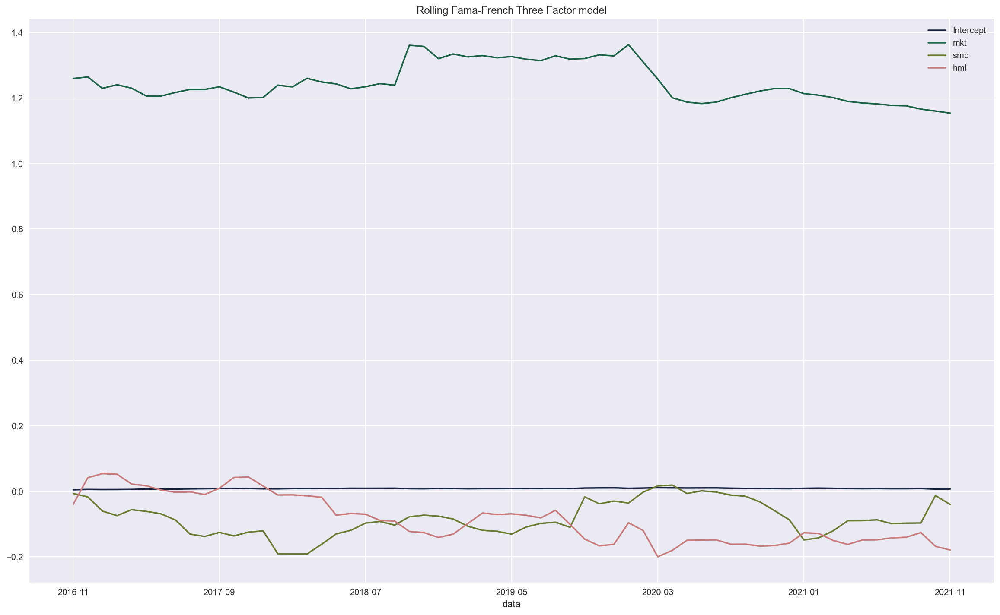

In [254]:
results_df.plot(title = 'Rolling Fama-French Three Factor model', figsize = (20, 12));

### Modelo di Carhart a quattro fattori e Fama e French a cinque fattori

##### Momentum: utilizza l'andamento passato per spiegare l'andamento presente di un titolo per mezzo dell'andamento passato

In [169]:
start_date

'2011-11-30'

In [170]:
# quattro fattori con fattore "momentum" di Carhart
df_mom = web.DataReader('F-F_Momentum_factor', 'famafrench', start = start_date)[0] / 100
df_mom.index = df_mom.index.format()

In [171]:
y = df_assets.copy()
y

Symbols,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX
Date,,,,,,,,,,,,,,
2011-12,0.059655,-0.021914,0.077596,-0.099797,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818
2012-01,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827
2012-02,0.188310,0.025421,0.065746,-0.075859,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295
2012-03,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503
2012-04,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-07,0.064983,-0.038406,0.079040,-0.032722,-0.025172,0.130523,-0.020144,-0.036490,-0.027397,0.134414,0.103109,0.001422,0.074503,-0.027974
2021-08,0.042489,0.007064,0.075735,0.043034,0.148210,0.042659,0.099735,0.045957,0.044340,0.076569,0.076150,0.029997,-0.132075,-0.036689
2021-09,-0.068037,-0.010047,-0.083847,-0.053518,-0.074559,-0.070629,0.072296,0.133471,-0.045954,-0.016720,-0.066421,-0.066906,-0.159831,0.048362


In [172]:
four_factor_data = factor_df.join(df_mom).join(y)

four_factor_data

,mkt,smb,hml,rf,Mom,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX
data,,,,,,,,,,,,,,,,,,,
2011-12,0.0074,-0.0060,0.0161,0.0,0.0181,0.059655,-0.021914,0.077596,-0.099797,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818
2012-01,0.0505,0.0206,-0.0094,0.0,-0.0791,0.127111,0.047422,-0.101858,0.123281,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827
2012-02,0.0442,-0.0186,0.0043,0.0,-0.0029,0.188310,0.025421,0.065746,-0.075859,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295
2012-03,0.0311,-0.0066,0.0112,0.0,0.0130,0.105284,0.060591,0.037186,0.126996,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503
2012-04,-0.0085,-0.0041,-0.0077,0.0,0.0375,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-07,0.0127,-0.0396,-0.0174,0.0,-0.0224,0.064983,-0.038406,0.079040,-0.032722,-0.025172,0.130523,-0.020144,-0.036490,-0.027397,0.134414,0.103109,0.001422,0.074503,-0.027974
2021-08,0.0291,-0.0046,-0.0015,0.0,0.0253,0.042489,0.007064,0.075735,0.043034,0.148210,0.042659,0.099735,0.045957,0.044340,0.076569,0.076150,0.029997,-0.132075,-0.036689
2021-09,-0.0437,0.0075,0.0506,0.0,0.0150,-0.068037,-0.010047,-0.083847,-0.053518,-0.074559,-0.070629,0.072296,0.133471,-0.045954,-0.016720,-0.066421,-0.066906,-0.159831,0.048362


In [173]:
for asset in tickers[:-1]:
    excess_col = asset + '_excess'
    four_factor_data[excess_col] = four_factor_data[asset] - four_factor_data['rf']

four_factor_data.head()

,mkt,smb,hml,rf,Mom,AAPL,IBM,GOOG,AMZN,NVDA,...,NVDA_excess,AMD_excess,NFLX_excess,E_excess,STLA_excess,STM_excess,PFE_excess,DIS_excess,LHCG_excess,CVX_excess
data,,,,,,,,,,,,,,,,,,,,,
2011-12,0.0074,-0.0060,0.0161,0.0,0.0181,0.059655,-0.021914,0.077596,-0.099797,-0.113244,...,-0.113244,-0.050967,0.073764,-0.027797,0.002222,-0.063191,0.078226,0.063591,-0.076978,0.034818
2012-01,0.0505,0.0206,-0.0094,0.0,-0.0791,0.127111,0.047422,-0.101858,0.123281,0.065657,...,0.065657,0.242593,0.734738,0.078265,0.286031,0.126476,-0.011091,0.037333,0.153546,-0.030827
2012-02,0.0442,-0.0186,0.0043,0.0,-0.0029,0.188310,0.025421,0.065746,-0.075859,0.025728,...,0.025728,0.095380,-0.078785,0.038202,0.008621,0.127234,-0.002361,0.079434,0.150000,0.066295
2012-03,0.0311,-0.0066,0.0112,0.0,0.0130,0.105284,0.060591,0.037186,0.126996,0.016502,...,0.016502,0.091157,0.038924,0.013420,0.023932,0.103774,0.071936,0.042629,0.088719,-0.017503
2012-04,-0.0085,-0.0041,-0.0077,0.0,0.0375,-0.025969,-0.007524,-0.056749,0.145129,-0.155844,...,-0.155844,-0.082294,-0.303373,-0.048270,-0.148581,-0.294261,0.011037,-0.015304,-0.044253,-0.006063


In [174]:
four_factor_data.rename(columns={'Mom   ':'mom'}, inplace=True)

In [175]:
for asset in tickers[:-1]:
    excess_col = asset + '_excess'
    print(excess_col)
    four_factor_model = smf.ols(formula =f'{excess_col} ~ mkt + smb + hml + mom', data = four_factor_data).fit()
    print(four_factor_model.summary())
    print()
    print()

AAPL_excess
                            OLS Regression Results                            
Dep. Variable:            AAPL_excess   R-squared:                       0.428
Model:                            OLS   Adj. R-squared:                  0.408
Method:                 Least Squares   F-statistic:                     21.53
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           2.81e-13
Time:                        21:08:46   Log-Likelihood:                 166.80
No. Observations:                 120   AIC:                            -323.6
Df Residuals:                     115   BIC:                            -309.7
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0061      0.006      1.

                            OLS Regression Results                            
Dep. Variable:               E_excess   R-squared:                       0.387
Model:                            OLS   Adj. R-squared:                  0.366
Method:                 Least Squares   F-statistic:                     18.16
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           1.37e-11
Time:                        21:08:46   Log-Likelihood:                 169.59
No. Observations:                 120   AIC:                            -329.2
Df Residuals:                     115   BIC:                            -315.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0045      0.006     -0.766      0.4

In [176]:
# cinque fattori con fattori Robust Minus Weak (RMW) e Conservative Minus Aggressive (CMA)
df_five_factor = web.DataReader('F-F_Research_Data_5_Factors_2x3', 
                                'famafrench', 
                                start = start_date, 
                                end = end_date)[0] / 100
df_five_factor.index = df_five_factor.index.format()

five_factor_data = factor_df.join(df_five_factor).join(y)

for asset in tickers[:-1]:
    excess_col = asset + '_excess'
    five_factor_data[excess_col] = five_factor_data[asset] - five_factor_data['rf']

for asset in tickers[:-1]:
    excess_col = asset + '_excess'
    print(excess_col)
    five_factor_model = smf.ols(formula =f'{excess_col} ~ mkt + smb + hml + RMW + CMA', data = five_factor_data).fit()
    print(five_factor_model.summary())
    print()
    print()
    
    
# esposta negativamente al fattore RMW: bassi margini di profitto (pochi utili)

AAPL_excess
                            OLS Regression Results                            
Dep. Variable:            AAPL_excess   R-squared:                       0.478
Model:                            OLS   Adj. R-squared:                  0.455
Method:                 Least Squares   F-statistic:                     20.87
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           9.24e-15
Time:                        21:08:47   Log-Likelihood:                 172.26
No. Observations:                 120   AIC:                            -332.5
Df Residuals:                     114   BIC:                            -315.8
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0060      0.006      1.

                            OLS Regression Results                            
Dep. Variable:               E_excess   R-squared:                       0.355
Model:                            OLS   Adj. R-squared:                  0.327
Method:                 Least Squares   F-statistic:                     12.56
Date:                Mon, 05 Sep 2022   Prob (F-statistic):           1.01e-09
Time:                        21:08:47   Log-Likelihood:                 166.54
No. Observations:                 120   AIC:                            -321.1
Df Residuals:                     114   BIC:                            -304.4
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0069      0.006     -1.144      0.2

In [177]:
df_five_factor.columns

Index(['Mkt-RF', 'SMB', 'HML', 'RMW', 'CMA', 'RF'], dtype='object')

In [178]:
factor_df

,mkt,smb,hml,rf
data,,,,
2011-12,0.0074,-0.0060,0.0161,0.0
2012-01,0.0505,0.0206,-0.0094,0.0
2012-02,0.0442,-0.0186,0.0043,0.0
2012-03,0.0311,-0.0066,0.0112,0.0
2012-04,-0.0085,-0.0041,-0.0077,0.0
...,...,...,...,...
2021-07,0.0127,-0.0396,-0.0174,0.0
2021-08,0.0291,-0.0046,-0.0015,0.0
2021-09,-0.0437,0.0075,0.0506,0.0


# OTTIMIZZAZIONE DI PORTAFOGLIO

### Frontiera efficiente con metodo Monte Carlo

In [326]:
n_port = 10 ** 5
n_days = 252
risky_assets = tickers[:-1].copy()
risky_assets.sort()
n_assets = len(risky_assets)
risky_assets

['AAPL',
 'AMD',
 'AMZN',
 'CVX',
 'DIS',
 'E',
 'GOOG',
 'IBM',
 'LHCG',
 'NFLX',
 'NVDA',
 'PFE',
 'STLA',
 'STM']

Downloaded 2517 rows of data.


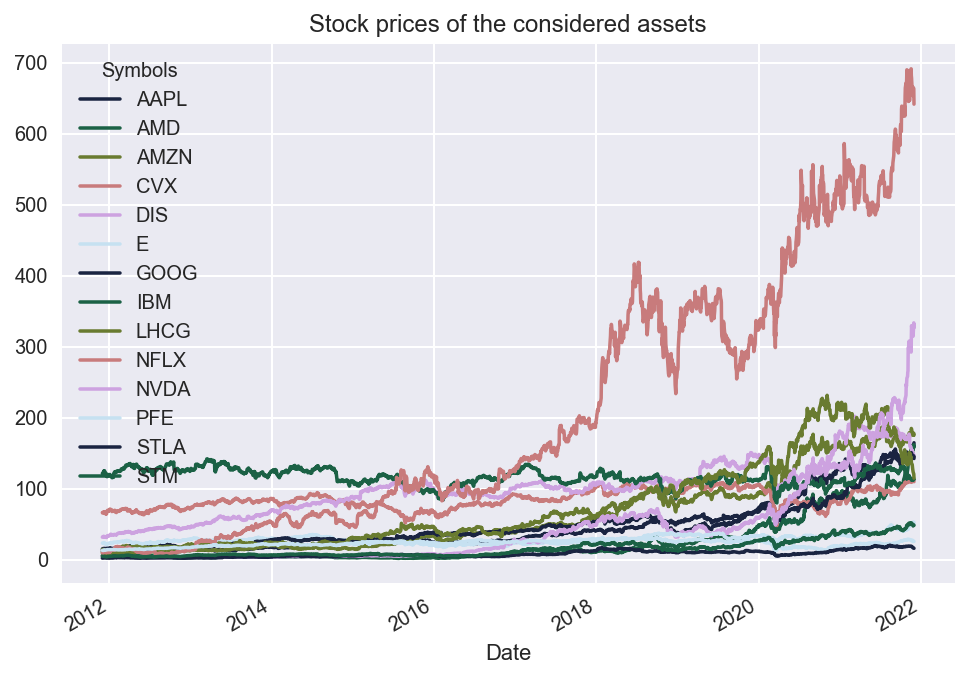

In [327]:
prices_df = web.get_data_yahoo(risky_assets, start_date, end_date) 
print(f'Downloaded {prices_df.shape[0]} rows of data.')
prices_df['Adj Close'].plot(title='Stock prices of the considered assets');

<AxesSubplot:xlabel='Symbols'>

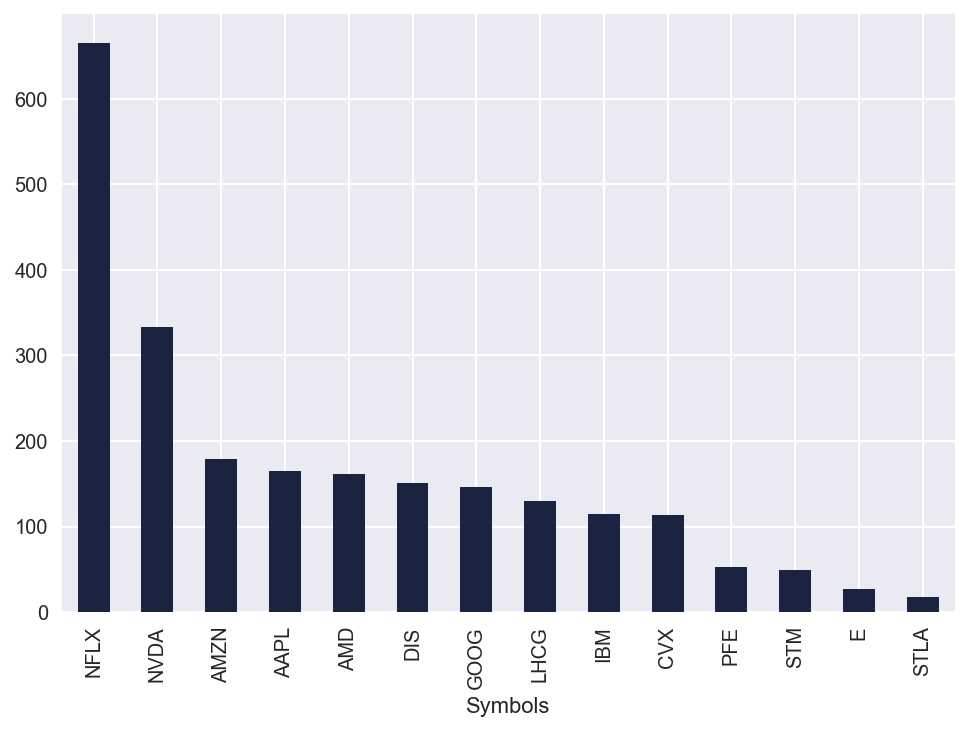

In [328]:
prices_df['Adj Close']['2021-11-23':'2021-11-30'].max().sort_values(ascending=False).plot(kind='bar')

### Calcolo Ritorni medi e matrice di covarianza del portafoglio

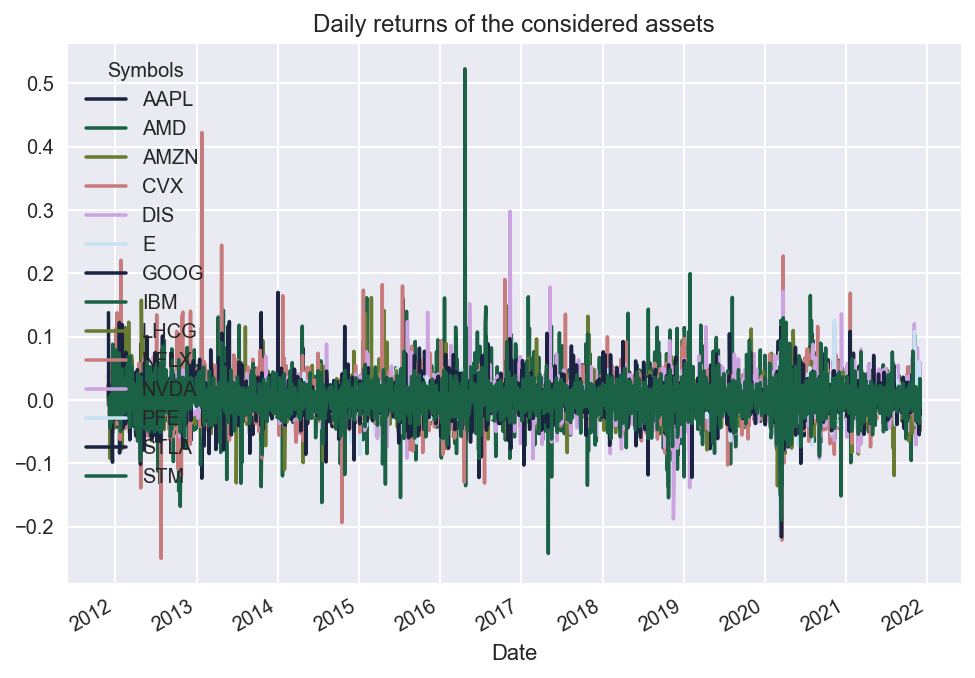

In [329]:
returns_df = prices_df['Adj Close'].pct_change().dropna()
avg_returns = returns_df.mean() * n_days
cov_mat = returns_df.cov() * n_days
returns_df.plot(title='Daily returns of the considered assets');

#### Simuliamo portafogli con pesi casuali

In [330]:
np.random.seed(42)

random_numbers = np.random.random(size=(n_port, n_assets)) # matrix 10^5 x 15

# np.newaxis --> increase the dimension of the existing array by one more dimension
# a 2d array becames a 3d one 
# in questo caso prendo la somma di ogni sequenza di numeri casuali
# aggiungo una dimensioni in modo tale da avere per ogni riga una somma
# divido ciascun elemento di ciascuna sequenza per la somma della sequenza calcolata precedentemente
# In questo modo ottengo n sequenze di pesi la cui somma, per ciascuna sequenza è pari ad 1

weights = random_numbers / np.sum(random_numbers, axis=1)[:, np.newaxis]  

# Assumiamo di valutare un portafoglio con pesi positivi e che quindi non assume posizioni corte per nessun asset


### Calcoliamo i rendimenti di portafoglio e lista delle volatilità:

#### sqrt (vettore trasposto pesi * matrice covarianza * vettore dei pesi)

In [331]:
# dot --> prodotto scalare

portf_rtns = np.dot(weights, avg_returns)

# portf_vol (volatilità):
# radice quadrata di (matrice pesi trasposta x (matrice covarianze x peso))

portf_vol = []
for i in range(0, len(weights)):
    portf_vol.append(np.sqrt(np.dot(weights[i].T, 
                                    np.dot(cov_mat, weights[i]))))
portf_vol = np.array(portf_vol)  

# Ritorni del portafolgio / Varianza del portafoglio 
# NB: Non stiamo sottraendo il rendimento risk-free

portf_sharpe_ratio = portf_rtns / portf_vol


# L'indice di sharp è utile per ottenere:
### portafolgio con rendimento massimo
### portafolgio con varianza minimia
### portafoglio con indice di sharp più alto (miglio efficienza rendimento/rischio)

In [332]:
portf_results_df = pd.DataFrame({'returns': portf_rtns,
                                 'volatility': portf_vol,
                                 'sharpe_ratio': portf_sharpe_ratio})

portf_results_df

,returns,volatility,sharpe_ratio
0,0.272945,0.207024,1.318419
1,0.268318,0.197195,1.360672
2,0.238378,0.198876,1.198628
3,0.308259,0.221927,1.389008
4,0.259181,0.204037,1.270267
...,...,...,...
99995,0.294963,0.215840,1.366583
99996,0.276797,0.199120,1.390105
99997,0.262456,0.214540,1.223343
99998,0.262278,0.210809,1.244152


#### Creazione della frontiera efficiente

In [333]:
n_points = 100

portf_vol_ef = []
indices_to_skip = []

# linspace: Return evenly spaced numbers over a specified interval (start, stop, num=50)
portf_rtns_ef = np.linspace(portf_results_df.returns.min(), 
                            portf_results_df.returns.max(), 
                           n_points)

portf_rtns_ef = np.round(portf_rtns_ef, 2)    
portf_rtns = np.round(portf_rtns, 2)

for point_index in range(n_points):
    if portf_rtns_ef[point_index] not in portf_rtns:
        indices_to_skip.append(point_index)
        continue
    matched_ind = np.where(portf_rtns == portf_rtns_ef[point_index])
    portf_vol_ef.append(np.min(portf_vol[matched_ind]))
    

portf_rtns_ef = np.delete(portf_rtns_ef, indices_to_skip)


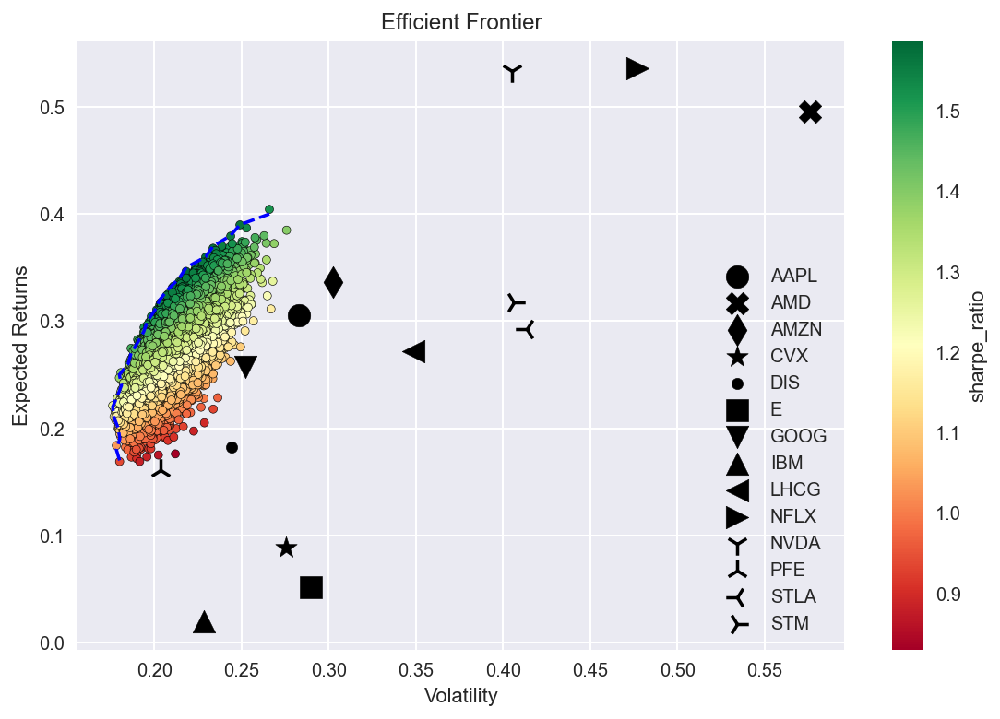

In [334]:
MARKS = ['o', 'X', 'd', '*', ".", ",", "v", "^", "<", ">", "1", "2", "3", "4", "P"]

fig, ax = plt.subplots()

portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)

ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')

ax.plot(portf_vol_ef, portf_rtns_ef, 'b--')

for asset_index in range(n_assets):
    ax.scatter(x=np.sqrt(cov_mat.iloc[asset_index, asset_index]), 
                y=avg_returns[asset_index], 
                marker=MARKS[asset_index], 
                s=150, 
                color='black',
                label=risky_assets[asset_index])
ax.legend()



plt.tight_layout()
plt.show()



Ricerca Portafogli Ottimizzati

In [335]:
max_sharpe_ind = np.argmax(portf_results_df.sharpe_ratio)
max_sharpe_portf = portf_results_df.loc[max_sharpe_ind]

min_vol_ind = np.argmin(portf_results_df.volatility)
min_vol_portf = portf_results_df.loc[min_vol_ind]

In [336]:
print('Maximum Sharpe Ratio portfolio')
print('Performance')

for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights:')
for x, y in zip(risky_assets, np.sort(weights[np.argmax(portf_results_df.sharpe_ratio)])):
    print(f'\t{x}: {100*y:.2f}% ', end="", flush=True)
    print()

Maximum Sharpe Ratio portfolio
Performance
returns: 34.64% volatility: 21.83% sharpe_ratio: 158.72% 
Weights:
	AAPL: 0.15% 
	AMD: 0.52% 
	AMZN: 2.09% 
	CVX: 2.68% 
	DIS: 3.02% 
	E: 4.58% 
	GOOG: 5.96% 
	IBM: 9.68% 
	LHCG: 9.68% 
	NFLX: 10.45% 
	NVDA: 11.19% 
	PFE: 12.21% 
	STLA: 13.66% 
	STM: 14.11% 


In [337]:
print('Minimum Volatility portfolio ----')
print('Performance')
for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(tickers[:-1], np.sort(weights[np.argmin(portf_results_df.volatility)])):
    print(f'\t{x}: {100*y:.2f}% ', end="", flush=True)
    print()

Minimum Volatility portfolio ----
Performance
returns: 22.11% volatility: 17.61% sharpe_ratio: 125.55% 
Weights
	AAPL: 0.05% 
	AMD: 0.43% 
	AMZN: 0.81% 
	CVX: 4.53% 
	DIS: 5.47% 
	E: 5.71% 
	GOOG: 6.27% 
	IBM: 7.41% 
	LHCG: 8.74% 
	NFLX: 8.88% 
	NVDA: 10.32% 
	PFE: 10.96% 
	STLA: 15.13% 
	STM: 15.29% 


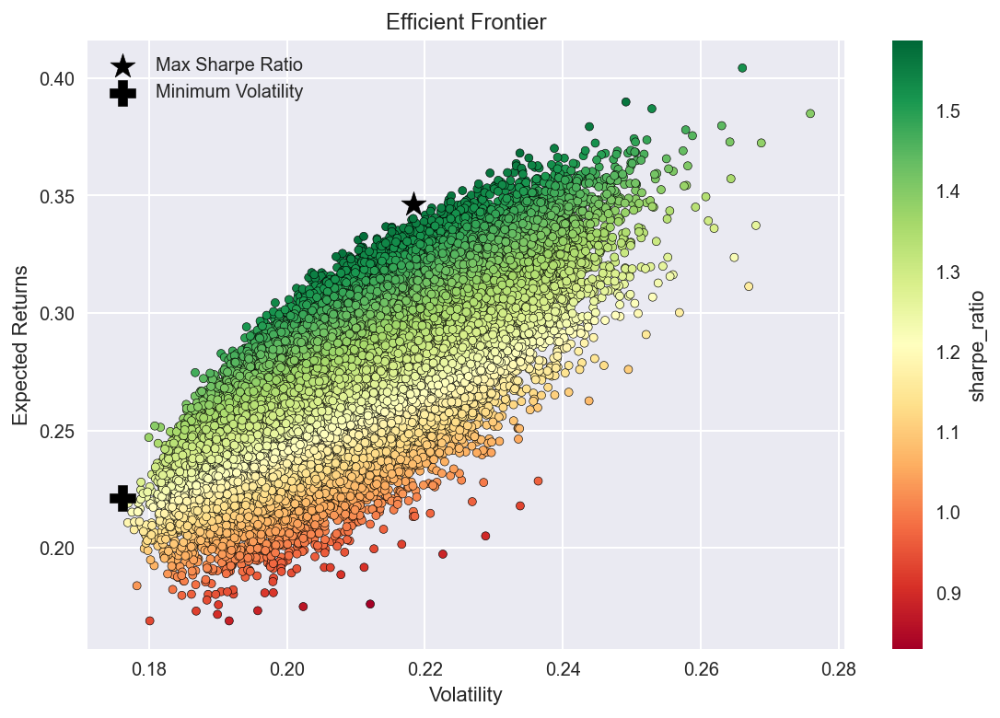

In [338]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.scatter(x=max_sharpe_portf.volatility, 
           y=max_sharpe_portf.returns, 
           c='black', marker='*', 
           s=200, label='Max Sharpe Ratio')
ax.scatter(x=min_vol_portf.volatility, 
           y=min_vol_portf.returns, 
           c='black', marker='P', 
           s=200, label='Minimum Volatility')
ax.set(xlabel='Volatility', ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.legend()

plt.tight_layout()

plt.show()

### Frontiera efficiente con la funzione di ottimizzazione di scipy

In [339]:
import numpy as np
import scipy.optimize as sco

In [340]:
def get_portf_rtn(w, avg_rtns):
    return np.sum(avg_rtns * w)

def get_portf_vol(w, avg_rtns, cov_mat):
    return np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))



def get_efficient_frontier(avg_rtns, cov_mat, rtns_range):
    
    efficient_portfolios = []
    
    n_assets = len(avg_returns)
    args = (avg_returns, cov_mat)
    bounds = tuple((0,1) for asset in range(n_assets))
    initial_guess = n_assets * [1. / n_assets, ]
    
    for ret in rtns_range:
        constraints = ({'type': 'eq', 
                        'fun': lambda x: get_portf_rtn(x, avg_rtns) - ret},
                       {'type': 'eq', 
                        'fun': lambda x: np.sum(x) - 1})
        efficient_portfolio = sco.minimize(get_portf_vol, initial_guess, 
                                           args=args, method='SLSQP', 
                                           constraints=constraints,
                                           bounds=bounds)
        efficient_portfolios.append(efficient_portfolio)
    
    return efficient_portfolios

In [341]:
rtns_range = np.linspace(-0.22, 0.32, 200)

efficient_portfolios = get_efficient_frontier(avg_returns, 
                                              cov_mat, 
                                              rtns_range)

vols_range = [x['fun'] for x in efficient_portfolios]

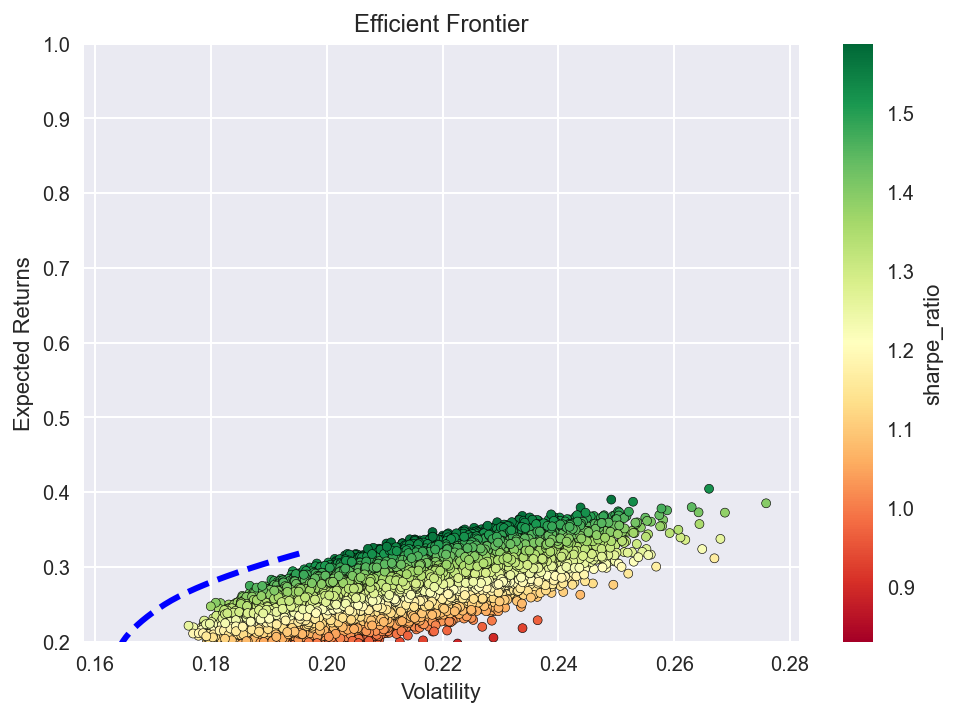

In [342]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.plot(vols_range, rtns_range, 'b--', linewidth=3)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')

plt.ylim(0.2,1)
plt.show()

Portafoglio con minima volatilità

In [343]:
min_vol_ind = np.argmin(vols_range)
min_vol_portf_rtn = rtns_range[min_vol_ind]
min_vol_portf_vol = efficient_portfolios[min_vol_ind]['fun']

min_vol_portf = {'Return': min_vol_portf_rtn,
                 'Volatility': min_vol_portf_vol,
                 'Sharpe Ratio': (min_vol_portf_rtn / 
                                  min_vol_portf_vol)}

min_vol_portf

{'Return': 0.17618090452261312,
 'Volatility': 0.16376749640386157,
 'Sharpe Ratio': 1.0757989734919025}

Sommario dei risultati

In [344]:
print('Minimum Volatility portfolio ----')
print('Performance')

for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(risky_assets, efficient_portfolios[min_vol_ind]['x']):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
Return: 17.62% Volatility: 16.38% Sharpe Ratio: 107.58% 
Weights
AAPL: 5.38% AMD: 0.00% AMZN: 6.92% CVX: 3.49% DIS: 13.91% E: 0.51% GOOG: 5.78% IBM: 17.07% LHCG: 6.05% NFLX: 1.93% NVDA: 0.00% PFE: 38.96% STLA: 0.00% STM: 0.00% 

Ricerca del portafoglio con il massimo Sharpe ratio

Funzione obiettivo

In [345]:
def neg_sharpe_ratio(w, avg_rtns, cov_mat, rf_rate):
    portf_returns = np.sum(avg_rtns * w)
    portf_volatility = np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))
    portf_sharpe_ratio = (portf_returns - rf_rate) / portf_volatility
    return -portf_sharpe_ratio

Ricerca del portafoglio ottimale

In [346]:
n_assets = len(avg_returns)
RF_RATE = 0

args = (avg_returns, cov_mat, RF_RATE)
constraints = ({'type': 'eq', 
                'fun': lambda x: np.sum(x) - 1})
bounds = tuple((0,1) for asset in range(n_assets))
initial_guess = n_assets * [1. / n_assets]

max_sharpe_portf = sco.minimize(neg_sharpe_ratio, 
                                x0=initial_guess, 
                                args=args,
                                method='SLSQP', 
                                bounds=bounds, 
                                constraints=constraints)

In [347]:
max_sharpe_portf_w = max_sharpe_portf['x']
max_sharpe_portf = {'Return': get_portf_rtn(max_sharpe_portf_w, 
                                            avg_returns),
                    'Volatility': get_portf_vol(max_sharpe_portf_w, 
                                                avg_returns, 
                                                cov_mat),
                    'Sharpe Ratio': -max_sharpe_portf['fun']}
max_sharpe_portf

{'Return': 0.3715640114087571,
 'Volatility': 0.2242189663457861,
 'Sharpe Ratio': 1.657147998959813}

In [348]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')

for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(risky_assets, max_sharpe_portf_w):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
Return: 37.16% Volatility: 22.42% Sharpe Ratio: 165.71% 
Weights
AAPL: 12.91% AMD: 2.01% AMZN: 12.05% CVX: 0.00% DIS: 0.00% E: 0.00% GOOG: 0.00% IBM: 0.00% LHCG: 9.46% NFLX: 17.14% NVDA: 22.21% PFE: 19.33% STLA: 4.89% STM: 0.00% 

### Ottimizzazione da un altro punto di vista: l'avversione al rischio

In [349]:
!pip install cvxpy

In [350]:
import cvxpy as cp

In [351]:
avg_returns = avg_returns.values
cov_mat = cov_mat.values

In [352]:
weights = cp.Variable(n_assets)
gamma = cp.Parameter(nonneg=True)
portf_rtn_cvx = avg_returns * weights 
portf_vol_cvx = cp.quad_form(weights, cov_mat)
objective_function = cp.Maximize(portf_rtn_cvx - gamma * portf_vol_cvx)
problem = cp.Problem(objective_function, 
                     [cp.sum(weights) == 1, weights >= 0])

C:\Users\samue\anaconda3\lib\site-packages\cvxpy\expressions\expression.py:593: UserWarning: 
This use of ``*`` has resulted in matrix multiplication.
Using ``*`` for matrix multiplication has been deprecated since CVXPY 1.1.
    Use ``*`` for matrix-scalar and vector-scalar multiplication.
    Use ``@`` for matrix-matrix and matrix-vector multiplication.
    Use ``multiply`` for elementwise multiplication.
This code path has been hit 4 times so far.

  warnings.warn(msg, UserWarning)


In [353]:
N_POINTS = 25
portf_rtn_cvx_ef = np.zeros(N_POINTS)
portf_vol_cvx_ef = np.zeros(N_POINTS)
weights_ef = []
gamma_range = np.logspace(-3, 3, num=N_POINTS)

for i in range(N_POINTS):
    gamma.value = gamma_range[i]
    problem.solve()
    portf_vol_cvx_ef[i] = cp.sqrt(portf_vol_cvx).value
    portf_rtn_cvx_ef[i] = portf_rtn_cvx.value
    weights_ef.append(weights.value)

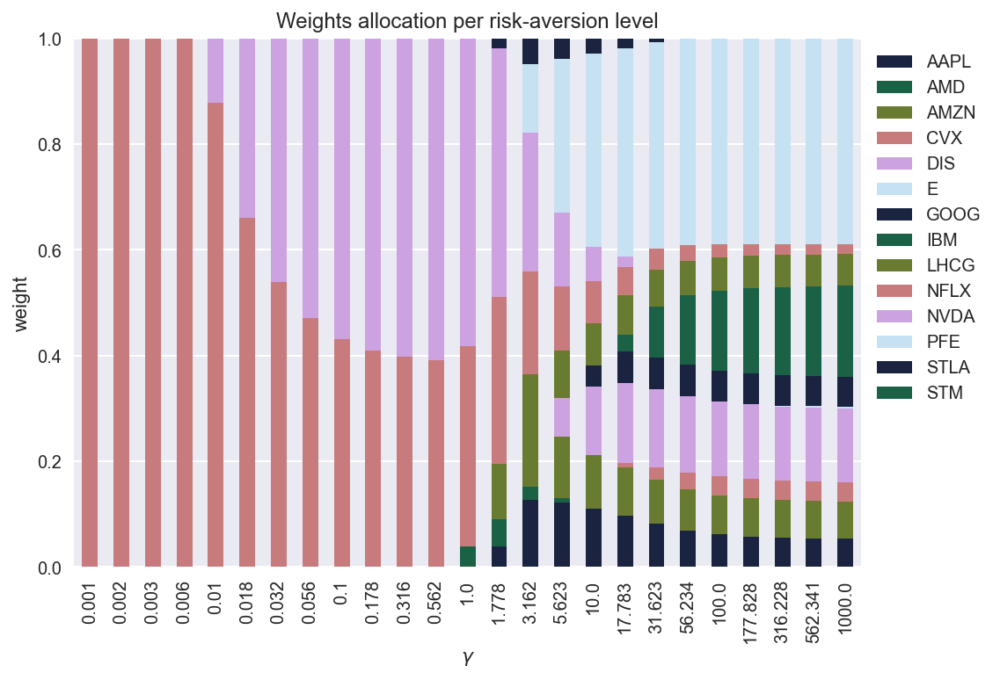

In [354]:
weights_df = pd.DataFrame(weights_ef, 
                          columns=risky_assets, 
                          index=np.round(gamma_range, 3))
ax = weights_df.plot(kind='bar', stacked=True) 
ax.set(title='Weights allocation per risk-aversion level',
       xlabel=r'$\gamma$', 
       ylabel='weight')
ax.legend(bbox_to_anchor=(1,1))

plt.tight_layout()

plt.show()

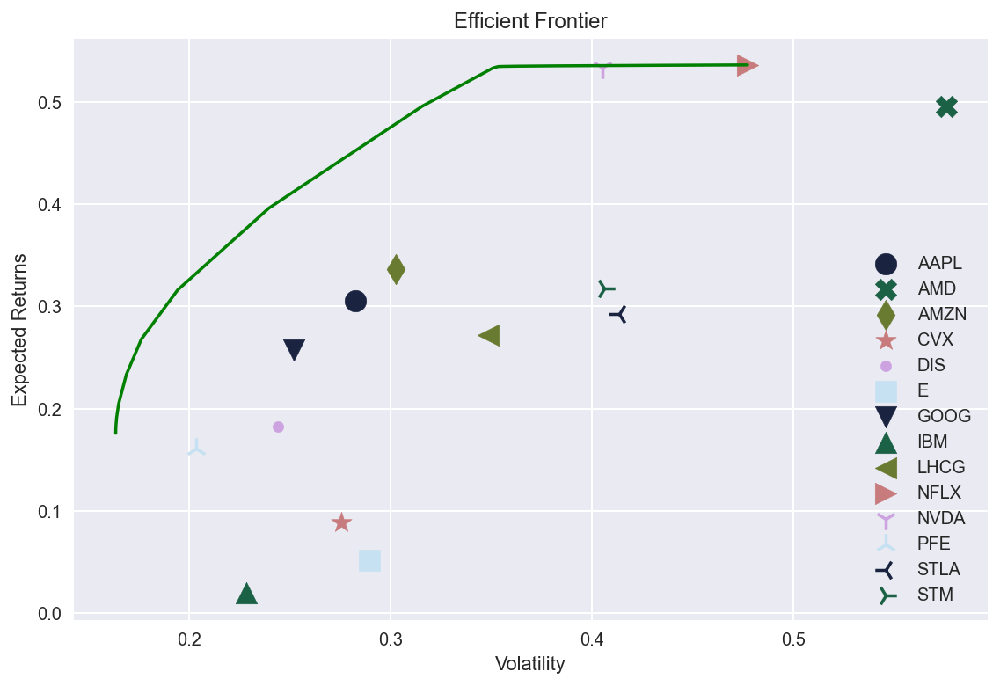

In [355]:
#MARKS = ['o', 'X', 'd', '*']

fig, ax = plt.subplots()
ax.plot(portf_vol_cvx_ef, portf_rtn_cvx_ef, 'g-')
for asset_index in range(n_assets):
     plt.scatter(x=np.sqrt(cov_mat[asset_index, asset_index]), 
                 y=avg_returns[asset_index], 
                 marker=MARKS[asset_index], 
                 label=risky_assets[asset_index],
                 s=150)
ax.set(title='Efficient Frontier',
       xlabel='Volatility', 
       ylabel='Expected Returns', )
ax.legend()

plt.tight_layout()

plt.show()

# ANALISI TECNICA

## Backtesting medie mobili ed esponenziali

In [356]:
data = get_data(tickers[:-1])

In [357]:
adj_close = data['Adj Close']
volume = data['Volume']

In [358]:
for stock in tickers[:-1]:
    
    c = stock + "_20"
    # media mobile a 20 giorni (circa un mese lavorativo)
    adj_close[c] = adj_close[stock].rolling(20).mean()
    
    c = stock + "_120"
    #media mobile a 120 giorni (circa 6 mesi lavorativi)
    adj_close[c] = adj_close[stock].rolling(120).mean()


C:\Users\samue\AppData\Local\Temp/ipykernel_1696/1814644942.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adj_close[c] = adj_close[stock].rolling(20).mean()
C:\Users\samue\AppData\Local\Temp/ipykernel_1696/1814644942.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adj_close[c] = adj_close[stock].rolling(120).mean()


In [359]:
adj_close.columns

Index(['AAPL', 'IBM', 'GOOG', 'AMZN', 'NVDA', 'AMD', 'NFLX', 'E', 'STLA',
       'STM', 'PFE', 'DIS', 'LHCG', 'CVX', 'AAPL_20', 'AAPL_120', 'IBM_20',
       'IBM_120', 'GOOG_20', 'GOOG_120', 'AMZN_20', 'AMZN_120', 'NVDA_20',
       'NVDA_120', 'AMD_20', 'AMD_120', 'NFLX_20', 'NFLX_120', 'E_20', 'E_120',
       'STLA_20', 'STLA_120', 'STM_20', 'STM_120', 'PFE_20', 'PFE_120',
       'DIS_20', 'DIS_120', 'LHCG_20', 'LHCG_120', 'CVX_20', 'CVX_120'],
      dtype='object', name='Symbols')

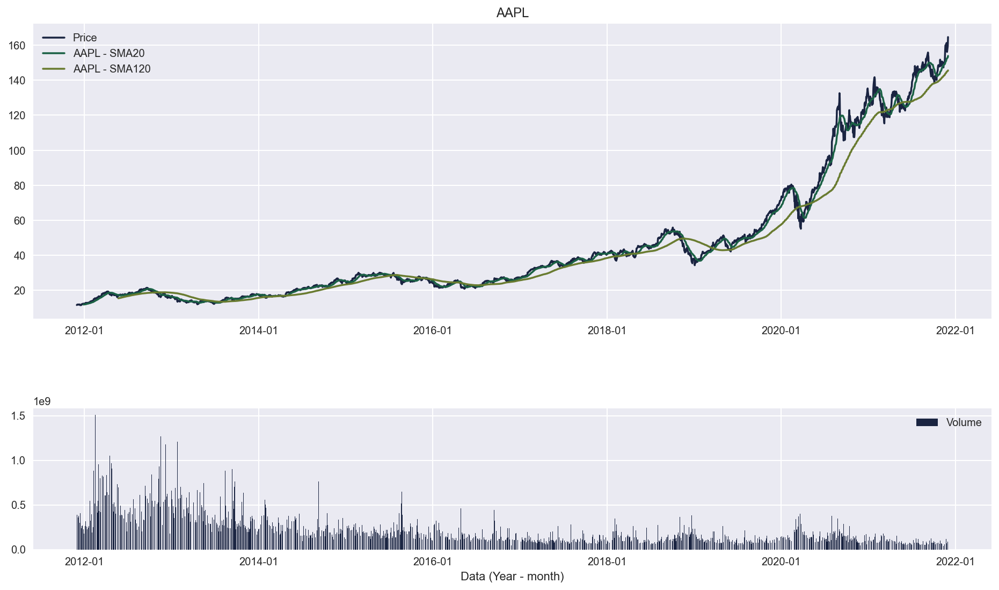

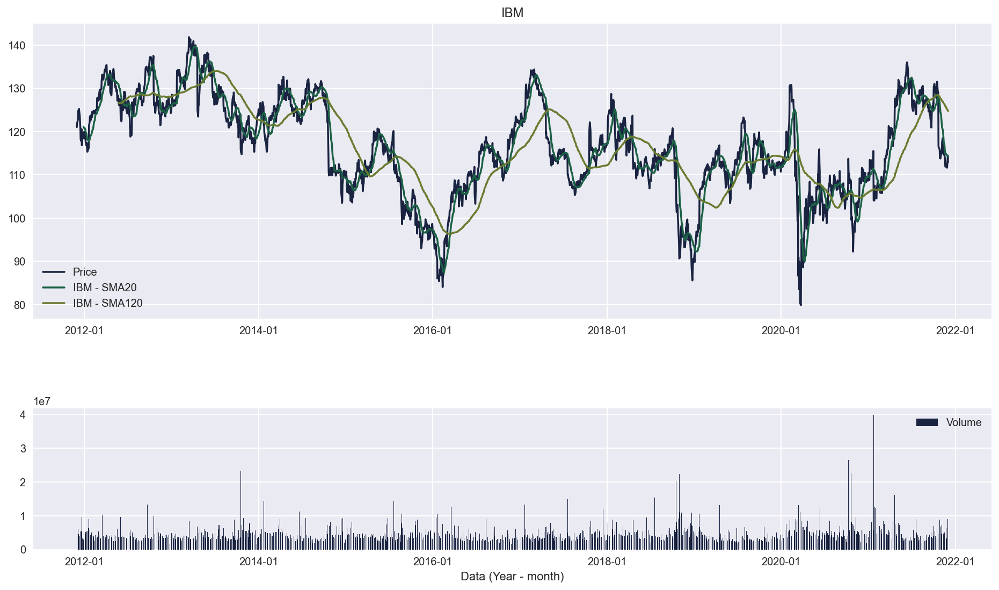

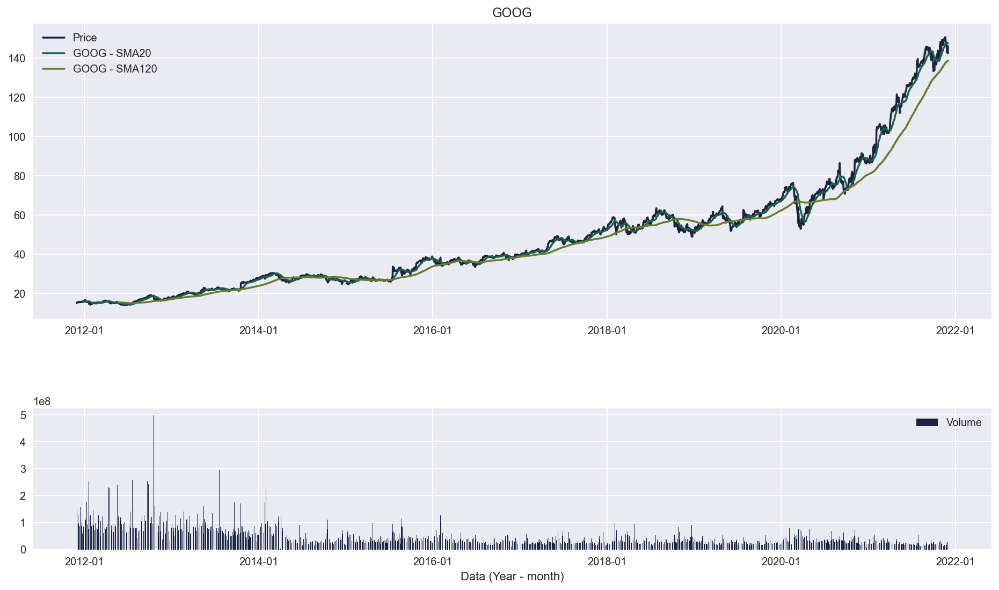

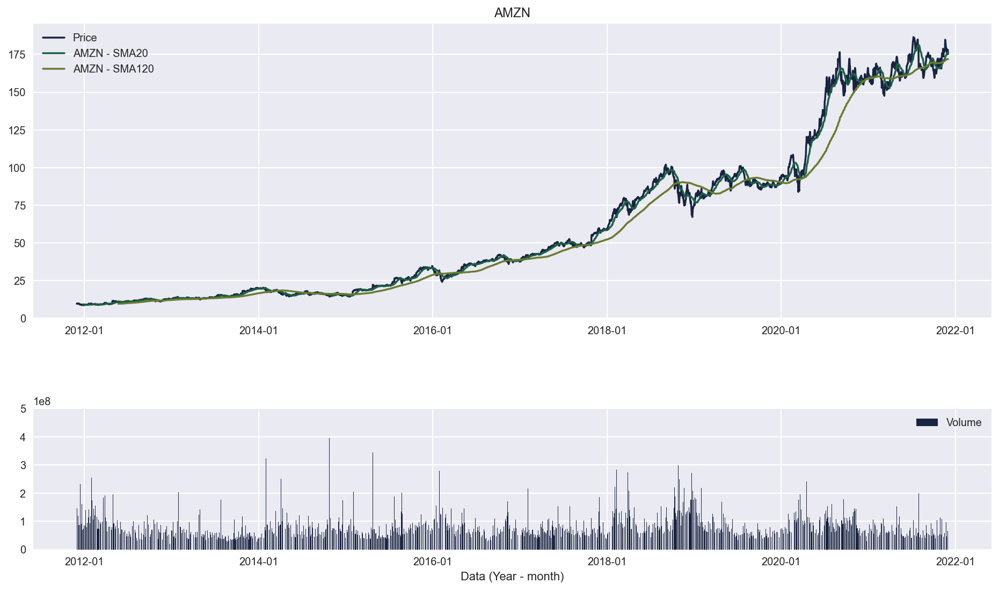

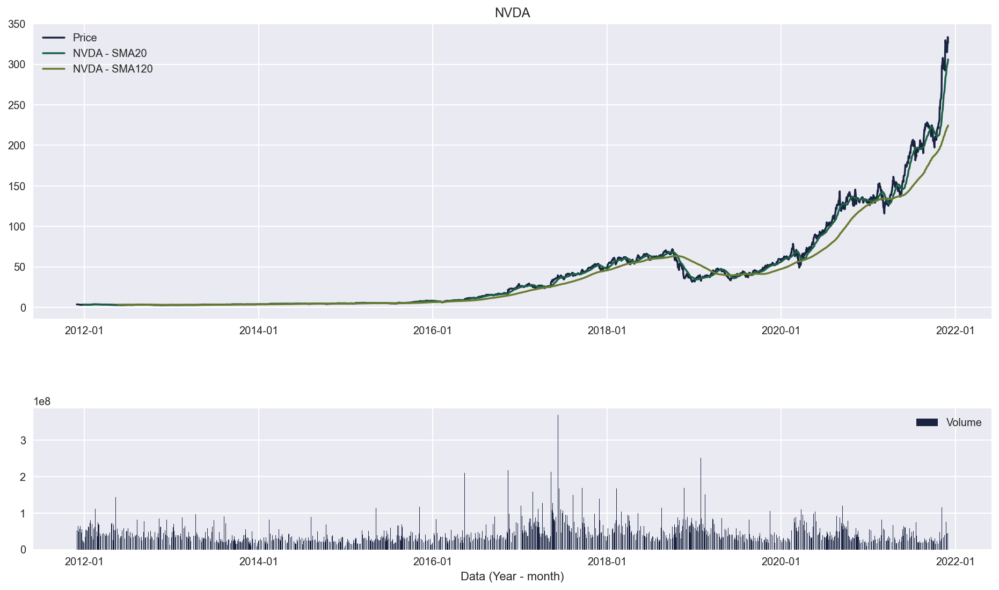

...

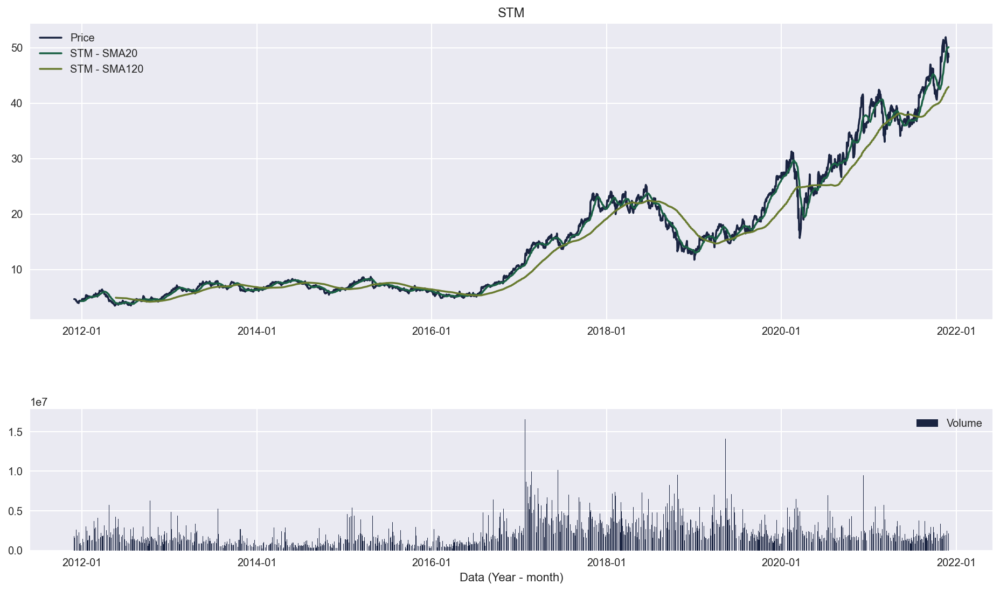

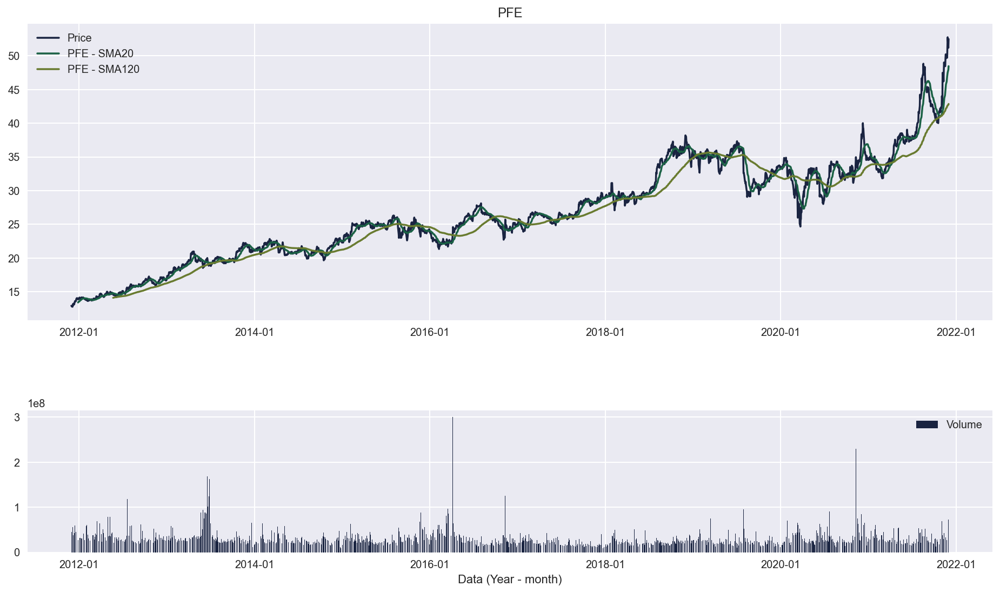

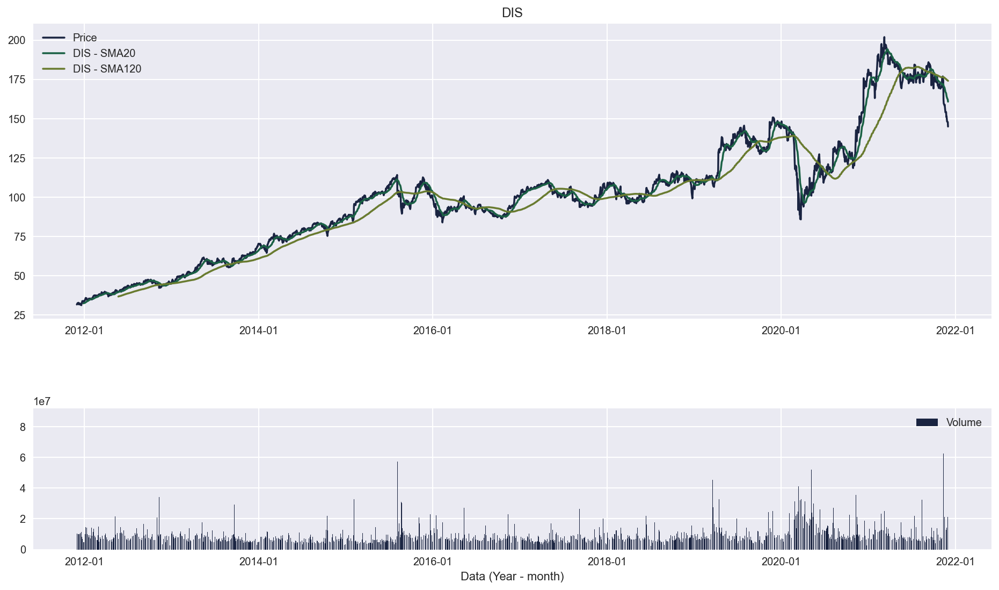

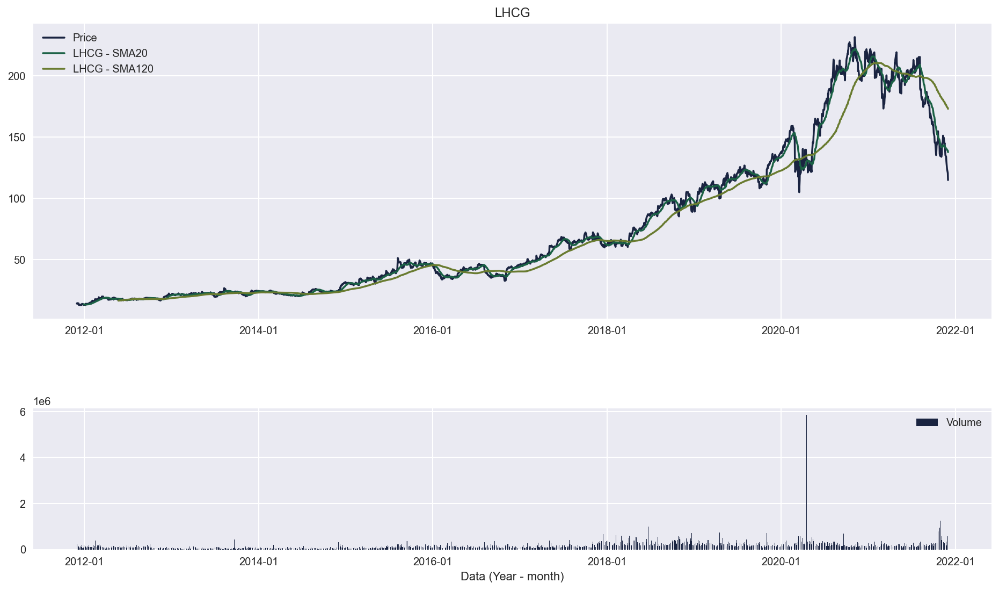

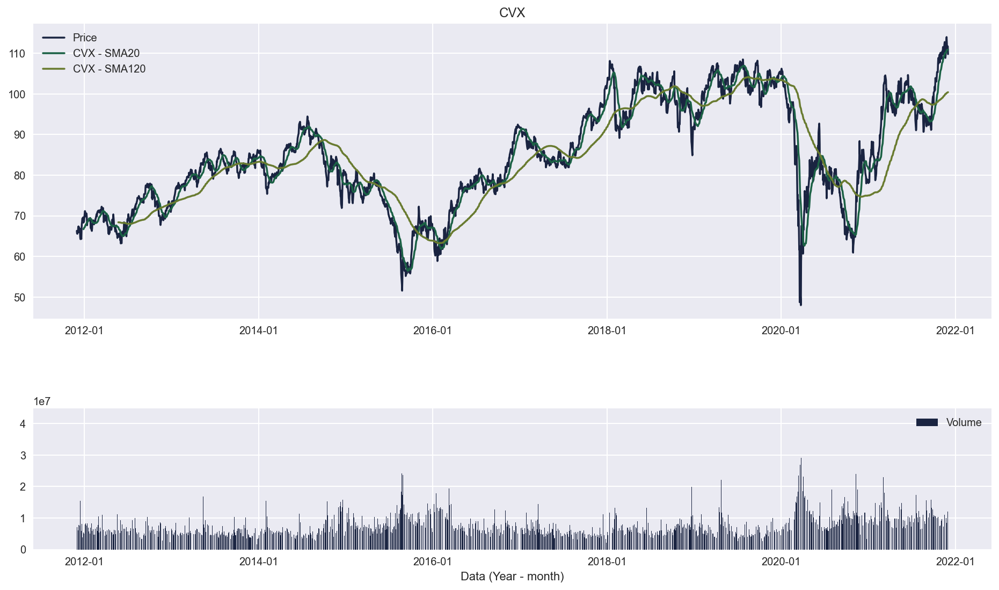

In [360]:
import matplotlib.dates as mdates

for stock in tickers[:-1]:
    
    c20 = stock + "_20"
    c120 = stock + "_120"
    
    plt.figure(figsize=(16,9))
    ax1 = plt.subplot2grid((7,1), (0,0), rowspan = 4, colspan = 1, title = stock)
    ax2 = plt.subplot2grid((7,1), (5,0), rowspan = 2, colspan = 1, sharex = ax1)
    ax1.plot(adj_close[stock], label = 'Price')
    ax1.plot(adj_close[c20], label = f'{stock} - SMA20')
    ax1.plot(adj_close[c120], label = f'{stock} - SMA120')

    ax2.bar(adj_close.index, volume[stock], label = 'Volume')
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    ax2.set_xlabel('Data (Year - month)')
    ax1.legend()
    ax2.legend();

In [361]:
for stock in tickers[:-1]:    
    
    c20 = stock + "_20"
    c120 = stock + "_120"
    
    adj_close[f'{stock}_Price_yesterday'] = adj_close[stock].shift(1)
    adj_close[f'{stock}_Change'] = (adj_close[stock] /  adj_close[f'{stock}_Price_yesterday'])
    adj_close[f'{stock}_Return'] = np.cumprod(adj_close[f'{stock}_Change'][1:])
    adj_close[f'{stock}_Invested_SMA'] = [1 if (adj_close.loc[i, c20] > adj_close.loc[i, c120])
                            else 0 for i in adj_close.index]

C:\Users\samue\AppData\Local\Temp/ipykernel_1696/584971583.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adj_close[f'{stock}_Price_yesterday'] = adj_close[stock].shift(1)
C:\Users\samue\AppData\Local\Temp/ipykernel_1696/584971583.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adj_close[f'{stock}_Change'] = (adj_close[stock] /  adj_close[f'{stock}_Price_yesterday'])
C:\Users\samue\AppData\Local\Temp/ipykernel_1696/584971583.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

C:\Users\samue\AppData\Local\Temp/ipykernel_1696/584971583.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adj_close[f'{stock}_Invested_SMA'] = [1 if (adj_close.loc[i, c20] > adj_close.loc[i, c120])
C:\Users\samue\AppData\Local\Temp/ipykernel_1696/584971583.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adj_close[f'{stock}_Price_yesterday'] = adj_close[stock].shift(1)
C:\Users\samue\AppData\Local\Temp/ipykernel_1696/584971583.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a

In [362]:
# adj_close['AAPL_Return']

np.cumprod([0.5, 2, 4])

array([0.5, 1. , 4. ])

In [363]:
sma = pd.DataFrame()

for stock in tickers[:-1]:
    
    print(stock)
    
    temp = adj_close[adj_close[f'{stock}_Invested_SMA'] == 1]
    sma[f'{stock}_Return'] = np.cumprod(temp[f'{stock}_Change'])
    sma[f'{stock}_rtn'] =sma[f'{stock}_Return'].pct_change()
    
    mean = sma[f'{stock}_rtn'].mean()*252
    print(f"mean: {mean}")
    
    std = sma[f'{stock}_rtn'].std()*np.sqrt(252)
    print(f"std: {std}")
    
    
    print(f"mean/std: {mean /std}") 
    
    print()
    print()
    

AAPL
mean: 0.3068842913581337
std: 0.26361570235983994
mean/std: 1.164135097458009


IBM
mean: -0.052094211037223
std: 0.1692097772632108
mean/std: -0.307867617816132


GOOG
mean: 0.22945274000183516
std: 0.2821472659365
mean/std: 0.8132375099940742


AMZN
mean: 0.29752650980545414
std: 0.33016076486888174
mean/std: 0.901156471222776


NVDA
mean: 0.679277937112605
std: 0.5069991551731257
mean/std: 1.3398009250738319


AMD
mean: 0.6341275211152466
std: 0.5955006008611712
mean/std: 1.0648646201166143


NFLX
mean: 0.7307835944684599
std: 0.939997220091951
mean/std: 0.7774316549542287


E
mean: 0.02470129035450379
std: 0.17456608863646572
mean/std: 0.14150108161009603


STLA
mean: 0.29321592181014655
std: 0.33016704291047316
mean/std: 0.8880835568123432


STM
mean: 0.3837233120101261
std: 0.3904822709816144
mean/std: 0.9826907404669173


PFE
mean: 0.09167716183745836
std: 0.1956077318340697
mean/std: 0.46867862010294326


DIS
mean: 0.141296667704021
std: 0.23306454094053197
mean/std: 0.606

In [364]:
sma = sma.fillna(0)
sma.head()

sma['Return'] = sma[[col for col in sma.columns if ("_Return" in col)]].sum(axis=1)

sma['Return']

Date
2012-05-22      6.938677
2012-05-23      6.929834
2012-05-24      5.950413
2012-05-25      5.920876
2012-05-29      5.996324
                 ...    
2021-11-23    144.943053
2021-11-24    147.843844
2021-11-26    144.809890
2021-11-29    149.424229
2021-11-30    141.281835
Name: Return, Length: 1802, dtype: float64

In [365]:
sma[[col for col in sma.columns if ("_Return" in col)] + ["Return"]]


,AAPL_Return,IBM_Return,GOOG_Return,AMZN_Return,NVDA_Return,AMD_Return,NFLX_Return,E_Return,STLA_Return,STM_Return,PFE_Return,DIS_Return,LHCG_Return,CVX_Return,Return
Date,,,,,,,,,,,,,,,
2012-05-22,0.992321,0.995247,0.000000,0.987254,0.000000,0.977778,0.000000,0.000000,0.000000,0.000000,0.992458,1.000000,0.993619,0.000000,6.938677
2012-05-23,1.016534,0.991707,0.000000,0.996195,0.000000,0.965079,0.000000,0.000000,0.000000,0.000000,0.980035,0.995945,0.984339,0.000000,6.929834
2012-05-24,1.007198,0.991555,0.000000,0.986841,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.982254,1.001126,0.981439,0.000000,5.950413
2012-05-25,1.001799,0.982504,0.000000,0.976067,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.981810,1.002478,0.976218,0.000000,5.920876
2012-05-29,1.019580,0.993426,0.000000,0.984595,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.984029,1.024555,0.990139,0.000000,5.996324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-23,6.765016,0.000000,3.908633,5.863843,48.533742,28.030846,33.570356,1.133037,5.720976,8.888494,1.585756,0.000000,0.000000,0.942354,144.943053
2021-11-24,6.787229,0.000000,3.907581,5.864449,49.952487,29.504187,33.787465,1.122154,5.584196,8.804673,1.579857,0.000000,0.000000,0.949566,147.843844
2021-11-26,6.572220,0.000000,3.803405,5.740213,48.162245,28.945139,34.164714,1.059677,5.277927,8.480094,1.676406,0.000000,0.000000,0.927850,144.809890


Rendimento del buy and hold

In [366]:
adj_close['Buy_and_hold'] = adj_close[[col for col in adj_close.columns if '_Return' in col]].sum(axis=1)

adj_close['Buy_and_hold']

Date
2011-11-30      0.000000
2011-12-01     14.260491
2011-12-02     14.276175
2011-12-05     14.401513
2011-12-06     14.326098
                 ...    
2021-11-23    269.351361
2021-11-24    273.334544
2021-11-26    268.104688
2021-11-29    275.117400
2021-11-30    269.290463
Name: Buy_and_hold, Length: 2517, dtype: float64

In [367]:
adj_close['rtn'] = adj_close['Buy_and_hold'][1:].pct_change()

In [368]:
adj_close['rtn'].std()

0.015104974289072934

Confronto fra i due

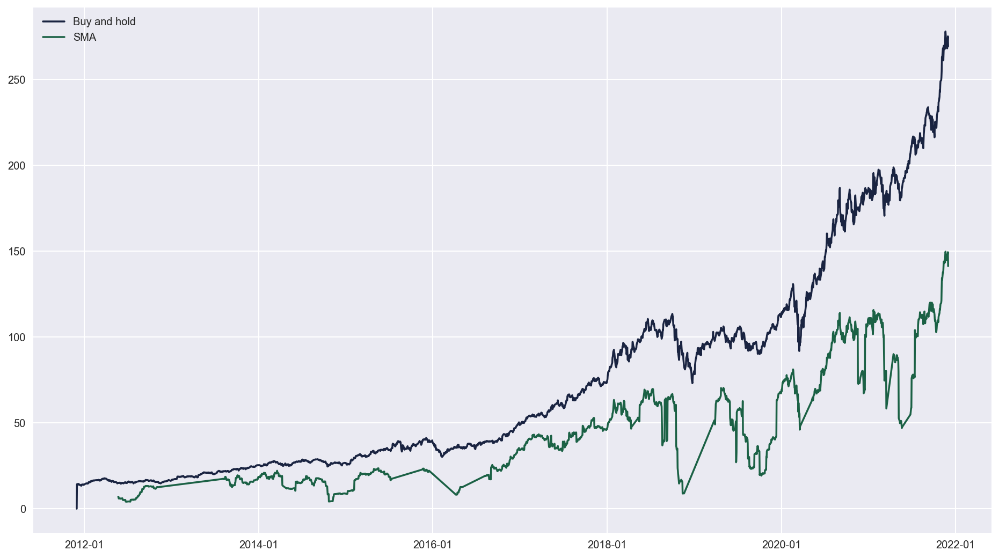

In [369]:
plt.figure(figsize=(16,9))

#ax3 = plt.subplot2grid((10,1), (8,0), rowspan = 2, colspan = 1, sharex = ax1)

plt.plot(adj_close['Buy_and_hold'], label = 'Buy and hold')
plt.plot(sma['Return'], label = 'SMA')

plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

plt.legend()
plt.show()

AAPL


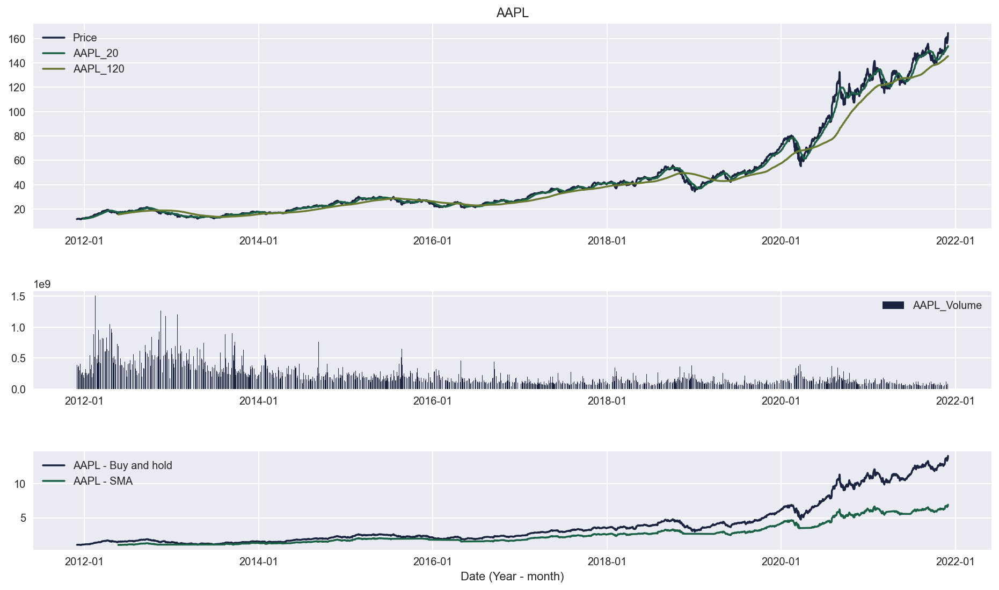



IBM


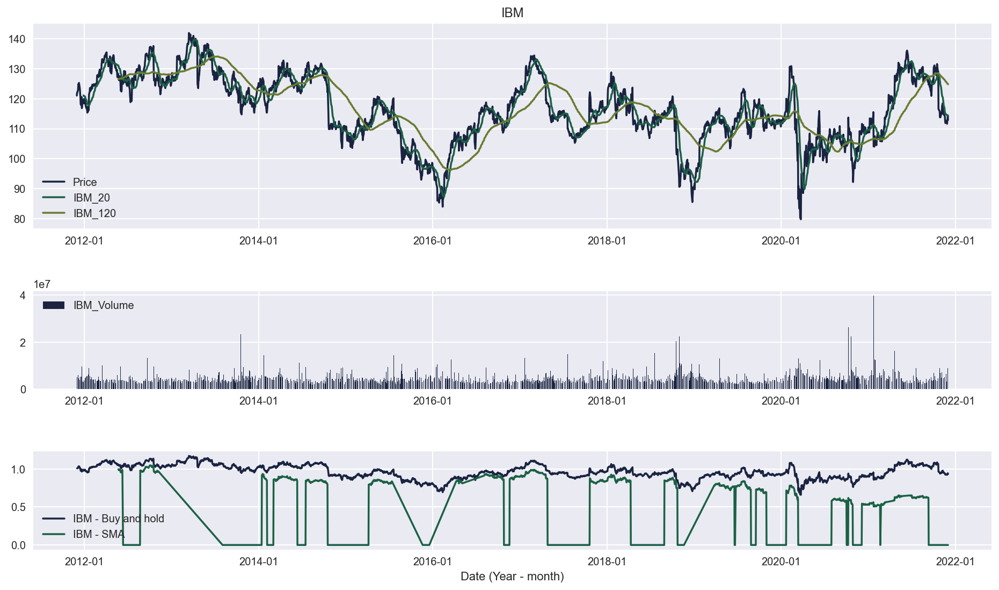



GOOG


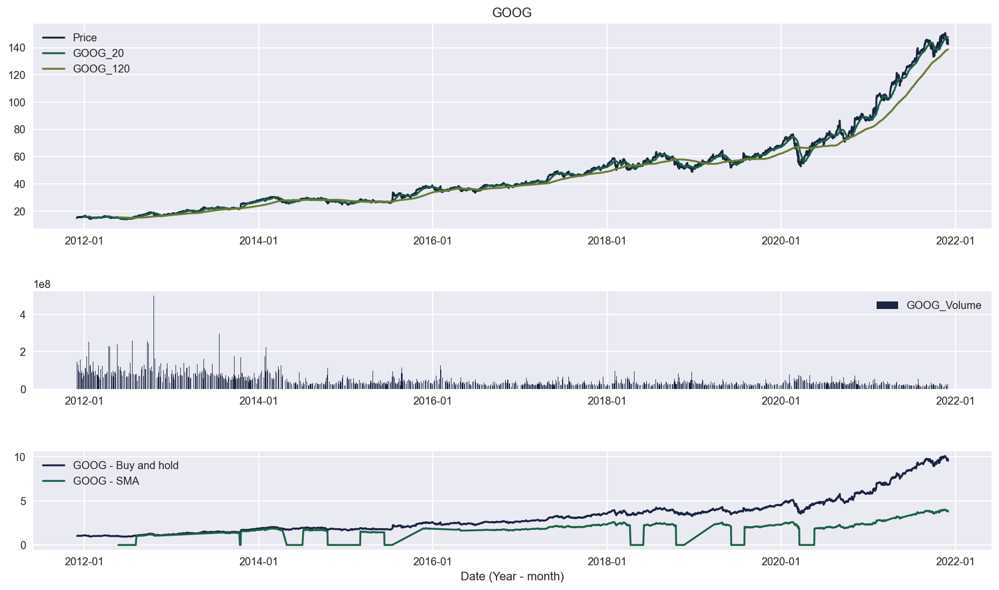



AMZN


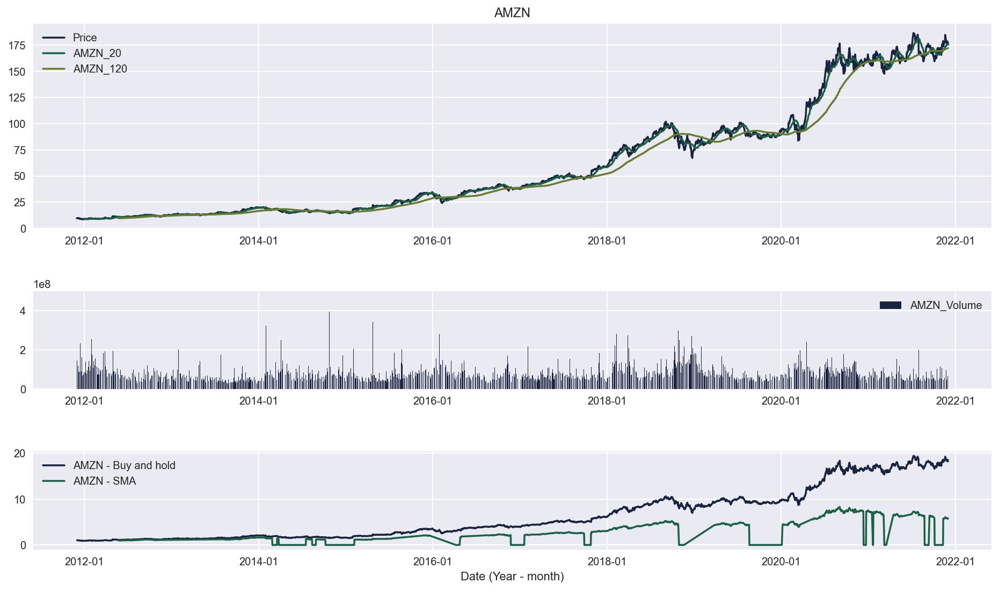



NVDA


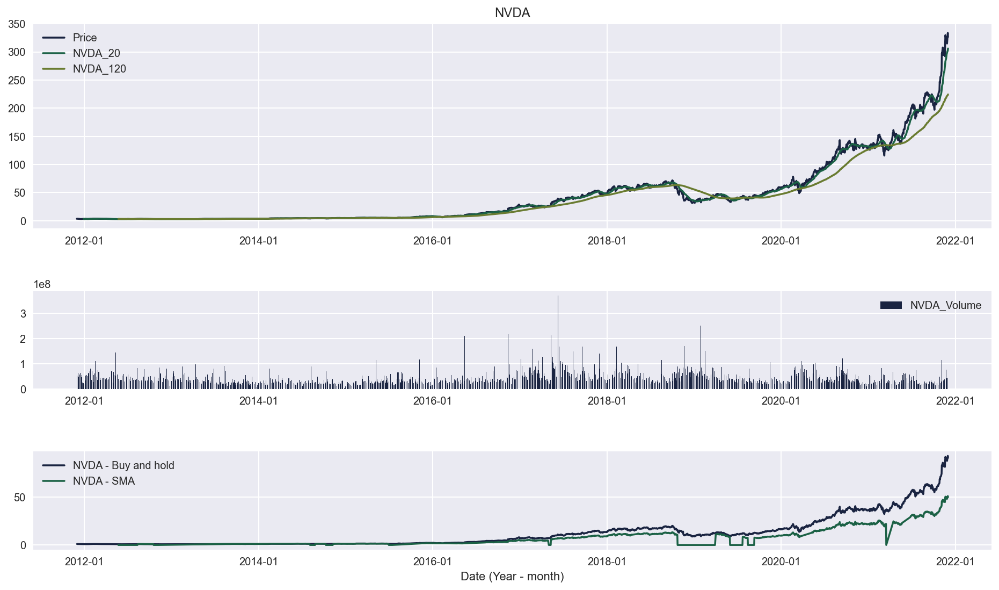



AMD


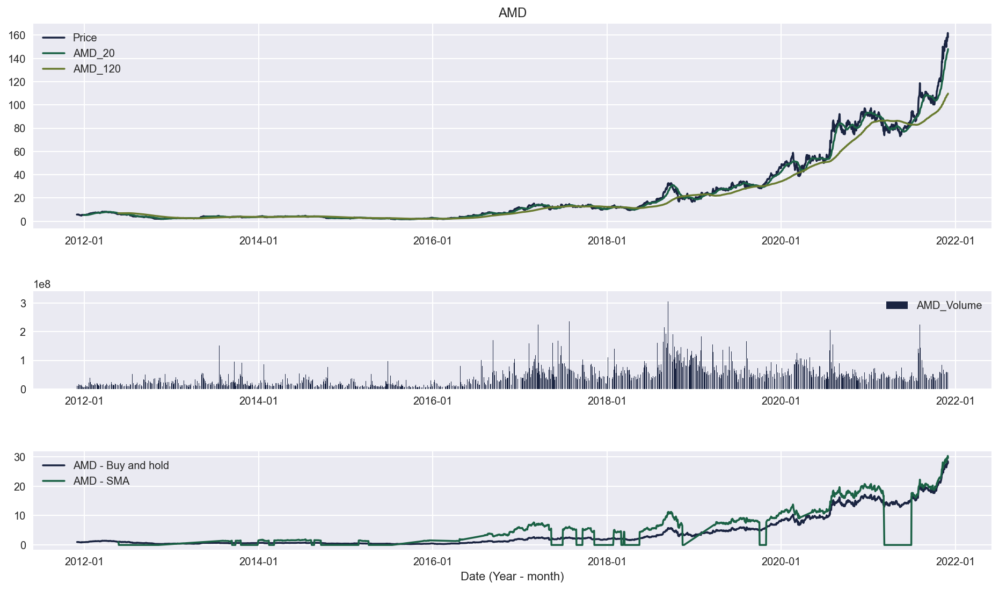



NFLX


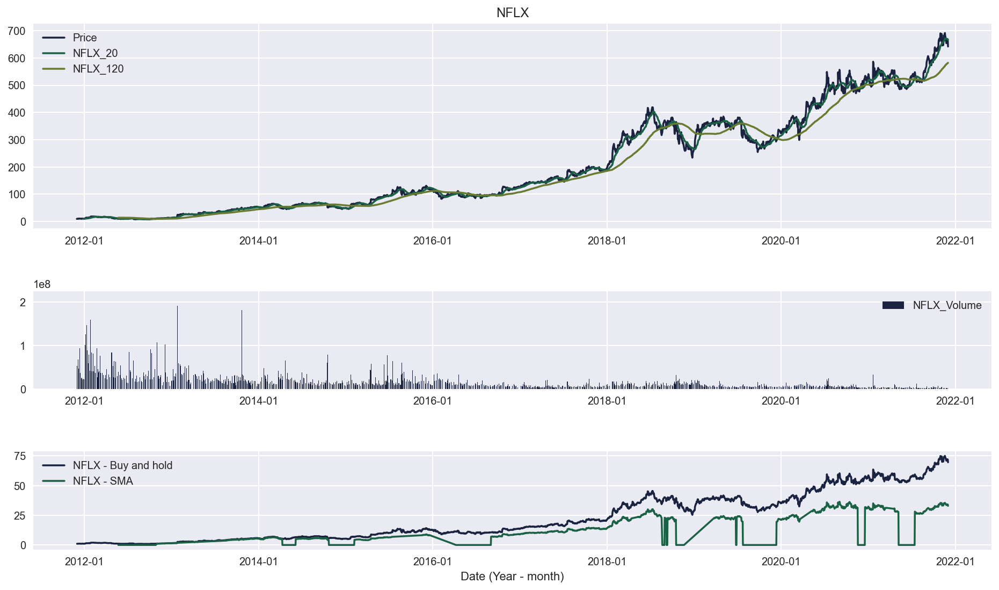



E


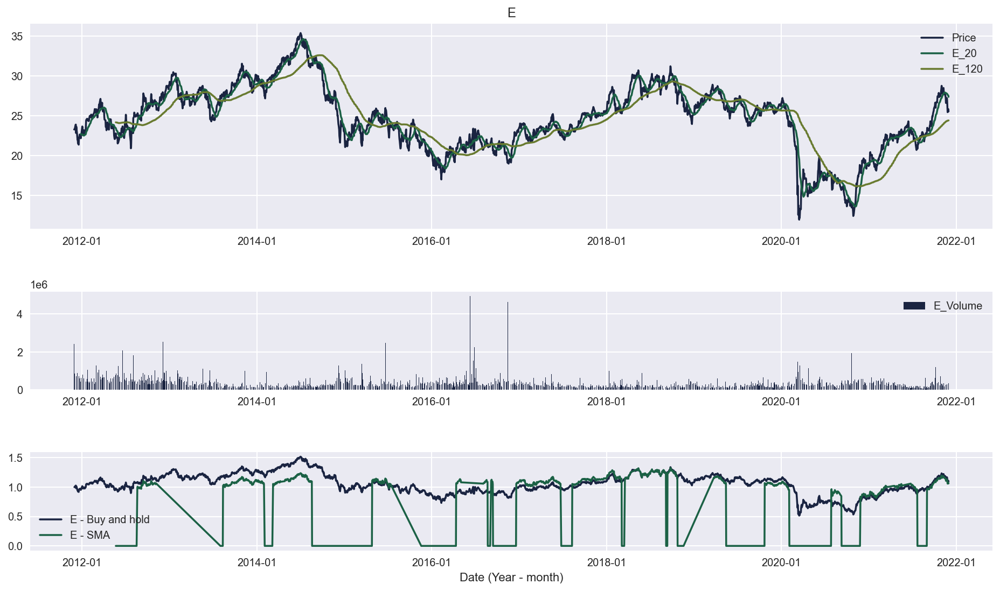



STLA


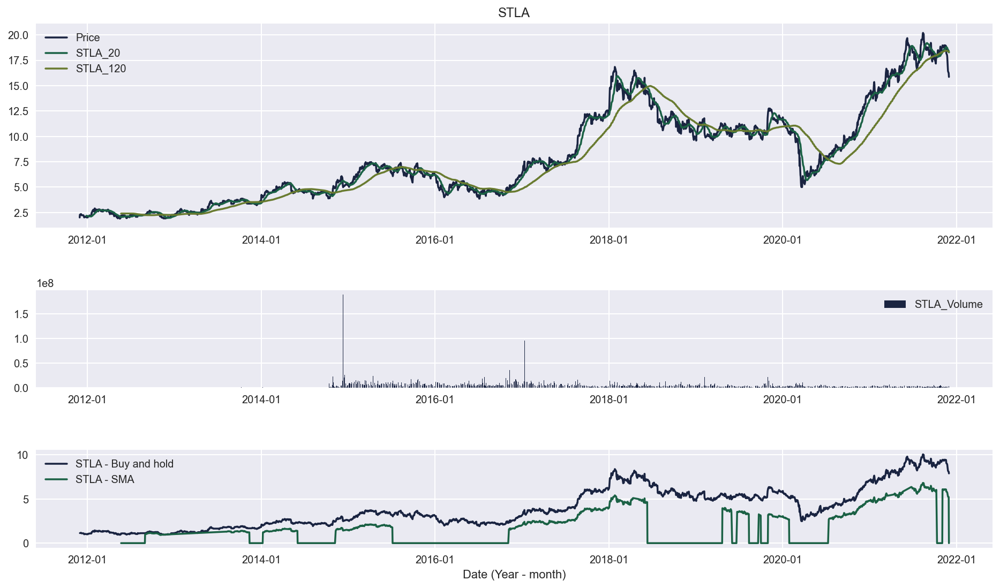



STM


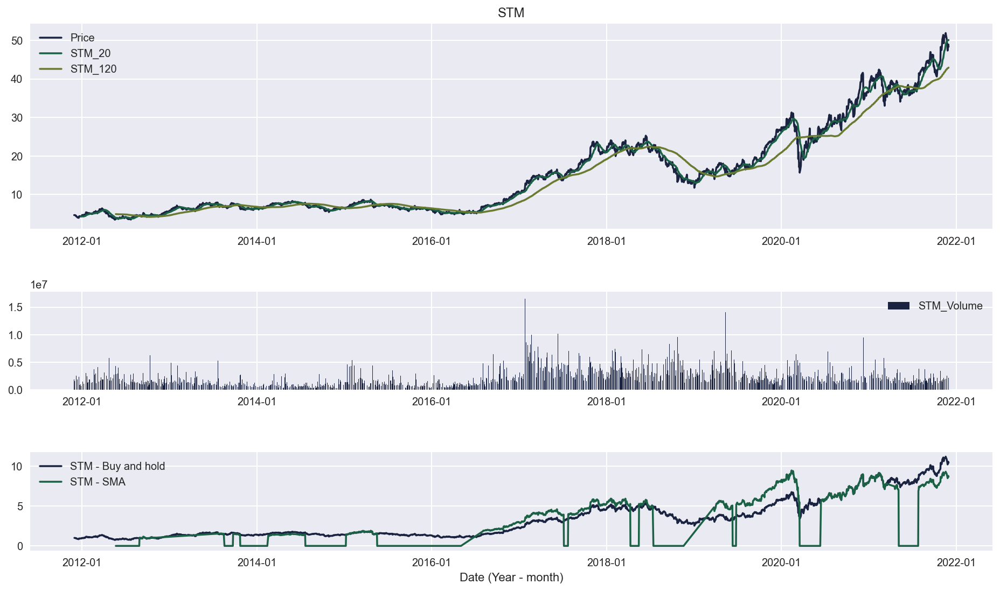



PFE


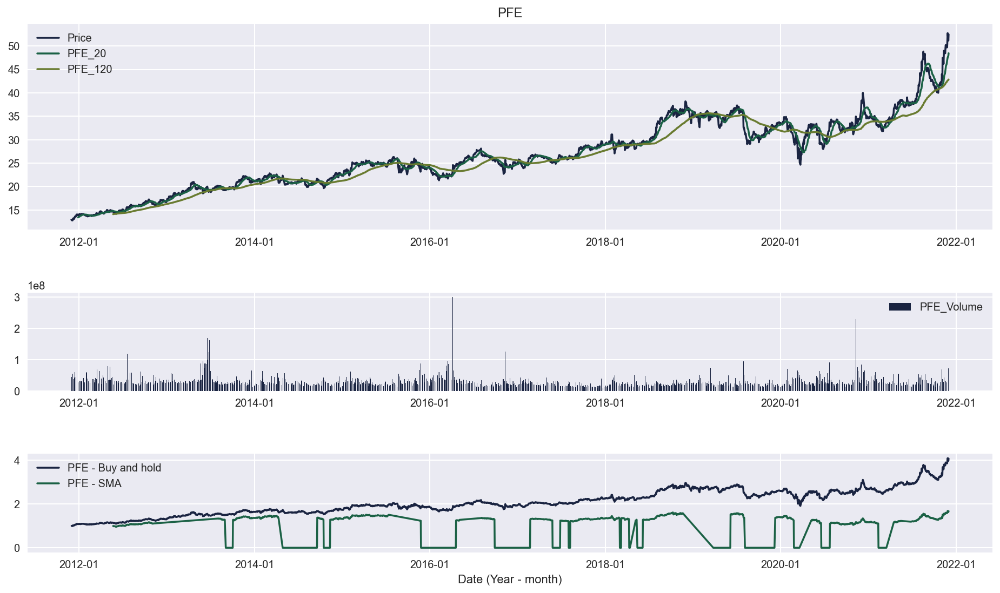



DIS


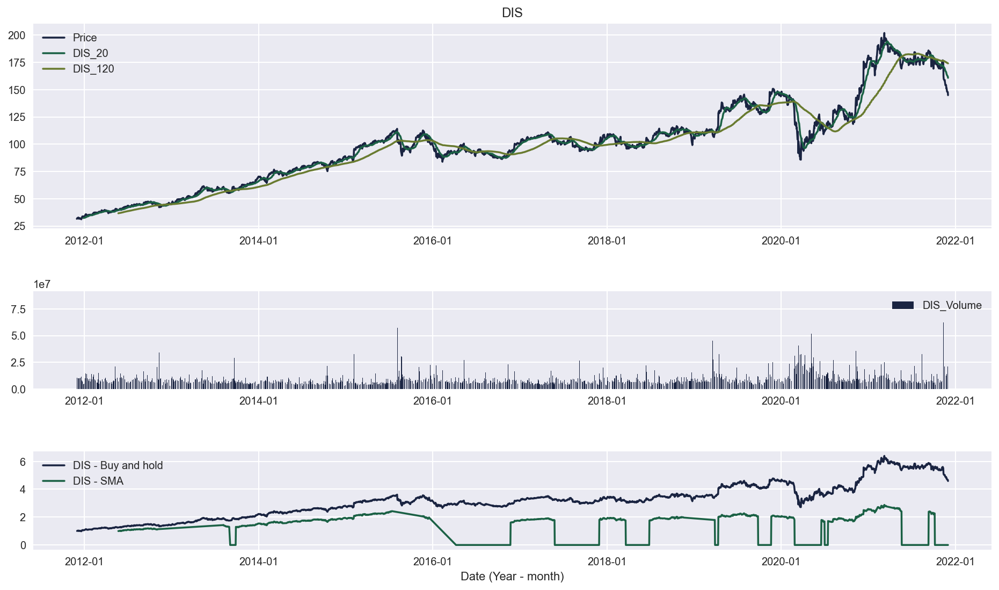



LHCG


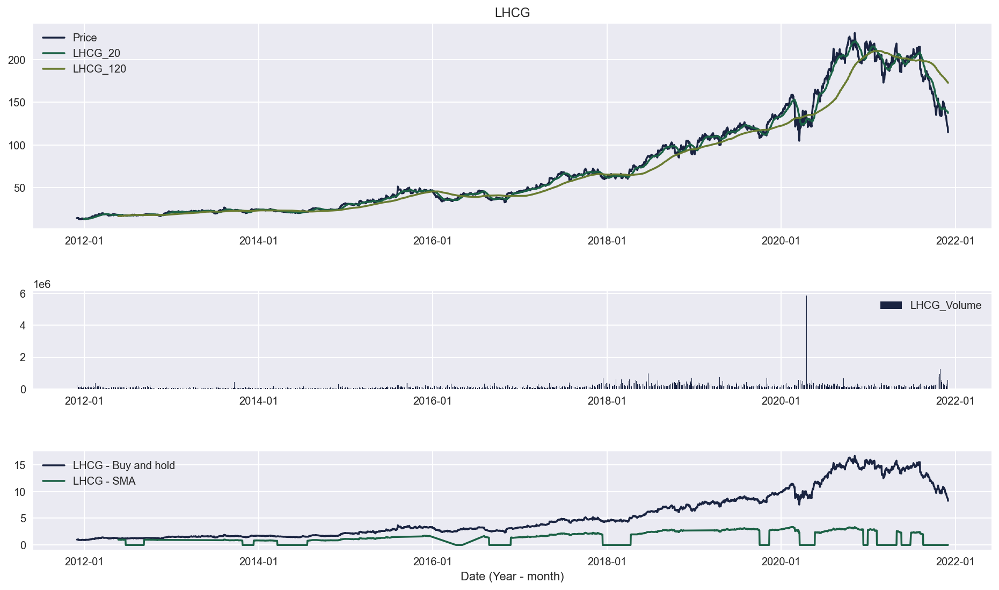



CVX


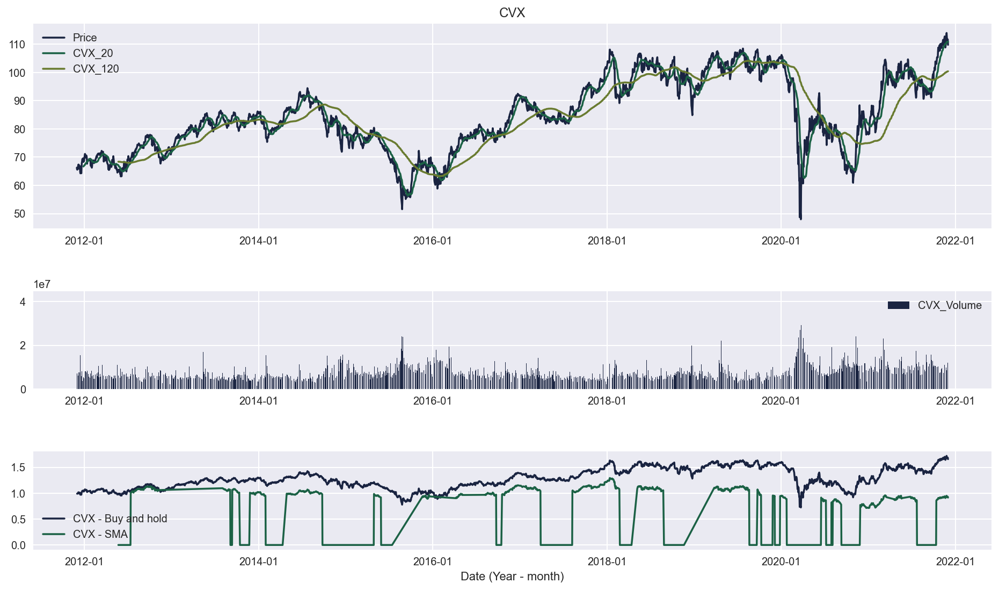

In [370]:
for stock in tickers[:-1]:
    
    print(stock)
    
    c20 = stock + "_20"
    c120 = stock + "_120"

    plt.figure(figsize=(16,9))
    ax1 = plt.subplot2grid((10,1), (0,0), rowspan = 4, colspan = 1, title = stock)
    ax2 = plt.subplot2grid((10,1), (5,0), rowspan = 2, colspan = 1, sharex = ax1)
    ax3 = plt.subplot2grid((10,1), (8,0), rowspan = 2, colspan = 1, sharex = ax1)
    ax1.plot(adj_close[stock], label = 'Price')
    ax1.plot(adj_close[c20], label = c20)
    ax1.plot(adj_close[c120], label = c120)

    ax2.bar(volume.index, volume[stock], label = f'{stock}_Volume')
    ax3.plot(adj_close[f'{stock}_Return'], label = f'{stock} - Buy and hold')
    ax3.plot(sma[f'{stock}_Return'], label = f'{stock} - SMA')
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    ax3.set_xlabel('Date (Year - month)')
    ax1.legend()
    ax2.legend()
    ax3.legend()
    plt.show()

    print()
    print()

Strategia con Medie Esponenziali

A livello generale, Sono gli ultimi periodi ad avere un peso maggiore nel nostro calcolo, andando a determinare quindi un valore molto più vicino alla situazione attuale piuttosto che a quanto accaduto sui mercati in passato.

In [371]:
ewm = pd.DataFrame()

for stock in tickers[:-1]:
    
    adj_close[f'{stock}_EWM12'] = adj_close[stock].ewm(span=12, adjust=False).mean()
    adj_close[f'{stock}_EWM26'] = adj_close[stock].ewm(span=26, adjust=False).mean()
    adj_close[f'{stock}_Invested_EWM'] = [1 if adj_close.loc[i, f'{stock}_EWM12'] > adj_close.loc[i, f'{stock}_EWM26'] 
                            else 0 for i in adj_close.index]
    temp = adj_close[adj_close[f'{stock}_Invested_EWM'] == 1]
    ewm[f'{stock}_Return'] = np.cumprod(temp[f'{stock}_Change'])

In [372]:
ewm['Return'] = ewm[[col for col in ewm.columns if ("_Return" in col)]].sum(axis=1)

ewm[[col for col in ewm.columns if ("_Return" in col)] + ['Return']]

,AAPL_Return,IBM_Return,GOOG_Return,AMZN_Return,NVDA_Return,AMD_Return,NFLX_Return,E_Return,STLA_Return,STM_Return,PFE_Return,DIS_Return,LHCG_Return,CVX_Return,Return
Date,,,,,,,,,,,,,,,
2011-12-01,1.014992,1.007713,1.023991,1.025170,1.012156,1.001757,1.040911,NaN,1.137778,1.001580,NaN,1.003905,1.002158,NaN,11.272112
2011-12-02,1.019623,1.008830,1.034986,1.019450,1.005758,NaN,1.028514,NaN,1.140000,NaN,NaN,1.021199,1.026619,NaN,9.304979
2011-12-05,1.028284,1.015106,1.043811,1.020542,0.990403,1.021261,1.086627,1.018614,1.166667,NaN,NaN,1.030404,1.011511,NaN,11.433230
2011-12-06,1.022894,1.026277,1.040675,0.998440,NaN,1.003530,1.055943,1.025448,1.166667,NaN,NaN,1.027336,0.981295,1.014977,11.363481
2011-12-07,1.018027,1.032181,1.040041,1.015757,NaN,1.014169,1.115140,1.026626,1.142222,NaN,1.011863,1.034867,1.015108,1.016534,12.482536
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-23,24.143710,NaN,10.687583,19.359756,89.932849,163.891798,89.075753,3.591112,NaN,21.822913,4.334933,NaN,NaN,3.416907,430.257315
2021-11-24,24.222988,NaN,10.684706,19.361757,92.561780,172.506180,89.651830,3.556619,NaN,21.617117,4.318808,NaN,NaN,3.443056,441.924839
2021-11-26,23.455641,NaN,10.399851,18.951584,89.244467,169.237521,90.652823,NaN,NaN,20.820216,4.582740,NaN,NaN,3.364317,430.709160


Confronto Buy And Hold vs MSA vs EWM

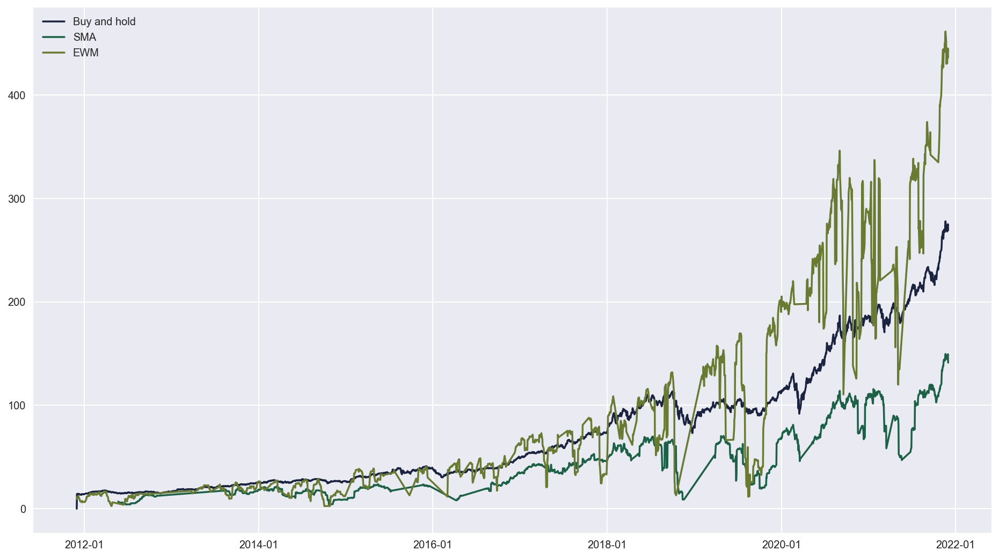

In [373]:
plt.figure(figsize=(16,9))

#ax3 = plt.subplot2grid((10,1), (8,0), rowspan = 2, colspan = 1, sharex = ax1)

plt.plot(adj_close['Buy_and_hold'], label = 'Buy and hold')
plt.plot(sma['Return'], label = 'SMA')
plt.plot(ewm['Return'], label = 'EWM')

plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

plt.legend()
plt.show()

### Relative Strength Index (RSI)

Il Relative Strength Index (RSI), o indice di forza relativa, è uno fra gli oscillatori più popolari dell'analisi tecnica e comunemente usati dai traders, in particolar modo da quelli che operano sui mercati dei futures. Fu ideato da John Welles Wilder, che lo pubblicò nel suo libro New Concepts in Technical Trading System nel 1978.

Si tratta di un indicatore di momentum, che riesce però ad ovviare ad alcuni problemi presenti nel momentum, nel Rate of change o in altri oscillatori di questo tipo. Questi generano notevoli complicazioni nella loro interpretazione, soprattutto quando si verificano bruschi movimenti del mercato causandone un'improvvisa inversione della linea. È quindi necessario, per una corretta e più comprensibile analisi, minimizzare queste distorsioni.

Il Relative Stregth Index, oltre a risolvere questo problema, presenta una banda d'oscillazione costante, da 0 a 100, che permette una comparazione dei valori con alcuni livelli costanti prestabiliti.

Va comunque sottolineato come il termine "indice di forza relativa" sia improprio, generando confusione anche in chi lo utilizza regolarmente. Infatti, con "forza relativa" solitamente si intende un grafico lineare che mette in rapporto due differenti entità, come per esempio un'azione e il suo indice di appartenenza, due indici settoriali, una materia prima e un cambio monetario, ecc. L'indice ideato da Wilder non misura alcuna di queste correlazioni, traendo quindi in inganno.

Fonte: Wikipedia

In [374]:
results = pd.DataFrame(columns = ['Ticker', 'RSI'])

for ticker in tickers:
    data = get_data(ticker)
    data = data.drop(columns = ['High', 'Low', 'Open', 'Close'])
    data['abs_change'] = data['Adj Close'].diff(1)
    data['up'] = [1 if data.loc[i, 'abs_change'] >  0 else 0 for i in data.index]
    data['down'] = [1 if data.loc[i, 'abs_change'] <  0 else 0 for i in data.index]
    data['positive_movement'] = data['up'] * data['abs_change']
    data['negative_movement'] = data['down'] * data['abs_change'] * - 1
    data['avg_gain'] = data['positive_movement'].rolling(14).mean()
    data['avg_loss'] = data['negative_movement'].rolling(14).mean()
    data['RS'] = data['avg_gain'] / data['avg_loss']
    data['RSI'] = 100 - (100 / (1 + data['RS']))
    
    new_row = {'Ticker': ticker, 'RSI': data['RSI'][-1]}
    results = results.append(new_row, ignore_index = True)
    

In [375]:
results

,Ticker,RSI
0,AAPL,73.653328
1,IBM,32.492955
2,GOOG,35.059652
3,AMZN,44.728185
4,NVDA,57.619444
5,AMD,58.346575
6,NFLX,44.717715
7,E,20.352264
8,STLA,10.025658
9,STM,38.535343


In [376]:
# FARE BACKTESTING con tutte le strategie del notebook analisi tecnica

# FORECASTING

In [377]:
df = get_data_merge_mode(tick_market_vol)



merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
merged UEC
merged ^GSPC
merged ^VIX
Collected df with shape: (2517, 102)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654801  180.066925  176.108994  176.453156  179.732315   
2011-12-01       11.829535  1

In [378]:
adj_close = df[[col for col in df.columns if "Adj" in col] ]

In [379]:
goog = adj_close[['Adj Close_GOOG']]
goog

,Adj Close_GOOG
Date,
2011-11-30,14.928793
2011-12-01,15.286951
2011-12-02,15.451086
2011-12-05,15.582842
2011-12-06,15.536017
...,...
2021-11-23,146.757004
2021-11-24,146.717499
2021-11-26,142.806000


In [380]:
def create_lags(data,col_name, lags = 2 ):
    data = data.copy()
    global cols
    cols = []
    for lag in range(1, lags + 1):
        col = 'lag_{}'.format(lag)
        data[col] = data[col_name].shift(lag)
        cols.append(col)
        
    data.dropna(inplace=True)
        
    return data

R2  0.9984727917103324
rmse:  1.2972089775700426


<AxesSubplot:xlabel='Date'>

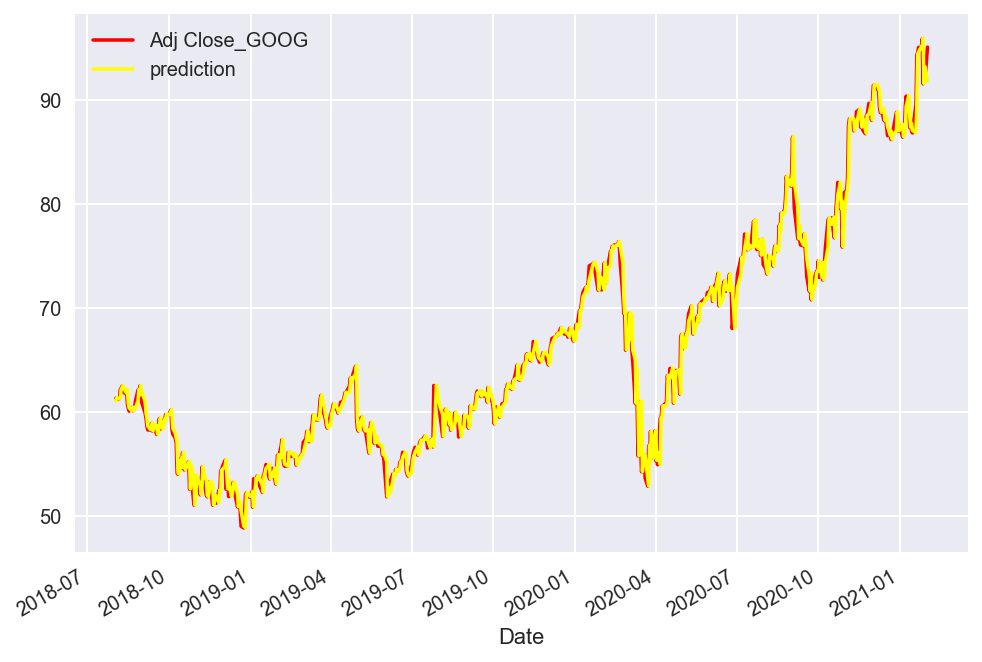

In [381]:
goog_lag = create_lags(goog, "Adj Close_GOOG", 1)

goog_lag

train, test, validate = split_custom(goog_lag)

features = [col for col in goog_lag.columns if "lag" in col ]
label = ["Adj Close_GOOG"]

X_train = train[features]
y_train = train[label]

X_test = test[features]
y_test = test[label]



model = LinearRegression()

result = model.fit(X_train, y_train)

print("R2 ", result.score(X_train, y_train))

rmse = sqrt(mean_squared_error(y_test, model.predict(X_test)))

print("rmse: ", rmse)


y_test["prediction"] = model.predict(X_test)

y_test.plot(color=["red", "yellow"])

In [382]:
train.corr()["Adj Close_GOOG"]

Adj Close_GOOG    1.000000
lag_1             0.999236
Name: Adj Close_GOOG, dtype: float64

In [387]:
class Model_handler:
    
    def __init__(self, df, col, job=None, features=None, label=None, verbose=False):
        
        self.models_mem = []
        
        self.verbose = verbose
        
        train, test, validate = self.split_custom(df)
        
        self.features = features
        self.label = label
        
        
        self.col = col
        
        self.train = train
        self.test = test
        self.validate = validate
        
        

        self.X_train = self.train[features]
        self.y_train = self.train[[label]]

        self.X_test = self.test[features]
        self.y_test = self.test[[label]]
        
        
        self.model_names = []
        self.model_params = []
        self.train_best_scores = []
        self.test_scores = []
        self.r2_test_score = []
        self.yields_scores = []
        self.train_test_deltas = []
        self.market = []
        self.strategy = []
        
        
        
        print("*"*100)
        print("X_train")
        print(self.X_train[0:5])
        
        print("*"*100)
        print("y_train")
        print(self.y_train[0:5])
        print("*"*100)
        
    def split_custom(self, df):
        # 80 train, 30 test, 10 validation: tot = 120
        #80/120
        #30/120 
        #10/120

        n = df.shape[0]

        train_size = round(n*80/120)
        test_size = round(n*30/120)
        val_size = round(n*10/120)

        train =  df.iloc[:train_size]
        test = df.iloc[train_size: train_size + test_size]
        validate = df.iloc[train_size + test_size:]
    
        return train, test, validate
    
        
    def get_returns_evaluation(self, data, position):
        print(position)
        col=self.col
        data_copy = data.copy()

        returns = 'returns'
        strategy = 'strategy'

        #data_copy[returns] = np.log(data_copy[col] / data_copy[col].shift(1))
        data_copy[strategy] = data_copy[position] * data_copy[returns] #

        data_copy.dropna(inplace=True)

        # Cumulative Yields:
        print("Cumulative Yields:")
        perf = np.exp(data_copy[[returns, strategy]].sum())
        print(perf)

        print("Volatility:")
        vol = data_copy[[returns, strategy]].std() * 252 ** 0.5
        print(vol)

        results = {'MARKET':perf['returns'],
                'STRATEGY': perf['strategy'],
                'OUT':perf['strategy']-perf['returns']}

        
    
        return results

    def grid_search_handler(self, model, grid, score):
        print(f"Tuning {model}")
        
        if grid == None:
            model_result = model.fit(self.X_train, self.y_train)
            
            best_score = model.score(self.X_train, self.y_train)
            best_params = model.get_params()
            
            prediction_col = f"{model}_prediction" 

            self.test[prediction_col] = model.predict(self.X_test)


            
        else:
        
            cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)

            grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring=score, verbose=0)
                    

            grid_result = grid_search.fit(self.X_train, self.y_train)

            best_score = grid_result.best_score_
            best_params = grid_result.best_params_

            prediction_col = f"{model}_prediction" 

            self.test[prediction_col] = grid_search.predict(self.X_test)

        test_score = accuracy_score(self.y_test, self.test[prediction_col])

        delta_train_test = best_score - test_score

        results = self.get_returns_evaluation(self.test, prediction_col)

        self.model_names.append(str(model))
        self.model_params.append(best_params)
        self.train_best_scores.append(best_score)
        self.test_scores.append(test_score)
        self.market.append(results['MARKET'])
        self.strategy.append(results['STRATEGY'])
        self.yields_scores.append(results['OUT'])
        self.train_test_deltas.append(delta_train_test)
        
    def linear_classification(self, model):
        
        train = self.train.copy()
        test = self.test.copy()
        
        lnrg = model.fit(self.X_train, self.train[self.col])
        
        #####
        
        train["predictions"] = lnrg.predict(self.X_train)

        train['predicted_returns'] = np.log(train["predictions"] / train["predictions"].shift(1))

        train.dropna(inplace=True)

        train['position'] = np.sign(train['predicted_returns']).astype(int)        

        train_accuracy = accuracy_score(train['direction'], train['position'])
        
        #####

        test["predictions"] = lnrg.predict(self.X_test)

        test['predicted_returns'] = np.log(test["predictions"] / test["predictions"].shift(1))

        test.dropna(inplace=True)

        test['position'] = np.sign(test['predicted_returns']).astype(int)       

        test_accuracy = accuracy_score(test['direction'], test['position'])
        

        test['strategy'] = test['position'] * test['returns']

        perf = np.exp(test[['returns', 'strategy']].sum())
        
        results = {'MARKET':perf['returns'],
                'STRATEGY': perf['strategy'],
                'OUT':perf['strategy']-perf['returns']}

        
        
        delta_train_test = train_accuracy - test_accuracy
        
        self.model_names.append(str(model))
        self.model_params.append(None)
        self.train_best_scores.append(train_accuracy)
        self.test_scores.append(test_accuracy)
        self.market.append(results['MARKET'])
        self.strategy.append(results['STRATEGY'])
        self.yields_scores.append(results['OUT'])
        self.train_test_deltas.append(delta_train_test)
        
    def build_nn(self, model):
        #np.random.seed(100)
        #tf.random.set_seed(100)
        #model = Sequential()
        model.add(Dense(16, activation='relu', input_dim=self.X_train.shape[1]))
        model.add(Dense(16, activation='relu'))
        model.add(Dense(1, activation='sigmoid'))
        model.compile(loss='binary_crossentropy', optimizer='rmsprop',
                      metrics=['accuracy'])
        return model

    def nn_preparation_and_fit(self, model):
        
        test = self.test.copy()
        
        scale = StandardScaler()
        X_train = scale.fit_transform(self.X_train)

        #This is the change
        X_test = scale.transform(self.X_test)

        log = model.fit(X_train, self.y_train, epochs=50, verbose=False)
        
        print(model.evaluate(X_train, self.y_train))   
        
        pred = np.where(model.predict(X_test) > 0.5, 1, 0) 
        #pred[:10].flatten()
              
        test['posizione'] = np.where(pred > 0, 1, -1)  
              
        test['strategy'] = test['posizione'] * test['returns']
              
        perf = np.exp(test[['returns', 'strategy']].sum())
              
        results = {'MARKET':perf['returns'],
                'STRATEGY': perf['strategy'],
                'OUT':perf['strategy']-perf['returns']}
              
              
        self.model_names.append(str(model))
        self.model_params.append(None)
        self.train_best_scores.append(None)
        self.test_scores.append(None)
        self.market.append(results['MARKET'])
        self.strategy.append(results['STRATEGY'])
        self.yields_scores.append(results['OUT'])
        self.train_test_deltas.append(None)
        
        

    def classifier_pipeline(self, models, score='accuracy'):


        for model in models:

            if isinstance(model, LogisticRegression):

                solvers = ['liblinear', 'sag', 'saga']
                penalty = ['l2', 'l1', 'elasticnet', 'none'] 
                c_values = [100, 10, 1.0, 0.1, 0.01]
                grid = dict(solver=solvers,penalty=penalty,C=c_values)
                
                grid = None
                
                self.grid_search_handler(model, grid, score)
                
            elif isinstance(model, LinearRegression):

                grid = None
                
                self.linear_classification(model)
                
            elif isinstance(model, GaussianNB):                
                
                grid = None
                self.grid_search_handler(model, grid, score)
            
                
            elif isinstance(model, SVC):
                
                grid = {'kernel' : ('linear', 'rbf'),
                         'C' : [0.1, 1.0, 10],
                         'gamma' : ('auto', 'scale')
                       }
                grid = None
                
                self.grid_search_handler(model, grid, score)
                
            elif isinstance(model, MLPClassifier):
                
                grid = {
                    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
                    'activation': ['tanh', 'relu'],
                    'solver': ['sgd', 'adam'],
                    'alpha': [0.0001, 0.05],
                    'learning_rate': ['constant','adaptive']
                }
                
                grid = {
                    'hidden_layer_sizes': [(100,)],
                    'activation': ['relu'],
                    'solver': ['adam'],
                    'alpha': [0.0001],
                    'learning_rate': ['constant']
                }
                
                grid = None
                
                self.grid_search_handler(model, grid, score)
            
            elif isinstance(model, Sequential):
                model = self.build_nn(model)
                self.nn_preparation_and_fit(model)
        
                
            else:
                print("No Settings found for this model!")          





        model_df = pd.DataFrame({
            "Model": self.model_names,
            "Hyperparams": self.model_params,
            f"Train_best_{score}": self.train_best_scores,
            f"Test_{score}": self.test_scores,
            "Market": self.market,
            "Strategy returns": self.strategy,
            "Strategy_Market_delta": self.yields_scores,
            "Train_test_delta": self.train_test_deltas
        })

        return model_df
    
    def sarimax_grid_search(self, dataframe, test_m, s=12):
        p = d = q = range(2)
        param_combinations = list(product(p, d, q))
        lowest_aic, pdq, pdqs = None, None, None
        total_iterations = 0
        for order in param_combinations:
            for (p, q, d) in param_combinations:
                seasonal_order = (p, q, d, s)
                total_iterations += 1
                try:
                    model = SARIMAX(dataframe, order = order,
                                   seasonal_order= seasonal_order,
                                   enforce_stationarity=False,
                                   enforce_invertibility=False,
                                   disp = False
                                   )
                    model_result = model.fit(maxiter=200, disp=False)

                    if not lowest_aic or model_result.aic < lowest_aic:
                        lowest_aic = model_result.aic
                        pdq, pdqs = order, seasonal_order

                except Exception as ex:
                    print("######")
                    print(ex)
                    continue

        
        best_model = SARIMAX(dataframe, order = pdq,
                                   seasonal_order= pdqs,
                                   enforce_stationarity=False,
                                   enforce_invertibility=False,
                                   disp = False
                                   )
        best_model_result = best_model.fit(maxiter=200, disp=False)
        
        best_params = {
            "pdq": pdq,
            "pdqs": pdqs            
        }
        
        test_m['prediction'] = best_model_result.predict(start=test_m.index[0],
                                                         end=test_m.index[test_m.shape[0]-1],
                                                         dynamic=True)

        rmse = sqrt(mean_squared_error(test_m[self.col], test_m['prediction']))
        
        print("######")
        print(rmse)
        print("######")
        
        
        self.model_names.append("SARIMAX")
        self.model_params.append(best_params)
        self.R2_test_score(None)
        self.train_best_scores.append(None)
        self.test_scores.append(rmse)
        self.train_test_deltas.append(None)
        
    def grid_search_reg_handler(self, model, grid=None, score='r2'):
        
        if self.verbose:
            print(self.X_train.shape)
            print(self.y_train.shape)
            print(self.X_test.shape)
            print(self.y_test.shape)
        
        print("- ", str(model))
        
        if grid == None:
            result = model.fit(self.X_train, self.y_train)
            
            train_score = result.score(self.X_train, self.y_train)
            print(train_score)
            
            best_params = model.get_params()
            
            predictions = model.predict(self.X_test)          
          
            
            self.model_params.append(best_params)
            
            self.models_mem.append((str(model), model))
            
            

           

            
        else:

            gs = GridSearchCV(model, grid, n_jobs=-1, verbose=0, cv=5, scoring=score)
            
            

            grid_result = gs.fit(self.X_train, self.y_train)

            train_score = grid_result.best_score_
            
            best_params = grid_result.best_params_          


            predictions = gs.predict(self.X_test)
            
            
            self.model_params.append(best_params)
            
            self.models_mem.append((str(model), gs))
        
        
        rmse = sqrt(mean_squared_error(self.y_test, predictions))
        
        r2_test = r2_score(self.y_test, predictions)
        print(r2_test)
        
        self.model_names.append(str(model))
        self.train_best_scores.append(train_score)
        self.test_scores.append(rmse)
        self.r2_test_score.append(r2_test)
        self.train_test_deltas.append(train_score - r2_test)
        
        
        
    def plot_models(self):
        
        for model in self.models_mem:
            
            self.y_test[model[0]] = model[1].predict(self.X_test)
            
            print("*"*100)
            print(self.y_test.columns)
            print("*"*100)
        
        self.y_test.plot(figsize=(20, 12))
        plt.show()
            
            
    
    def regressor_pipeline(self, models, tuning=None):
        print("The Following regressors model will be trained: ")
        
        for model in models:
            if model == "SARIMAX":
                print("- ", model)
                print("Data will be grouped by monthly frequency for SARIMAX predictions")
                train = self.train[self.col]
                test = self.test[self.col]
                train_m = train.groupby(pd.Grouper(freq='M')).mean()
                test_m = test.groupby(pd.Grouper(freq='M')).mean()
                try:
                    self.sarimax_grid_search(train_m, test_m, 12)
                except Exception as ex:
                    print(ex)
                continue
                    
            elif isinstance(model, LinearRegression):
                grid = None
                    
            elif isinstance(model, SVR):
                
                grid = {'kernel' : ['linear'],
                        'C' : [1000.0, 1e3], 
                        'gamma' : ('auto','scale')
                       }
                model = SVR(kernel='linear')
                
            elif isinstance(model, MLPRegressor):                
                grid = {'activation': ['identity', 'logistic', 'tanh', 'relu']}

            
            else:
                raise Exception("Unknown model!")                

            
            
            
            try:
                if tuning == None:
                    grid = tuning
                self.grid_search_reg_handler(model, grid)
            except Exception as ex:
                print(ex)  
                
                
                
        
        
        model_df = pd.DataFrame({
            "Model": self.model_names,
            "Hyperparams": self.model_params,
            "R2_Train_best_score": self.train_best_scores,
            "R2_test_score":self.r2_test_score,            
            "R2_Train_test_delta": self.train_test_deltas,
            "Test_RMSE": self.test_scores
        })
        
        if model != "SARIMAX":
        
            self.plot_models()

        return model_df
                
                
                
                
        

In [388]:
df = get_data_merge_mode(all_var)

merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
merged UEC
merged ^GSPC
merged ^VIX
merged ^IRX
Collected df with shape: (2517, 108)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654806  180.066925  176.108994  176.453156  179.732315   
2011-12-01       

In [389]:
def create_lags(data,col_name, lags = 2 ):
    data = data.copy()
    global cols
    cols = []
    for lag in range(1, lags + 1):
        col = 'lag_' + col_name + str(lag)
        data[col] = data[col_name].shift(lag)
        cols.append(col)
        
    data.dropna(inplace=True)
        
    return data

# Regression Task

In [ ]:
df_goog = df[[col for col in df.columns if ("GOOG" in col or "VIX" in col or "^GSPC" in col or "^IRX" in col)] ]

df_goog

df_goog['returns'] = np.log(df_goog["Adj Close_GOOG"] / df_goog["Adj Close_GOOG"].shift(1))

df_goog.dropna(inplace=True)

df_goog['direction'] = np.sign(df_goog['returns']).astype(int)

goog_lag = create_lags(df_goog, "Adj Close_GOOG", 1)

#goog_lag = create_lags(df_goog, 'Adj Close_^IRX', 1)

#goog_lag = create_lags(goog_lag, "Volume_GOOG", 1)

goog_lag = create_lags(goog_lag, "Adj Close_^VIX", 1)
#goog_lag = create_lags(goog_lag, "Volume_^VIX", 5)

goog_lag = create_lags(goog_lag, "direction", 1)

goog_lag = create_lags(goog_lag, "Adj Close_^GSPC", 1)
#goog_lag = create_lags(goog_lag, "Volume_^GSPC", 5)

features = [col for col in goog_lag.columns if "lag" in col ]
print(features)


mh = Model_handler(df=goog_lag, col="Adj Close_GOOG", features=features, label="Adj Close_GOOG")



mh.regressor_pipeline([LinearRegression(), MLPRegressor()], None)

In [ ]:
mh.y_test.head()

In [ ]:
goog_lag[features + ["Adj Close_GOOG"]].corr()["Adj Close_GOOG"]

In [ ]:

sns.regplot(x="Adj Close_GOOG", y='lag_Adj Close_GOOG1', data=goog_lag)
plt.title("Linearità Adj Close, lag_1")
plt.show()

In [ ]:
def split_custom(df):
    # 80 train, 30 test, 10 validation: tot = 120
    #80/120
    #30/120 
    #10/120

    n = df.shape[0]

    train_size = round(n*80/120)
    test_size = round(n*30/120)
    val_size = round(n*10/120)

    train =  df.iloc[:train_size]
    test = df.iloc[train_size: train_size + test_size]
    validate = df.iloc[train_size + test_size:]

    return train, test, validate


def sarimax_grid_search(dataframe, test_m, s=12):
        p = d = q = range(2)
        param_combinations = list(product(p, d, q))
        lowest_aic, pdq, pdqs = None, None, None
        total_iterations = 0
        for order in param_combinations:
            for (p, q, d) in param_combinations:
                seasonal_order = (p, q, d, s)
                total_iterations += 1
                try:
                    model = SARIMAX(dataframe, order = order,
                                   seasonal_order= seasonal_order,
                                   enforce_stationarity=False,
                                   enforce_invertibility=False,
                                   disp = False
                                   )
                    model_result = model.fit(maxiter=200, disp=False)

                    if not lowest_aic or model_result.aic < lowest_aic:
                        lowest_aic = model_result.aic
                        pdq, pdqs = order, seasonal_order

                except Exception as ex:
                    print("######")
                    print(ex)
                    continue

        
        best_model = SARIMAX(dataframe, order = pdq,
                                   seasonal_order= pdqs,
                                   enforce_stationarity=False,
                                   enforce_invertibility=False,
                                   disp = False
                                   )
        best_model_result = best_model.fit(maxiter=200, disp=False)
        
        best_params = {
            "pdq": pdq,
            "pdqs": pdqs            
        }
        
        test_m['prediction'] = best_model_result.predict(start=test_m.index[0],
                                                         end=test_m.index[test_m.shape[0]-1],
                                                         dynamic=True)

        rmse = sqrt(mean_squared_error(test_m["Adj Close_GOOG"], test_m['prediction']))
        
        print("######")
        print("rmse", rmse)
        print("######")
        
        test_m.plot(figsize=(22, 10))
        
        


train, test, validate = split_custom(df_goog[["Adj Close_GOOG"]].groupby(pd.Grouper(freq='M')).mean())



sarimax_grid_search(train, test, 12)


# CLASSIFICATION TASK

In [ ]:
df_goog = df[[col for col in df.columns if ("GOOG" in col or "VIX" in col or "^GSPC" in col or "^IRX" in col)] ]

df_goog

df_goog['returns'] = np.log(df_goog["Adj Close_GOOG"] / df_goog["Adj Close_GOOG"].shift(1))

df_goog.dropna(inplace=True)

df_goog['direction'] = np.sign(df_goog['returns']).astype(int)

goog_lag = create_lags(df_goog, "Adj Close_GOOG", 1)

goog_lag = create_lags(df_goog, 'Adj Close_^IRX', 1)

goog_lag = create_lags(goog_lag, "Volume_GOOG", 1)

goog_lag = create_lags(goog_lag, "Adj Close_^VIX", 1)
goog_lag = create_lags(goog_lag, "Volume_^VIX", 1)

goog_lag = create_lags(goog_lag, "direction", 1)

goog_lag = create_lags(goog_lag, "Adj Close_^GSPC", 1)
goog_lag = create_lags(goog_lag, "Volume_^GSPC", 5)

features = [col for col in goog_lag.columns if "lag" in col ]
print(features)

label = "direction"


mh = Model_handler(df=goog_lag, col="Adj Close_GOOG", features=features, label=label)



#mh.regressor_pipeline([LinearRegression(), MLPRegressor()], None)

df_model = mh.classifier_pipeline([LinearRegression(), 
                                 MLPClassifier(), 
                                 GaussianNB(), 
                                 SVC(), 
                                 LogisticRegression(), 
                                 Sequential()])

df_model.head(10)

# BACKTESTING E PREVISIONE PER TUTTI I TITOLI

In [ ]:
df_list = []

for ticker in tickers:

    df_goog = df[[col for col in df.columns if (ticker in col or "VIX" in col or "^GSPC" in col or "^IRX" in col)] ]

    df_goog

    df_goog['returns'] = np.log(df_goog[f"Adj Close_{ticker}"] / df_goog[f"Adj Close_{ticker}"].shift(1))

    df_goog.dropna(inplace=True)

    df_goog['direction'] = np.sign(df_goog['returns']).astype(int)

    goog_lag = create_lags(df_goog, f"Adj Close_{ticker}", 1)

    goog_lag = create_lags(df_goog, 'Adj Close_^IRX', 1)

    goog_lag = create_lags(goog_lag, f"Volume_{ticker}", 1)

    goog_lag = create_lags(goog_lag, "Adj Close_^VIX", 1)
    goog_lag = create_lags(goog_lag, "Volume_^VIX", 1)

    goog_lag = create_lags(goog_lag, "direction", 1)

    goog_lag = create_lags(goog_lag, "Adj Close_^GSPC", 1)
    goog_lag = create_lags(goog_lag, "Volume_^GSPC", 5)

    features = [col for col in goog_lag.columns if "lag" in col ]
    print(features)

    label = "direction"


    mh = Model_handler(df=goog_lag, col=f"Adj Close_{ticker}", features=features, label=label)



    #mh.regressor_pipeline([LinearRegression(), MLPRegressor()], None)

    df_model = mh.classifier_pipeline([LinearRegression(), 
                                     MLPClassifier(), 
                                     GaussianNB(), 
                                     SVC(), 
                                     LogisticRegression(), 
                                     Sequential()])

    print(df_model.head(10))
    df_model["ASSET"] = ticker
    df_list.append(df_model)

# RICERCA DELLA PREVISIONE MIGLIORE PER OGNI TITOLO

In [ ]:
for df_model in df_list:
    print(df_model["ASSET"][0])
    display(df_model.loc[[df_model['Strategy_Market_delta'].idxmax()]])

In [ ]:
goog_lag = create_lags(goog, "Adj Close_GOOG", 1)

train, test, validate = split_custom(goog_lag)

features = [col for col in goog_lag.columns if "lag" in col ]
label = ["Adj Close_GOOG"]

X_train = train[features]
y_train = train[label]

X_test = test[features]
y_test = test[label]

X_val = validate[features]
y_val = validate[label]


nn = MLPRegressor(random_state=1, max_iter=500) #.fit(X_train, y_train)

#predictions = nn.predict(X_test)

#, 0.00001
grid = {'activation': ['identity', 'logistic', 'tanh', 'relu']}
# ,cv=3

gs = GridSearchCV(nn, grid, n_jobs=-1, verbose=1)
                     



grid_result = gs.fit(X_train, y_train)

best_score = grid_result.best_score_
best_params = grid_result.best_params_

print(best_score)
print(best_params)
#
#
predictions = gs.predict(X_val)
#
#
#
rmse = sqrt(mean_squared_error(y_val, predictions))
#
print("rmse: ", rmse)


y_val["prediction"] = predictions

y_val.plot(color=["red", "yellow"])

In [ ]:
goog_lag

In [ ]:
df_goog = df[[col for col in df.columns if "GOOG" in col] ]

df_goog

df_goog['returns'] = np.log(df_goog["Adj Close_GOOG"] / df_goog["Adj Close_GOOG"].shift(1))

df_goog.dropna(inplace=True)

df_goog['direction'] = np.sign(df_goog['returns']).astype(int)


#df_goog_trend = df_goog.join(auto_dailydata('GOOG'))


df_goog

In [ ]:
test

In [ ]:
goog_lag = create_lags(df_goog, "Adj Close_GOOG", 2)

train, test, validate = split_custom(goog_lag)

features = [col for col in goog_lag.columns if "lag" in col ]
label = ["direction"]

X_train = train[features]
y_train = train[label]

X_test = test[features]
y_test = test[label]

X_val = validate[features]
y_val = validate[label]




log_r = LogisticRegression()

solvers = ['liblinear', 'sag', 'saga']
penalty = ['l2', 'l1', 'elasticnet', 'none']
c_values = [100, 10, 1.0, 0.1, 0.01]
grid = dict(solver=solvers,penalty=penalty,C=c_values)


cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)

grid_search = GridSearchCV(estimator=log_r, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy')


grid_result = grid_search.fit(X_train, y_train)

best_score = grid_result.best_score_
best_params = grid_result.best_params_

print(best_score)
print(best_params)

predictions = grid_result.predict(X_test)

test_acc = accuracy_score(y_test, predictions)
print(test_acc)

col="GOOG"

test['position'] =grid_result.predict(X_test)

test


returns = 'returns'
strategy = 'strategy'

#test[returns] = np.log(data_copy[col] / data_copy[col].shift(1))
test[strategy] = test['position'] * test['returns']

test.dropna(inplace=True)

# Cumulative Yields:
print("Cumulative Yields:")
perf = np.exp(test[['returns', strategy]].sum())
print(perf)

print("Volatility:")
vol = test[['returns', strategy]].std() * 252 ** 0.5
print(vol)

results = {'MARKET':perf['returns'],
        'STRATEGY': perf[strategy],
        'OUT':perf[strategy]-perf['returns']}

for r in results:
    print(f"{r}: {results[r]}")





"""
clf = log_r.fit(X_train, y_train)

train_acc = log_r.score(X_train, y_train)
print(train_acc)

predictions = clf.predict(X_test)

test_acc = accuracy_score(y_test, predictions)
print(test_acc)

"""

In [ ]:
test

In [ ]:
test['strategy'] = test['position'] * test['returns']

test

In [ ]:
goog_lag = create_lags(goog, "Adj Close_GOOG", 100)

train, test, validate = split_custom(goog_lag)

features = [col for col in goog_lag.columns if "lag" in col ]
label = ["Adj Close_GOOG"]

X_train = train[features]
y_train = train[label]

X_test = test[features]
y_test = test[label]

X_val = validate[features]
y_val = validate[label]


model = LinearRegression()

lnrg = model.fit(X_train, y_train)

print(model.score(X_train, y_train))

predictions = lnrg.predict(X_test)

print(r2_score(y_test, predictions))

y_test["predictions"] = predictions

y_test['returns'] = np.log(y_test["Adj Close_GOOG"] / y_test["Adj Close_GOOG"].shift(1))


y_test['predicted_returns'] = np.log(y_test["predictions"] / y_test["predictions"].shift(1))

y_test.dropna(inplace=True)

y_test['direction'] = np.sign(y_test['returns']).astype(int)
y_test['position'] = np.sign(y_test['predicted_returns']).astype(int)

print(accuracy_score(y_test['direction'], y_test['position']))

y_test['strategy'] = y_test['position'] * y_test['returns']

perf = np.exp(y_test[['returns', 'strategy']].sum())

print(perf)

merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
Collected df with shape: (2517, 84)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654808  180.066925  176.108994  176.453156  179.732315   
2011-12-01       11.829537  181.634796  178.556412  178.785858  18

,High_AAPL,Low_AAPL,Open_AAPL,Close_AAPL,Volume_AAPL,Adj Close_AAPL,High_IBM,Low_IBM,Open_IBM,Close_IBM,...,Open_LHCG,Close_LHCG,Volume_LHCG,Adj Close_LHCG,High_CVX,Low_CVX,Open_CVX,Close_CVX,Volume_CVX,Adj Close_CVX
Date,,,,,,,,,,,,,,,,,,,,,
2011-11-30,13.652857,13.510714,13.617500,13.650000,405938400.0,11.654808,180.066925,176.108994,176.453156,179.732315,...,12.850000,13.900000,364900,13.900000,102.820000,100.110001,100.500000,102.820000,13373200.0,66.285385
2011-12-01,13.892857,13.598214,13.662143,13.854643,387181200.0,11.829537,181.634796,178.556412,178.785858,181.118546,...,13.840000,13.930000,218900,13.930000,103.000000,100.959999,102.820000,101.830002,7007200.0,65.647141
2011-12-02,14.058214,13.877857,13.922500,13.917857,379055600.0,11.883509,182.915863,181.118546,181.567871,181.319305,...,14.000000,14.270000,173900,14.270000,103.190002,101.500000,103.040001,101.690002,6638100.0,65.556900
2011-12-05,14.157500,13.942500,14.053214,14.036071,357210000.0,11.984447,185.095596,182.007645,182.772461,182.447418,...,14.490000,14.060000,134400,14.060000,104.000000,102.040001,103.580002,102.820000,6121800.0,66.285385
2011-12-06,14.093929,13.906429,14.018214,13.962500,283598000.0,11.921627,185.019119,181.950287,182.265778,184.455063,...,14.020000,13.640000,146800,13.640000,104.730003,102.839996,103.099998,104.360001,7445000.0,67.278183
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-25,91.250000,89.392502,90.175003,91.209999,137522400.0,89.959900,113.967499,110.994263,111.625237,113.795410,...,165.919998,172.100006,347800,172.100006,89.510002,87.160004,87.309998,89.209999,7398000.0,80.102196
2020-06-26,91.330002,88.254997,91.102501,88.407501,205256800.0,87.195808,113.757172,111.147224,113.059273,112.036331,...,171.179993,171.929993,519600,171.929993,88.830002,86.180000,88.779999,86.459999,13766000.0,77.632957
2020-06-29,90.542503,87.820000,88.312500,90.445000,130646000.0,89.205399,114.512428,112.208412,112.791588,114.483749,...,172.259995,172.190002,273200,172.190002,88.570000,86.599998,86.910004,87.669998,7022200.0,78.719421


,High_AAPL,Low_AAPL,Open_AAPL,Close_AAPL,Volume_AAPL,Adj Close_AAPL,High_IBM,Low_IBM,Open_IBM,Close_IBM,...,Open_LHCG,Close_LHCG,Volume_LHCG,Adj Close_LHCG,High_CVX,Low_CVX,Open_CVX,Close_CVX,Volume_CVX,Adj Close_CVX
Date,,,,,,,,,,,,,,,,,,,,,
2020-07-02,92.617500,90.910004,91.962502,91.027496,114041600.0,89.779892,116.080307,114.015297,114.426384,114.435944,...,179.000000,177.179993,182600,177.179993,90.360001,88.160004,89.370003,88.309998,5832800.0,79.294083
2020-07-06,93.945000,92.467499,92.500000,93.462502,118655600.0,92.181526,116.491394,114.206497,115.917786,114.904396,...,180.000000,179.199997,264300,179.199997,90.250000,87.820000,89.500000,88.570000,6747500.0,79.527542
2020-07-07,94.654999,93.057503,93.852501,93.172501,112424400.0,91.895508,114.254303,112.170174,113.766731,112.409180,...,177.929993,177.779999,191600,177.779999,88.080002,86.150002,87.820000,86.309998,5898000.0,77.498260
2020-07-08,95.375000,94.089996,94.180000,95.342499,117092000.0,94.035759,113.422562,111.357552,112.868073,112.533463,...,178.059998,179.119995,151900,179.119995,87.800003,85.889999,86.389999,86.349998,6736400.0,77.534187
2020-07-09,96.317497,94.672501,96.262497,95.752502,125642800.0,94.440132,112.810707,110.133842,112.810707,110.621414,...,180.639999,180.610001,188700,180.610001,86.320000,82.690002,85.970001,82.739998,8833600.0,74.292732
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-23,161.800003,159.059998,161.119995,161.410004,96041900.0,160.744827,117.940002,116.040001,116.790001,116.790001,...,133.009995,130.250000,189100,130.250000,116.839996,115.059998,115.190002,116.300003,10366800.0,113.124680
2021-11-24,162.139999,159.639999,160.750000,161.940002,69463600.0,161.272659,117.269997,116.080002,116.160004,116.730003,...,129.850006,127.830002,168900,127.830002,118.000000,116.680000,116.809998,117.190002,8500900.0,113.990379
2021-11-26,160.449997,156.360001,159.570007,156.809998,76959800.0,156.163788,116.339996,114.559998,115.000000,115.809998,...,126.029999,123.639999,206400,123.639999,114.830002,112.629997,113.349998,114.510002,11861800.0,111.383553


In [6]:
def create_lags(data,col_name, lags = 2 ):
    data = data.copy()
    global cols
    cols = []
    for lag in range(1, lags + 1):
        col = 'lag_' + col_name + str(lag)
        data[col] = data[col_name].shift(lag)
        cols.append(col)
        
    data.dropna(inplace=True)
        
    return data

In [15]:
df = get_data_merge_mode(tickers[:-1])

adj_close_df = df[[col for col in df.columns if "Adj" in col]]

merged AAPL
merged IBM
merged GOOG
merged AMZN
merged NVDA
merged AMD
merged NFLX
merged E
merged STLA
merged STM
merged PFE
merged DIS
merged LHCG
merged CVX
Collected df with shape: (2517, 84)
            High_AAPL   Low_AAPL  Open_AAPL  Close_AAPL  Volume_AAPL  \
Date                                                                   
2011-11-30  13.652857  13.510714  13.617500   13.650000  405938400.0   
2011-12-01  13.892857  13.598214  13.662143   13.854643  387181200.0   
2011-12-02  14.058214  13.877857  13.922500   13.917857  379055600.0   
2011-12-05  14.157500  13.942500  14.053214   14.036071  357210000.0   
2011-12-06  14.093929  13.906429  14.018214   13.962500  283598000.0   

            Adj Close_AAPL    High_IBM     Low_IBM    Open_IBM   Close_IBM  \
Date                                                                         
2011-11-30       11.654806  180.066925  176.108994  176.453156  179.732315   
2011-12-01       11.829535  181.634796  178.556412  178.785858  18

In [20]:
adj_close_df.columns

Index(['Adj Close_AAPL', 'Adj Close_IBM', 'Adj Close_GOOG', 'Adj Close_AMZN',
       'Adj Close_NVDA', 'Adj Close_AMD', 'Adj Close_NFLX', 'Adj Close_E',
       'Adj Close_STLA', 'Adj Close_STM', 'Adj Close_PFE', 'Adj Close_DIS',
       'Adj Close_LHCG', 'Adj Close_CVX'],
      dtype='object')

# Generazione per ottimizzazione portafoglio

## Dataset Misto: dati storici e predetti

In [31]:
merged_df = pd.DataFrame()
for asset in adj_close_df.columns:
    
    print(asset)
    
    df = adj_close_df[[asset]]

    
    df = create_lags(df, asset, 1)
    print(df.shape)
    
    train = df.iloc[:108*20]
    test = df.iloc[108*20:]
    
    features = [col for col in df.columns if "lag" in col ]
    
    label = [asset]
    
    X_train = train[features]
    y_train = train[label]
    
    X_test = test[features]
    y_test = test[label]
    
    model = LinearRegression()
    lnrg = model.fit(X_train, y_train)

    print(model.score(X_train, y_train))
    
    X_test[asset] = lnrg.predict(X_test)
    
    X_test.pop(features[0])
    
    new_df = pd.concat([y_train, X_test]) 
    
    if merged_df.shape[0] == 0:
    
        merged_df = new_df
    else:
        merged_df = merged_df.join(new_df)
    


merged_df

Adj Close_AAPL
(2516, 2)
0.9980859118662662
Adj Close_IBM
(2516, 2)
0.9799075527619195
Adj Close_GOOG
(2516, 2)
0.9981021525135054
Adj Close_AMZN
(2516, 2)
0.9989567776894025
Adj Close_NVDA
(2516, 2)
0.998177432338285
Adj Close_AMD
(2516, 2)
0.9974916983842179
Adj Close_NFLX
(2516, 2)
0.9984199996591318
Adj Close_E
(2516, 2)
0.9881023454531354
Adj Close_STLA
(2516, 2)
0.9972526786448385
Adj Close_STM
(2516, 2)
0.9971290724354922
Adj Close_PFE
(2516, 2)
0.9970111446137658
Adj Close_DIS
(2516, 2)
0.9973454172098166
Adj Close_LHCG
(2516, 2)
0.9981851103937331
Adj Close_CVX
(2516, 2)
0.9895219514409651


,Adj Close_AAPL,Adj Close_IBM,Adj Close_GOOG,Adj Close_AMZN,Adj Close_NVDA,Adj Close_AMD,Adj Close_NFLX,Adj Close_E,Adj Close_STLA,Adj Close_STM,Adj Close_PFE,Adj Close_DIS,Adj Close_LHCG,Adj Close_CVX
Date,,,,,,,,,,,,,,
2011-12-01,11.829535,121.975754,15.286951,9.856500,3.631718,5.700000,9.595714,23.279154,2.284690,4.648826,12.896146,31.691242,13.930000,65.647163
2011-12-02,11.883512,122.110970,15.451086,9.801500,3.608761,5.650000,9.481429,23.273664,2.289152,4.634161,12.806006,32.237186,14.270000,65.556885
2011-12-05,11.984444,122.870651,15.582842,9.812000,3.553665,5.760000,10.017143,23.706900,2.342700,4.590167,12.773814,32.527771,14.060000,66.285393
2011-12-06,11.921627,124.222733,15.536017,9.599500,3.503161,5.660000,9.734286,23.865934,2.342700,4.582833,13.024913,32.430912,13.640000,67.278175
2011-12-07,11.864910,124.937431,15.526553,9.766000,3.482500,5.720000,10.280000,23.893356,2.293615,4.531506,13.179429,32.668659,14.110000,67.381325
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-23,160.584392,112.322364,147.064035,178.879033,319.748493,152.650313,659.608535,26.780400,18.006355,50.451810,49.966375,154.057880,134.091816,110.653314
2021-11-24,160.973385,112.627865,146.742655,179.253059,317.647316,150.048292,654.466573,27.194509,17.793819,49.606089,49.849420,150.934641,130.407799,112.964877
2021-11-26,161.501991,112.570591,146.703165,179.271579,326.932301,157.934403,658.698156,26.934487,17.368748,49.138453,49.664232,151.243969,127.985154,113.825665


# OTTIMIZZAZIONE DI PORTAFOGLIO

### Frontiera efficiente con metodo Monte Carlo

In [39]:
n_port = 10 ** 5
n_days = 252
risky_assets = tickers[:-1].copy()
risky_assets.sort()
n_assets = len(risky_assets)
risky_assets

['AAPL',
 'AMD',
 'AMZN',
 'CVX',
 'DIS',
 'E',
 'GOOG',
 'IBM',
 'LHCG',
 'NFLX',
 'NVDA',
 'PFE',
 'STLA',
 'STM']

In [86]:
tickers_and_market[-1]

'^GSPC'

In [88]:
market_df = web.get_data_yahoo(tickers_and_market[-1], "2011-12-02", "2021-11-30") 
#print(f'Downloaded {prices_df.shape[0]} rows of data.')
#prices_df['Adj Close'].plot(title='Stock prices of the considered assets');

In [ ]:
#prices_df['Adj Close']['2021-11-23':'2021-11-30'].max().sort_values(ascending=False).plot(kind='bar')

In [36]:
returns_df = pd.DataFrame()

for asset in merged_df.columns:
    col = asset.split("Adj Close_")[1]
    print(col)
    
    returns_df[col] = merged_df[asset].pct_change().dropna()
    
returns_df

AAPL
IBM
GOOG
AMZN
NVDA
AMD
NFLX
E
STLA
STM
PFE
DIS
LHCG
CVX


,AAPL,IBM,GOOG,AMZN,NVDA,AMD,NFLX,E,STLA,STM,PFE,DIS,LHCG,CVX
Date,,,,,,,,,,,,,,
2011-12-02,0.004563,0.001109,0.010737,-0.005580,-0.006321,-0.008772,-0.011910,-0.000236,0.001953,-0.003154,-0.006990,0.017227,0.024408,-0.001375
2011-12-05,0.008493,0.006221,0.008527,0.001071,-0.015267,0.019469,0.056501,0.018615,0.023392,-0.009494,-0.002514,0.009014,-0.014716,0.011113
2011-12-06,-0.005242,0.011004,-0.003005,-0.021657,-0.014212,-0.017361,-0.028237,0.006708,0.000000,-0.001598,0.019657,-0.002978,-0.029872,0.014977
2011-12-07,-0.004757,0.005753,-0.000609,0.017345,-0.005898,0.010601,0.056061,0.001149,-0.020952,-0.011200,0.011863,0.007331,0.034457,0.001533
2011-12-08,0.004035,-0.012729,-0.011774,-0.024780,-0.031641,-0.043706,-0.035297,-0.044526,-0.029183,-0.043689,-0.013678,-0.031806,-0.092133,-0.021719
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-23,0.002928,0.003583,-0.019161,-0.028287,-0.031194,-0.018595,-0.028868,0.007244,-0.009153,-0.018960,0.007864,0.001037,-0.007705,0.017792
2021-11-24,0.002422,0.002720,-0.002185,0.002091,-0.006571,-0.017046,-0.007795,0.015463,-0.011803,-0.016763,-0.002341,-0.020273,-0.027474,0.020890
2021-11-26,0.003284,-0.000509,-0.000269,0.000103,0.029230,0.052557,0.006466,-0.009562,-0.023889,-0.009427,-0.003715,0.002049,-0.018577,0.007620


In [70]:
returns_df.mean()

AAPL    0.001194
IBM     0.000078
GOOG    0.001023
AMZN    0.001333
NVDA    0.002122
AMD     0.001977
NFLX    0.002126
E       0.000210
STLA    0.001116
STM     0.001266
PFE     0.000630
DIS     0.000730
LHCG    0.001099
CVX     0.000362
dtype: float64

### Calcolo Ritorni medi e matrice di covarianza del portafoglio

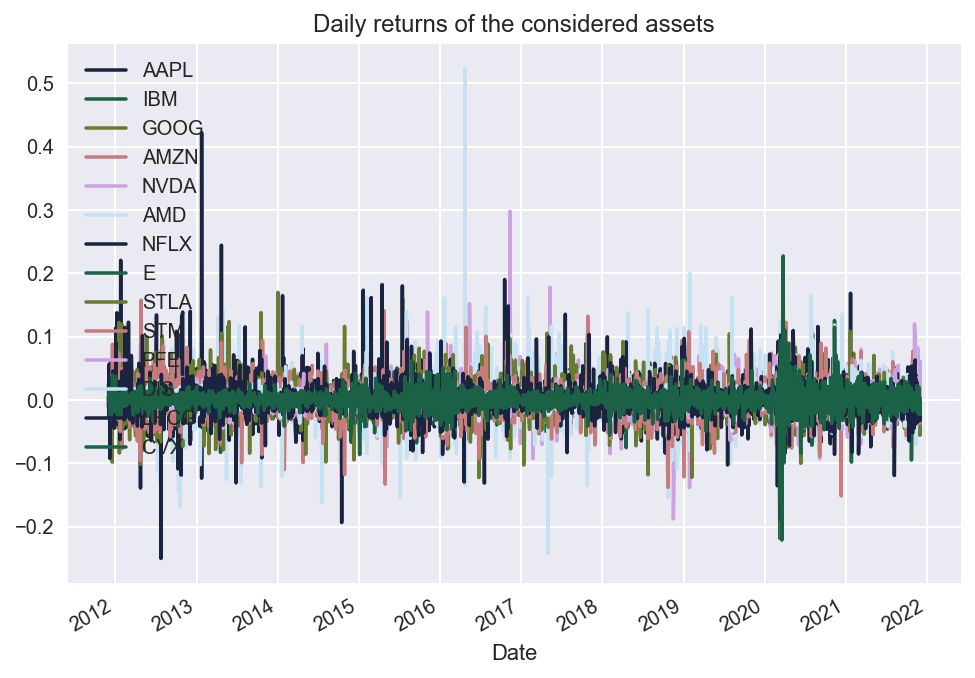

In [71]:
avg_returns = returns_df.mean() * n_days
cov_mat = returns_df.cov() * n_days
returns_df.plot(title='Daily returns of the considered assets');

#### Simuliamo portafogli con pesi casuali

In [72]:
np.random.seed(42)

random_numbers = np.random.random(size=(n_port, n_assets)) # matrix 10^5 x 15

# np.newaxis --> increase the dimension of the existing array by one more dimension
# a 2d array becames a 3d one 
# in questo caso prendo la somma di ogni sequenza di numeri casuali
# aggiungo una dimensioni in modo tale da avere per ogni riga una somma
# divido ciascun elemento di ciascuna sequenza per la somma della sequenza calcolata precedentemente
# In questo modo ottengo n sequenze di pesi la cui somma, per ciascuna sequenza è pari ad 1

weights = random_numbers / np.sum(random_numbers, axis=1)[:, np.newaxis]  

# Assumiamo di valutare un portafoglio con pesi positivi e che quindi non assume posizioni corte per nessun asset


(100000,)

### Calcoliamo i rendimenti di portafoglio e lista delle volatilità:

#### sqrt (vettore trasposto pesi * matrice covarianza * vettore dei pesi)

In [73]:
# dot --> prodotto scalare

portf_rtns = np.dot(weights, avg_returns)

# portf_vol (volatilità):
# radice quadrata di (matrice pesi trasposta x (matrice covarianze x peso))

portf_vol = []
for i in range(0, len(weights)):
    portf_vol.append(np.sqrt(np.dot(weights[i].T, 
                                    np.dot(cov_mat, weights[i]))))
portf_vol = np.array(portf_vol)  

# Ritorni del portafolgio / Varianza del portafoglio 
# NB: Non stiamo sottraendo il rendimento risk-free

portf_sharpe_ratio = portf_rtns / portf_vol


# L'indice di sharp è utile per ottenere:
### portafolgio con rendimento massimo
### portafolgio con varianza minimia
### portafoglio con indice di sharp più alto (miglio efficienza rendimento/rischio)

In [74]:
portf_results_df = pd.DataFrame({'returns': portf_rtns,
                                 'volatility': portf_vol,
                                 'sharpe_ratio': portf_sharpe_ratio})

portf_results_df

,returns,volatility,sharpe_ratio
0,0.219142,0.198175,1.105805
1,0.291979,0.204825,1.425504
2,0.290766,0.218063,1.333404
3,0.249715,0.199236,1.253365
4,0.279645,0.217620,1.285018
...,...,...,...
99995,0.250181,0.198189,1.262337
99996,0.283687,0.202983,1.397590
99997,0.276430,0.213562,1.294374
99998,0.259787,0.216883,1.197817


#### Creazione della frontiera efficiente

In [75]:
n_points = 100

portf_vol_ef = []
indices_to_skip = []

# linspace: Return evenly spaced numbers over a specified interval (start, stop, num=50)
portf_rtns_ef = np.linspace(portf_results_df.returns.min(), 
                            portf_results_df.returns.max(), 
                           n_points)

portf_rtns_ef = np.round(portf_rtns_ef, 2)    
portf_rtns = np.round(portf_rtns, 2)

for point_index in range(n_points):
    if portf_rtns_ef[point_index] not in portf_rtns:
        indices_to_skip.append(point_index)
        continue
    matched_ind = np.where(portf_rtns == portf_rtns_ef[point_index])
    portf_vol_ef.append(np.min(portf_vol[matched_ind]))
    

portf_rtns_ef = np.delete(portf_rtns_ef, indices_to_skip)


In [92]:
portf_rtns_ef

array([0.16, 0.16, 0.16, 0.17, 0.17, 0.17, 0.17, 0.18, 0.18, 0.18, 0.18,
       0.19, 0.19, 0.19, 0.19, 0.2 , 0.2 , 0.2 , 0.2 , 0.21, 0.21, 0.21,
       0.21, 0.21, 0.22, 0.22, 0.22, 0.22, 0.23, 0.23, 0.23, 0.23, 0.24,
       0.24, 0.24, 0.24, 0.25, 0.25, 0.25, 0.25, 0.26, 0.26, 0.26, 0.26,
       0.26, 0.27, 0.27, 0.27, 0.27, 0.28, 0.28, 0.28, 0.28, 0.29, 0.29,
       0.29, 0.29, 0.3 , 0.3 , 0.3 , 0.3 , 0.31, 0.31, 0.31, 0.31, 0.31,
       0.32, 0.32, 0.32, 0.32, 0.33, 0.33, 0.33, 0.33, 0.34, 0.34, 0.34,
       0.34, 0.35, 0.35, 0.35, 0.35, 0.36, 0.36, 0.36, 0.36, 0.36, 0.37,
       0.37, 0.37, 0.37, 0.38, 0.38, 0.38, 0.38, 0.39, 0.39, 0.39, 0.39,
       0.4 ])

# Plotting Frontiera efficiente con Simulazione Monte Carlo

<Figure size 1800x1152 with 0 Axes>

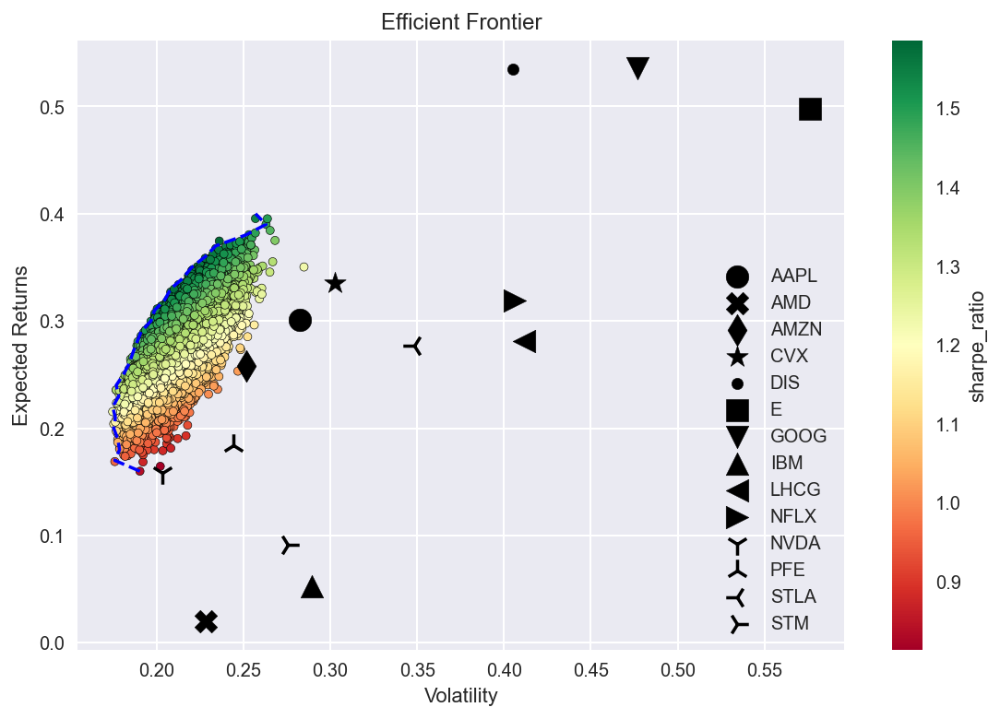

In [76]:
MARKS = ['o', 'X', 'd', '*', ".", ",", "v", "^", "<", ">", "1", "2", "3", "4", "P"]


plt.figure(figsize = (25,16))
fig, ax = plt.subplots()



portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)

ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')

ax.plot(portf_vol_ef, portf_rtns_ef, 'b--')

for asset_index in range(n_assets):
    ax.scatter(x=np.sqrt(cov_mat.iloc[asset_index, asset_index]), 
                y=avg_returns[asset_index], 
                marker=MARKS[asset_index], 
                s=150, 
                color='black',
                label=tickers[:-1][asset_index])
ax.legend()



plt.tight_layout()
plt.show()



Ricerca Portafogli Ottimizzati

In [77]:
max_sharpe_ind = np.argmax(portf_results_df.sharpe_ratio)
max_sharpe_portf = portf_results_df.loc[max_sharpe_ind]

min_vol_ind = np.argmin(portf_results_df.volatility)
min_vol_portf = portf_results_df.loc[min_vol_ind]

# Rendimento Portafoglio ottimale VS Effettivo - Monte Carlo

In [78]:
max_sharpe_portf

returns         0.374508
volatility      0.236142
sharpe_ratio    1.585942
Name: 72786, dtype: float64

In [84]:
np.dot(np.full((1, 14), 1/14), avg_returns)

# portf_rtns = np.dot(weights, avg_returns)

array([0.27478824])

In [91]:
market_df["Adj Close"].pct_change().dropna()

Date
2011-12-05    0.010287
2011-12-06    0.001106
2011-12-07    0.002018
2011-12-08   -0.021142
2011-12-09    0.016883
                ...   
2021-11-23    0.001657
2021-11-24    0.002294
2021-11-26   -0.022725
2021-11-29    0.013200
2021-11-30   -0.018961
Name: Adj Close, Length: 2514, dtype: float64

# Selezione Miglior Portaglio secondo Sharpe-Ratio - Monte Carlo

In [53]:
print('Maximum Sharpe Ratio portfolio')
print('Performance')

for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights:')
for x, y in zip(tickers[:-1], np.sort(weights[np.argmax(portf_results_df.sharpe_ratio)])):
    print(f'\t{x}: {100*y:.2f}% ', end="", flush=True)
    print()

Maximum Sharpe Ratio portfolio
Performance
returns: 37.45% volatility: 23.61% sharpe_ratio: 158.59% 
Weights:
	AAPL: 0.22% 
	AMD: 0.48% 
	AMZN: 0.80% 
	CVX: 1.30% 
	DIS: 2.03% 
	E: 4.31% 
	GOOG: 4.74% 
	IBM: 5.83% 
	LHCG: 8.46% 
	NFLX: 8.68% 
	NVDA: 10.24% 
	PFE: 17.42% 
	STLA: 17.54% 
	STM: 17.95% 


# Selezione Miglior Portaglio secondo Volatilità - Monte Carlo

In [54]:
print('Minimum Volatility portfolio ----')
print('Performance')
for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(tickers[:-1], np.sort(weights[np.argmin(portf_results_df.volatility)])):
    print(f'\t{x}: {100*y:.2f}% ', end="", flush=True)
    print()

Minimum Volatility portfolio ----
Performance
returns: 21.55% volatility: 17.48% sharpe_ratio: 123.29% 
Weights
	AAPL: 0.43% 
	AMD: 0.78% 
	AMZN: 1.77% 
	CVX: 2.91% 
	DIS: 3.40% 
	E: 3.93% 
	GOOG: 4.13% 
	IBM: 6.10% 
	LHCG: 10.38% 
	NFLX: 10.42% 
	NVDA: 10.96% 
	PFE: 11.86% 
	STLA: 14.34% 
	STM: 18.59% 


# Monte Carlo: Migliori Portafogli

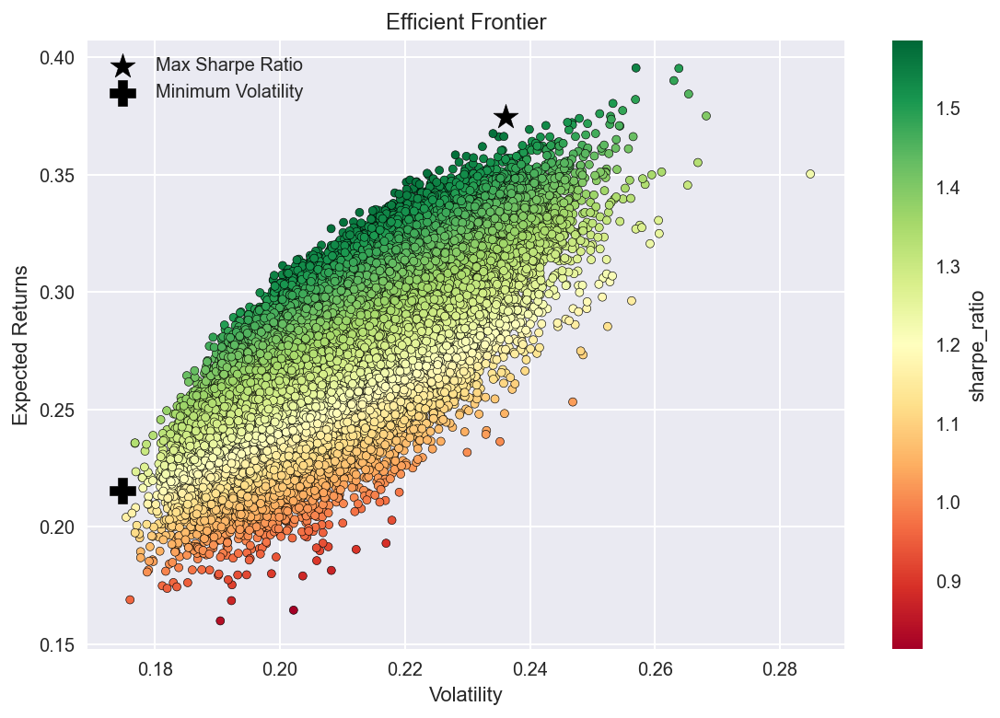

In [55]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.scatter(x=max_sharpe_portf.volatility, 
           y=max_sharpe_portf.returns, 
           c='black', marker='*', 
           s=200, label='Max Sharpe Ratio')
ax.scatter(x=min_vol_portf.volatility, 
           y=min_vol_portf.returns, 
           c='black', marker='P', 
           s=200, label='Minimum Volatility')
ax.set(xlabel='Volatility', ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.legend()

plt.tight_layout()

plt.show()

### Frontiera efficiente con la funzione di ottimizzazione di scipy

In [56]:
import numpy as np
import scipy.optimize as sco

In [57]:
def get_portf_rtn(w, avg_rtns):
    return np.sum(avg_rtns * w)

def get_portf_vol(w, avg_rtns, cov_mat):
    return np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))



def get_efficient_frontier(avg_rtns, cov_mat, rtns_range):
    
    efficient_portfolios = []
    
    n_assets = len(avg_returns)
    args = (avg_returns, cov_mat)
    bounds = tuple((0,1) for asset in range(n_assets))
    initial_guess = n_assets * [1. / n_assets, ]
    
    for ret in rtns_range:
        constraints = ({'type': 'eq', 
                        'fun': lambda x: get_portf_rtn(x, avg_rtns) - ret},
                       {'type': 'eq', 
                        'fun': lambda x: np.sum(x) - 1})
        efficient_portfolio = sco.minimize(get_portf_vol, initial_guess, 
                                           args=args, method='SLSQP', 
                                           constraints=constraints,
                                           bounds=bounds)
        efficient_portfolios.append(efficient_portfolio)
    
    return efficient_portfolios

In [58]:
rtns_range = np.linspace(-0.22, 0.32, 200)

efficient_portfolios = get_efficient_frontier(avg_returns, 
                                              cov_mat, 
                                              rtns_range)

vols_range = [x['fun'] for x in efficient_portfolios]

### Frontiera efficiente con la funzione di ottimizzazione 

In [1]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.plot(vols_range, rtns_range, 'b--', linewidth=3)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')

plt.ylim(0.2,1)
plt.show()

NameError: name 'plt' is not defined

Portafoglio con minima volatilità

In [60]:
min_vol_ind = np.argmin(vols_range)
min_vol_portf_rtn = rtns_range[min_vol_ind]
min_vol_portf_vol = efficient_portfolios[min_vol_ind]['fun']

min_vol_portf = {'Return': min_vol_portf_rtn,
                 'Volatility': min_vol_portf_vol,
                 'Sharpe Ratio': (min_vol_portf_rtn / 
                                  min_vol_portf_vol)}

min_vol_portf

{'Return': 0.1734673366834171,
 'Volatility': 0.16373190914869815,
 'Sharpe Ratio': 1.0594595615804945}

Sommario dei risultati

In [61]:
print('Minimum Volatility portfolio ----')
print('Performance')

for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(tickers[:-1], efficient_portfolios[min_vol_ind]['x']):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
Return: 17.35% Volatility: 16.37% Sharpe Ratio: 105.95% 
Weights
AAPL: 5.14% AMD: 17.67% AMZN: 5.72% CVX: 6.80% DIS: 0.00% E: 0.00% GOOG: 1.81% IBM: 0.63% LHCG: 0.00% NFLX: 0.00% NVDA: 38.92% PFE: 13.80% STLA: 5.98% STM: 3.55% 

Ricerca del portafoglio con il massimo Sharpe ratio

Funzione obiettivo

In [62]:
def neg_sharpe_ratio(w, avg_rtns, cov_mat, rf_rate):
    portf_returns = np.sum(avg_rtns * w)
    portf_volatility = np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))
    portf_sharpe_ratio = (portf_returns - rf_rate) / portf_volatility
    return -portf_sharpe_ratio

Ricerca del portafoglio ottimale

In [63]:
n_assets = len(avg_returns)
RF_RATE = 0

args = (avg_returns, cov_mat, RF_RATE)
constraints = ({'type': 'eq', 
                'fun': lambda x: np.sum(x) - 1})
bounds = tuple((0,1) for asset in range(n_assets))
initial_guess = n_assets * [1. / n_assets]

max_sharpe_portf = sco.minimize(neg_sharpe_ratio, 
                                x0=initial_guess, 
                                args=args,
                                method='SLSQP', 
                                bounds=bounds, 
                                constraints=constraints)

# Rendimento Portafoglio Ottimizzato vs Effettivo - Metodo Analitico

In [64]:
max_sharpe_portf_w = max_sharpe_portf['x']
max_sharpe_portf = {'Return': get_portf_rtn(max_sharpe_portf_w, 
                                            avg_returns),
                    'Volatility': get_portf_vol(max_sharpe_portf_w, 
                                                avg_returns, 
                                                cov_mat),
                    'Sharpe Ratio': -max_sharpe_portf['fun']}
max_sharpe_portf

{'Return': 0.37260293105799314,
 'Volatility': 0.2253065889616824,
 'Sharpe Ratio': 1.6537595849953648}

In [85]:
np.dot(np.full((1, 14), 1/14), avg_returns)

array([0.27478824])

In [68]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')

for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(tickers[:-1], max_sharpe_portf_w):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
Return: 37.26% Volatility: 22.53% Sharpe Ratio: 165.38% 
Weights
AAPL: 11.77% AMD: 0.00% AMZN: 0.00% CVX: 12.26% DIS: 22.72% E: 2.19% GOOG: 17.28% IBM: 0.00% LHCG: 3.99% NFLX: 0.00% NVDA: 18.49% PFE: 0.92% STLA: 10.37% STM: 0.00% 

In [67]:
max_sharpe_portf

{'Return': 0.37260293105799314,
 'Volatility': 0.2253065889616824,
 'Sharpe Ratio': 1.6537595849953648}